In [254]:
# importing modules needed

import os
import pandas as pd
import numpy as np
from scipy import stats
import openpyxl
import matplotlib.pyplot as plt
import scipy
from scipy.fftpack import irfft, rfft

%matplotlib inline
from sklearn.preprocessing import scale
from sklearn.decomposition import PCA
import seaborn as sns

In [2]:
# folder path created for code and also the raw files
p1 = os.getcwd()
p2 = 'Final_Raw_Data'
path = os.path.join(p1,p2)

In [41]:
# here we set the type of conveyor only which we want to merge the data

CASE_1 = "No Defect_No Load"
CASE_2 = "No Defect_with no tray"
CASE_3 = "No Defect_Empty Tray"
Data_final = pd.DataFrame()


# below loop will load excel files one by one
# load it into a dataframe and filter it on conveyor type
# append the filtered data to a new dataframe Data_final

for i in os.listdir(path):
    #if i[-24:] == '_TEST_LOOP_RAW_DATA.xlsx':
    #print(i)
    df = pd.read_excel(path+'\\'+i)
    #print(df.shape)
    df2 =df[df['Defect_Introduced'].isin([CASE_1,CASE_2,CASE_3])]
    #df2 =df[df.Asset_Id == "101.CA.DTL.01.1-030"]
    print(df2.shape)
    Data_final = Data_final.append(df2)

#print('data import for conveyor type {} sucessful'.format(Conveyor_type))

(0, 4103)
(463, 4103)
(0, 4103)
(0, 4103)
(0, 4103)
(0, 4103)
(0, 4103)
(0, 4103)
(0, 4103)
(498, 4103)
(0, 4103)
(0, 4103)
(0, 4103)
(0, 4103)
(0, 4103)
(456, 4103)
(10, 4103)
(635, 4103)
(0, 4103)
(387, 4103)
(0, 4103)
(420, 4103)
(0, 4103)
(423, 4103)
(0, 4103)
(0, 4103)


NameError: name 'Conveyor_type' is not defined

In [194]:
Data_final.Defect_Introduced.value_counts()

No Defect_No Load         1838
No Defect_Empty Tray       929
No Defect_with no tray     525
Name: Defect_Introduced, dtype: int64

In [42]:
Data_final.set_index("index",inplace=True)

In [43]:
Data_final.reset_index(inplace=True)

In [44]:
Data_final.head()

,index,Data_pull_time,Mac_Id,Axis,Defect_Introduced,Asset_Id,Sensor_Loc,Vsample1,Vsample2,Vsample3,...,Vsample4087,Vsample4088,Vsample4089,Vsample4090,Vsample4091,Vsample4092,Vsample4093,Vsample4094,Vsample4095,Vsample4096
0,0,2020-07-13 15:40:14,29:9c:fe:16,X,No Defect_No Load,101.CA.DTL.01.1-050,MET_TST,0.171875,0.640625,1.09375,...,-0.125000,-0.140625,-0.078125,-0.015625,0.000000,-0.015625,0.000000,0.015625,0.015625,-0.046875
1,1,2020-07-13 16:11:10,29:9c:fe:16,X,No Defect_No Load,101.CA.DTL.01.1-050,MET_TST,0.171875,0.015625,0.00000,...,-0.203125,0.000000,-0.234375,-0.078125,-0.234375,-0.109375,-0.093750,-0.078125,0.109375,0.093750
2,2,2020-07-13 15:40:48,29:9c:fe:16,Y,No Defect_No Load,101.CA.DTL.01.1-050,MET_TST,0.171875,-0.171875,0.46875,...,0.000000,0.046875,0.000000,0.046875,0.062500,0.046875,0.031250,0.093750,0.109375,0.234375
3,3,2020-07-13 16:12:08,29:9c:fe:16,Y,No Defect_No Load,101.CA.DTL.01.1-050,MET_TST,0.062500,0.046875,0.03125,...,0.125000,0.078125,-0.156250,0.234375,0.078125,-0.062500,0.500000,-0.218750,0.062500,0.312500
4,4,2020-07-13 15:41:25,29:9c:fe:16,Z,No Defect_No Load,101.CA.DTL.01.1-050,MET_TST,0.171875,0.640625,1.09375,...,0.937500,0.937500,0.875000,0.812500,0.796875,0.906250,0.796875,0.843750,0.890625,0.906250


In [45]:

Data = Data_final.copy()
#processed = Data.loc[:,'Data_pull_time':'Sensor_Loc']


processed['Max'] = Data.loc[:,'Vsample1':'Vsample4096'].max(axis=1)
processed['Min'] = Data.loc[:,'Vsample1':'Vsample4096'].min(axis=1)
processed['Mean'] = Data.loc[:,'Vsample1':'Vsample4096'].mean(axis=1)
processed['Std'] = Data.loc[:,'Vsample1':'Vsample4096'].std(axis=1)
processed['P2P'] = Data.loc[:,'Vsample1':'Vsample4096'].max(axis=1) - Data.loc[:,'Vsample1':'Vsample4096'].min(axis=1)
processed['Kurt'] = Data.loc[:,'Vsample1':'Vsample4096'].kurt(axis=1)
processed['RMS'] =  (Data.loc[:,'Vsample1':'Vsample4096']**2).sum(1).pow(1/2)
processed['Var'] = Data.loc[:,'Vsample1':'Vsample4096'].var(axis=1)

In [ ]:
processed.head()
#processed.Defect_Introduced.value_counts()

### adding frequency bins to processed data

In [132]:
Data_Processed = pd.DataFrame()
sec = 1.2792877225866917
N = 4096
fs_rate=round(N/sec)
fs_rate
Ts = 1.0/fs_rate # sampling interval in time
t = np.arange(0, secs, Ts) # time vector as scipy arange field / numpy.ndarray
freqs = scipy.fftpack.fftfreq(N, t[1]-t[0])
print(len(freqs))
freqs_side = freqs[range(N//2)] # one side frequency range
print(len(freqs_side))

4096
2048


In [195]:
Data_Processed = pd.DataFrame()
sec = 1.2792877225866917
N = 4096
fs_rate=round(N/sec)
fs_rate
Ts = 1.0/fs_rate # sampling interval in time
t = np.arange(0, secs, Ts) # time vector as scipy arange field / numpy.ndarray
freqs = scipy.fftpack.fftfreq(N, t[1]-t[0])
freqs_side = freqs[range(N//2)] # one side frequency range
## high pass filter
for i,row in Data.iterrows():
    data = row['Vsample1':'Vsample4096'] - row['Vsample1':'Vsample4096'].mean() # subracting mean from the samples
    #print(row["Data_pull_time":"Sensor_Loc"])
    f_signal = rfft(data)
    #print(row['Vsample1':'Vsample6'])
    #print(f_signal[:5])
    #print(len(f_signal))
    #If our original signal time was in seconds, this is now in Hz    
    cut_f_signal = f_signal.copy()
    #cut_f_signal[(freqs<6) & (freqs>-6)] = 0
    data = irfft(cut_f_signal)
    rms = np.sqrt(np.mean(np.array(data)**2))
    kurt=stats.kurtosis(data)
    if rms>.02 and kurt<300 and freqs_side[-1]>1550: ## to keep the range at least 800 hz
        FFT = scipy.fft.fft(data)
        FFT_side = FFT[range(N//2)] # one side FFT range, because we need just the haf of the frequency data because of symmetry
        abs_fft_1=abs(FFT_side)
        
        payload={
                        "Data_pull_time" : row["Data_pull_time"],
                        "Mac_Id" : row["Mac_Id"],
                        "Axis" : row["Axis"],
                        "Defect_Introduced" : row["Defect_Introduced"],
                        "Asset_Id" : row["Asset_Id"],
                        "Sensor_Loc":row["Sensor_Loc"],
                        "peak-peak": (max(data)-min(data)),
                        "rms": rms,
                        "kurt":kurt,
                        "crest":np.max(np.abs(data))/np.sqrt(np.mean(np.square(data))),
                        "variance":np.var(data),
                        "mean":np.mean(data),
                        "skewness":stats.skew(data),
                        'freqAmpliMean':np.mean(abs_fft_1),
                        'freqAmpliMax':max(abs_fft_1),
                        'freqAmpliKurt':stats.kurtosis(abs_fft_1),
                        'freqAmpliskw':stats.skew(abs_fft_1),
                        'freqAmpliVar':np.var(abs_fft_1),
                        }
        lenFreq=len(freqs_side)
        lastFreq=freqs_side[-1]
        abs_fft_1=list(abs_fft_1)
        jj=0
        feqv=1
        while jj < lenFreq and feqv<=8: ## for 8 bins from 0 to 1600 Hz
            #print('Condition satisfied')
            kk=int(round(jj+lenFreq/lastFreq*200)) ## 100 is freqency step size for binnning
            #print(kk)
            fft_Range=abs_fft_1[jj:kk]
            freq_sideRange=freqs_side[jj:kk]
            jj=kk
            payload['max_{}'.format(feqv)]=max(fft_Range)
            payload['mean_{}'.format(feqv)]=np.mean(fft_Range)
            payload['var_{}'.format(feqv)]=np.var(fft_Range)
            feqv+=1
        Data_Processed = Data_Processed.append(payload, ignore_index=True)



#for i,row in Data.iterrows():

In [183]:
        lenFreq=len(freqs_side)
        lastFreq=freqs_side[-1]
        abs_fft_1=list(abs_fft_1)

In [187]:
lenFreq

2048

In [157]:
raw = Data.iloc[0]["Vsample1":"Vsample4096" ]
raw_mean = Data.iloc[0]["Vsample1":"Vsample4096" ] - Data.iloc[0]["Vsample1":"Vsample4096" ].mean()

In [192]:
Data_Processed.to_excel('Processed-sample.xlsx')

In [70]:
stats.skew(raw_mean)

0.395172842665711

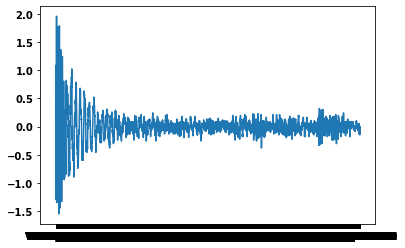

In [80]:
plt.plot(raw_mean)

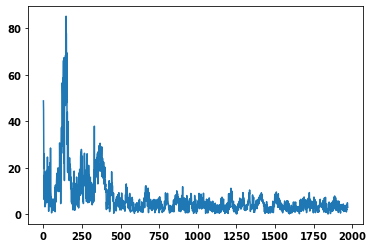

In [161]:
### convert raw data to FFT

FFT = scipy.fft.fft(raw_mean)
plt.plot(abs(FFT[range(75,N//2)]) )

In [167]:
freqs = scipy.fftpack.fftfreq(N, t[1]-t[0])

In [105]:
max(abs(FFT))

163.03529240560164

In [179]:
fft_data.to_excel('FFT_Data.xlsx')

In [173]:
fft_data = pd.DataFrame()

In [174]:
fft_data['Raw_data'] = raw_mean

In [175]:
fft_data['FFT'] = FFT

In [176]:
fft_data['abs_data'] = abs(FFT)

In [177]:
f_signal = rfft(raw_mean)
fft_data['Rfft'] = f_signal

In [169]:
len(f_signal)
#len((freqs<6) & (freqs>-6))
f_signal[(freqs<6) & (freqs>-6)]
f_signal.sum()

-780.1194547627197

In [178]:
f_signal[(freqs<6) & (freqs>-6)] = 0
fft_data['Rfft_6Freq'] = f_signal

In [172]:
f_signal.sum()

-780.1194547627197

In [ ]:
Data.loc[0:0,'Vsample1':'Vsample4096']

-0.78173828125


C:\Users\husssabe\AppData\Local\Continuum\anaconda3\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


3202.0

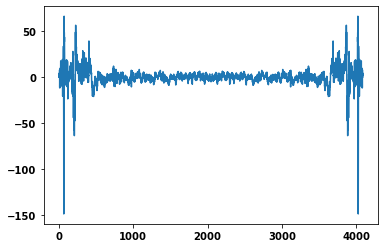

In [72]:
row = Data_final.iloc[228]['Vsample1':'Vsample4096']
N=4096
sec = 1.279374957
fs_rate=round(N/sec) ## alternatively that means frequency

   
secs = N / float(fs_rate) ## time for which it will be played in sec

Ts = 1.0/fs_rate # sampling interval in time

t = np.arange(0, secs, Ts) # time vector as scipy arange field / numpy.ndarray

freqs = scipy.fft.fftfreq(N, t[1]-t[0])
print(freqs[4095])
freqs_side = freqs[range(N//2)] # one side frequency range
               
                ## caliberate the sensor in case there is gravitational effect left from the sensor settings
data = Data.iloc[4]['Vsample1':'Vsample4096']
meanVal=np.mean(data)
data-=meanVal
   
FFT = scipy.fft.fft(raw_mean)
FFT_side = FFT[range(N//2)] # one side FFT range, because we need just the haf of the frequency data because of symmetry
abs_fft_1=2*abs(FFT_side)/N


type(abs_fft_1)
#plt.plot(abs(FFT[range(N//2)]))
plt.plot(FFT)

1/t[1]

## K means clustering

In [ ]:
from sklearn.cluster import KMeans
model = KMeans(n_clusters=2)

In [ ]:
model.fit(processed[["P2P","RMS","Mean","Max"]])

In [ ]:
labels = model.predict(processed[["P2P","RMS","Mean","Max"]])

In [ ]:
print(labels)

### understanding our cluster

In [ ]:
colors = ["red", "orange", "green", "blue", "purple", "gray"]
Fault = ["Hanoi", "Nha Trang", "Vung Tau", "Phu Quoc", "Quang Ngai", "Saigon"]
region_colors=dict(zip(regions,colors))

grp_color=[]
for i in data['Region']:
    grp_color.append(region_colors[i]) 

x_long=data[' Longitude']
y_lat=data[" Latitude"]
plt.scatter(x_long,y_lat,c=grp_color)
plt.legend(grp_color,regions,loc='right')

In [ ]:

plt.scatter(processed.P2P,processed.RMS, c=processed["Actual_Cluster"].apply(lambda x: colors[x]),label=)
plt.show()
plt.legend()
plt.show()

In [ ]:
centroids = model.cluster_centers_
centroids_x = centroids[:,0]
centroids_y = centroids[:,1]

In [ ]:
plt.scatter(processed.P2P,processed.RMS, c=labels)
plt.scatter(centroids_x, centroids_y, marker='X', s=200)
plt.show()

In [ ]:
Load_NoLoad_group = {"No Defect_No Load": "No_Load",
                     "No Defect_Empty Tray":"Load",
                     "No Defect_with no tray" : "No_Load" }

processed["Actual_Cluster"] = [ Load_NoLoad_group[i] for i in processed.Defect_Introduced]

In [ ]:
processed["Cluster"] = labels

In [ ]:
processed[["Defect_Introduced","Actual_Cluster","Cluster"]].to_excel("Cluster_data_2.xlsx")

In [ ]:
plt.scatter(processed.P2P,processed.RMS, c=processed["Cluster"])
plt.show()

In [ ]:
fig, ax = plt.subplots()

    ax.scatter(x, y, c=color, s=scale, label=color,
               alpha=0.3, edgecolors='none')

ax.legend()
ax.grid(True)

plt.show()

In [39]:
#row = Data_final.iloc[228]['Vsample1':'Vsample4096']
N=4096
sec = 1.279374957
fs_rate=round(N/sec) ## alternatively that means frequency

   
secs = N / float(fs_rate) ## time for which it will be played in sec

Ts = 1.0/fs_rate # sampling interval in time

t = np.arange(0, secs, Ts) # time vector as scipy arange field / numpy.ndarray

freqs = scipy.fft.fftfreq(N, t[1]-t[0])
#print(freqs[4095])
freqs_side = freqs[range(N//2)] # one side frequency range

for j in ['X','Y','Z']:
    print(j)
    for i,row in Data_final[(Data_final.Defect_Introduced == "No Defect_Empty Tray")  & (Data_final.Asset_Id == "101.CA.DTL.01.1-030") & (Data_final.Axis == j)].head().iterrows():
    #if (row['Vsample1':'Vsample4096'].max() > 2) and (row['Vsample1':'Vsample4096'].min() < 0) :
        data = row['Vsample1':'Vsample4096']
        fig, axs = plt.subplots(2)
        axs[0].plot(data)
        axs[0].set_ylim(-4,4)
        fig.suptitle(str(row['Data_pull_time']) +'\n'+row['Defect_Introduced']+'\n'+row['Sensor_Loc'])
        #fig.title(str(row['Data_pull_time'])+' '+row['Axis'])
        
        FFT = scipy.fft.fft(data)
        axs[1].plot(FFT)
        fig.savefig('./101.CA.DTL.01.1-030/Load/'+j+'/'+row['Mac_Id'].replace(":","")+'_'+row['Axis']+'_'+str(i)+'.png',dpi=400)
        #fig.savefig('test.png')
        plt.close()

X


C:\Users\husssabe\AppData\Local\Continuum\anaconda3\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\Users\husssabe\AppData\Local\Continuum\anaconda3\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\Users\husssabe\AppData\Local\Continuum\anaconda3\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\Users\husssabe\AppData\Local\Continuum\anaconda3\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\Users\husssabe\AppData\Local\Continuum\anaconda3\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning:

Y


C:\Users\husssabe\AppData\Local\Continuum\anaconda3\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\Users\husssabe\AppData\Local\Continuum\anaconda3\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\Users\husssabe\AppData\Local\Continuum\anaconda3\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\Users\husssabe\AppData\Local\Continuum\anaconda3\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\Users\husssabe\AppData\Local\Continuum\anaconda3\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning:

Z


C:\Users\husssabe\AppData\Local\Continuum\anaconda3\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\Users\husssabe\AppData\Local\Continuum\anaconda3\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\Users\husssabe\AppData\Local\Continuum\anaconda3\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\Users\husssabe\AppData\Local\Continuum\anaconda3\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\Users\husssabe\AppData\Local\Continuum\anaconda3\lib\site-packages\numpy\core\_asarray.py:83: ComplexWarning:

In [20]:
for j in ['X','Y','Z']:
    for i,row in Data_final[(Data_final.Defect_Introduced == "No Defect_No Load")  & (Data_final.Asset_Id == "101.CA.DTL.01.1-050") & (Data_final.Axis == j)].iterrows():
        #if (row['Vsample1':'Vsample4096'].max() > 2) and (row['Vsample1':'Vsample4096'].min() < 0) :
        plot = row['Vsample1':'Vsample4096'].plot()
        plot.set_ylim(-4,4)
        fig = plot.get_figure()
        plt.suptitle(str(row['Data_pull_time'])+' '+row['Axis'])
        plt.title(row['Defect_Introduced']+' '+row['Sensor_Loc'])
        fig.savefig('./101.CA.DTL.01.1-030/Load/X/'+row['Mac_Id'].replace(":","")+'_'+row['Axis']+'_'+str(i)+'.png')
        plt.close()

KeyboardInterrupt: 

<Figure size 432x288 with 0 Axes>

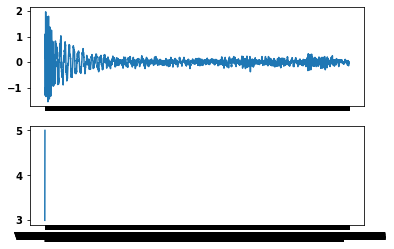

In [25]:
fig, ax = plt.subplots(2, 
           sharex='col', sharey='row')

ax[0].plot(row)

ax[1].plot([3,4,5])

plt.show()

In [24]:
row = Data_final.iloc[0]['Vsample1':'Vsample4096']
Data_final.iloc[0]

index                                  0
Data_pull_time       2020-07-13 15:40:14
Mac_Id                       29:9c:fe:16
Axis                                   X
Defect_Introduced      No Defect_No Load
                            ...         
Vsample4092                    -0.015625
Vsample4093                            0
Vsample4094                     0.015625
Vsample4095                     0.015625
Vsample4096                    -0.046875
Name: 0, Length: 4103, dtype: object

### clustering part 2 

In [211]:
Data_Processed.head()

points = Data_Processed.loc[:,["crest","freqAmpliKurt"]].values

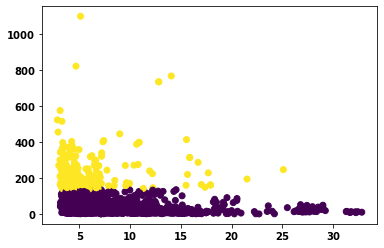

In [212]:
model = KMeans(n_clusters=2)
model.fit(points)
labels = model.predict(points)
xs = points[:,0]
ys = points[:,1]
plt.scatter(xs, ys, c=labels)
plt.show()

In [201]:
from sklearn.cluster import KMeans

model = KMeans(n_clusters=2)
model.fit(points)
labels = model.predict(points)

crest freqAmpliKurt


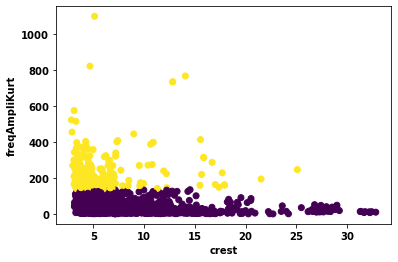

crest freqAmpliMax


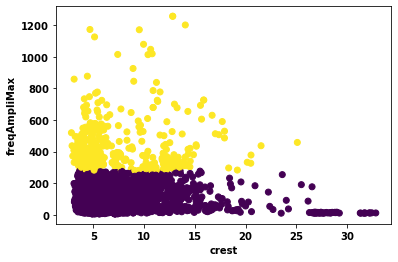

crest freqAmpliMean


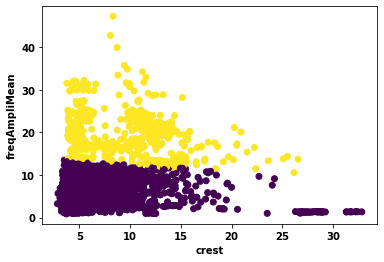

crest freqAmpliVar


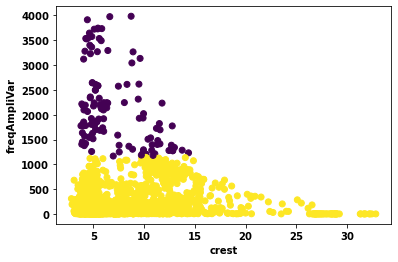

crest freqAmpliskw


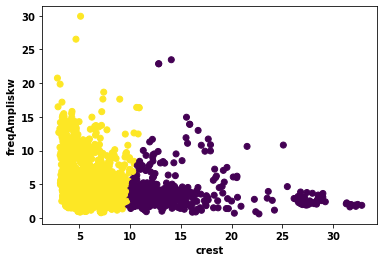

crest kurt


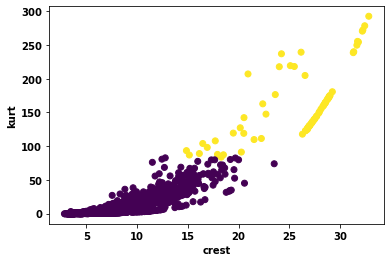

crest max_1


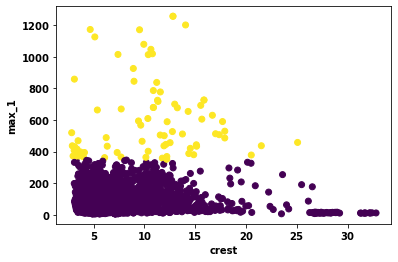

crest max_2


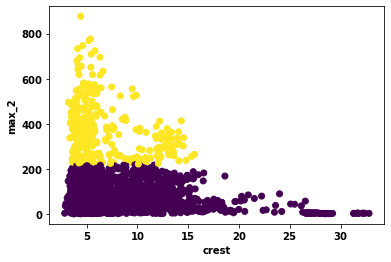

crest max_3


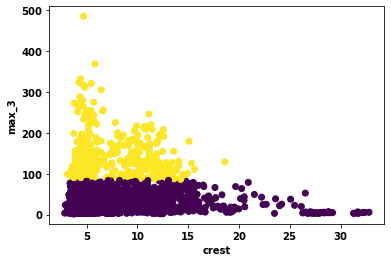

crest max_4


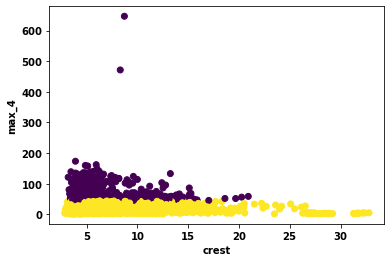

crest max_5


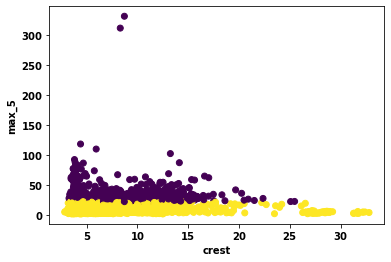

crest max_6


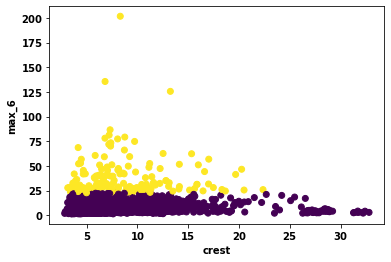

crest max_7


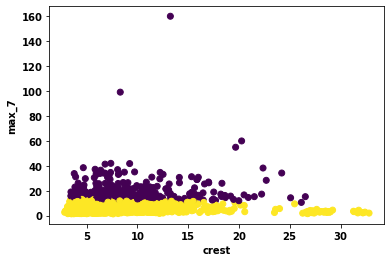

crest max_8


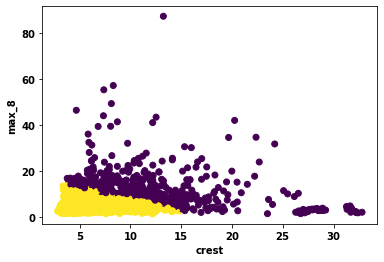

crest mean


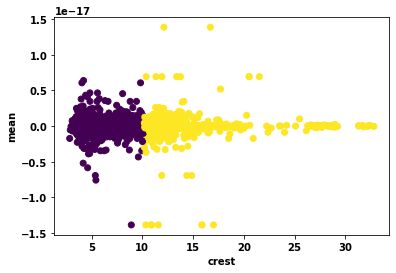

crest mean_1


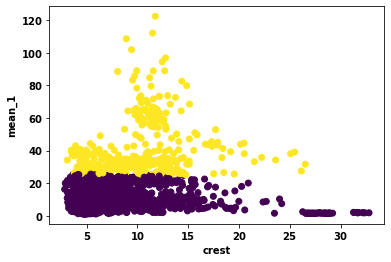

crest mean_2


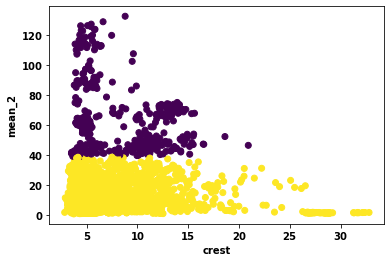

crest mean_3


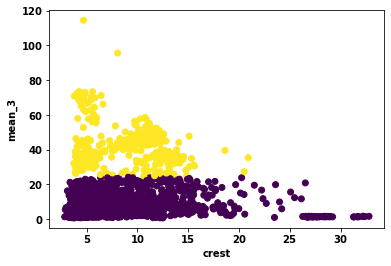

crest mean_4


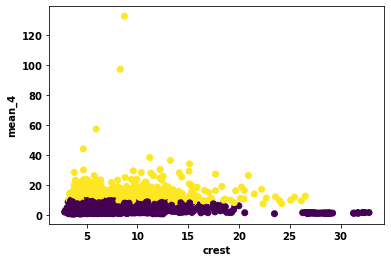

crest mean_5


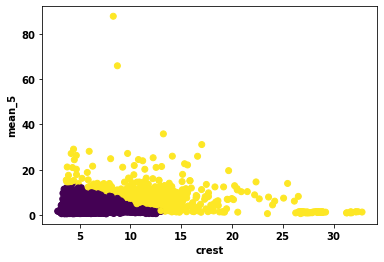

crest mean_6


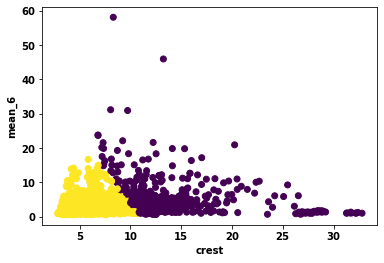

crest mean_7


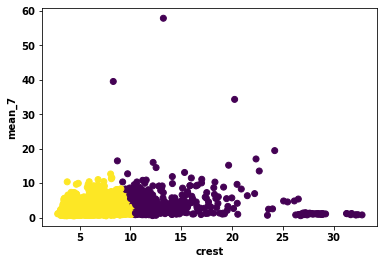

crest mean_8


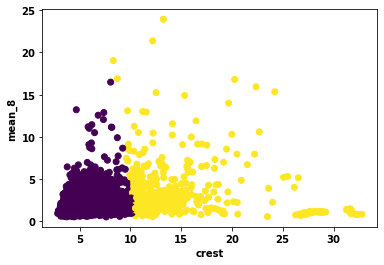

crest peak-peak


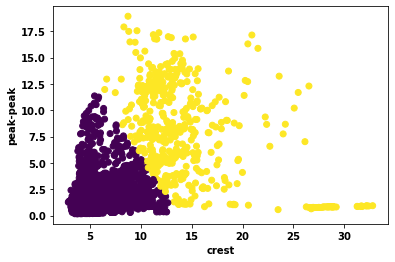

crest rms


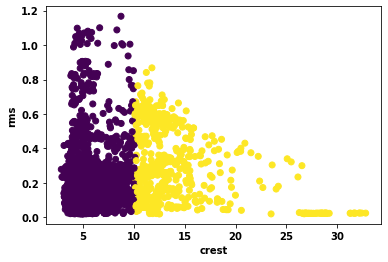

crest skewness


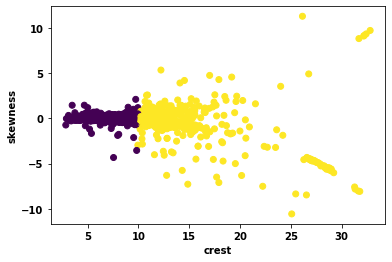

crest var_1


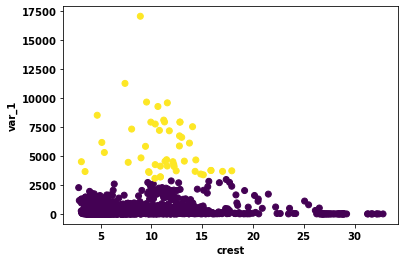

crest var_2


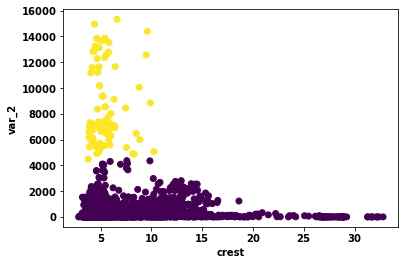

crest var_3


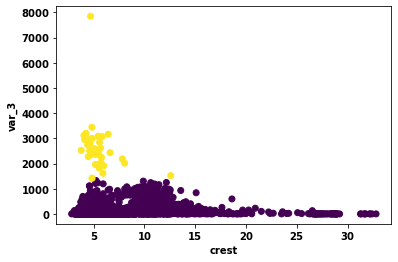

crest var_4


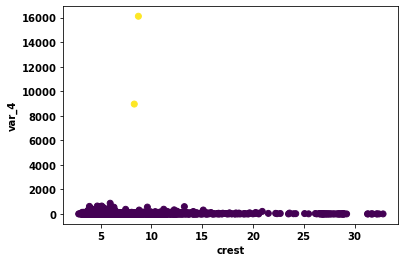

crest var_5


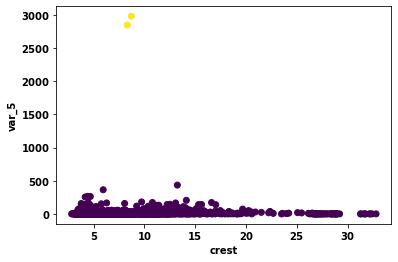

crest var_6


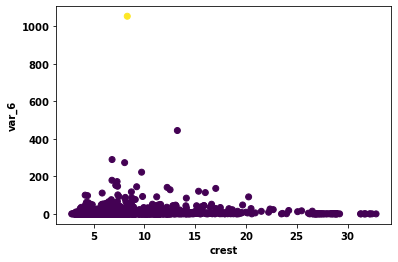

crest var_7


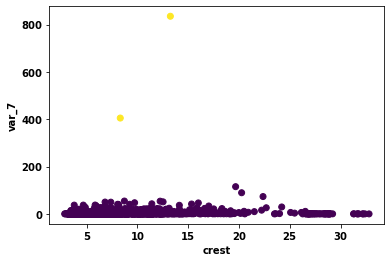

crest var_8


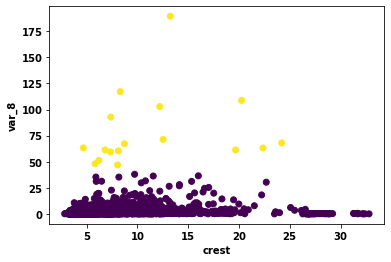

crest variance


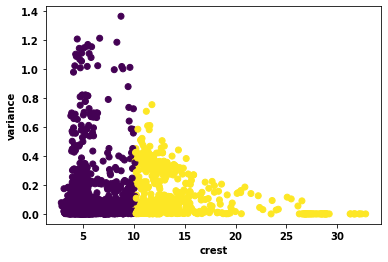

freqAmpliKurt crest


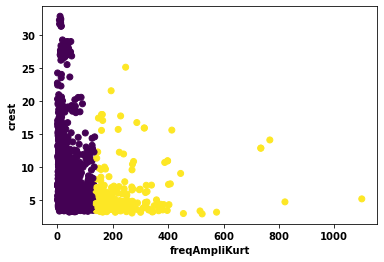

freqAmpliKurt freqAmpliMax


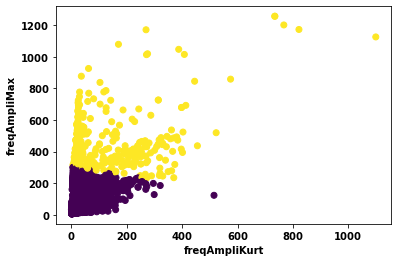

freqAmpliKurt freqAmpliMean


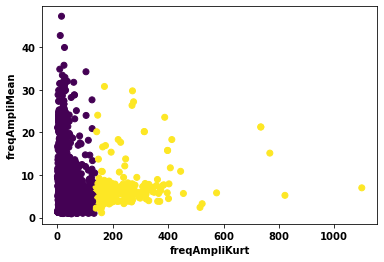

freqAmpliKurt freqAmpliVar


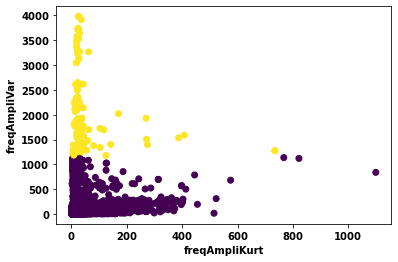

freqAmpliKurt freqAmpliskw


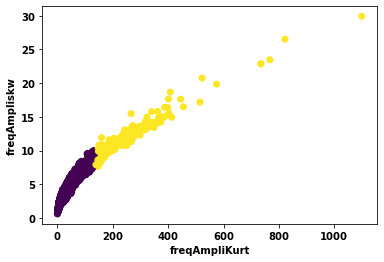

freqAmpliKurt kurt


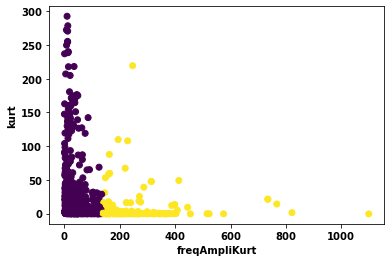

freqAmpliKurt max_1


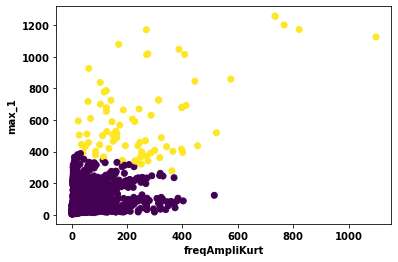

freqAmpliKurt max_2


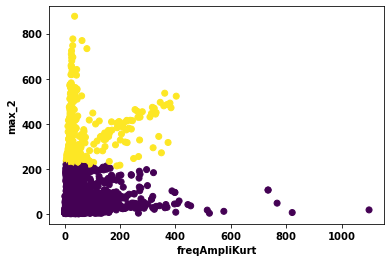

freqAmpliKurt max_3


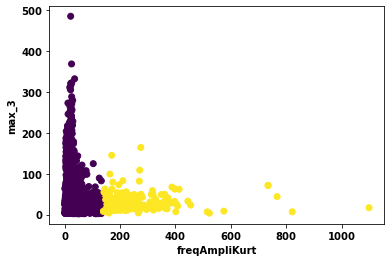

freqAmpliKurt max_4


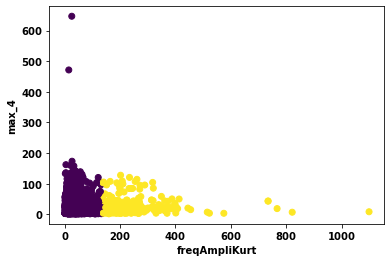

freqAmpliKurt max_5


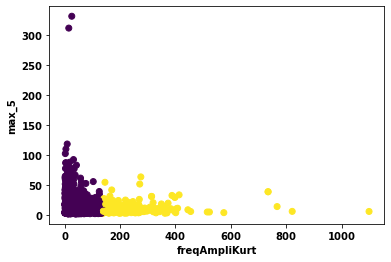

freqAmpliKurt max_6


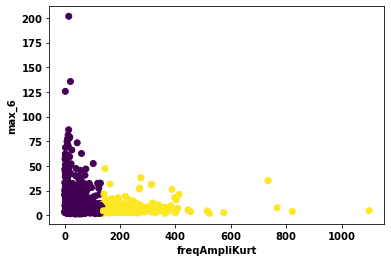

freqAmpliKurt max_7


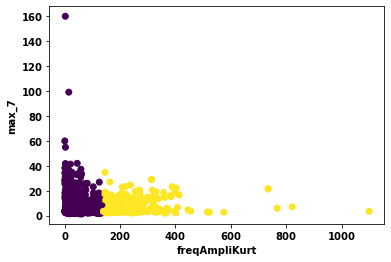

freqAmpliKurt max_8


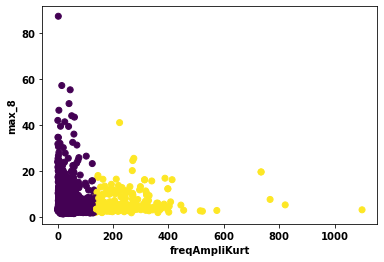

freqAmpliKurt mean


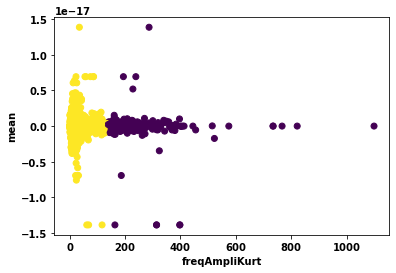

freqAmpliKurt mean_1


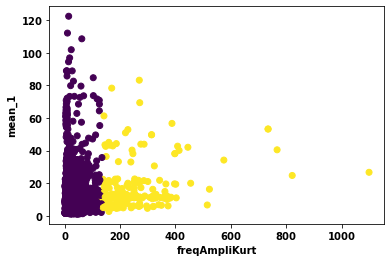

freqAmpliKurt mean_2


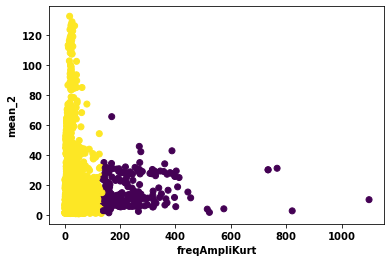

freqAmpliKurt mean_3


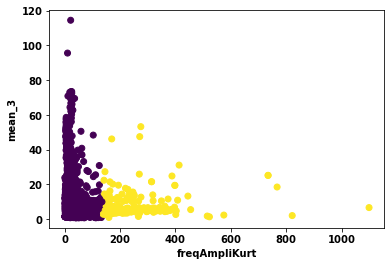

freqAmpliKurt mean_4


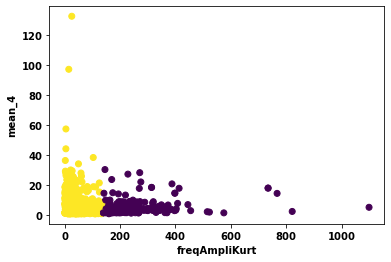

freqAmpliKurt mean_5


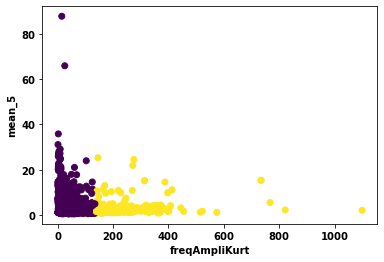

freqAmpliKurt mean_6


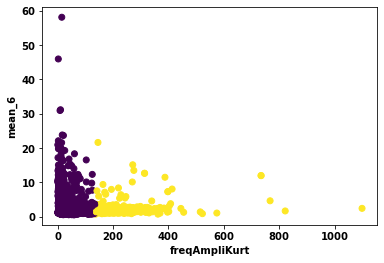

freqAmpliKurt mean_7


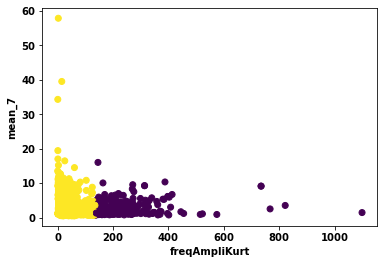

freqAmpliKurt mean_8


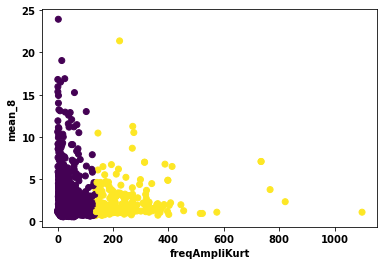

freqAmpliKurt peak-peak


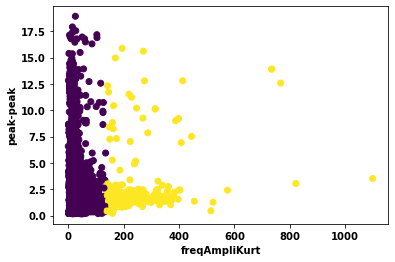

freqAmpliKurt rms


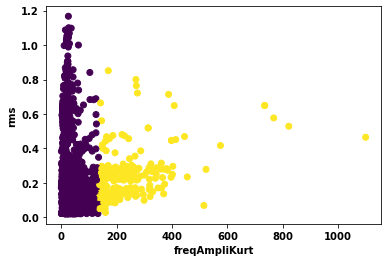

freqAmpliKurt skewness


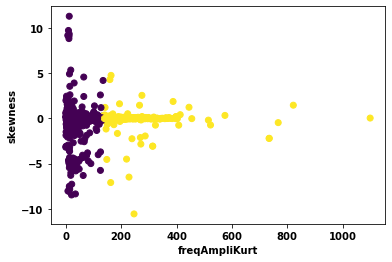

freqAmpliKurt var_1


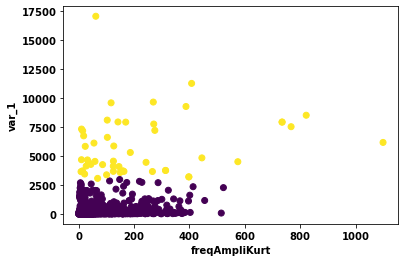

freqAmpliKurt var_2


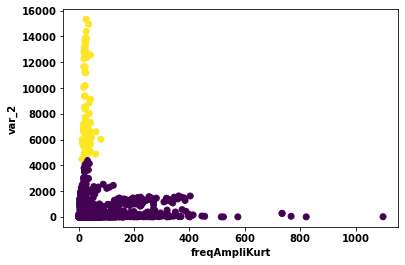

freqAmpliKurt var_3


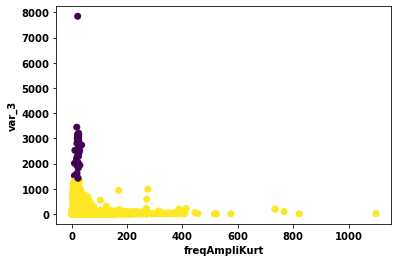

freqAmpliKurt var_4


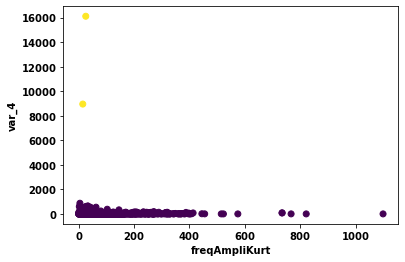

freqAmpliKurt var_5


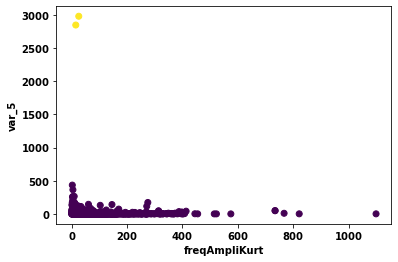

freqAmpliKurt var_6


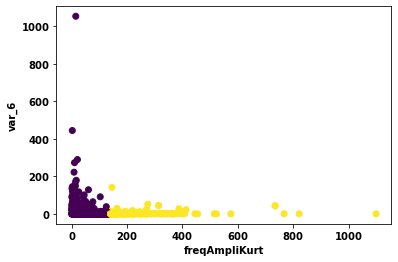

freqAmpliKurt var_7


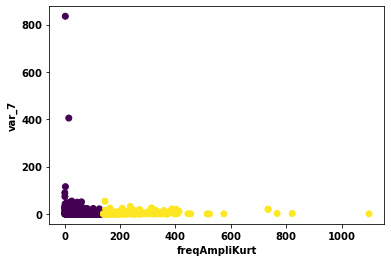

freqAmpliKurt var_8


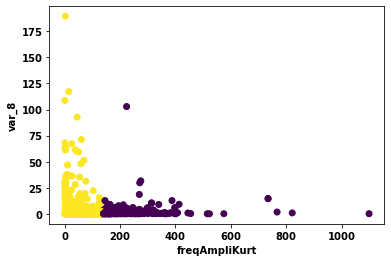

freqAmpliKurt variance


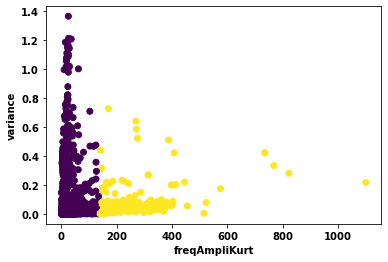

freqAmpliMax crest


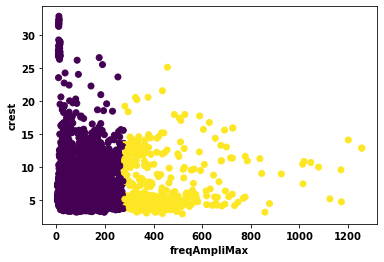

freqAmpliMax freqAmpliKurt


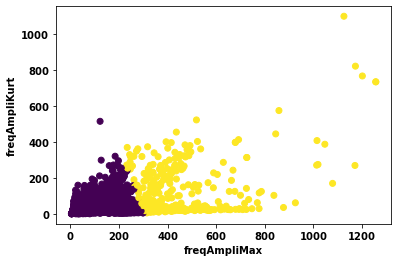

freqAmpliMax freqAmpliMean


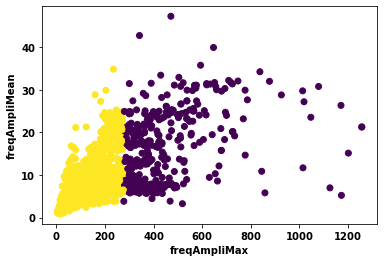

freqAmpliMax freqAmpliVar


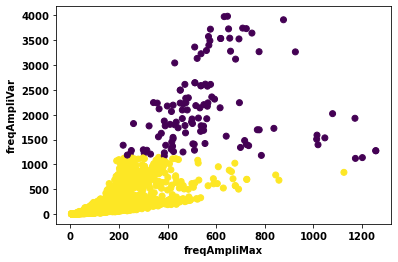

freqAmpliMax freqAmpliskw


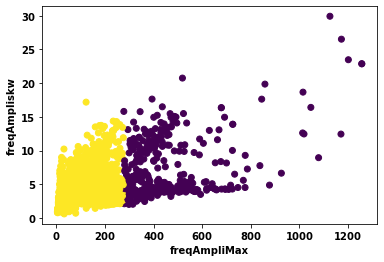

freqAmpliMax kurt


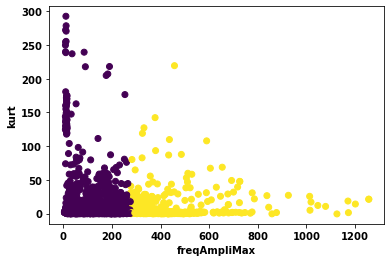

freqAmpliMax max_1


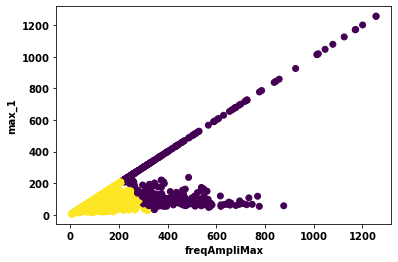

freqAmpliMax max_2


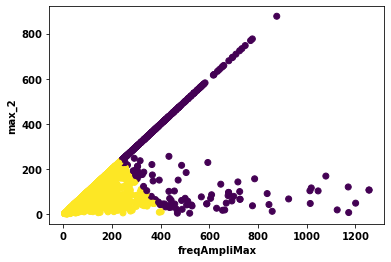

freqAmpliMax max_3


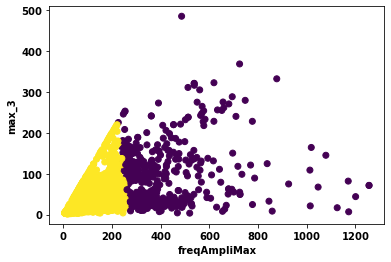

freqAmpliMax max_4


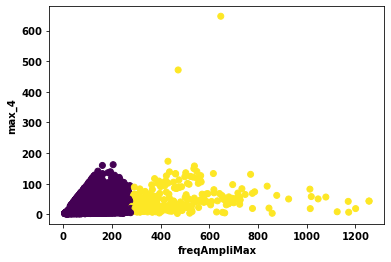

freqAmpliMax max_5


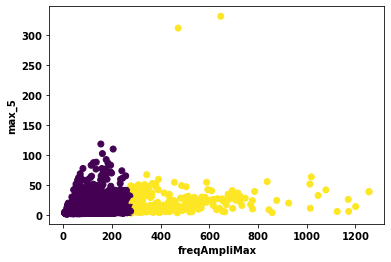

freqAmpliMax max_6


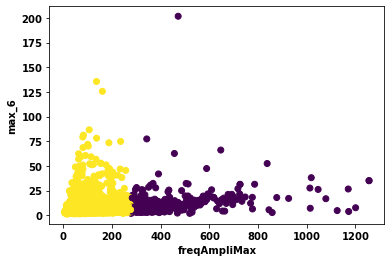

freqAmpliMax max_7


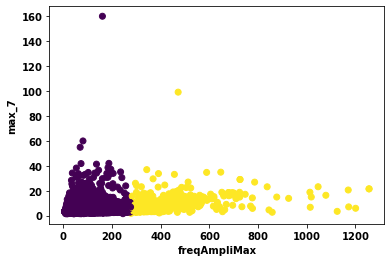

freqAmpliMax max_8


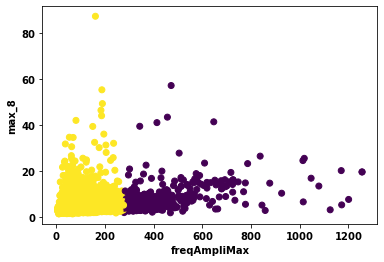

freqAmpliMax mean


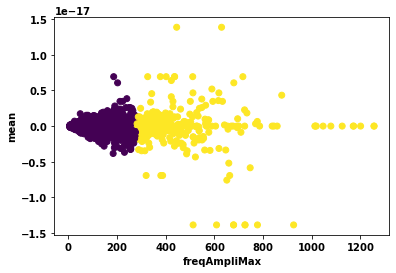

freqAmpliMax mean_1


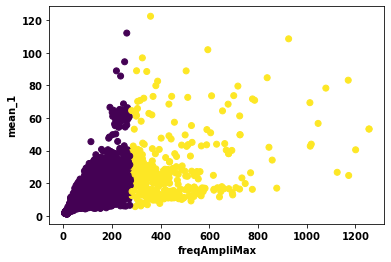

freqAmpliMax mean_2


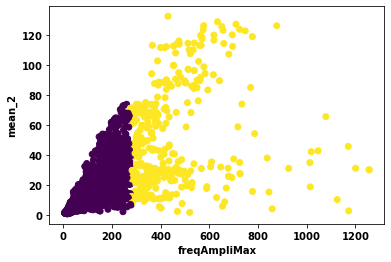

freqAmpliMax mean_3


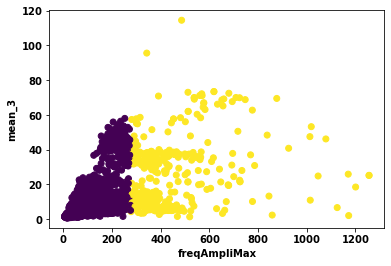

freqAmpliMax mean_4


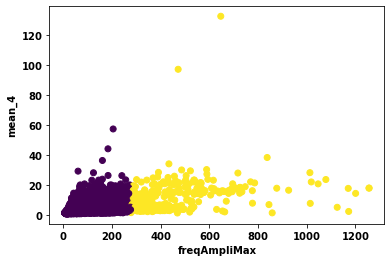

freqAmpliMax mean_5


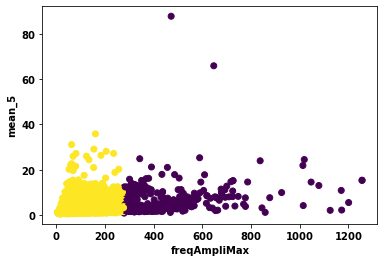

freqAmpliMax mean_6


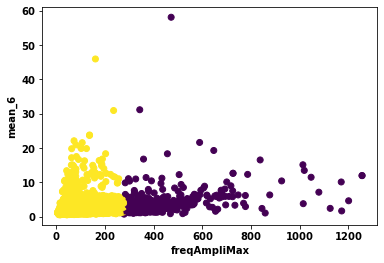

freqAmpliMax mean_7


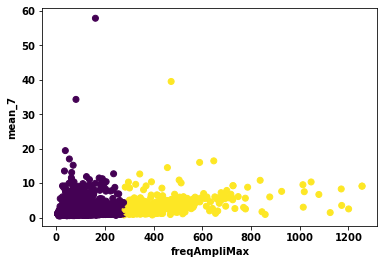

freqAmpliMax mean_8


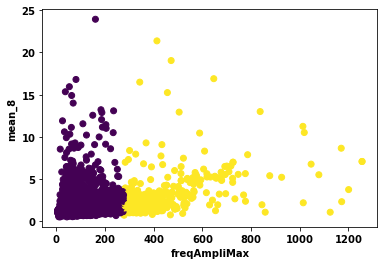

freqAmpliMax peak-peak


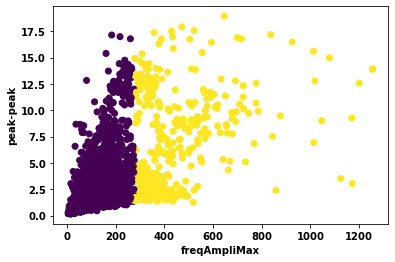

freqAmpliMax rms


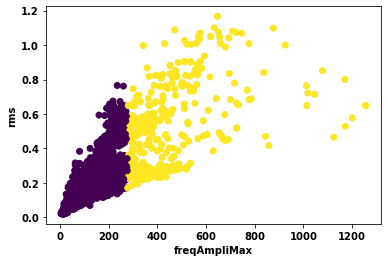

freqAmpliMax skewness


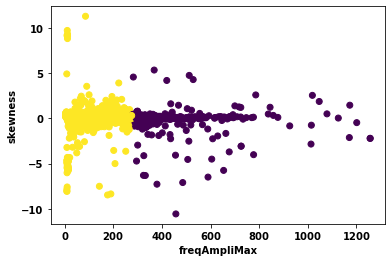

freqAmpliMax var_1


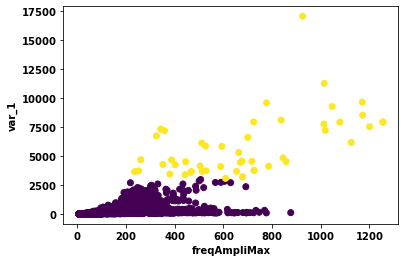

freqAmpliMax var_2


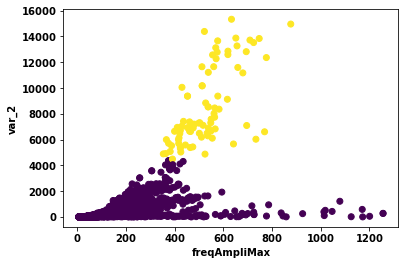

freqAmpliMax var_3


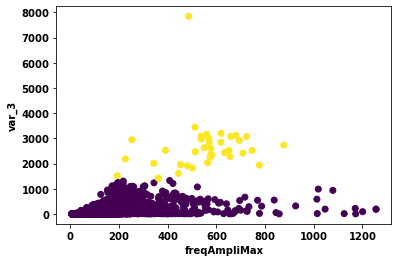

freqAmpliMax var_4


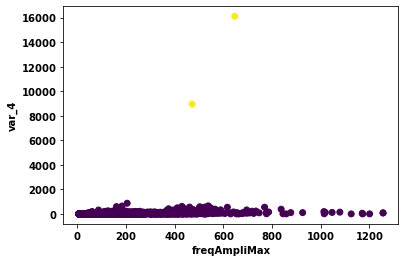

freqAmpliMax var_5


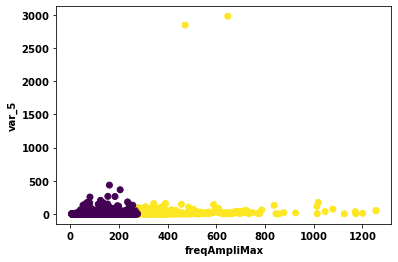

freqAmpliMax var_6


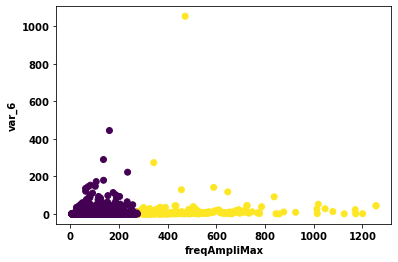

freqAmpliMax var_7


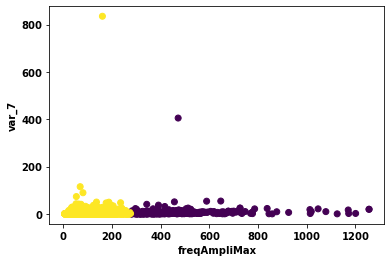

freqAmpliMax var_8


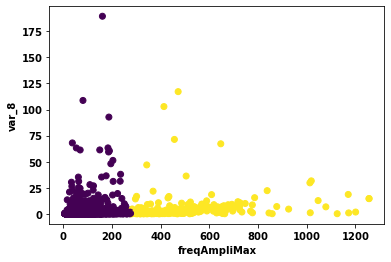

freqAmpliMax variance


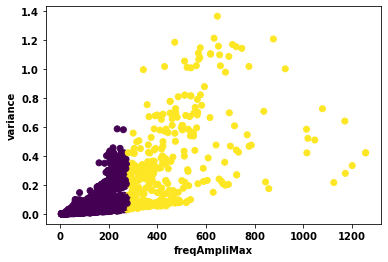

freqAmpliMean crest


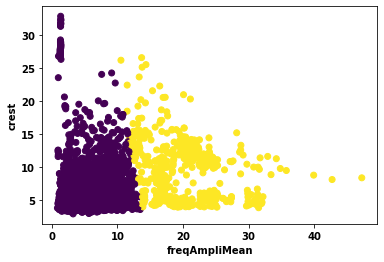

freqAmpliMean freqAmpliKurt


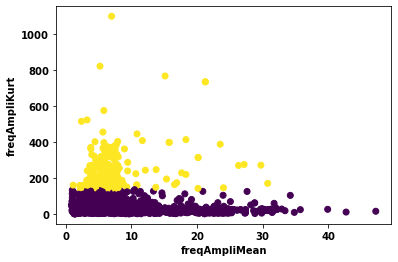

freqAmpliMean freqAmpliMax


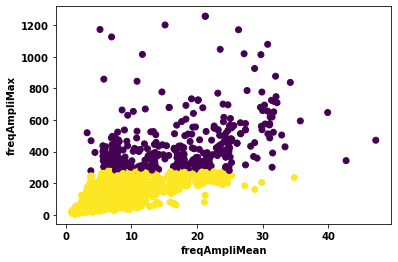

freqAmpliMean freqAmpliVar


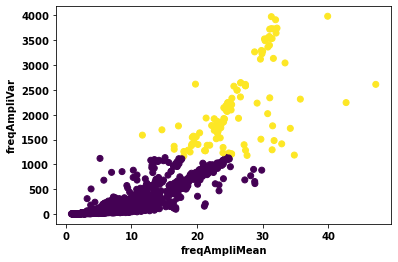

freqAmpliMean freqAmpliskw


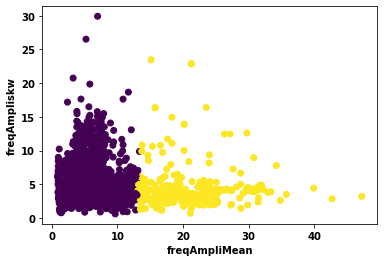

freqAmpliMean kurt


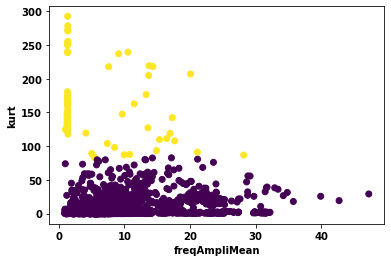

freqAmpliMean max_1


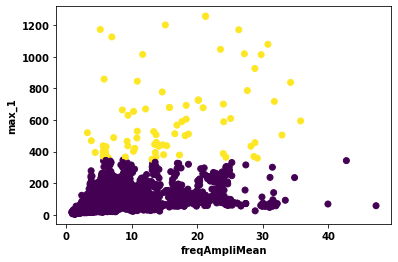

freqAmpliMean max_2


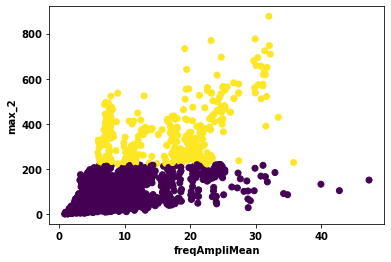

freqAmpliMean max_3


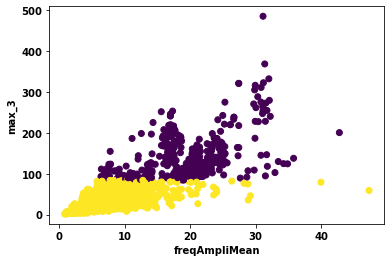

freqAmpliMean max_4


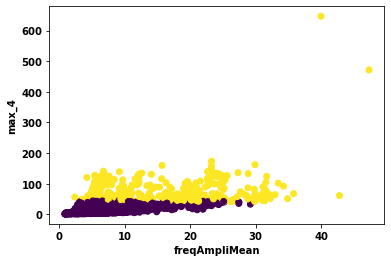

freqAmpliMean max_5


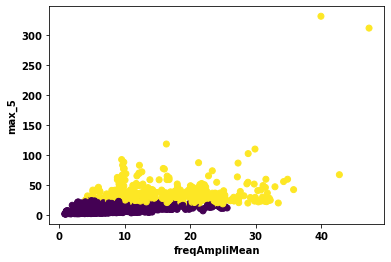

freqAmpliMean max_6


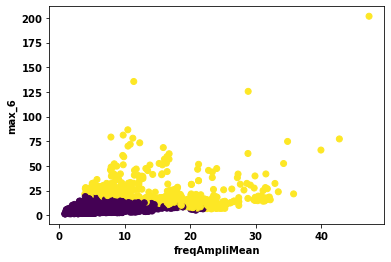

freqAmpliMean max_7


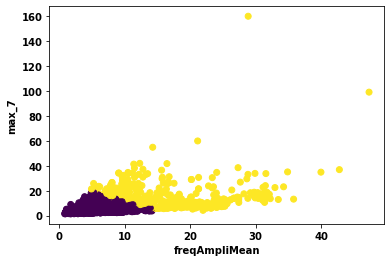

freqAmpliMean max_8


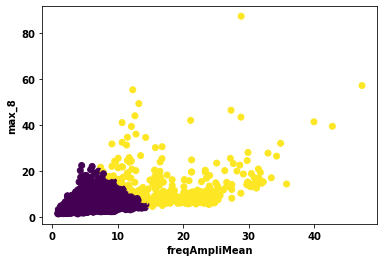

freqAmpliMean mean


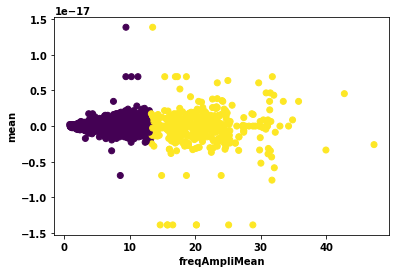

freqAmpliMean mean_1


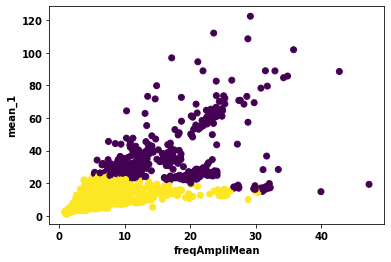

freqAmpliMean mean_2


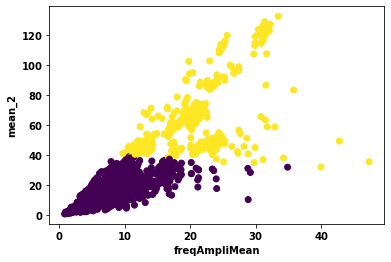

freqAmpliMean mean_3


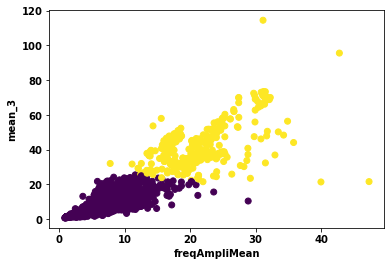

freqAmpliMean mean_4


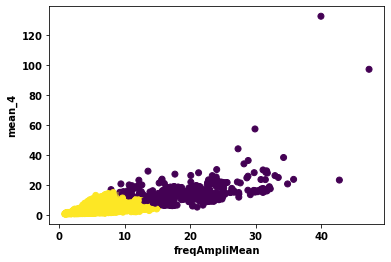

freqAmpliMean mean_5


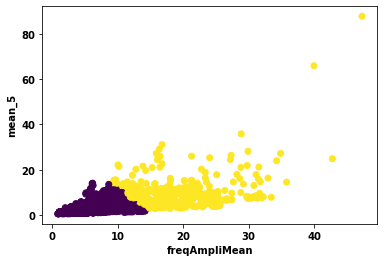

freqAmpliMean mean_6


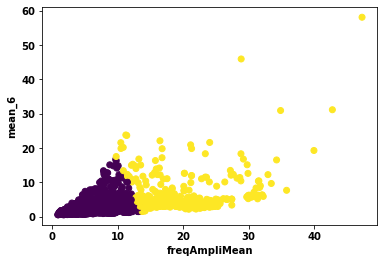

freqAmpliMean mean_7


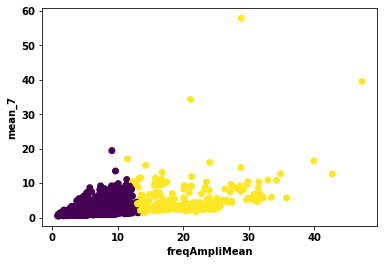

freqAmpliMean mean_8


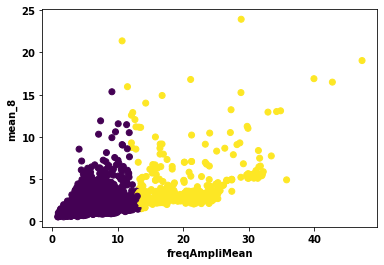

freqAmpliMean peak-peak


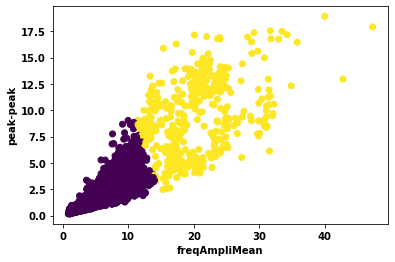

freqAmpliMean rms


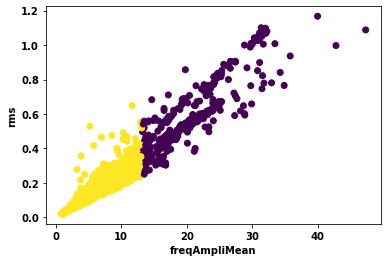

freqAmpliMean skewness


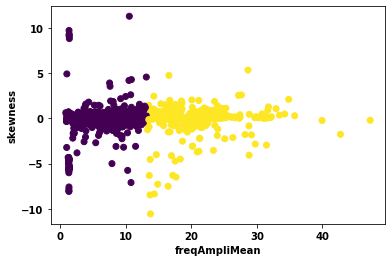

freqAmpliMean var_1


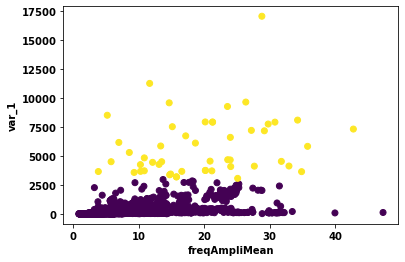

freqAmpliMean var_2


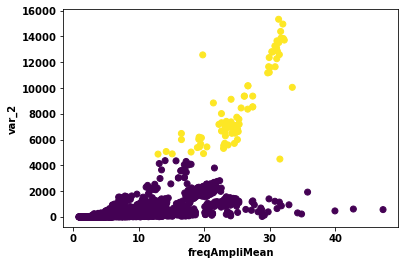

freqAmpliMean var_3


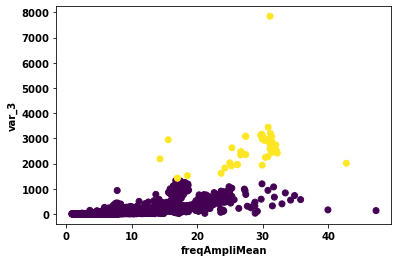

freqAmpliMean var_4


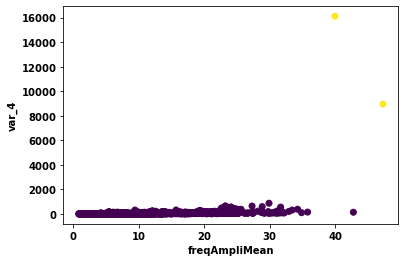

freqAmpliMean var_5


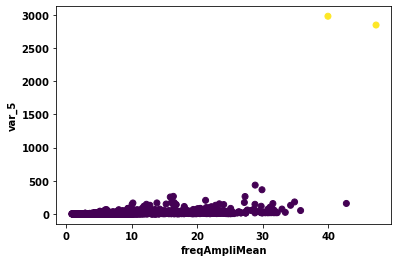

freqAmpliMean var_6


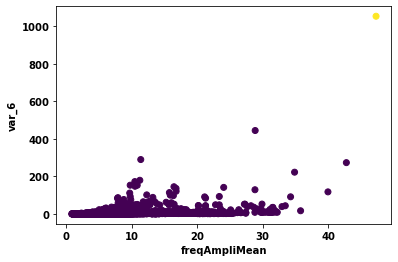

freqAmpliMean var_7


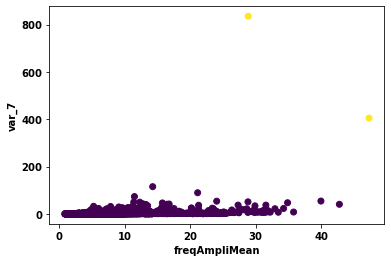

freqAmpliMean var_8


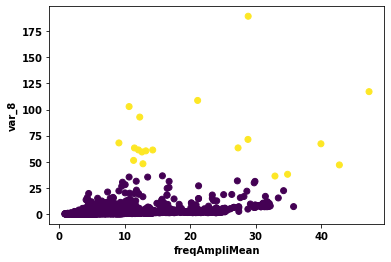

freqAmpliMean variance


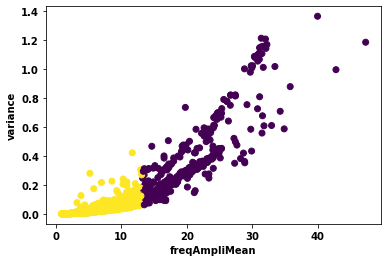

freqAmpliVar crest


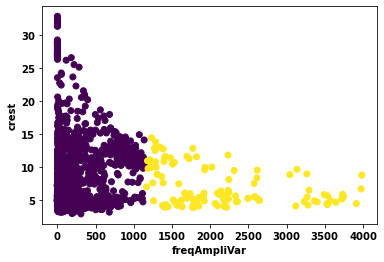

freqAmpliVar freqAmpliKurt


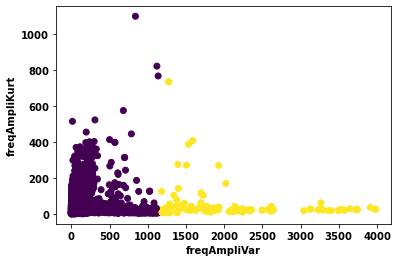

freqAmpliVar freqAmpliMax


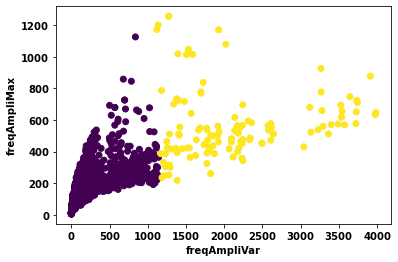

freqAmpliVar freqAmpliMean


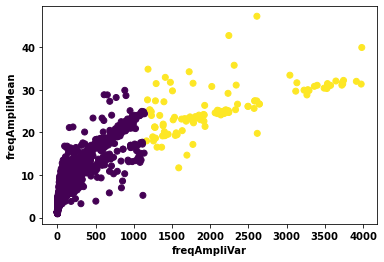

freqAmpliVar freqAmpliskw


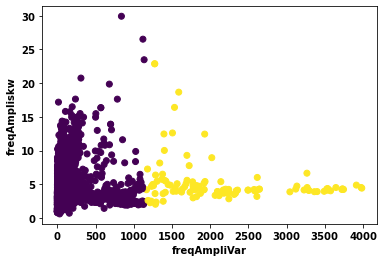

freqAmpliVar kurt


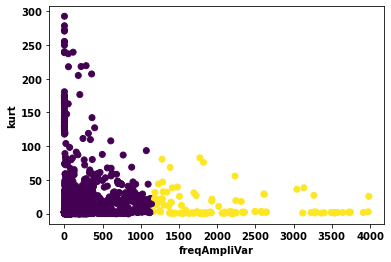

freqAmpliVar max_1


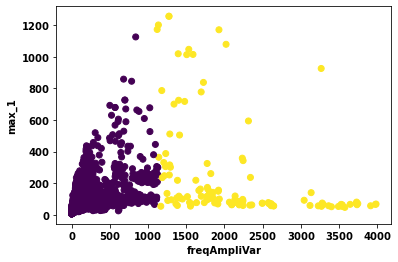

freqAmpliVar max_2


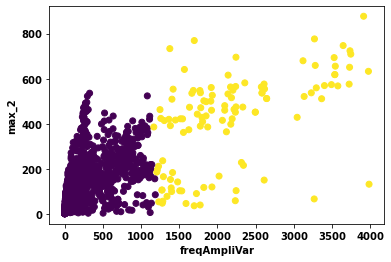

freqAmpliVar max_3


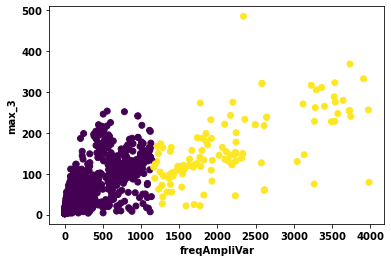

freqAmpliVar max_4


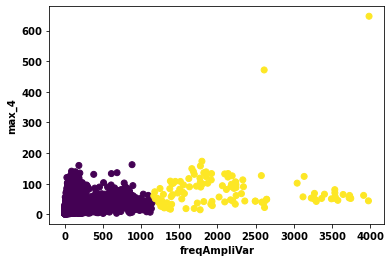

freqAmpliVar max_5


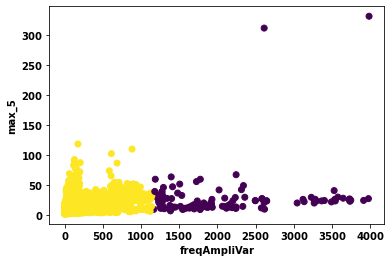

freqAmpliVar max_6


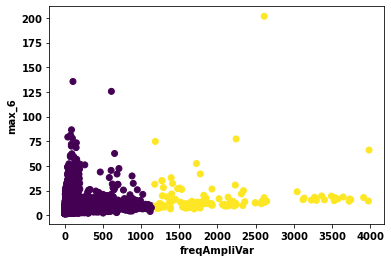

freqAmpliVar max_7


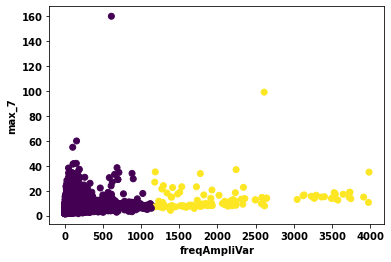

freqAmpliVar max_8


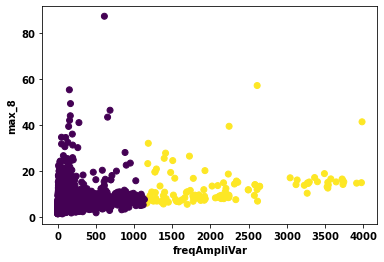

freqAmpliVar mean


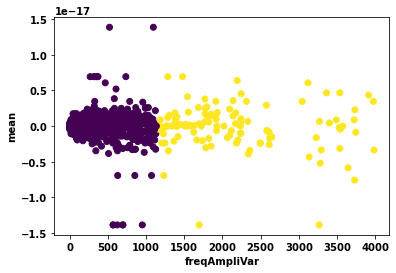

freqAmpliVar mean_1


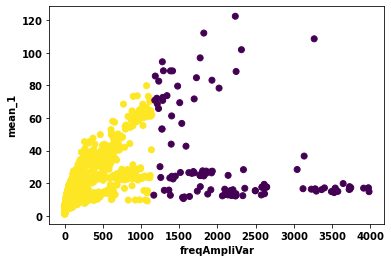

freqAmpliVar mean_2


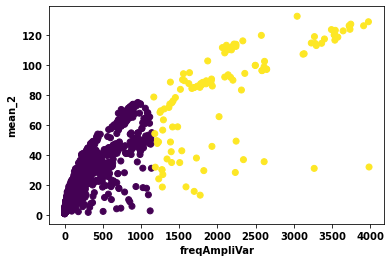

freqAmpliVar mean_3


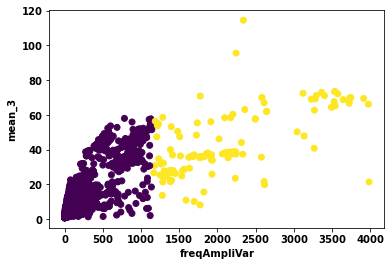

freqAmpliVar mean_4


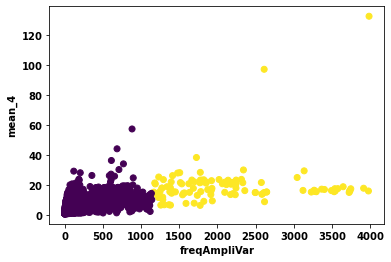

freqAmpliVar mean_5


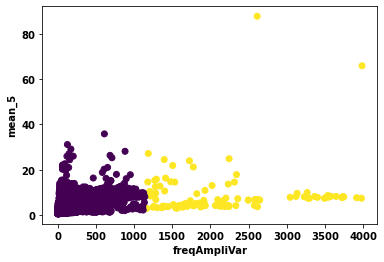

freqAmpliVar mean_6


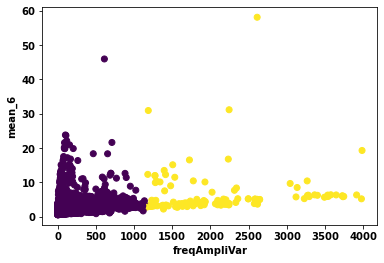

freqAmpliVar mean_7


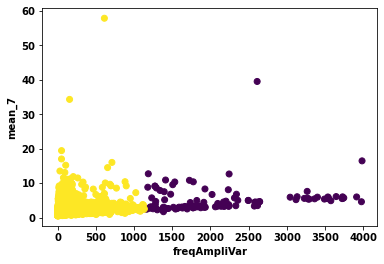

freqAmpliVar mean_8


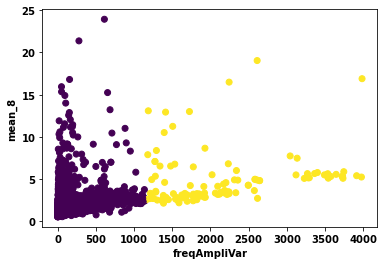

freqAmpliVar peak-peak


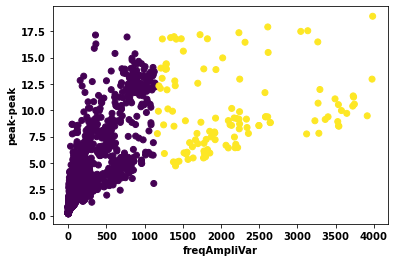

freqAmpliVar rms


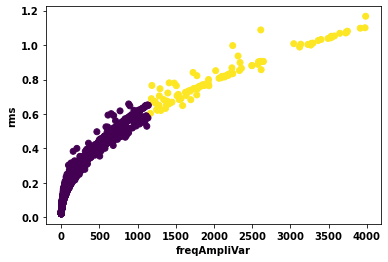

freqAmpliVar skewness


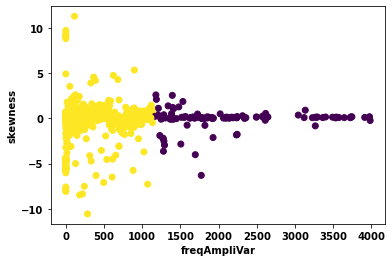

freqAmpliVar var_1


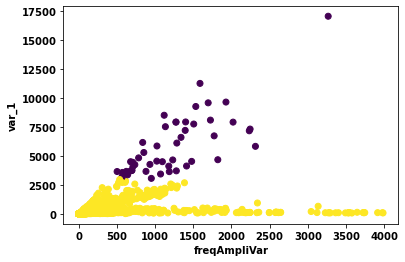

freqAmpliVar var_2


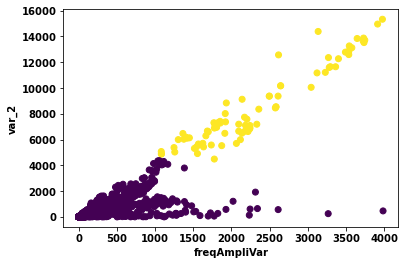

freqAmpliVar var_3


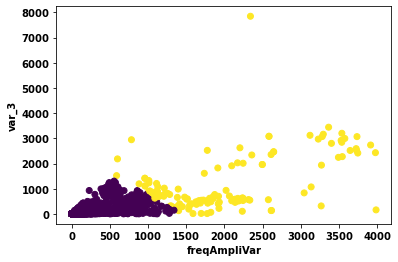

freqAmpliVar var_4


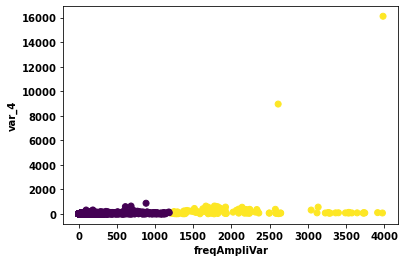

freqAmpliVar var_5


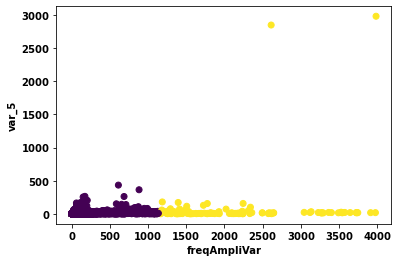

freqAmpliVar var_6


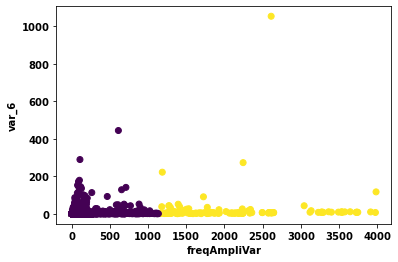

freqAmpliVar var_7


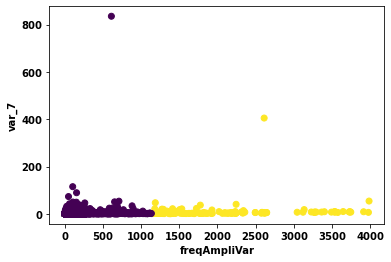

freqAmpliVar var_8


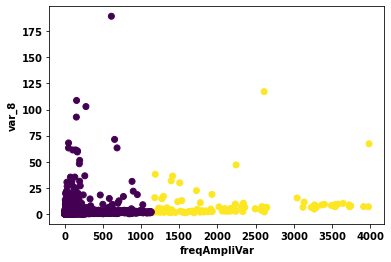

freqAmpliVar variance


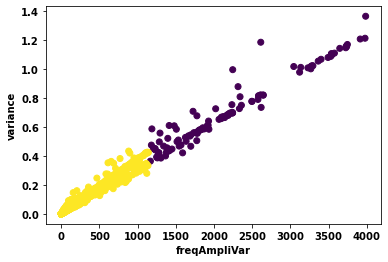

freqAmpliskw crest


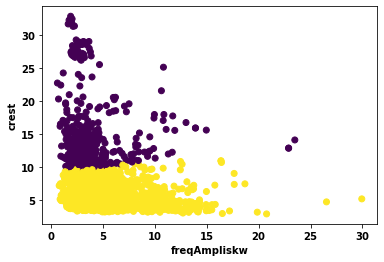

freqAmpliskw freqAmpliKurt


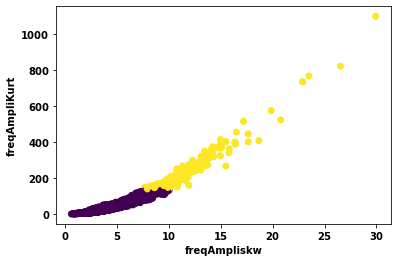

freqAmpliskw freqAmpliMax


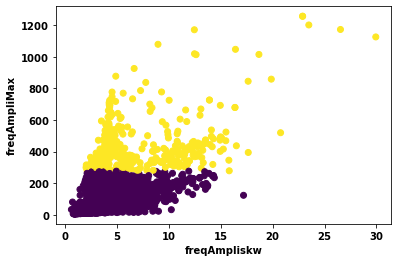

freqAmpliskw freqAmpliMean


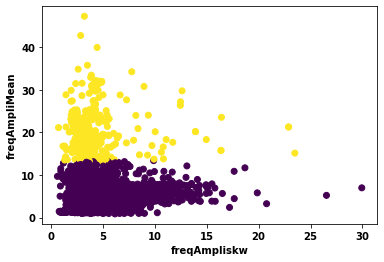

freqAmpliskw freqAmpliVar


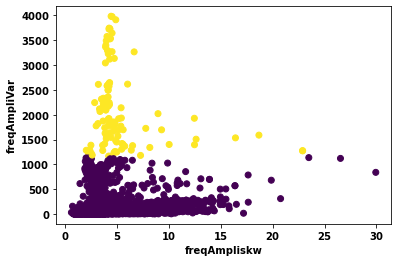

freqAmpliskw kurt


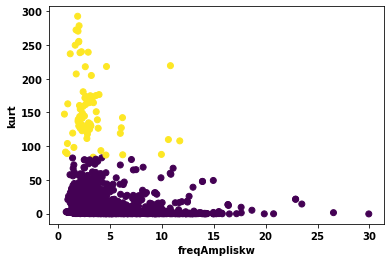

freqAmpliskw max_1


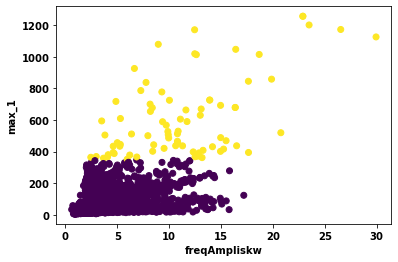

freqAmpliskw max_2


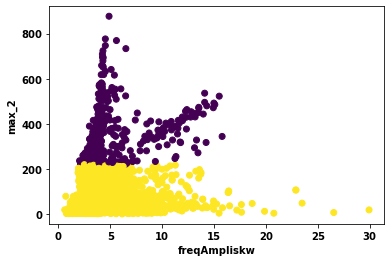

freqAmpliskw max_3


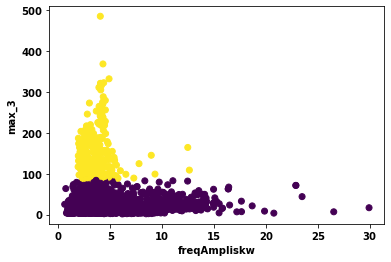

freqAmpliskw max_4


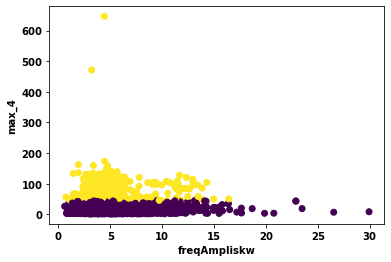

freqAmpliskw max_5


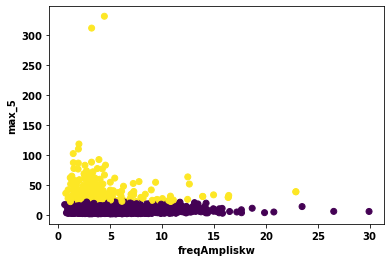

freqAmpliskw max_6


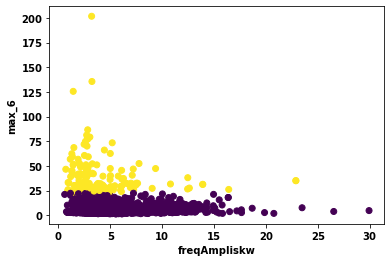

freqAmpliskw max_7


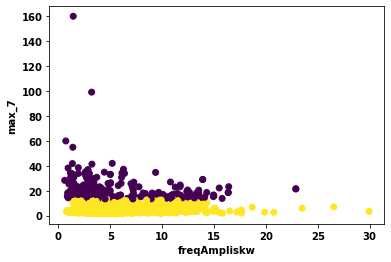

freqAmpliskw max_8


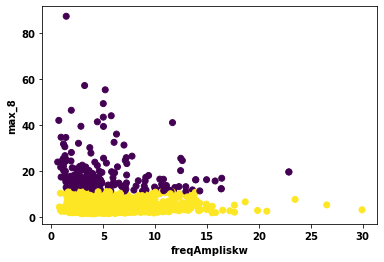

freqAmpliskw mean


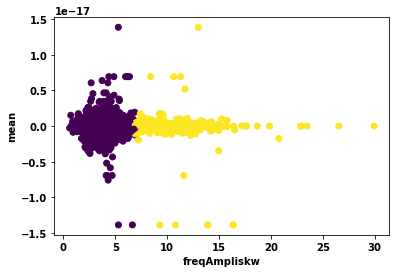

freqAmpliskw mean_1


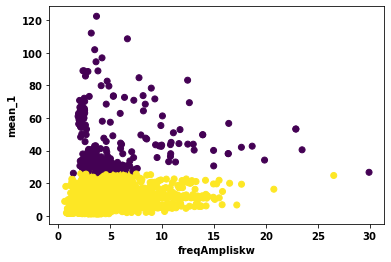

freqAmpliskw mean_2


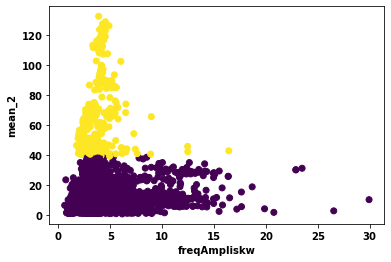

freqAmpliskw mean_3


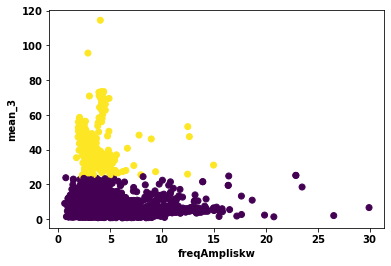

freqAmpliskw mean_4


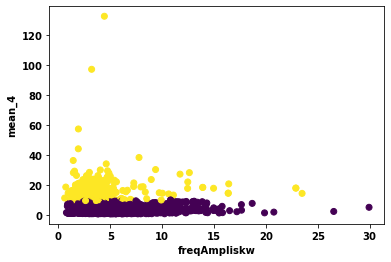

freqAmpliskw mean_5


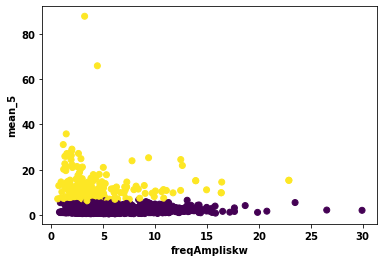

freqAmpliskw mean_6


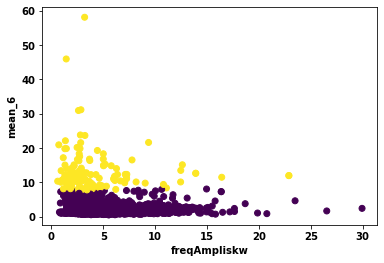

freqAmpliskw mean_7


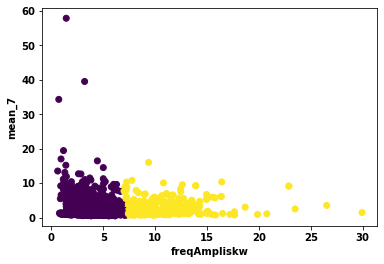

freqAmpliskw mean_8


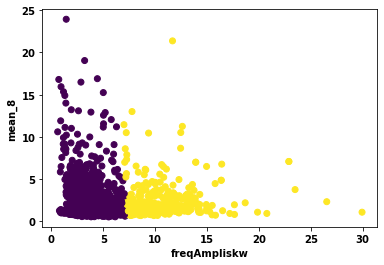

freqAmpliskw peak-peak


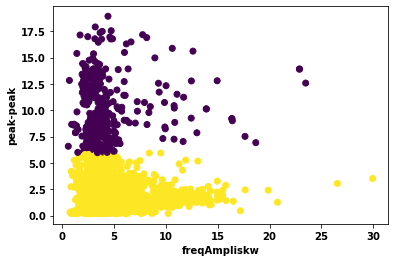

freqAmpliskw rms


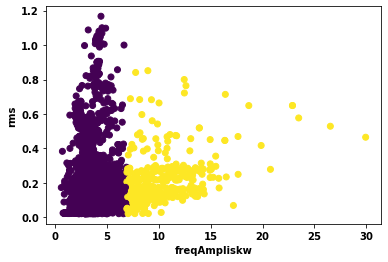

freqAmpliskw skewness


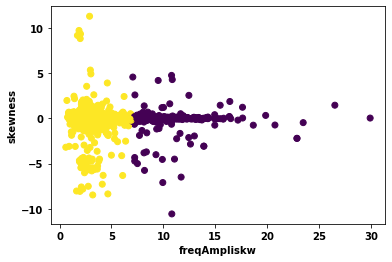

freqAmpliskw var_1


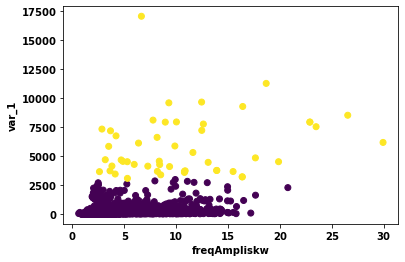

freqAmpliskw var_2


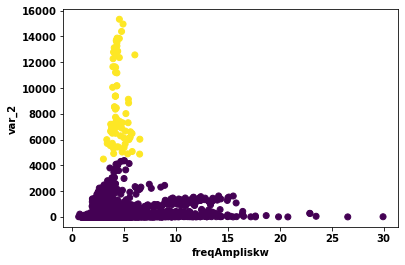

freqAmpliskw var_3


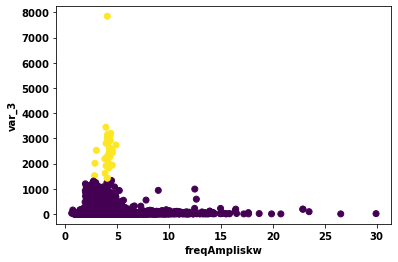

freqAmpliskw var_4


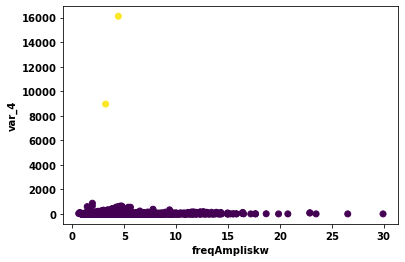

freqAmpliskw var_5


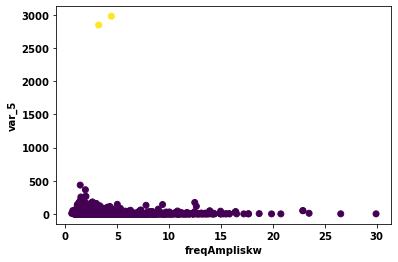

freqAmpliskw var_6


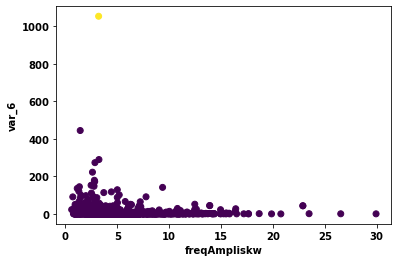

freqAmpliskw var_7


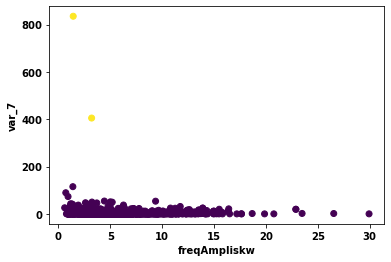

freqAmpliskw var_8


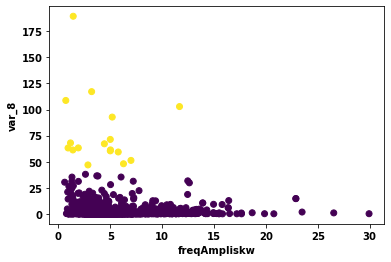

freqAmpliskw variance


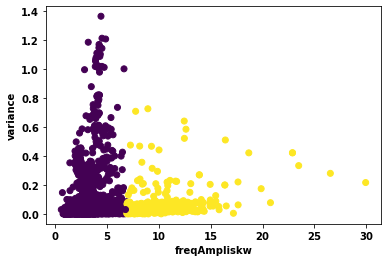

kurt crest


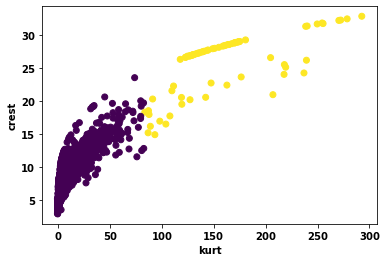

kurt freqAmpliKurt


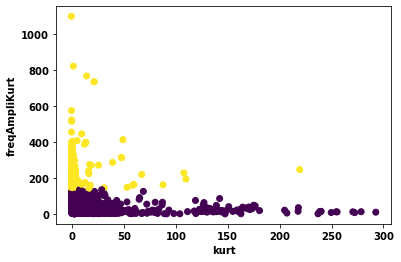

kurt freqAmpliMax


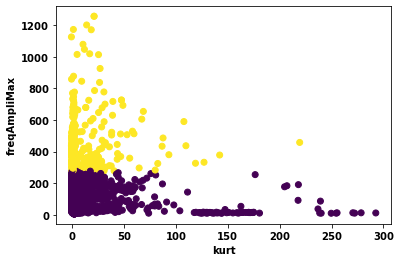

kurt freqAmpliMean


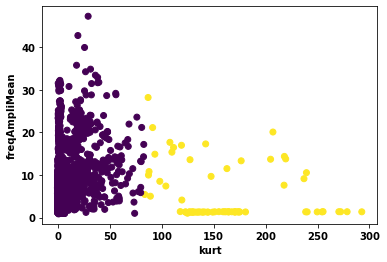

kurt freqAmpliVar


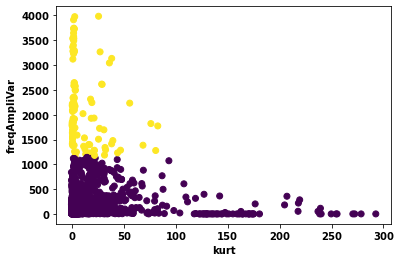

kurt freqAmpliskw


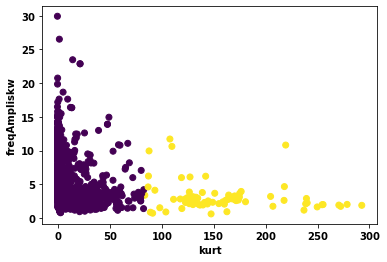

kurt max_1


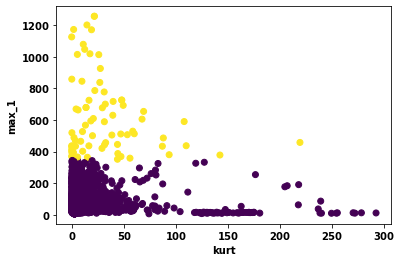

kurt max_2


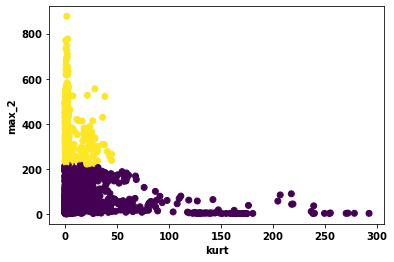

kurt max_3


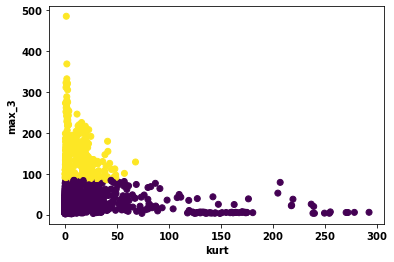

kurt max_4


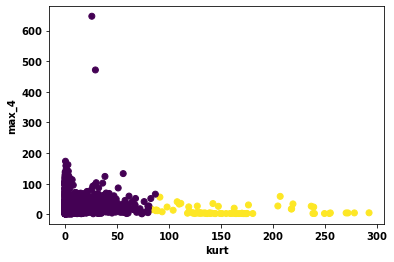

kurt max_5


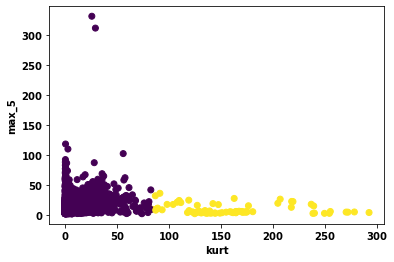

kurt max_6


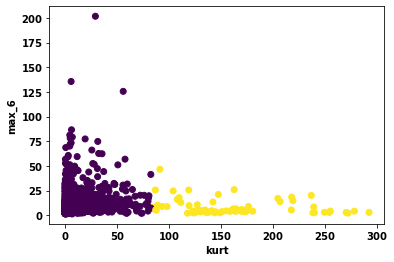

kurt max_7


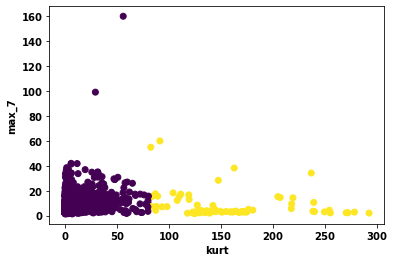

kurt max_8


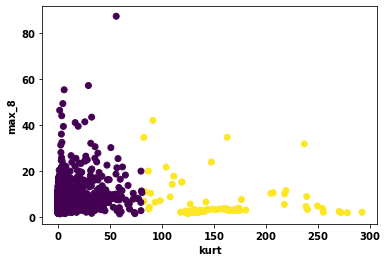

kurt mean


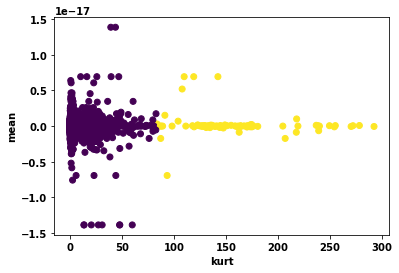

kurt mean_1


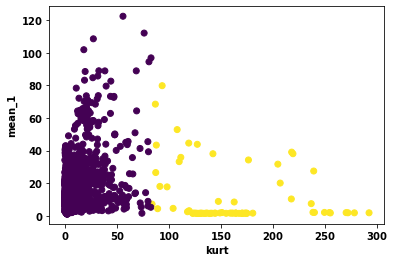

kurt mean_2


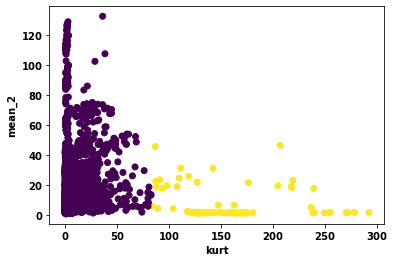

kurt mean_3


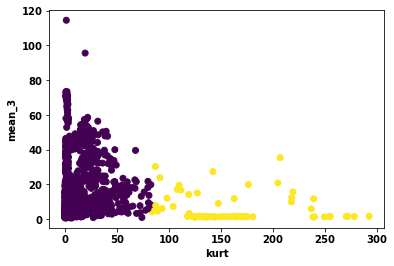

kurt mean_4


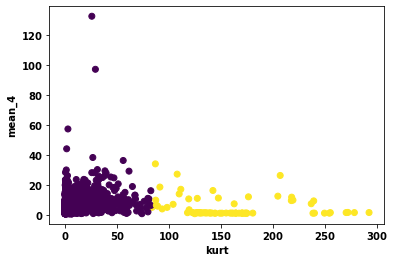

kurt mean_5


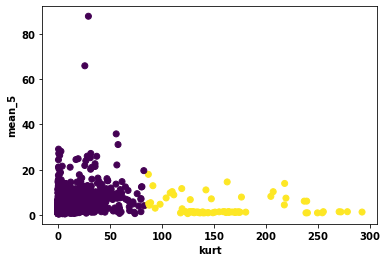

kurt mean_6


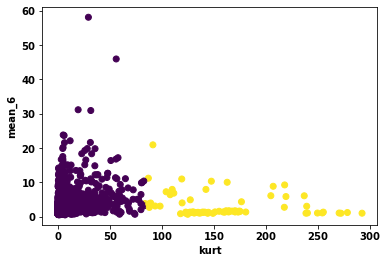

kurt mean_7


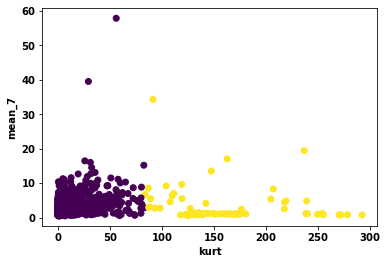

kurt mean_8


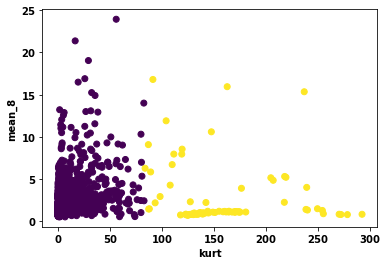

kurt peak-peak


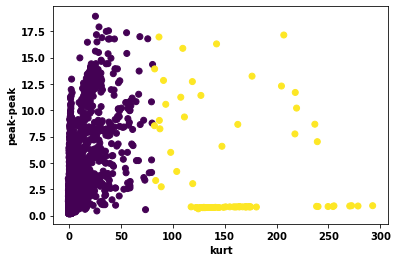

kurt rms


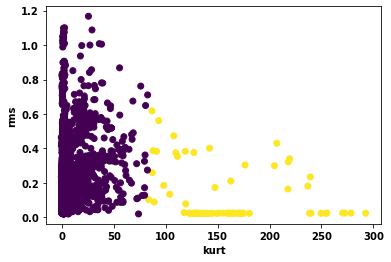

kurt skewness


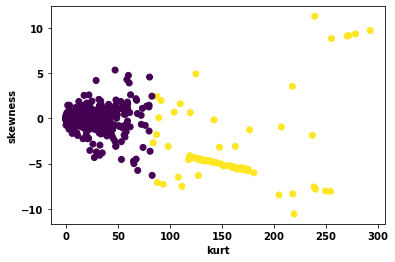

kurt var_1


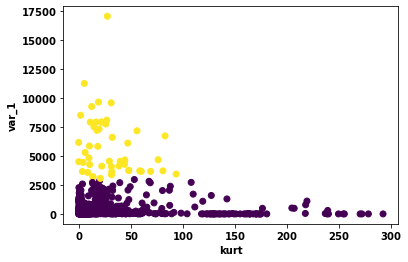

kurt var_2


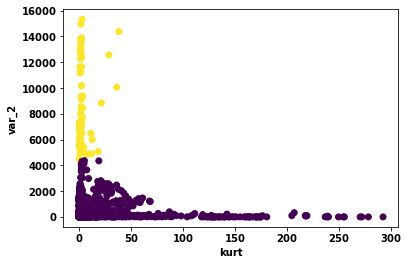

kurt var_3


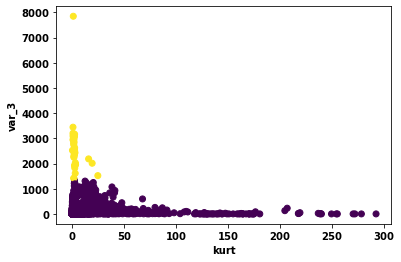

kurt var_4


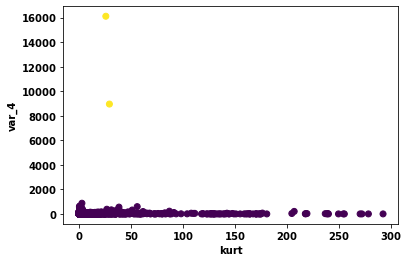

kurt var_5


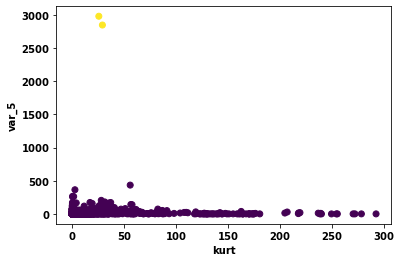

kurt var_6


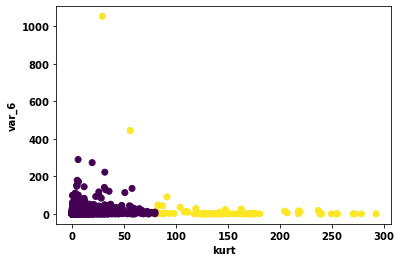

kurt var_7


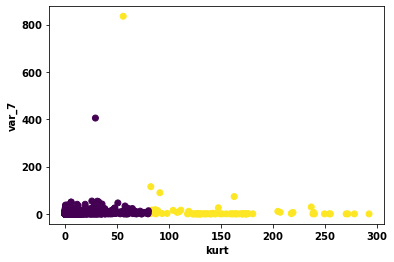

kurt var_8


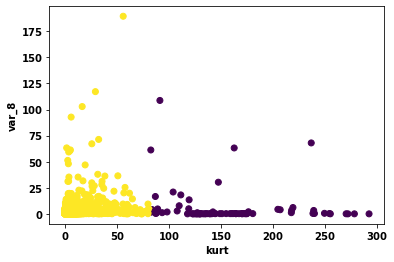

kurt variance


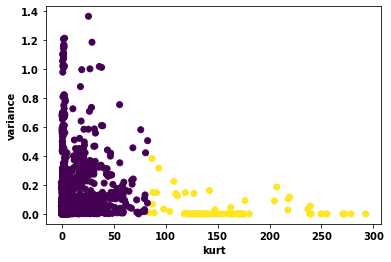

max_1 crest


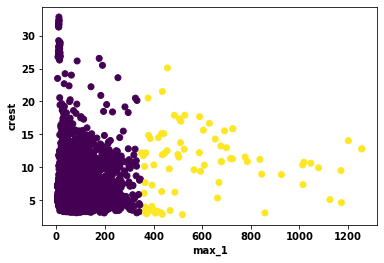

max_1 freqAmpliKurt


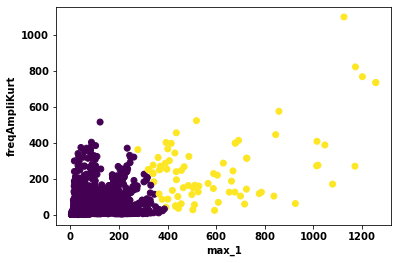

max_1 freqAmpliMax


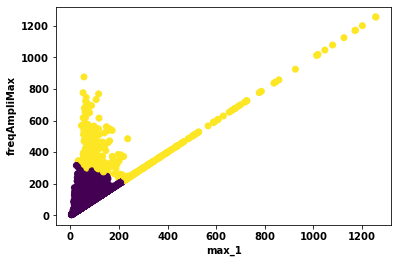

max_1 freqAmpliMean


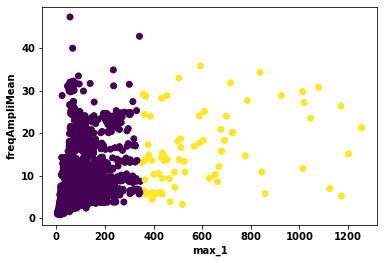

max_1 freqAmpliVar


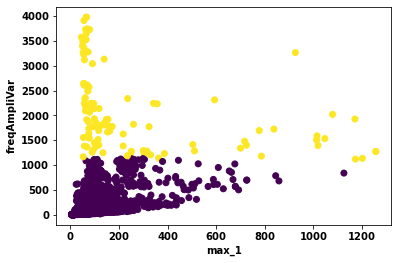

max_1 freqAmpliskw


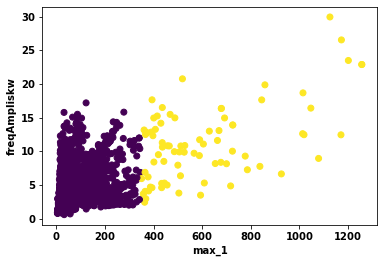

max_1 kurt


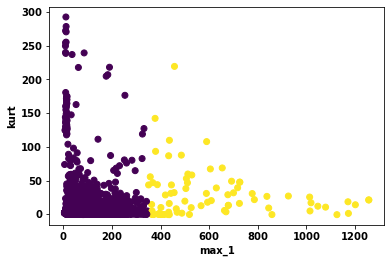

max_1 max_2


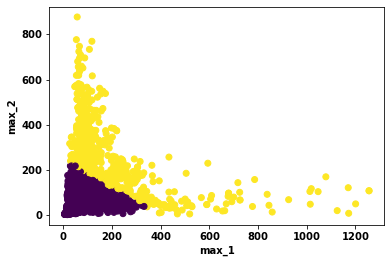

max_1 max_3


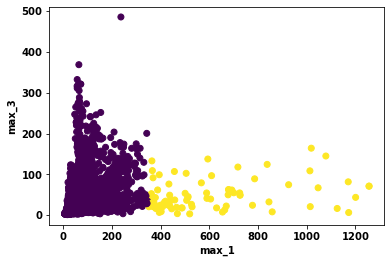

max_1 max_4


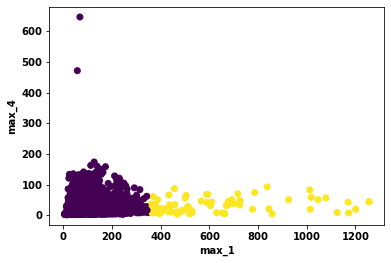

max_1 max_5


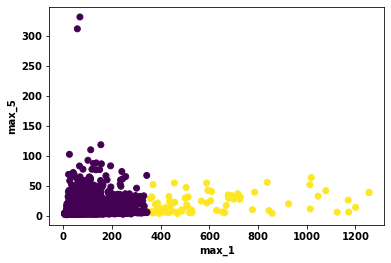

max_1 max_6


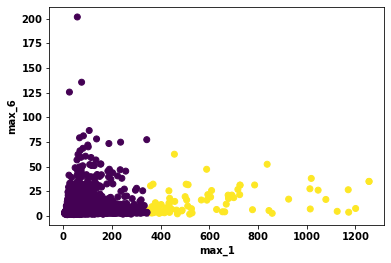

max_1 max_7


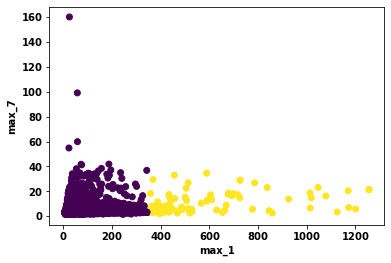

max_1 max_8


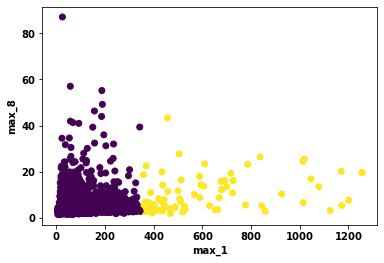

max_1 mean


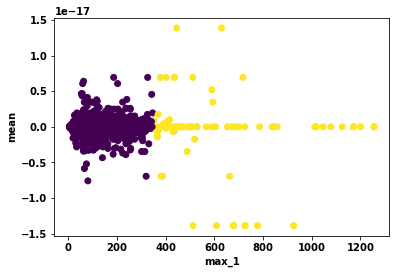

max_1 mean_1


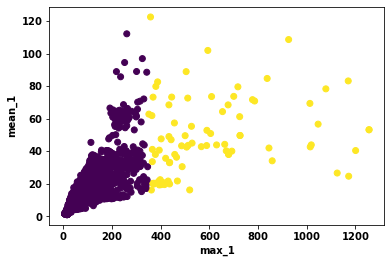

max_1 mean_2


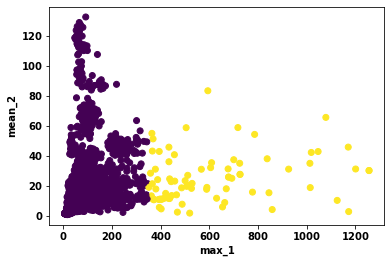

max_1 mean_3


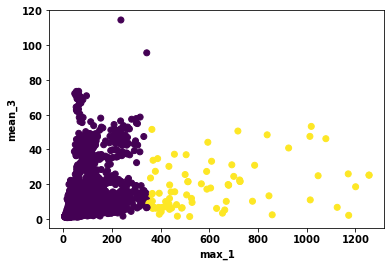

max_1 mean_4


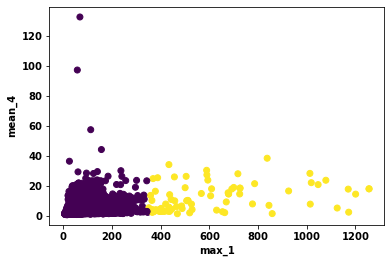

max_1 mean_5


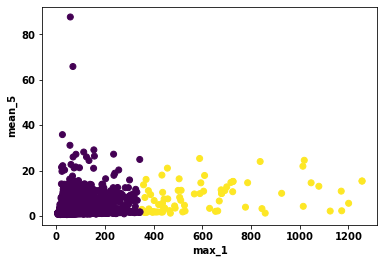

max_1 mean_6


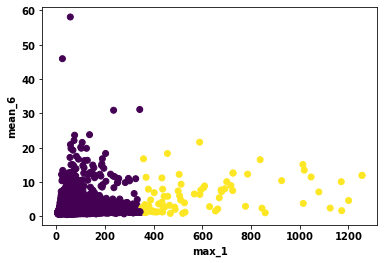

max_1 mean_7


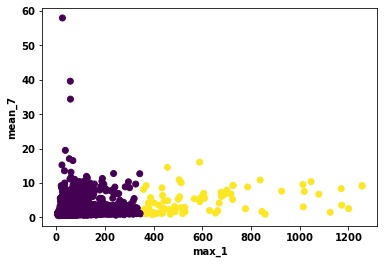

max_1 mean_8


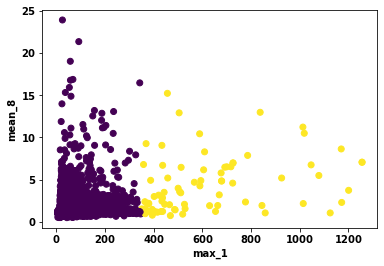

max_1 peak-peak


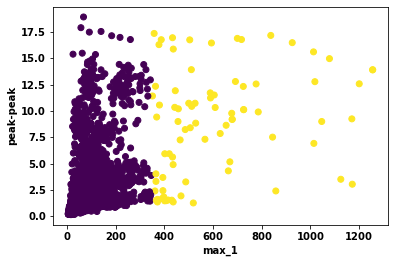

max_1 rms


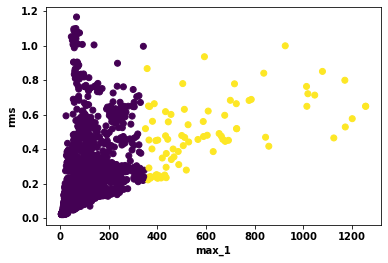

max_1 skewness


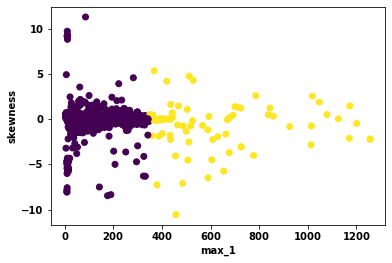

max_1 var_1


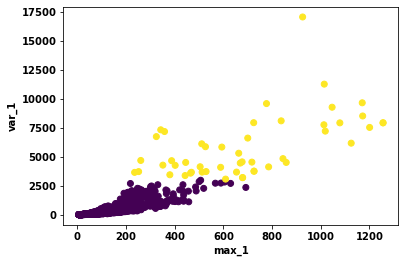

max_1 var_2


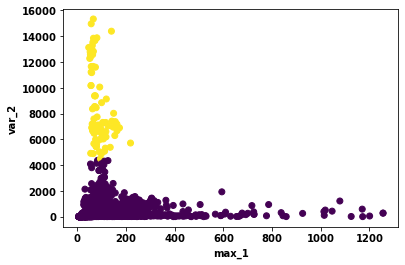

max_1 var_3


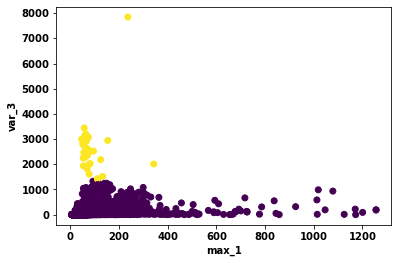

max_1 var_4


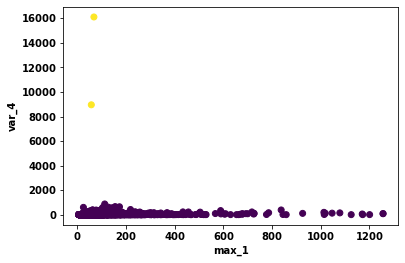

max_1 var_5


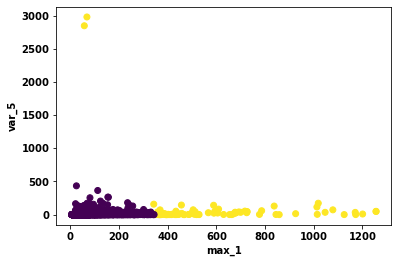

max_1 var_6


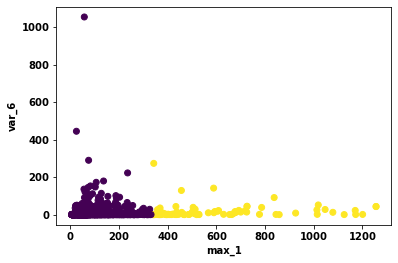

max_1 var_7


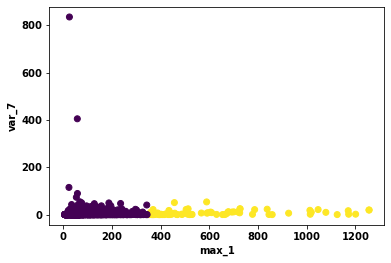

max_1 var_8


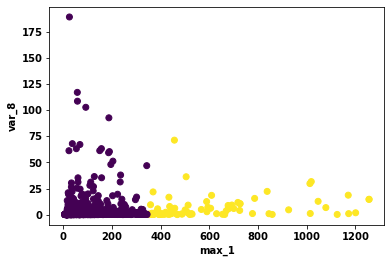

max_1 variance


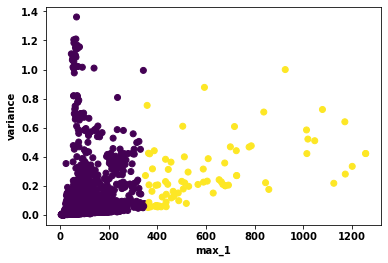

max_2 crest


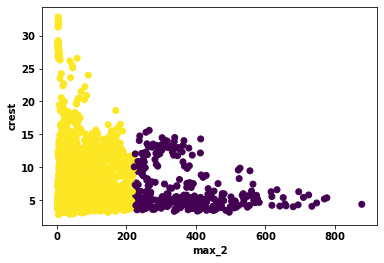

max_2 freqAmpliKurt


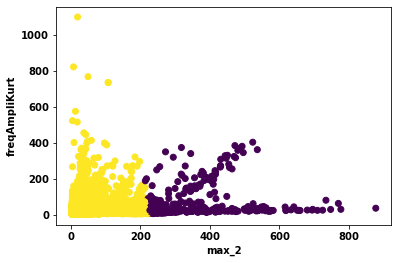

max_2 freqAmpliMax


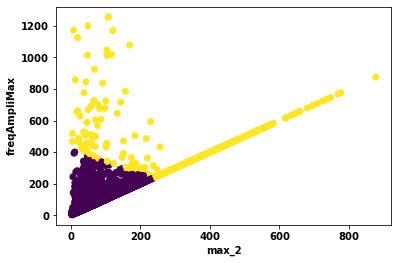

max_2 freqAmpliMean


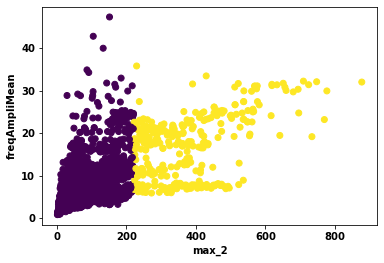

max_2 freqAmpliVar


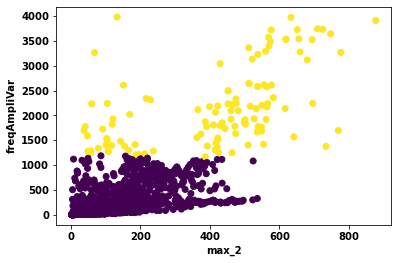

max_2 freqAmpliskw


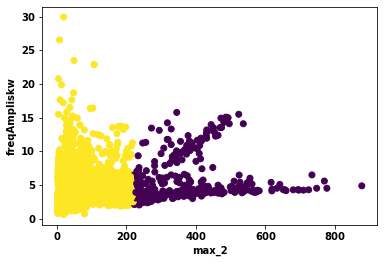

max_2 kurt


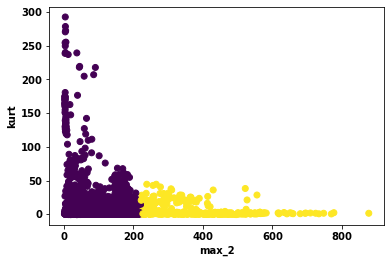

max_2 max_1


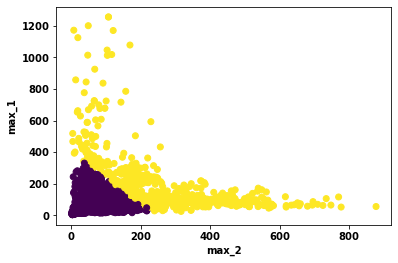

max_2 max_3


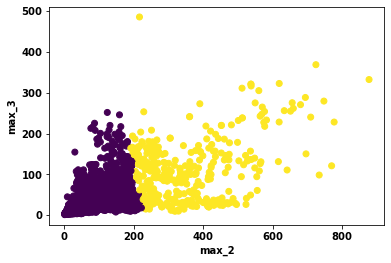

max_2 max_4


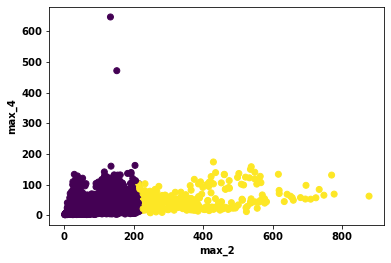

max_2 max_5


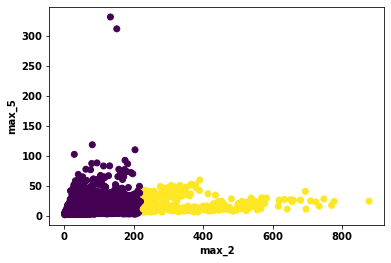

max_2 max_6


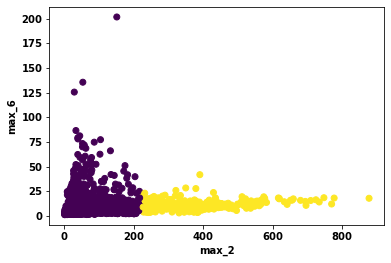

max_2 max_7


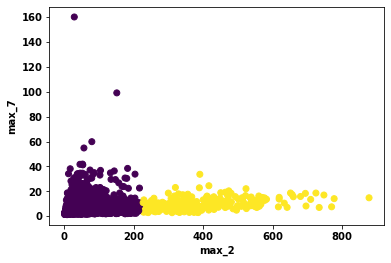

max_2 max_8


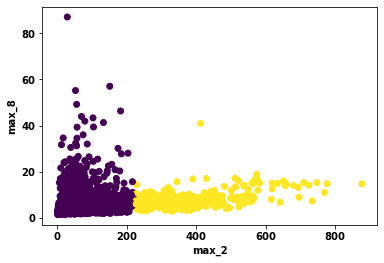

max_2 mean


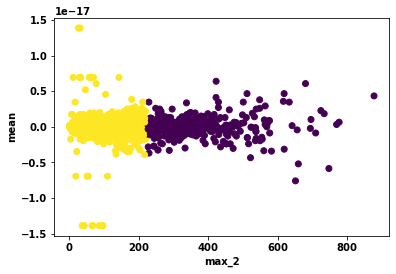

max_2 mean_1


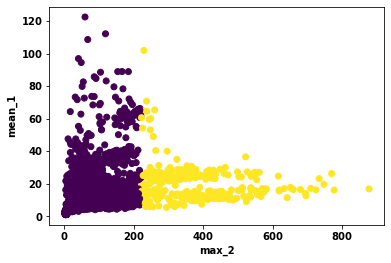

max_2 mean_2


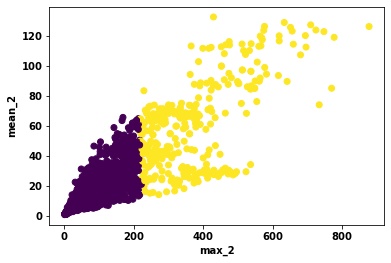

max_2 mean_3


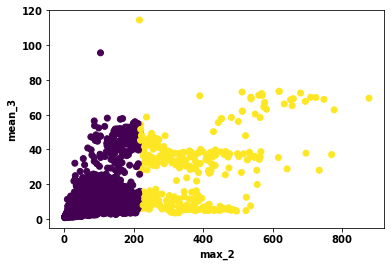

max_2 mean_4


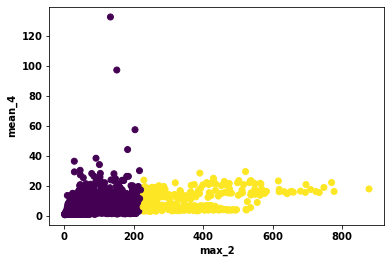

max_2 mean_5


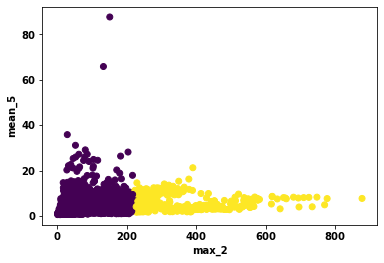

max_2 mean_6


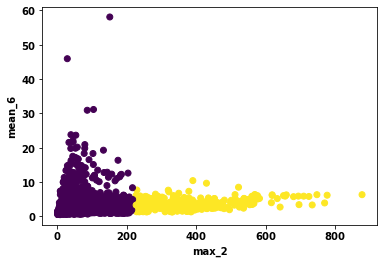

max_2 mean_7


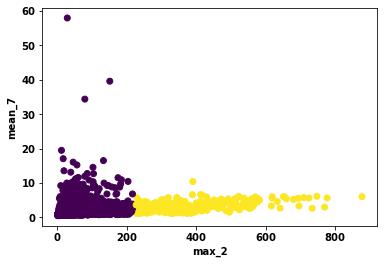

max_2 mean_8


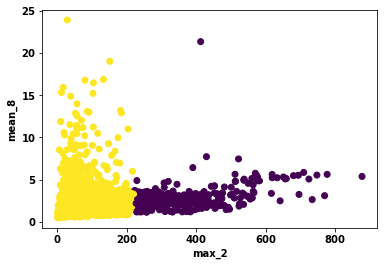

max_2 peak-peak


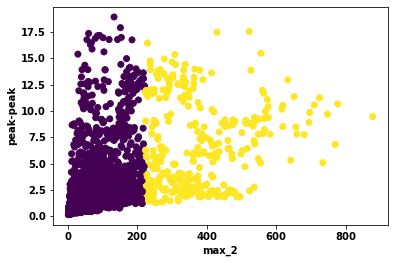

max_2 rms


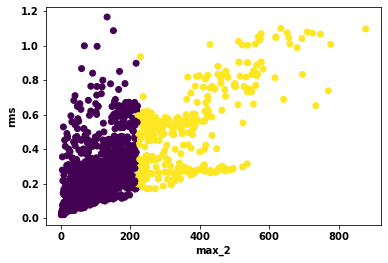

max_2 skewness


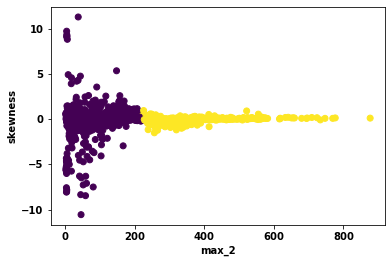

max_2 var_1


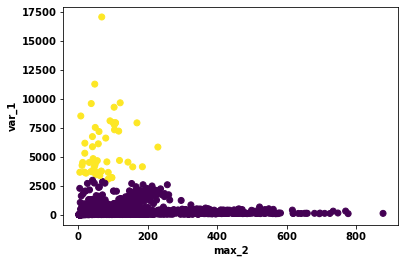

max_2 var_2


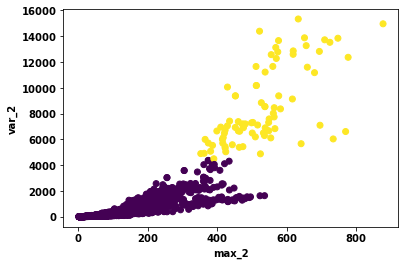

max_2 var_3


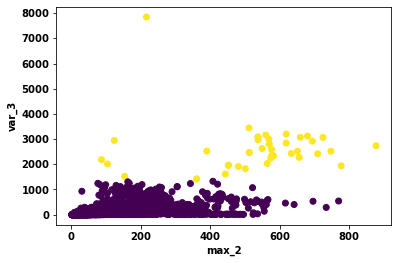

max_2 var_4


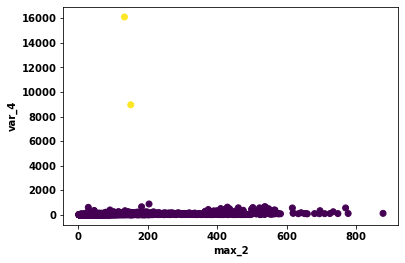

max_2 var_5


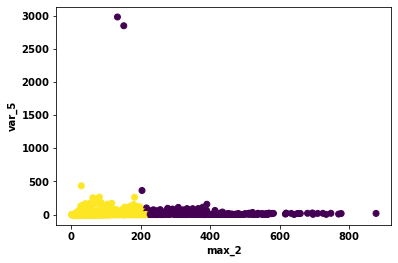

max_2 var_6


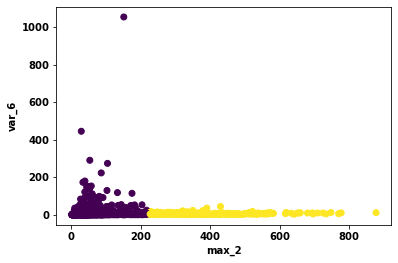

max_2 var_7


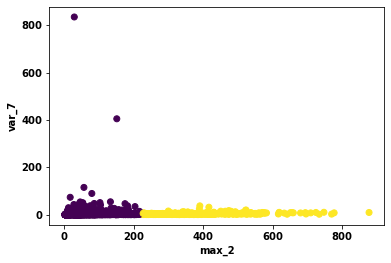

max_2 var_8


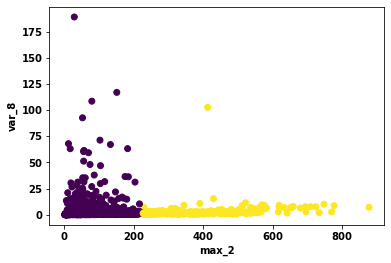

max_2 variance


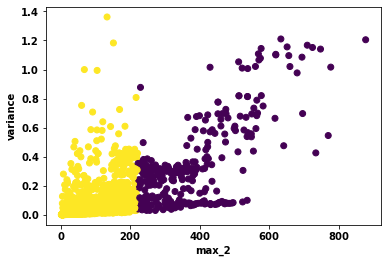

max_3 crest


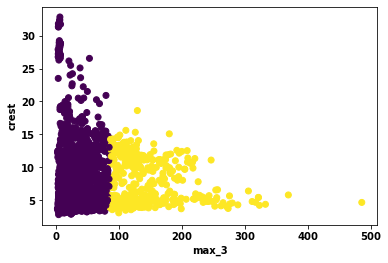

max_3 freqAmpliKurt


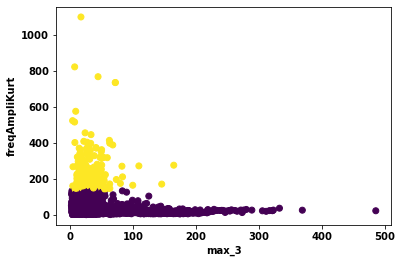

max_3 freqAmpliMax


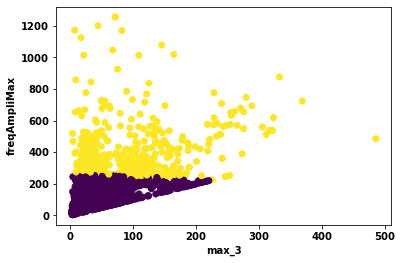

max_3 freqAmpliMean


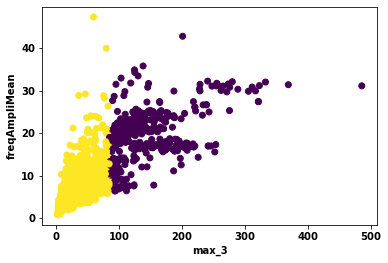

max_3 freqAmpliVar


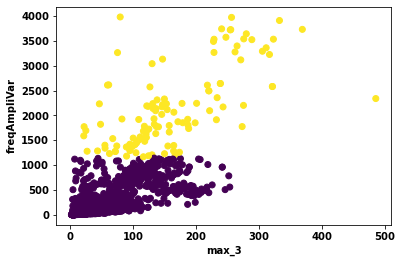

max_3 freqAmpliskw


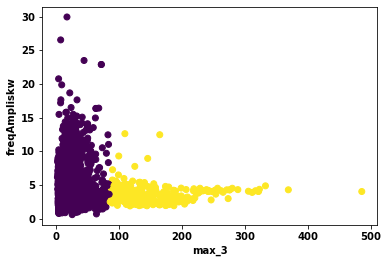

max_3 kurt


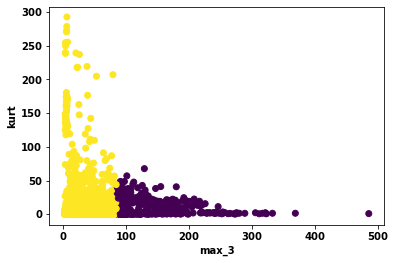

max_3 max_1


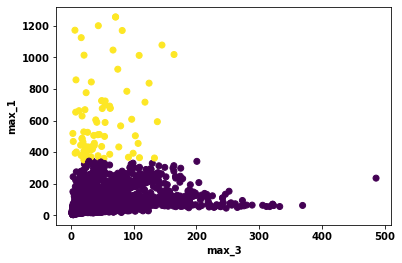

max_3 max_2


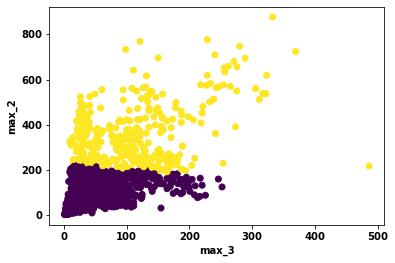

max_3 max_4


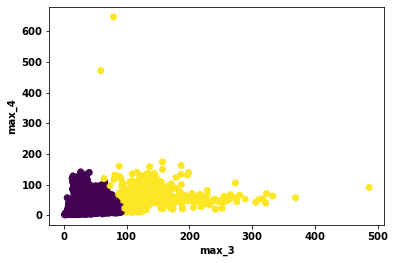

max_3 max_5


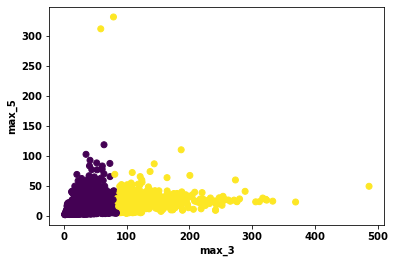

max_3 max_6


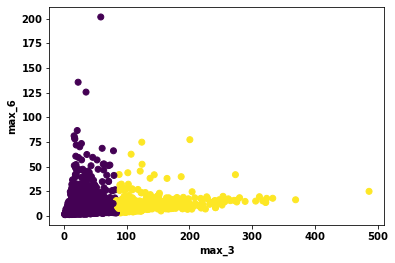

max_3 max_7


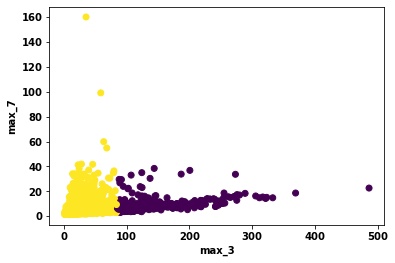

max_3 max_8


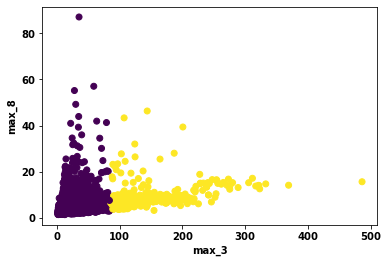

max_3 mean


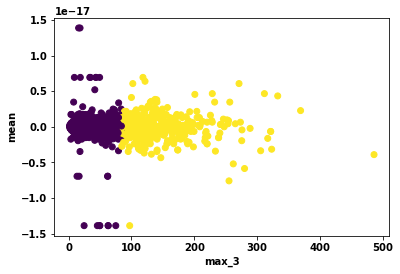

max_3 mean_1


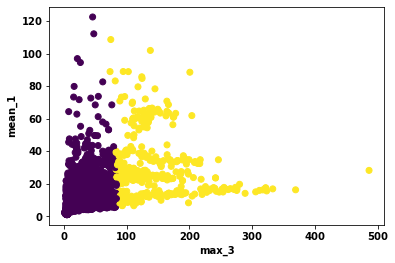

max_3 mean_2


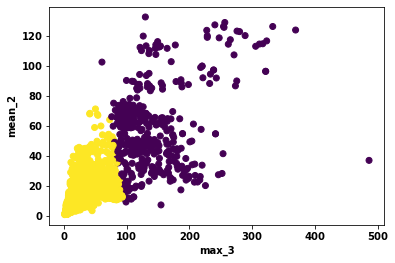

max_3 mean_3


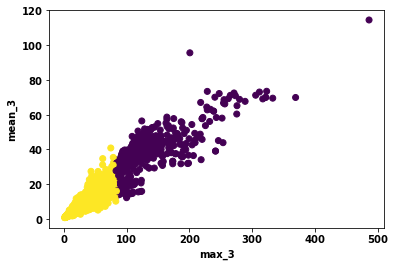

max_3 mean_4


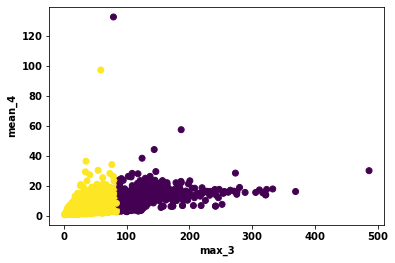

max_3 mean_5


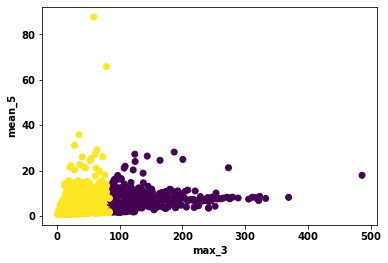

max_3 mean_6


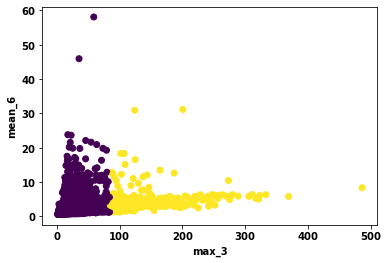

max_3 mean_7


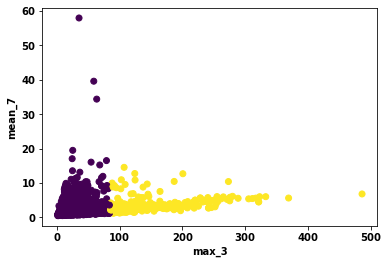

max_3 mean_8


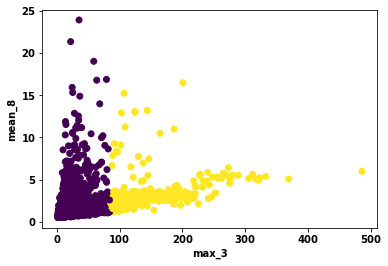

max_3 peak-peak


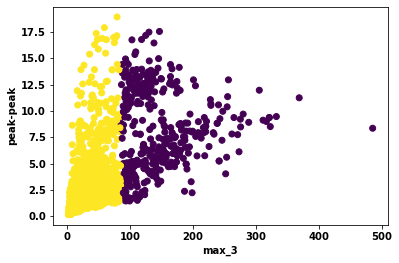

max_3 rms


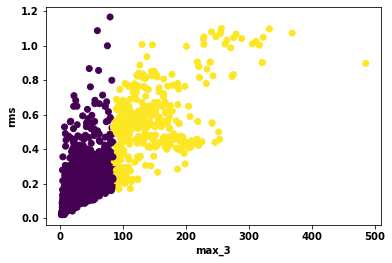

max_3 skewness


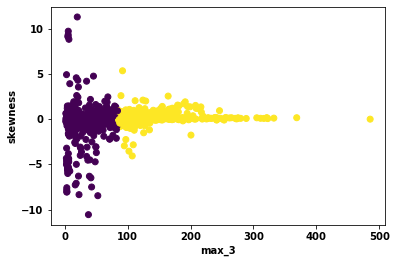

max_3 var_1


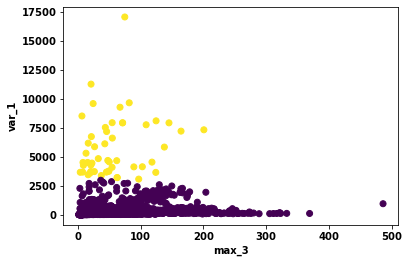

max_3 var_2


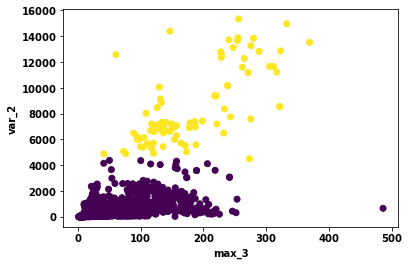

max_3 var_3


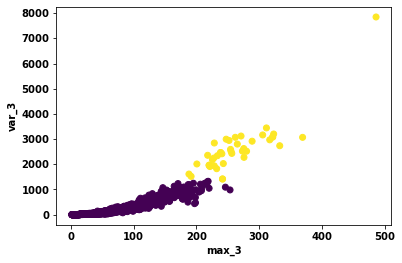

max_3 var_4


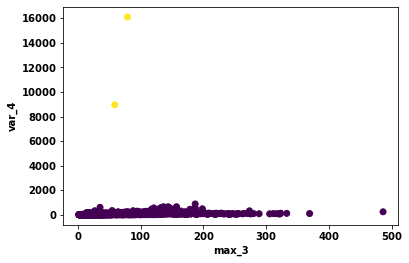

max_3 var_5


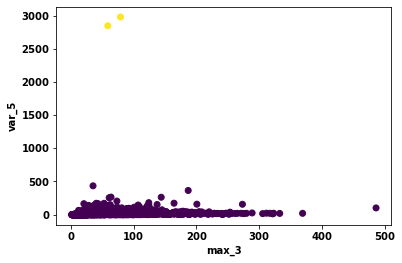

max_3 var_6


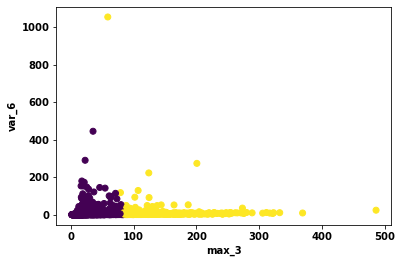

max_3 var_7


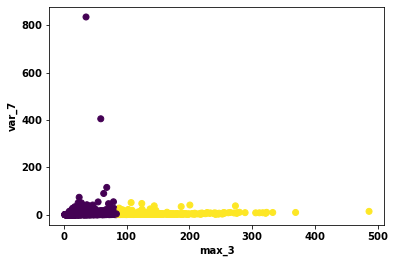

max_3 var_8


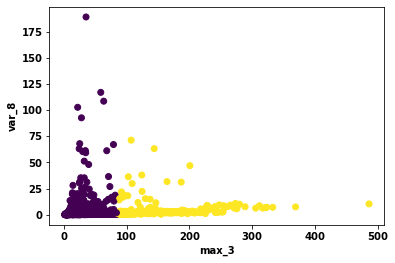

max_3 variance


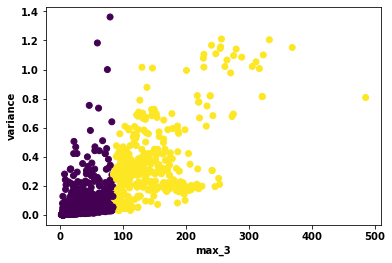

max_4 crest


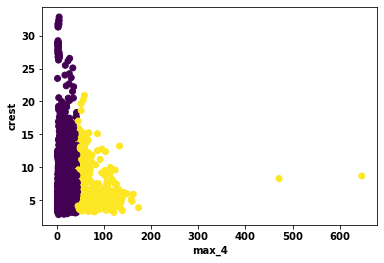

max_4 freqAmpliKurt


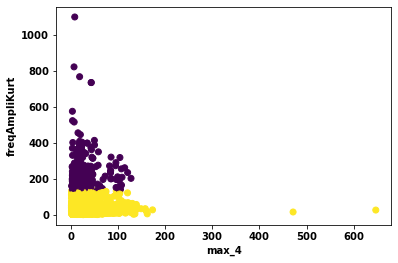

max_4 freqAmpliMax


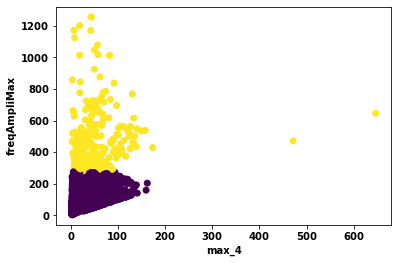

max_4 freqAmpliMean


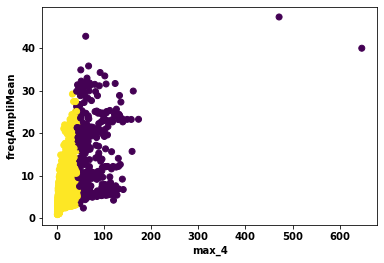

max_4 freqAmpliVar


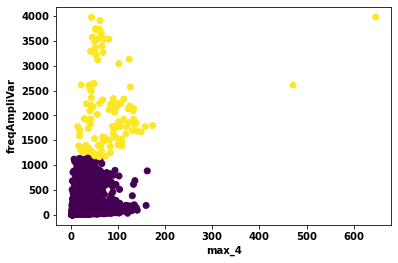

max_4 freqAmpliskw


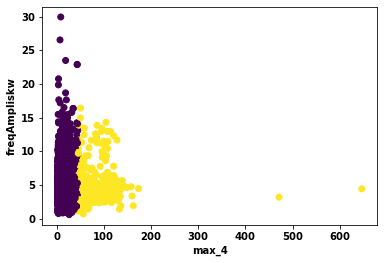

max_4 kurt


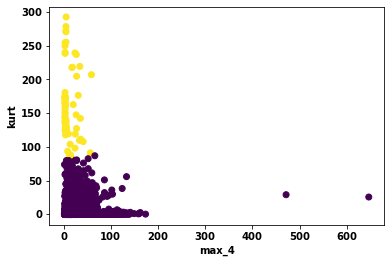

max_4 max_1


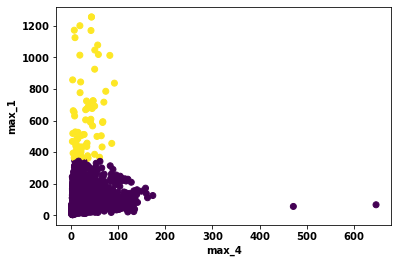

max_4 max_2


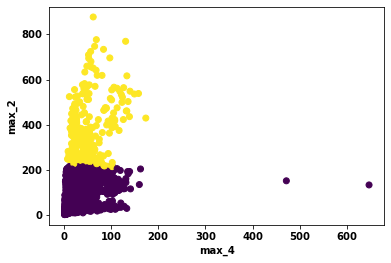

max_4 max_3


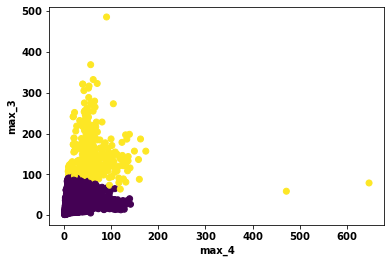

max_4 max_5


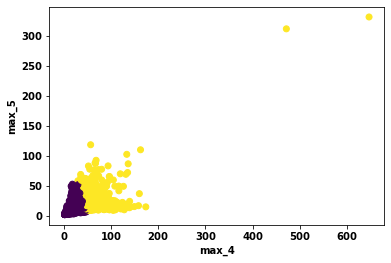

max_4 max_6


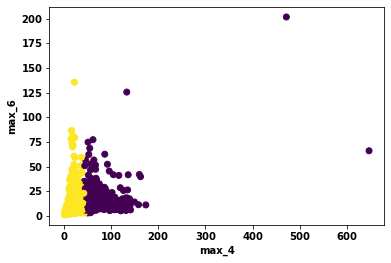

max_4 max_7


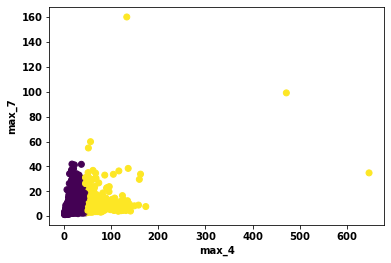

max_4 max_8


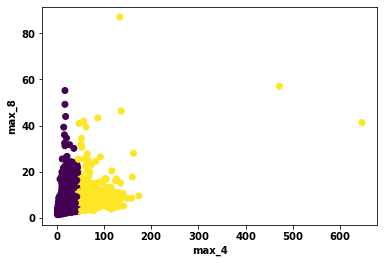

max_4 mean


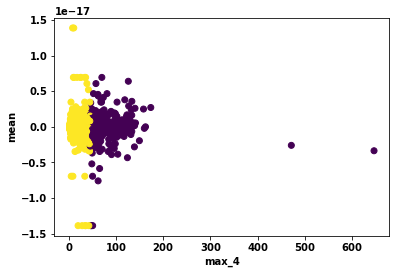

max_4 mean_1


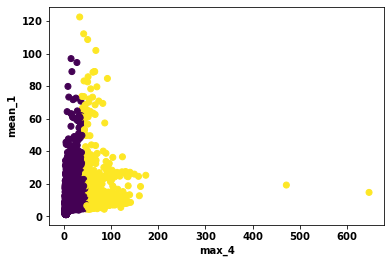

max_4 mean_2


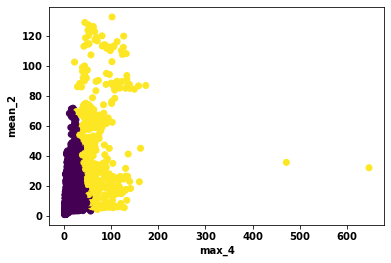

max_4 mean_3


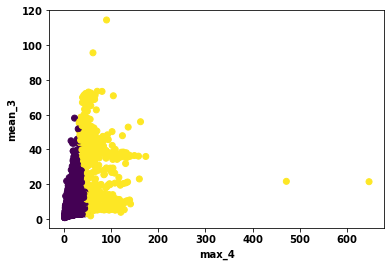

max_4 mean_4


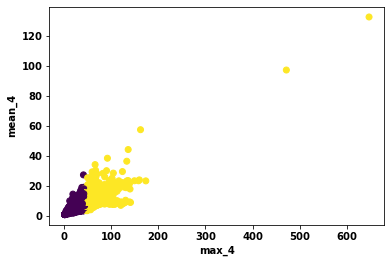

max_4 mean_5


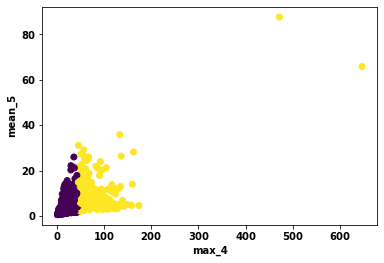

max_4 mean_6


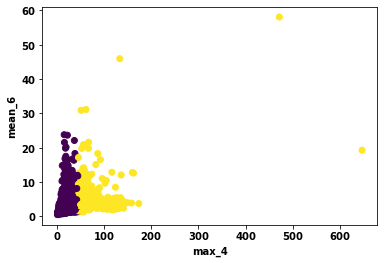

max_4 mean_7


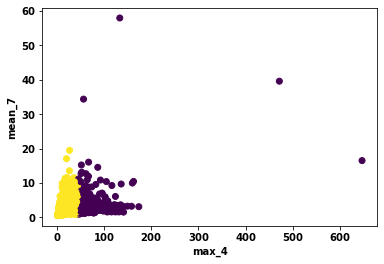

max_4 mean_8


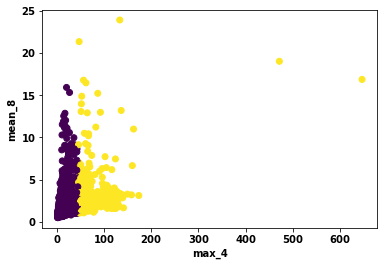

max_4 peak-peak


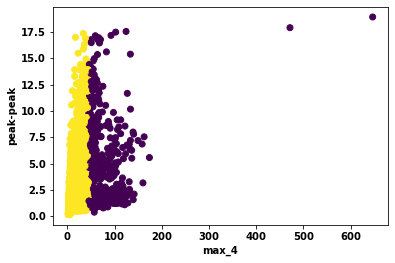

max_4 rms


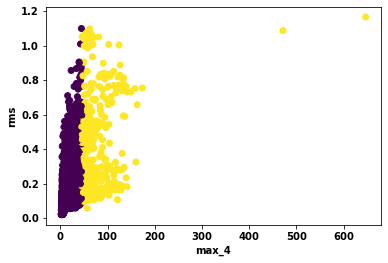

max_4 skewness


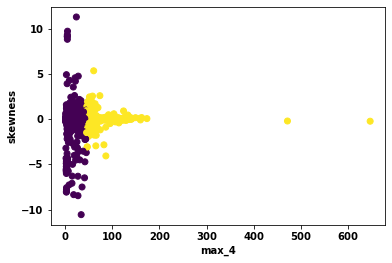

max_4 var_1


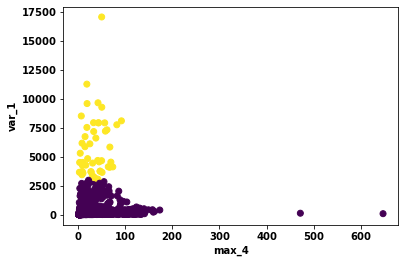

max_4 var_2


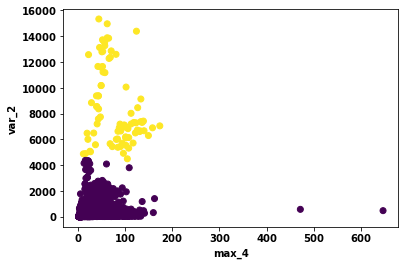

max_4 var_3


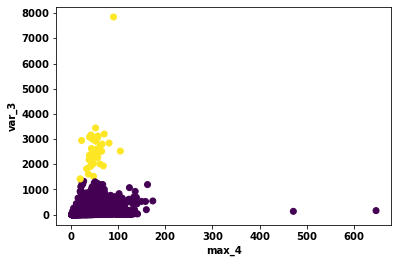

max_4 var_4


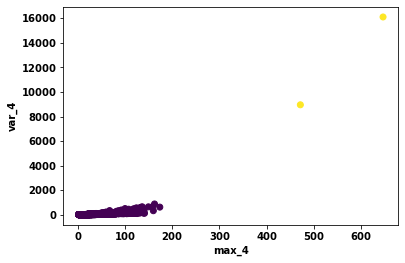

max_4 var_5


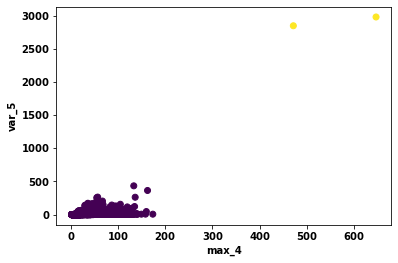

max_4 var_6


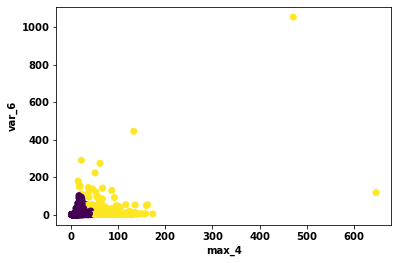

max_4 var_7


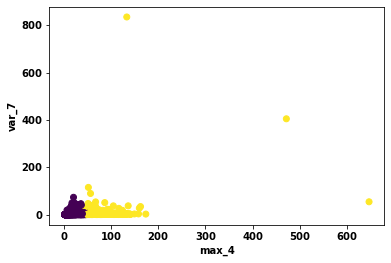

max_4 var_8


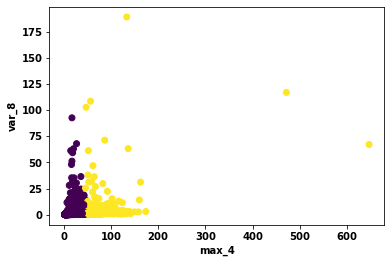

max_4 variance


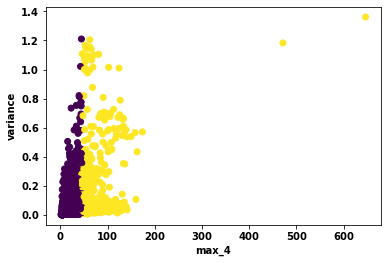

max_5 crest


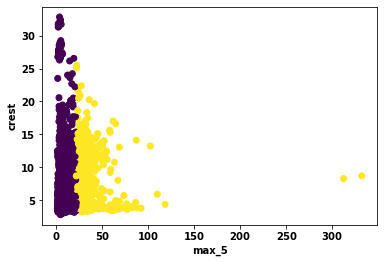

max_5 freqAmpliKurt


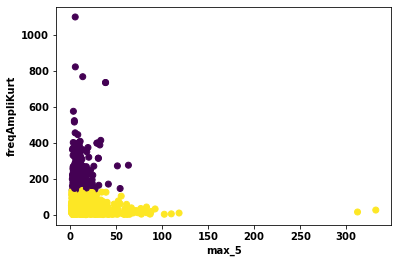

max_5 freqAmpliMax


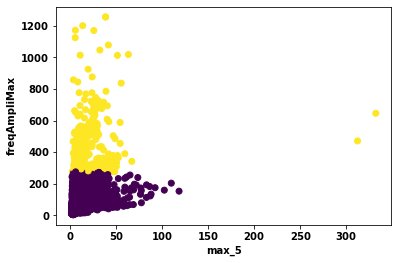

max_5 freqAmpliMean


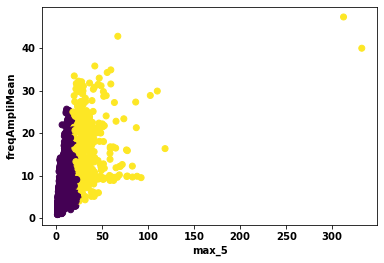

max_5 freqAmpliVar


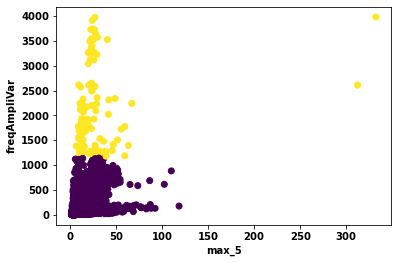

max_5 freqAmpliskw


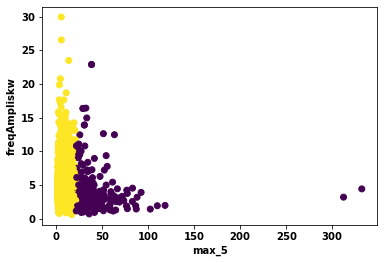

max_5 kurt


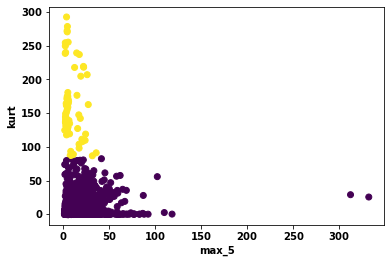

max_5 max_1


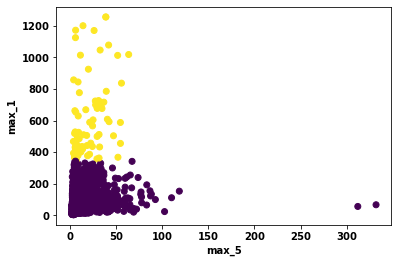

max_5 max_2


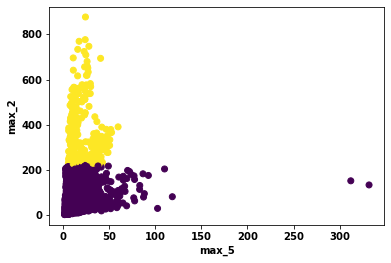

max_5 max_3


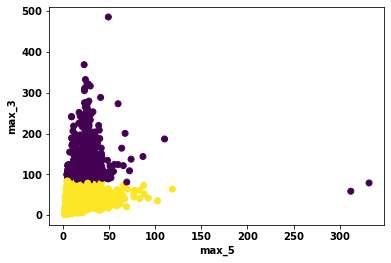

max_5 max_4


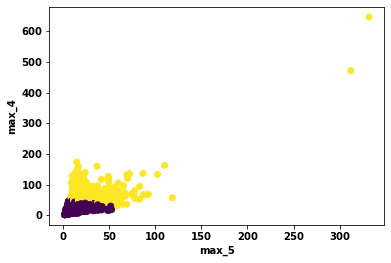

max_5 max_6


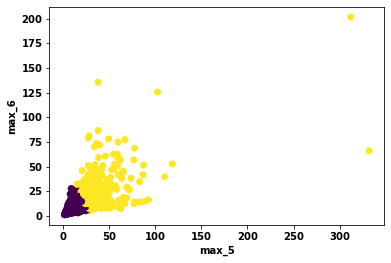

max_5 max_7


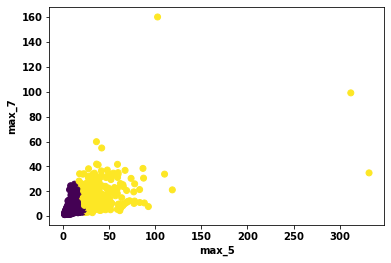

max_5 max_8


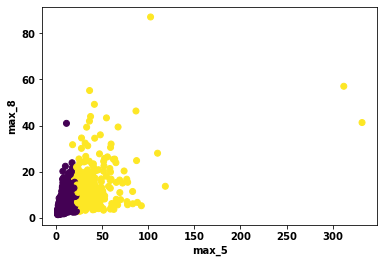

max_5 mean


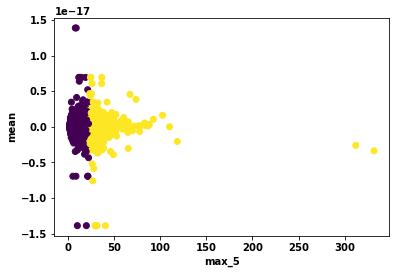

max_5 mean_1


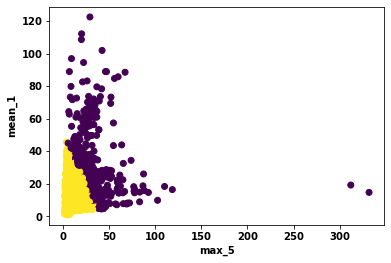

max_5 mean_2


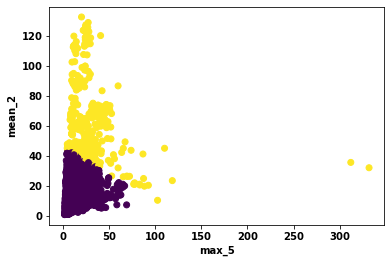

max_5 mean_3


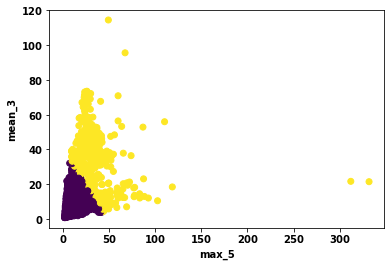

max_5 mean_4


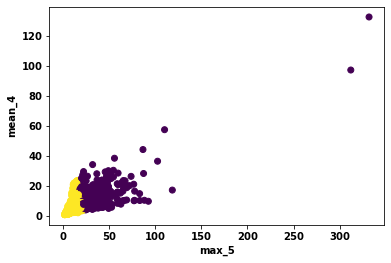

max_5 mean_5


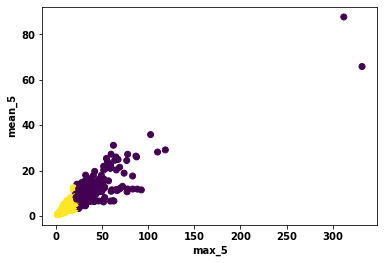

max_5 mean_6


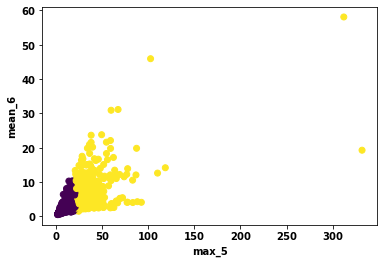

max_5 mean_7


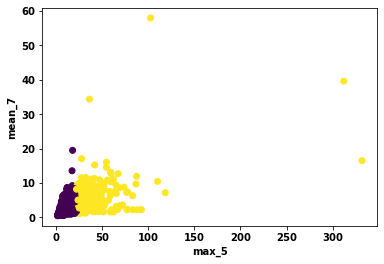

max_5 mean_8


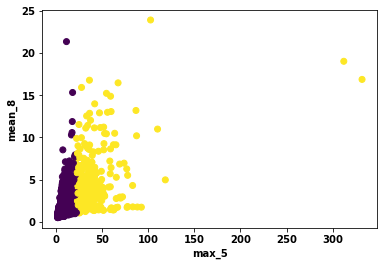

max_5 peak-peak


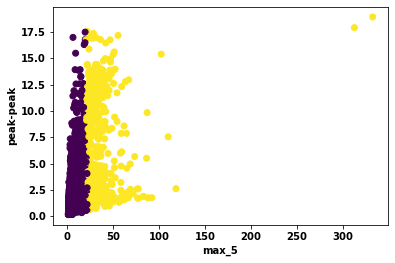

max_5 rms


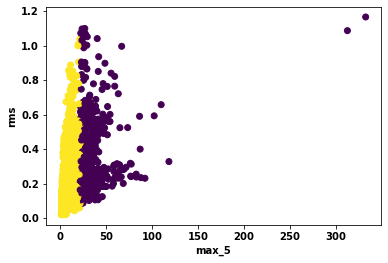

max_5 skewness


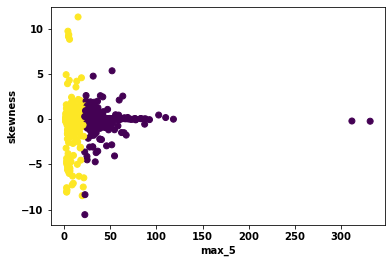

max_5 var_1


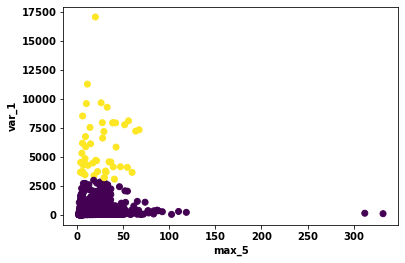

max_5 var_2


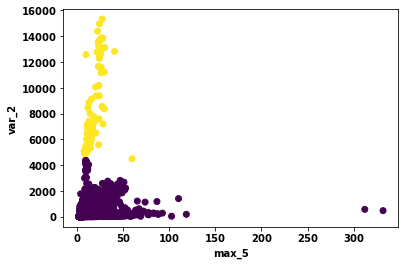

max_5 var_3


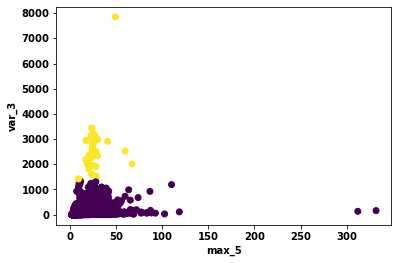

max_5 var_4


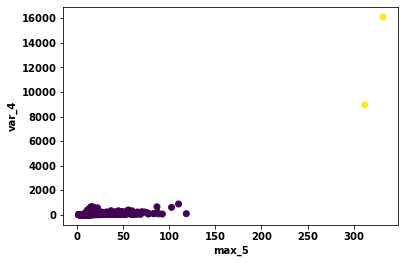

max_5 var_5


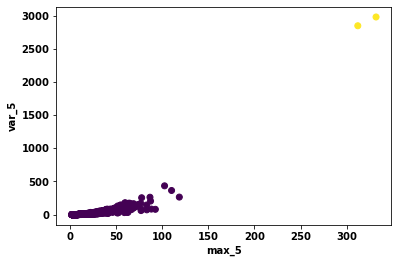

max_5 var_6


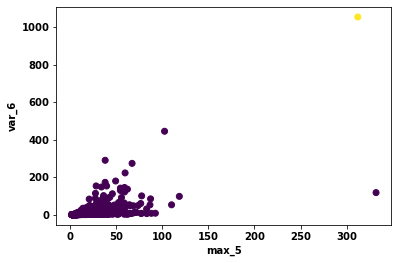

max_5 var_7


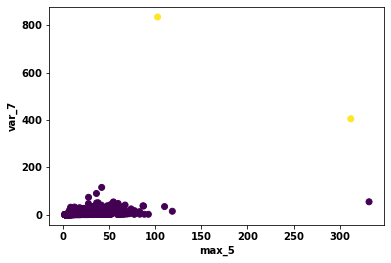

max_5 var_8


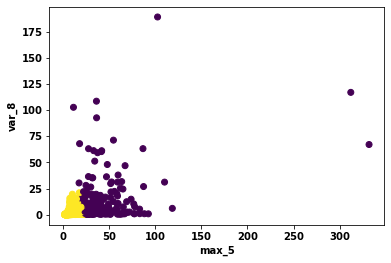

max_5 variance


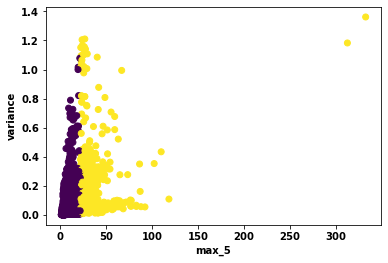

max_6 crest


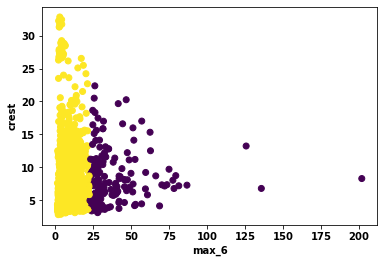

max_6 freqAmpliKurt


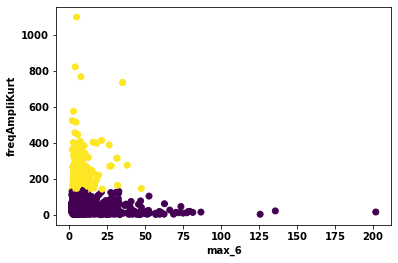

max_6 freqAmpliMax


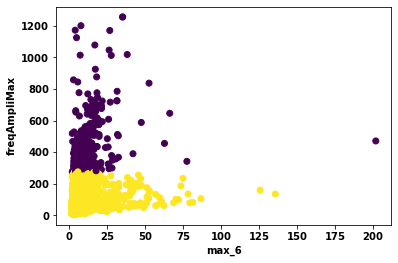

max_6 freqAmpliMean


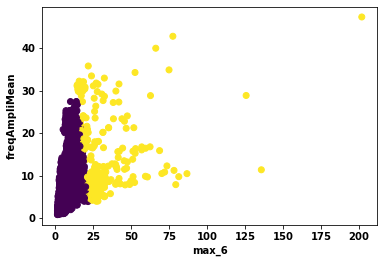

max_6 freqAmpliVar


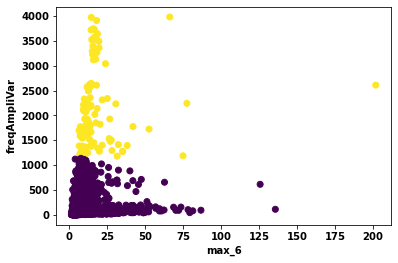

max_6 freqAmpliskw


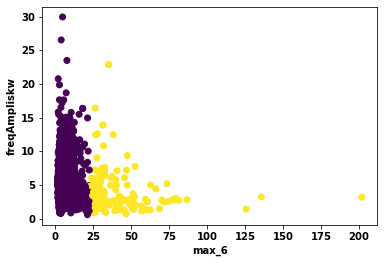

max_6 kurt


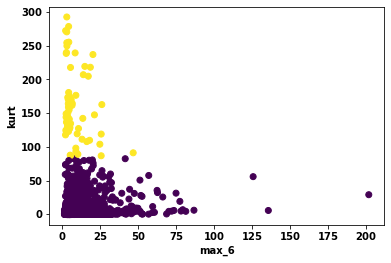

max_6 max_1


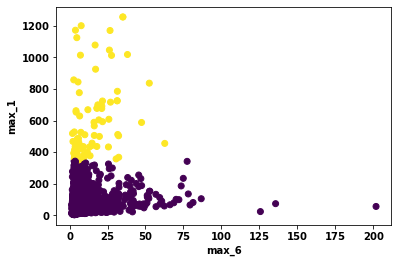

max_6 max_2


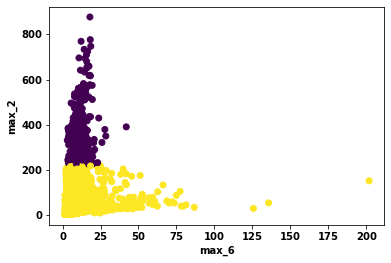

max_6 max_3


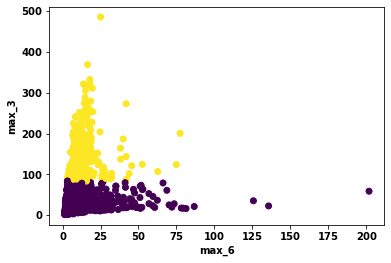

max_6 max_4


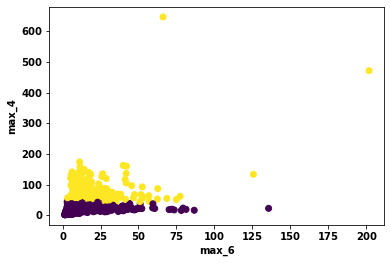

max_6 max_5


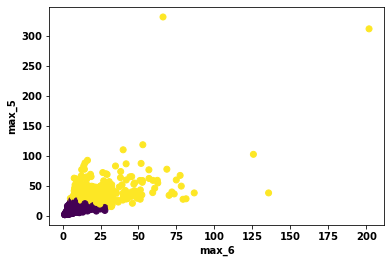

max_6 max_7


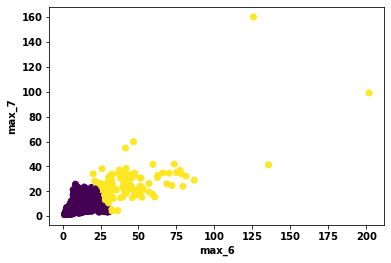

max_6 max_8


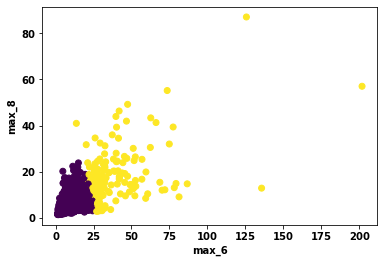

max_6 mean


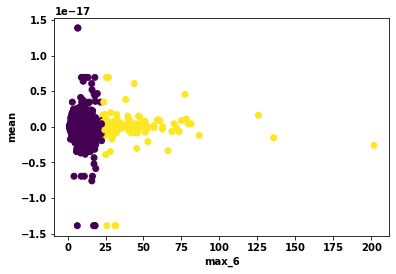

max_6 mean_1


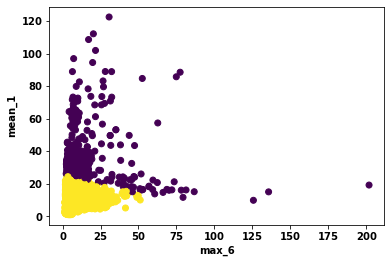

max_6 mean_2


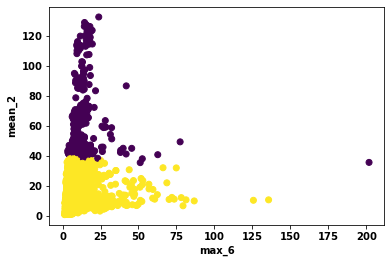

max_6 mean_3


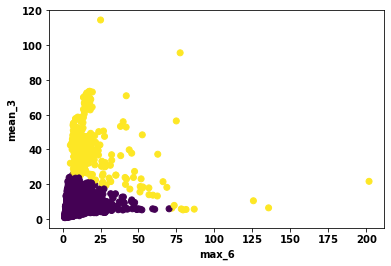

max_6 mean_4


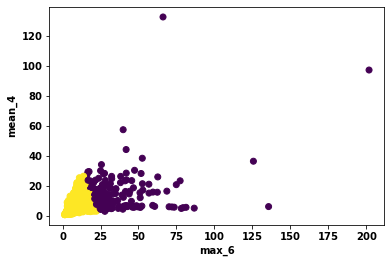

max_6 mean_5


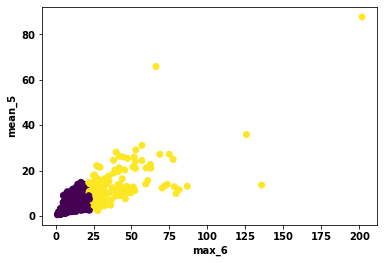

max_6 mean_6


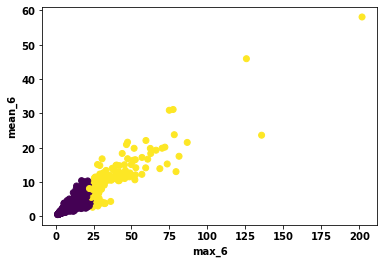

max_6 mean_7


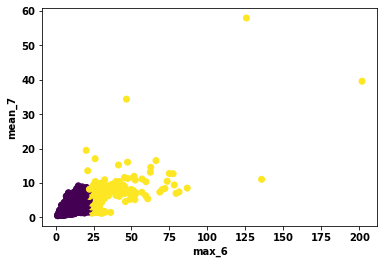

max_6 mean_8


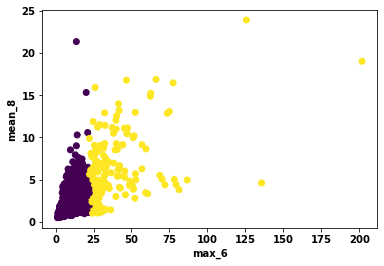

max_6 peak-peak


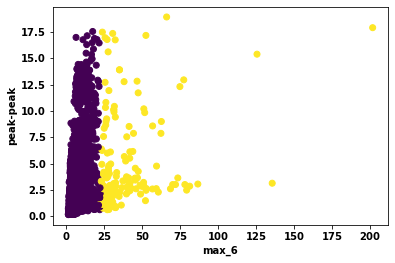

max_6 rms


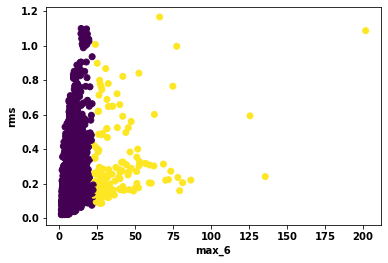

max_6 skewness


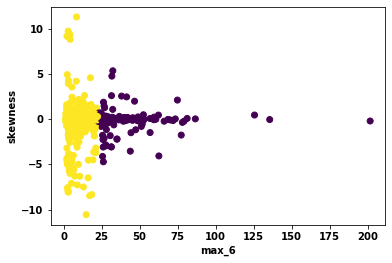

max_6 var_1


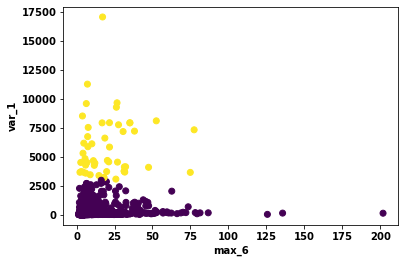

max_6 var_2


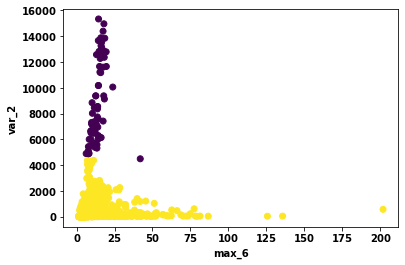

max_6 var_3


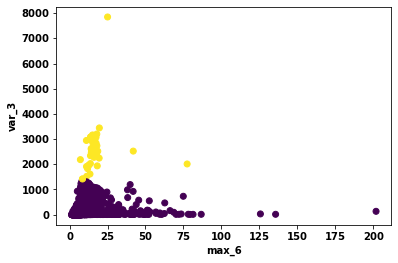

max_6 var_4


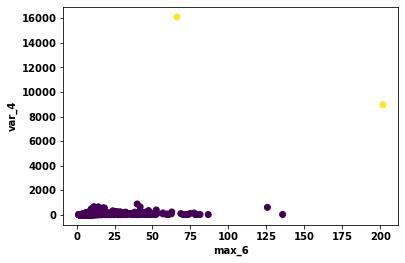

max_6 var_5


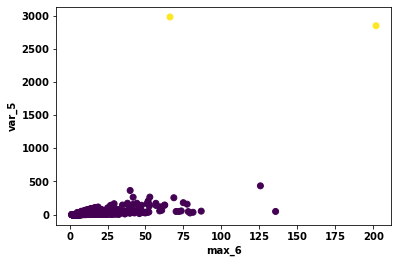

max_6 var_6


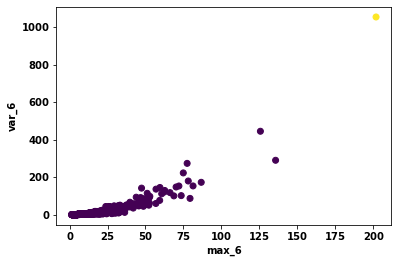

max_6 var_7


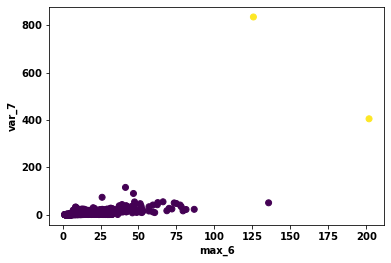

max_6 var_8


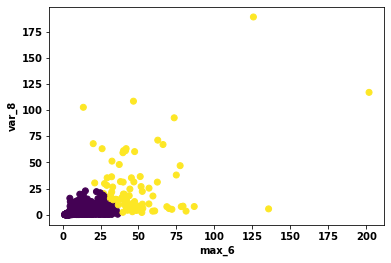

max_6 variance


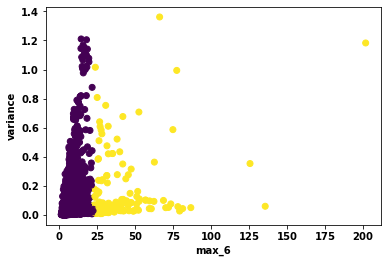

max_7 crest


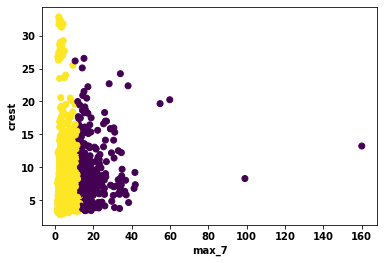

max_7 freqAmpliKurt


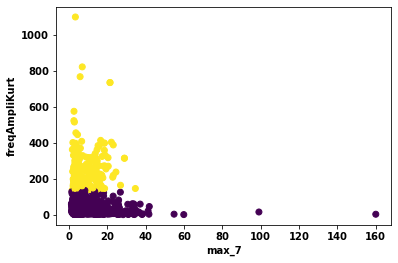

max_7 freqAmpliMax


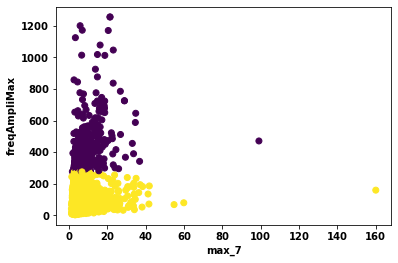

max_7 freqAmpliMean


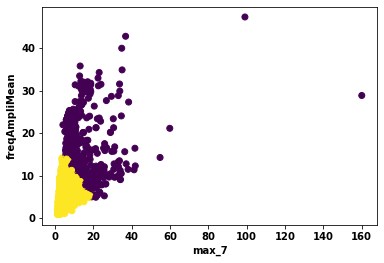

max_7 freqAmpliVar


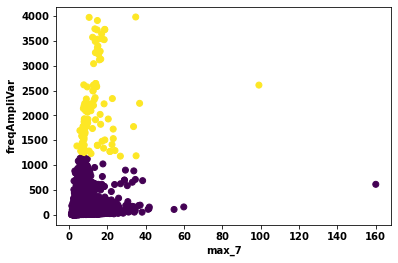

max_7 freqAmpliskw


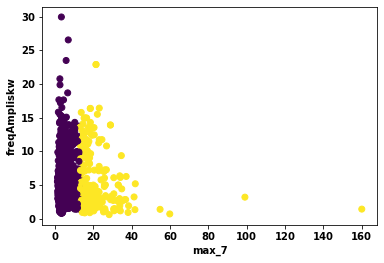

max_7 kurt


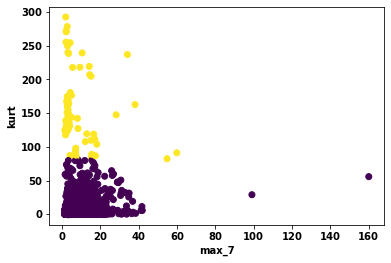

max_7 max_1


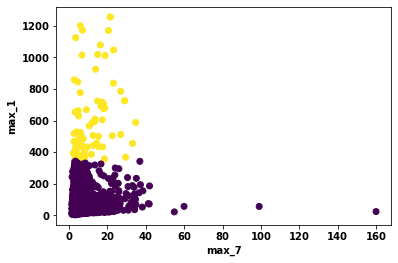

max_7 max_2


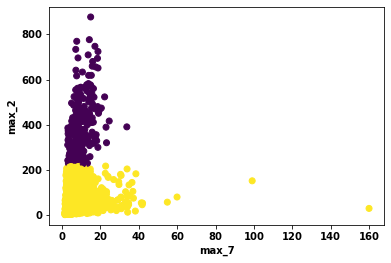

max_7 max_3


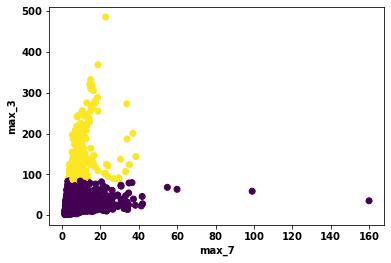

max_7 max_4


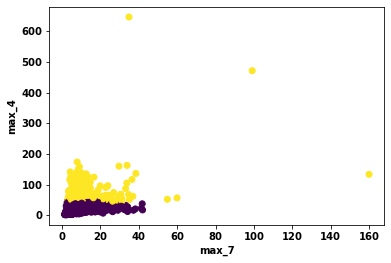

max_7 max_5


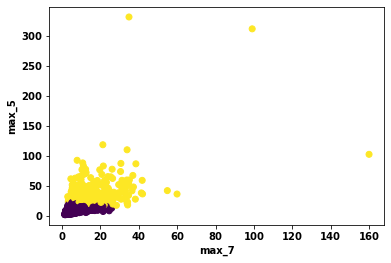

max_7 max_6


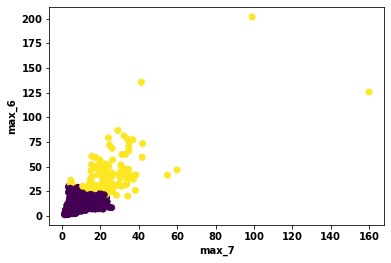

max_7 max_8


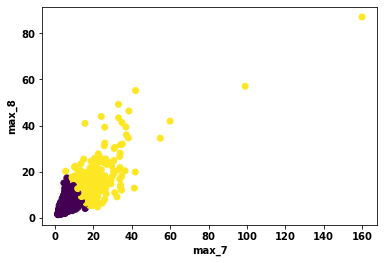

max_7 mean


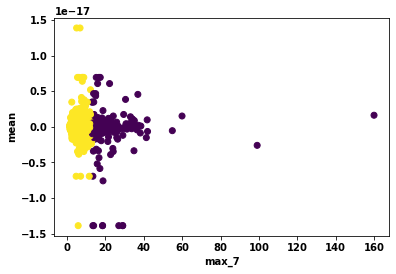

max_7 mean_1


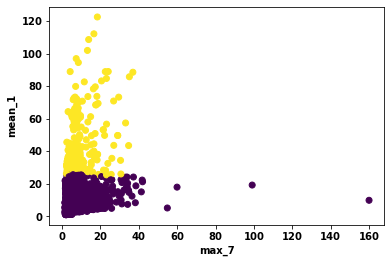

max_7 mean_2


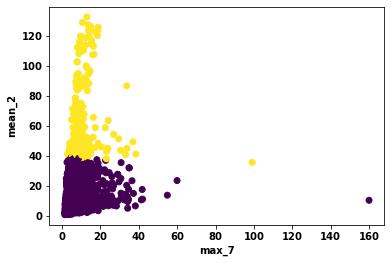

max_7 mean_3


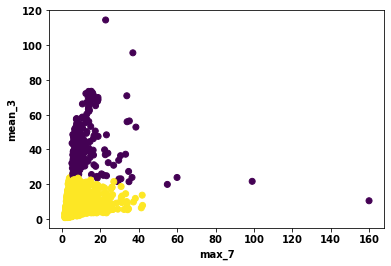

max_7 mean_4


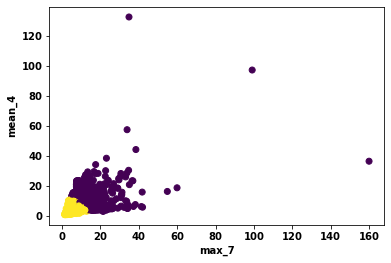

max_7 mean_5


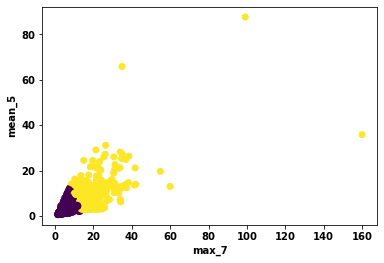

max_7 mean_6


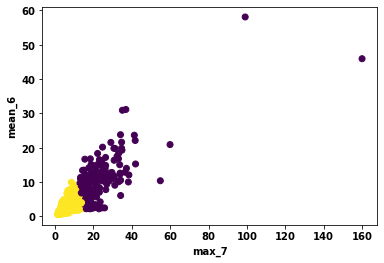

max_7 mean_7


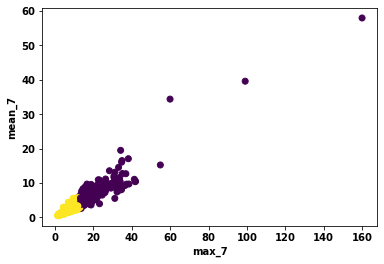

max_7 mean_8


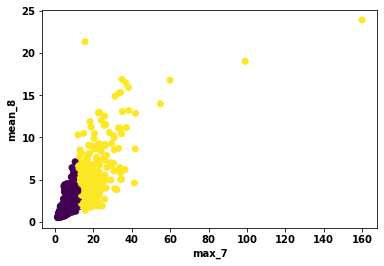

max_7 peak-peak


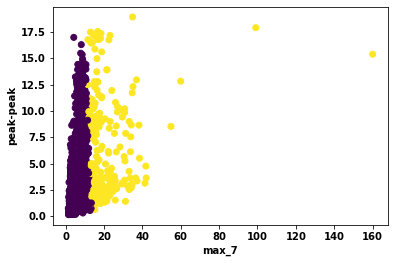

max_7 rms


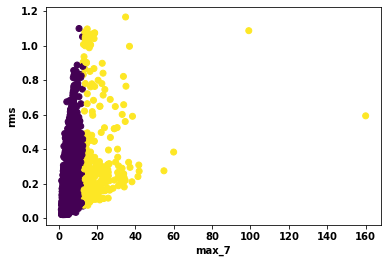

max_7 skewness


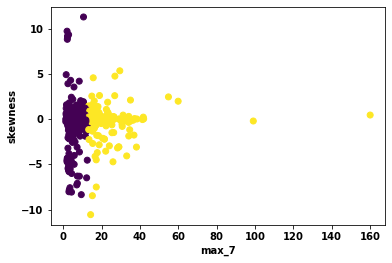

max_7 var_1


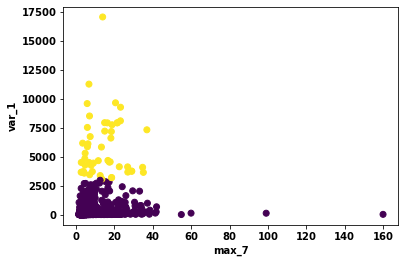

max_7 var_2


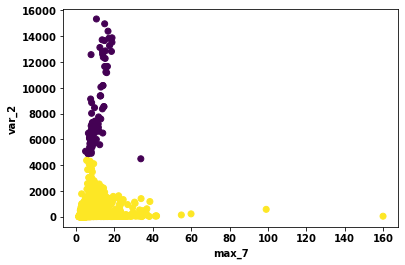

max_7 var_3


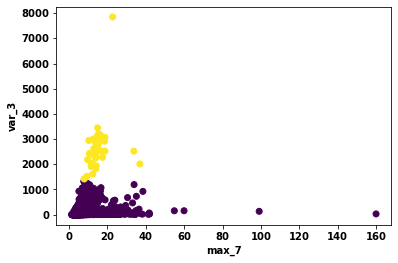

max_7 var_4


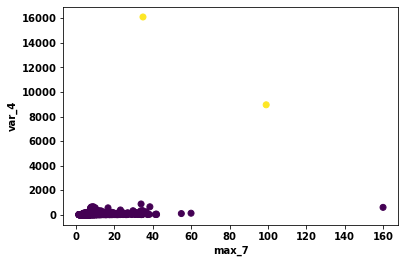

max_7 var_5


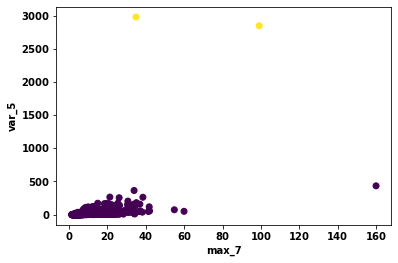

max_7 var_6


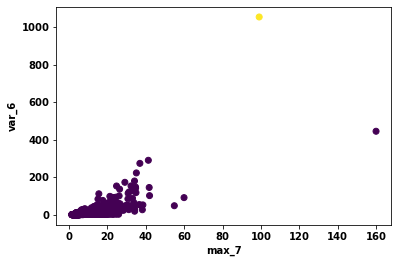

max_7 var_7


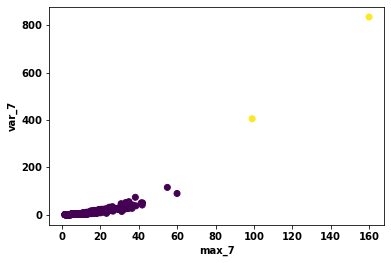

max_7 var_8


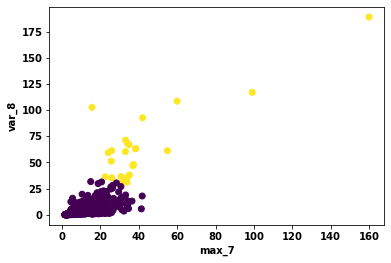

max_7 variance


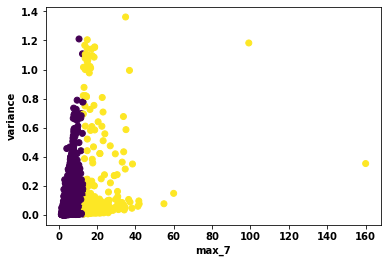

max_8 crest


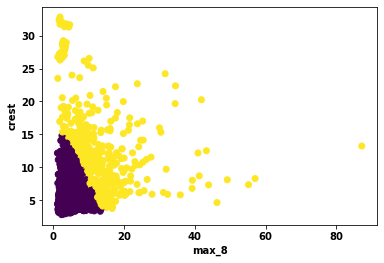

max_8 freqAmpliKurt


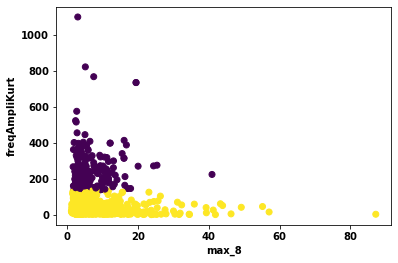

max_8 freqAmpliMax


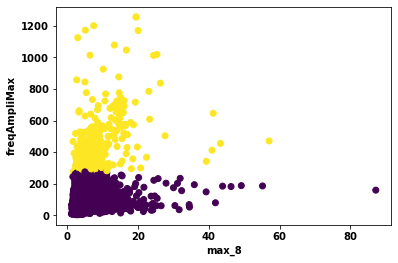

max_8 freqAmpliMean


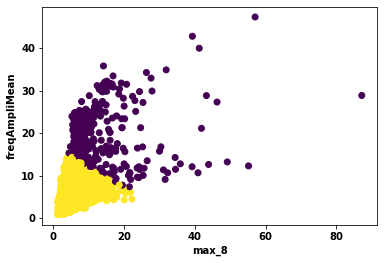

max_8 freqAmpliVar


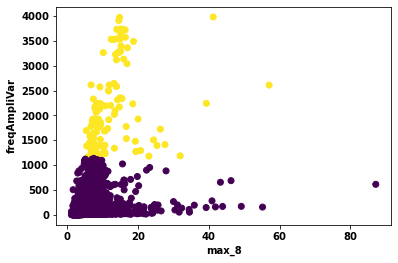

max_8 freqAmpliskw


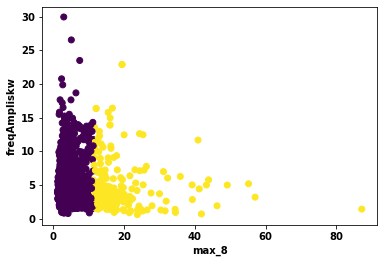

max_8 kurt


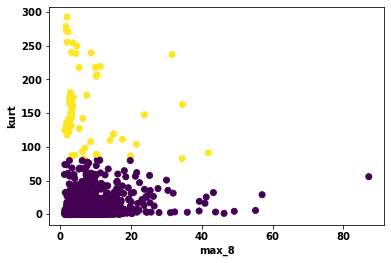

max_8 max_1


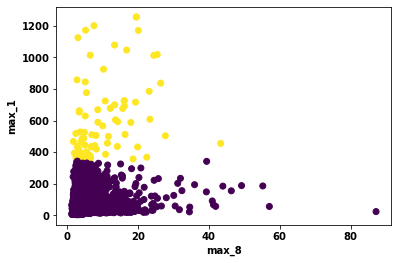

max_8 max_2


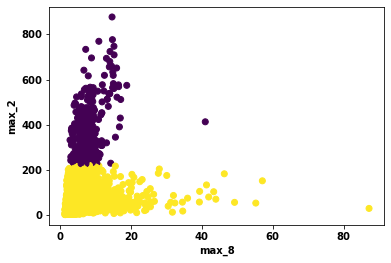

max_8 max_3


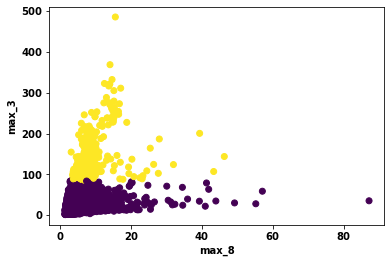

max_8 max_4


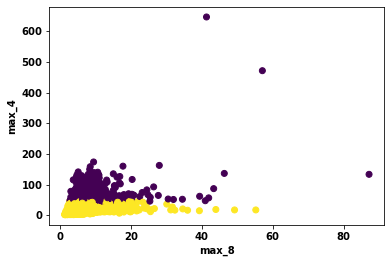

max_8 max_5


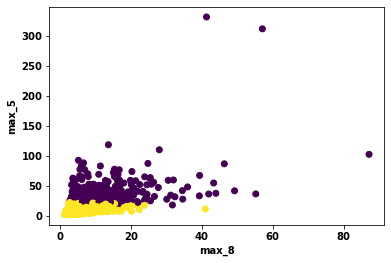

max_8 max_6


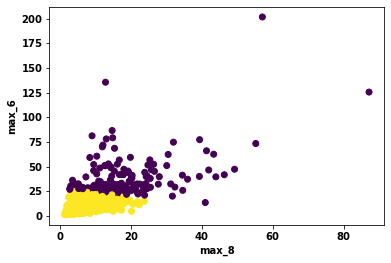

max_8 max_7


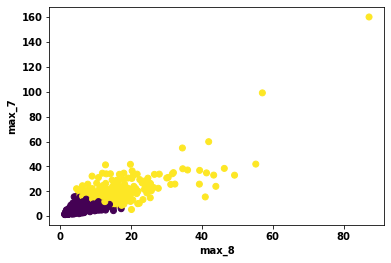

max_8 mean


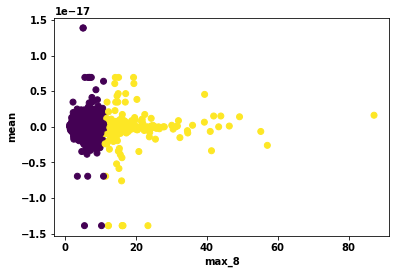

max_8 mean_1


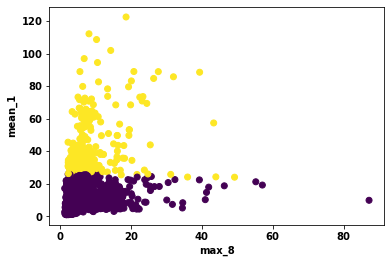

max_8 mean_2


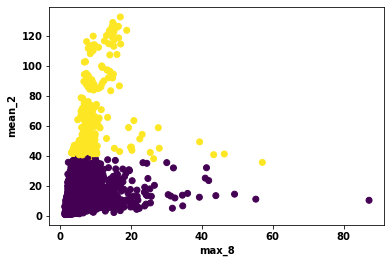

max_8 mean_3


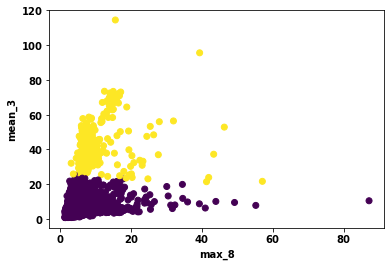

max_8 mean_4


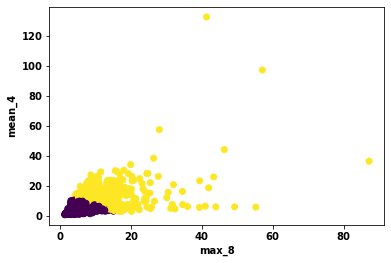

max_8 mean_5


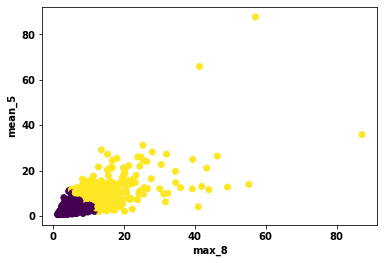

max_8 mean_6


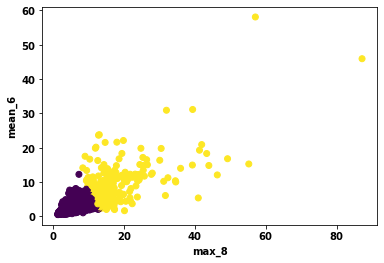

max_8 mean_7


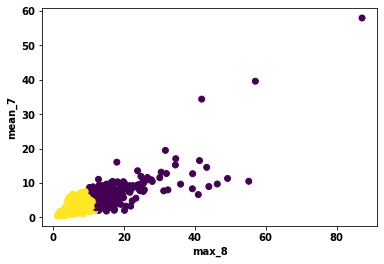

max_8 mean_8


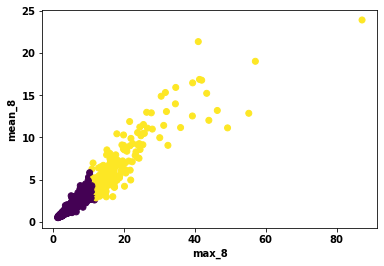

max_8 peak-peak


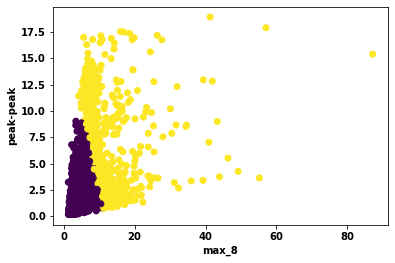

max_8 rms


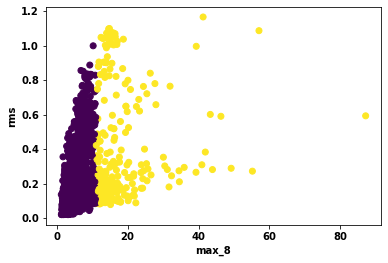

max_8 skewness


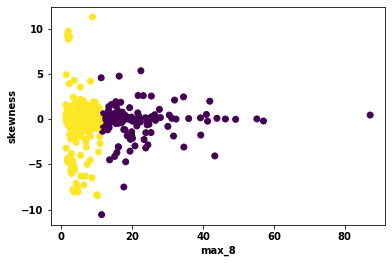

max_8 var_1


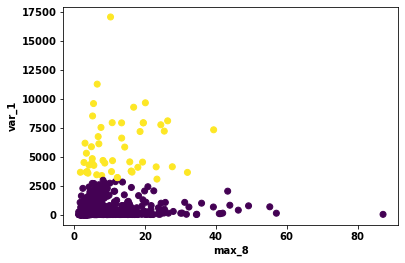

max_8 var_2


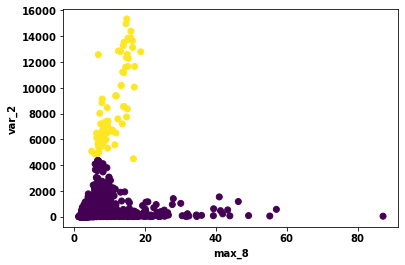

max_8 var_3


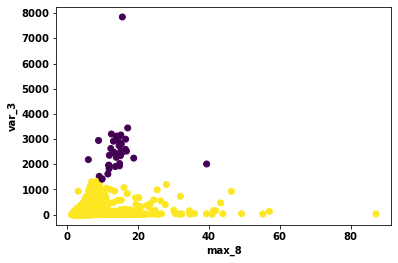

max_8 var_4


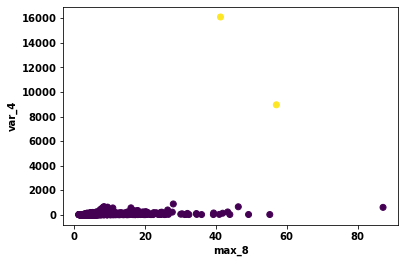

max_8 var_5


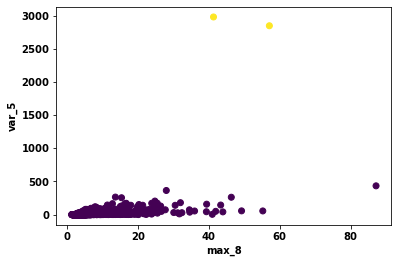

max_8 var_6


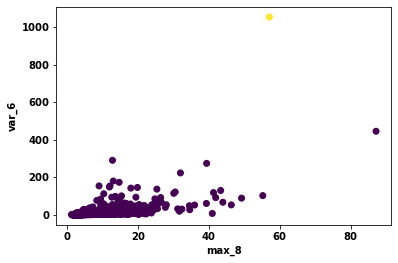

max_8 var_7


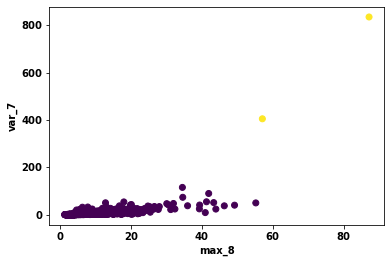

max_8 var_8


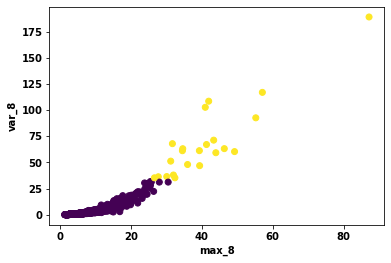

max_8 variance


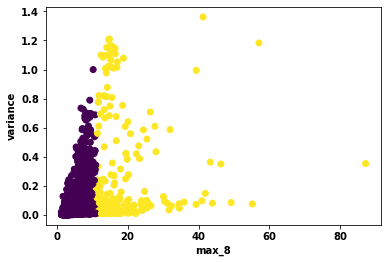

mean crest


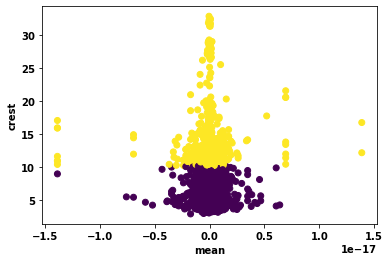

mean freqAmpliKurt


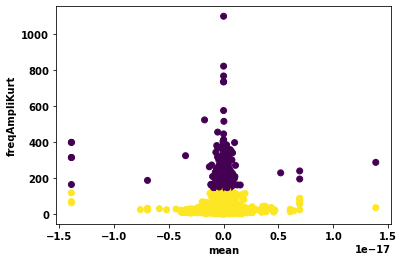

mean freqAmpliMax


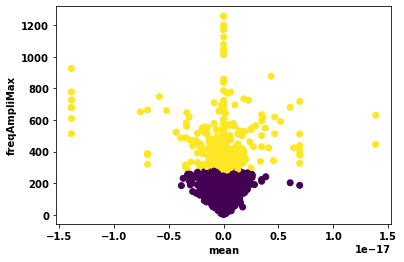

mean freqAmpliMean


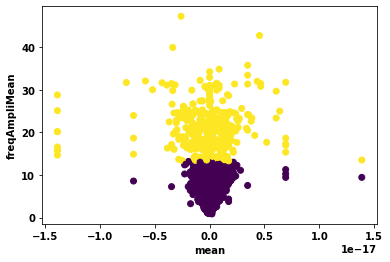

mean freqAmpliVar


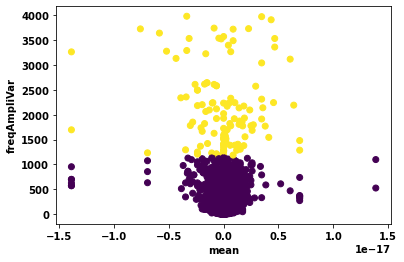

mean freqAmpliskw


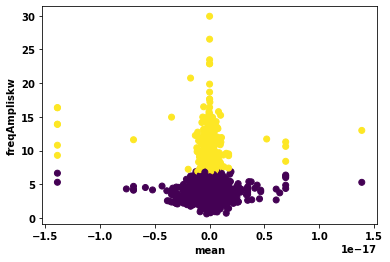

mean kurt


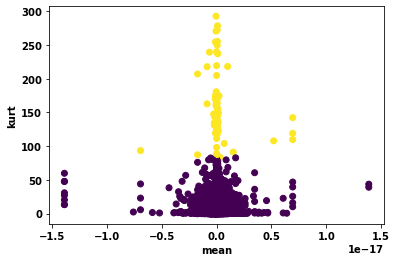

mean max_1


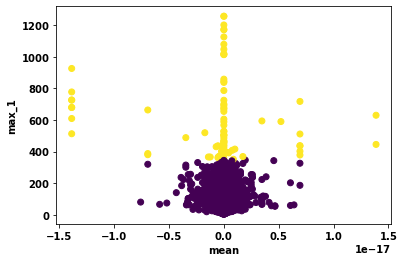

mean max_2


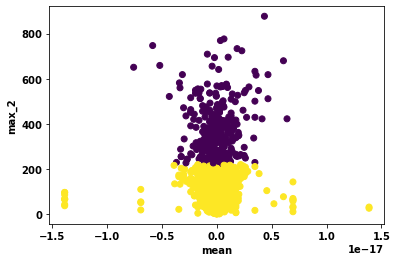

mean max_3


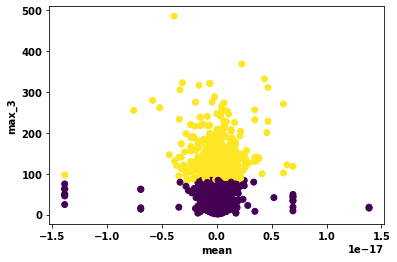

mean max_4


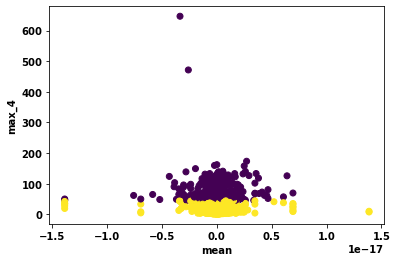

mean max_5


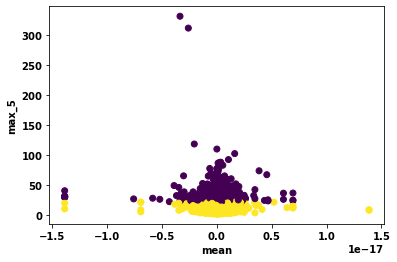

mean max_6


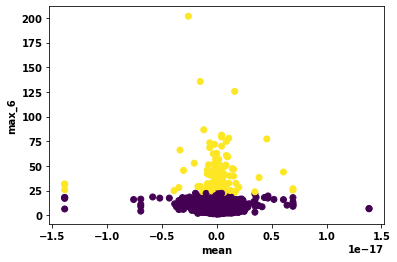

mean max_7


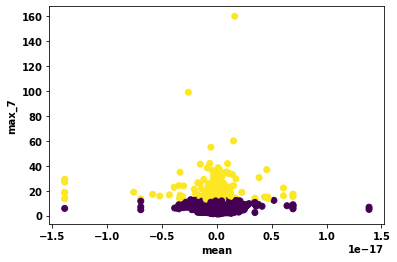

mean max_8


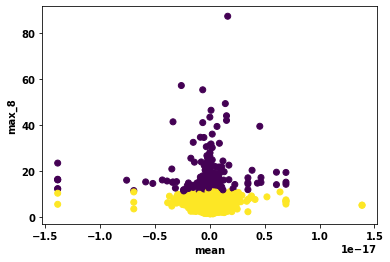

mean mean_1


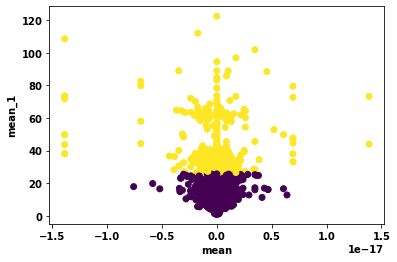

mean mean_2


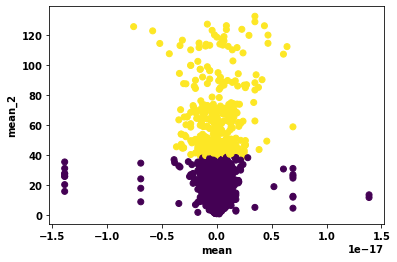

mean mean_3


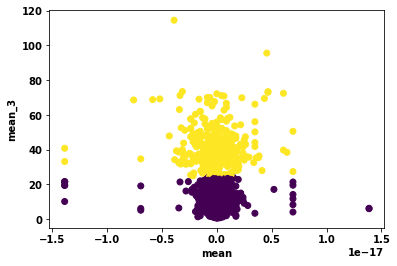

mean mean_4


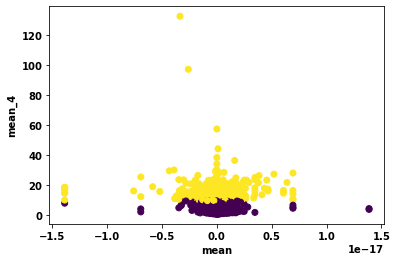

mean mean_5


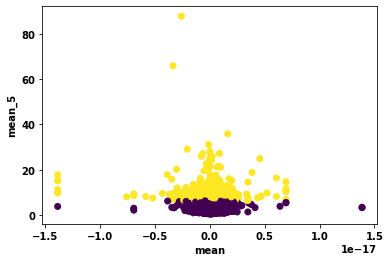

mean mean_6


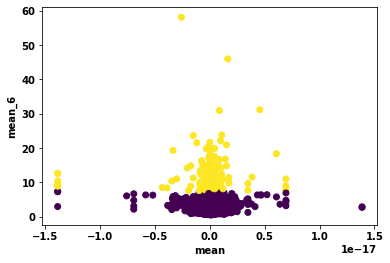

mean mean_7


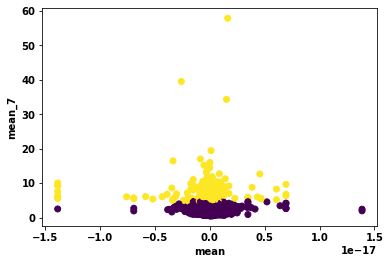

mean mean_8


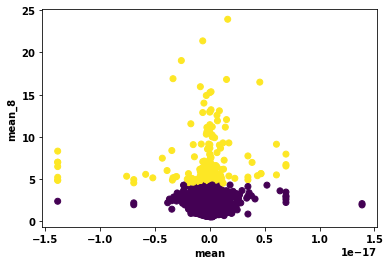

mean peak-peak


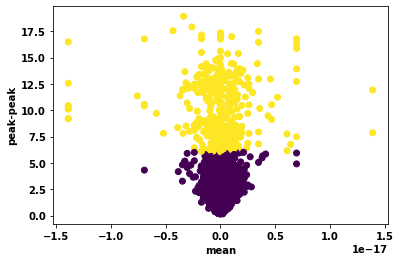

mean rms


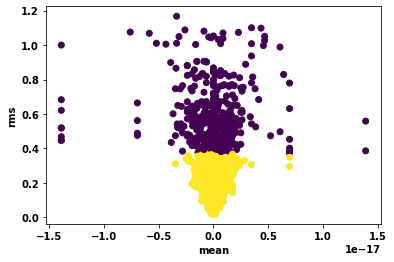

mean skewness


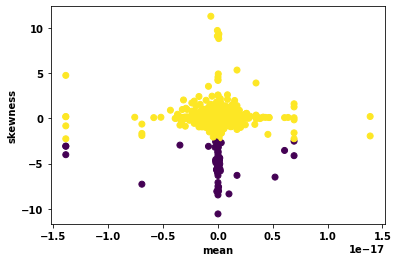

mean var_1


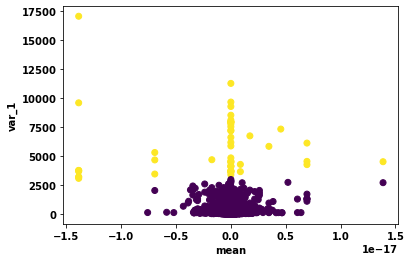

mean var_2


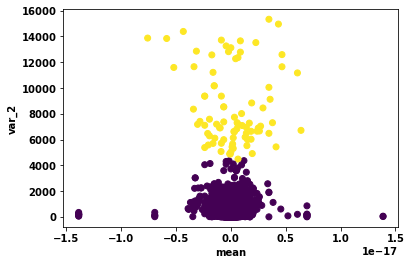

mean var_3


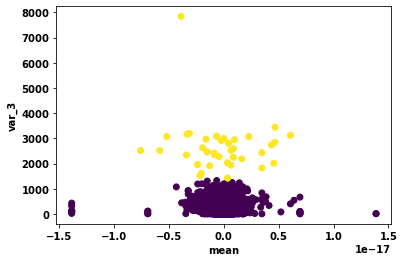

mean var_4


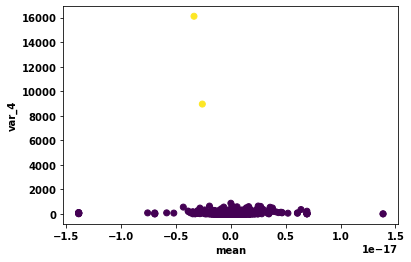

mean var_5


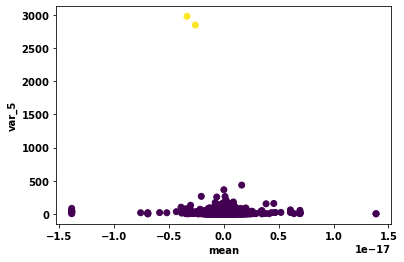

mean var_6


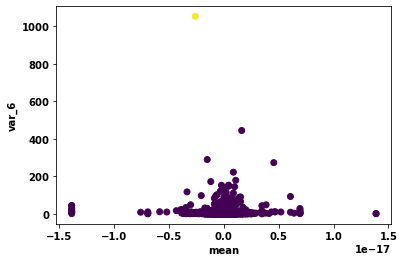

mean var_7


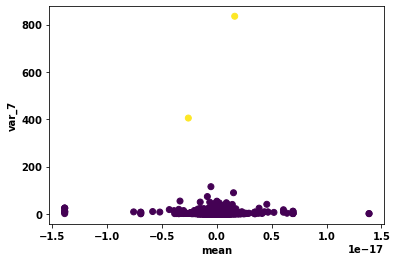

mean var_8


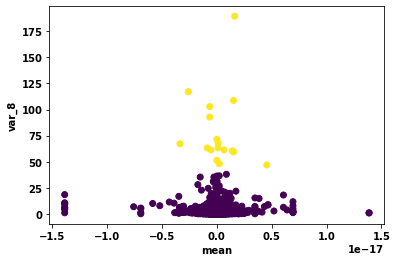

mean variance


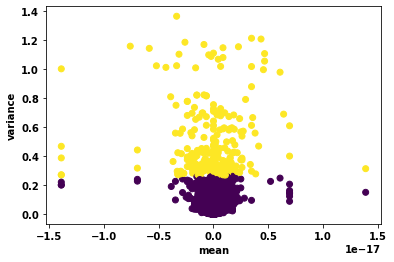

mean_1 crest


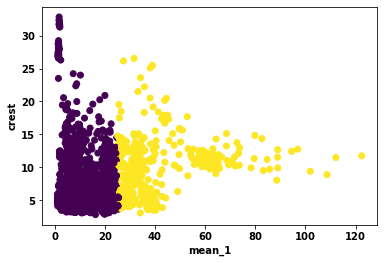

mean_1 freqAmpliKurt


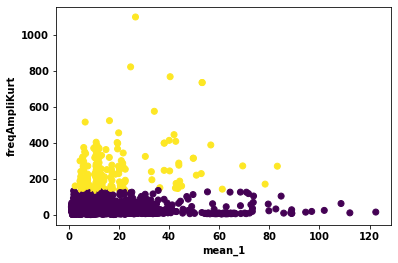

mean_1 freqAmpliMax


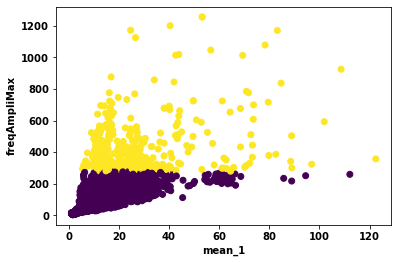

mean_1 freqAmpliMean


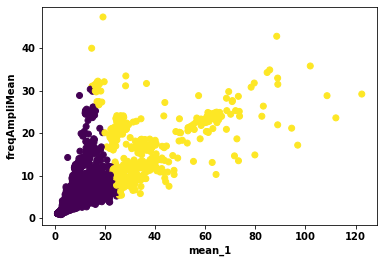

mean_1 freqAmpliVar


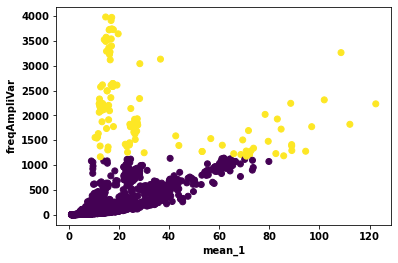

mean_1 freqAmpliskw


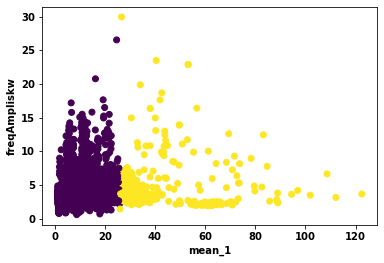

mean_1 kurt


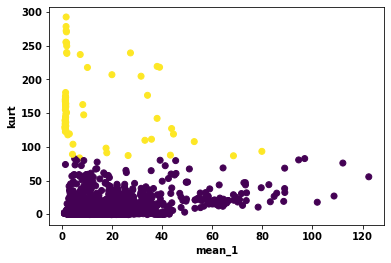

mean_1 max_1


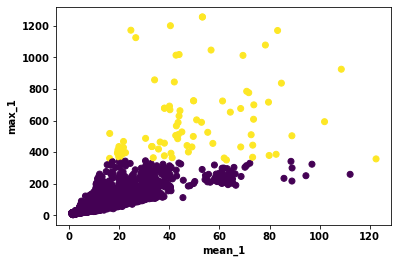

mean_1 max_2


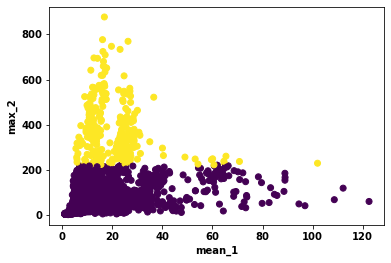

mean_1 max_3


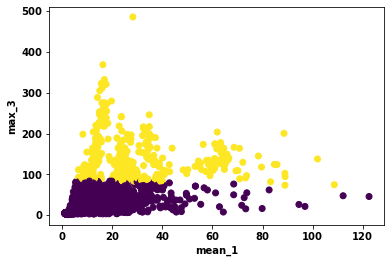

mean_1 max_4


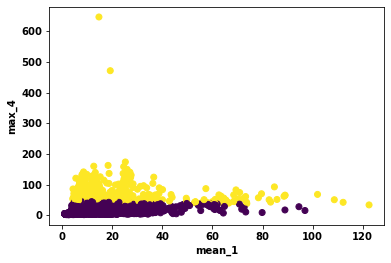

mean_1 max_5


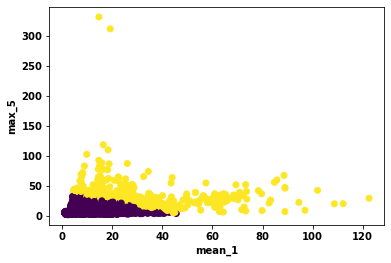

mean_1 max_6


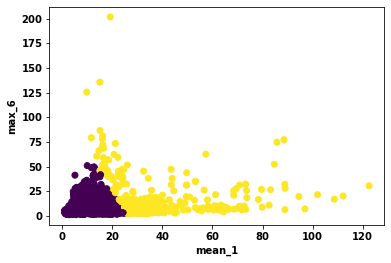

mean_1 max_7


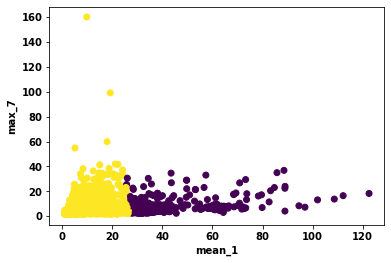

mean_1 max_8


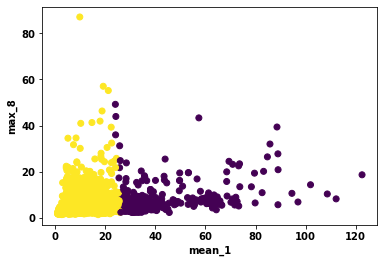

mean_1 mean


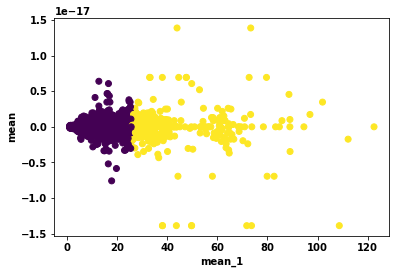

mean_1 mean_2


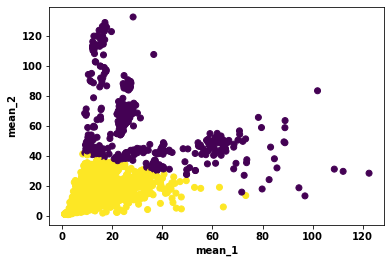

mean_1 mean_3


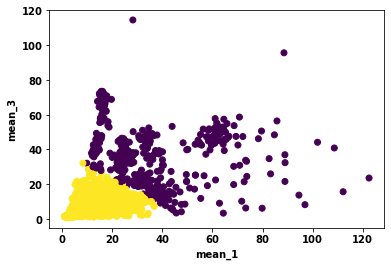

mean_1 mean_4


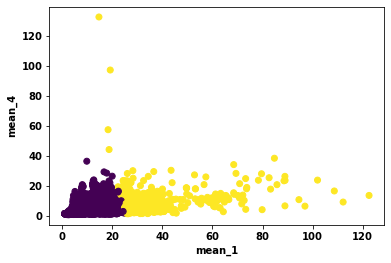

mean_1 mean_5


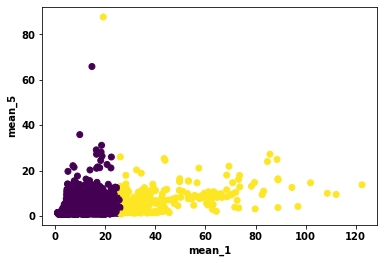

mean_1 mean_6


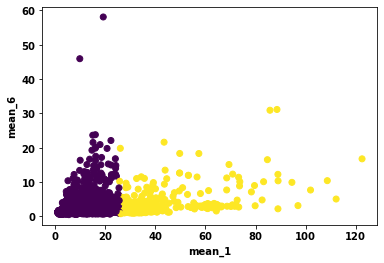

mean_1 mean_7


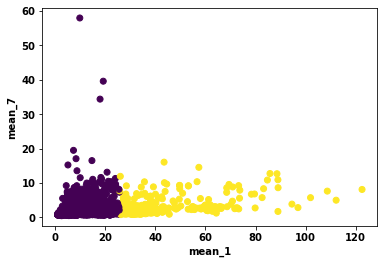

mean_1 mean_8


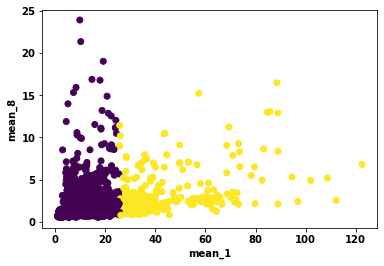

mean_1 peak-peak


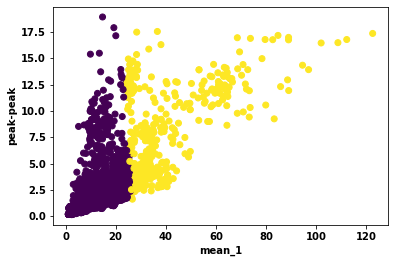

mean_1 rms


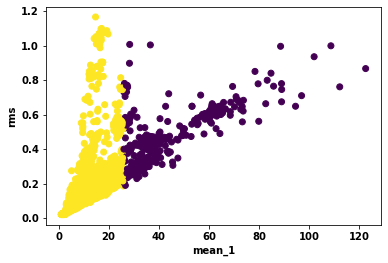

mean_1 skewness


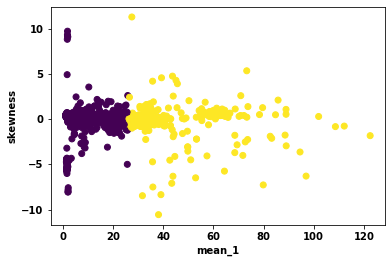

mean_1 var_1


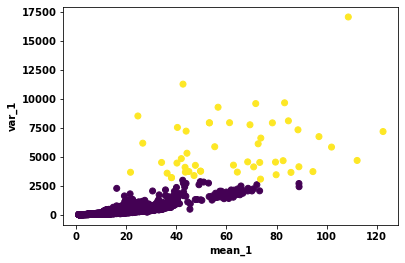

mean_1 var_2


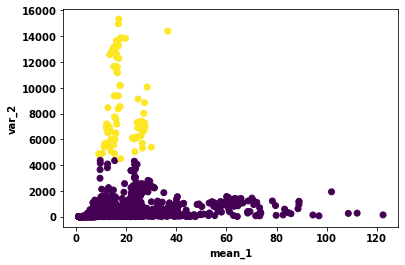

mean_1 var_3


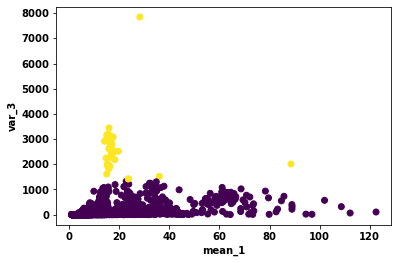

mean_1 var_4


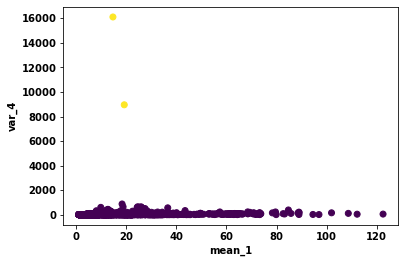

mean_1 var_5


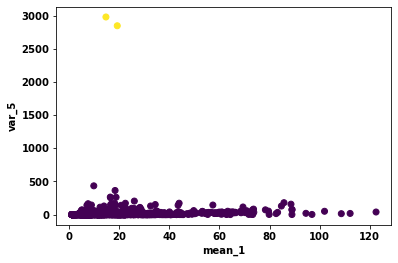

mean_1 var_6


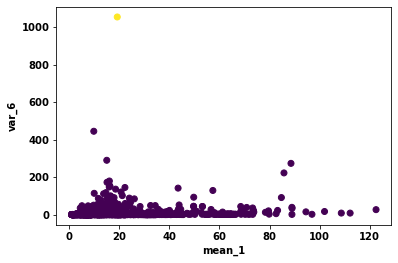

mean_1 var_7


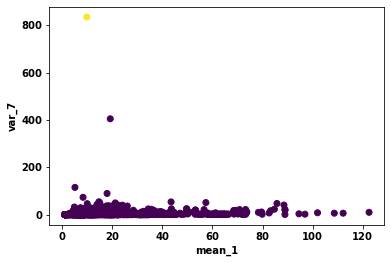

mean_1 var_8


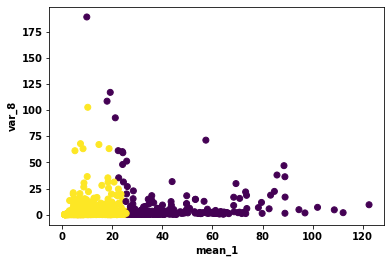

mean_1 variance


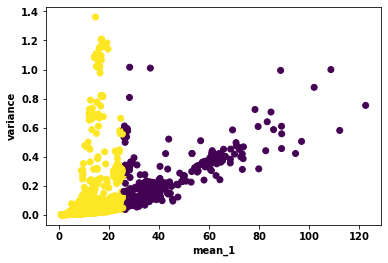

mean_2 crest


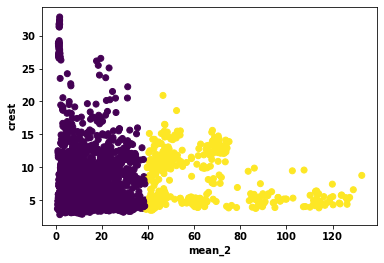

mean_2 freqAmpliKurt


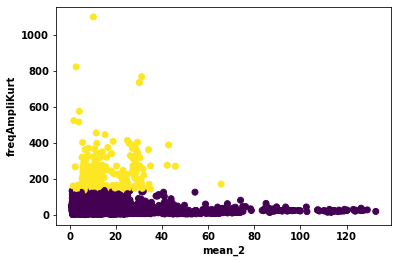

mean_2 freqAmpliMax


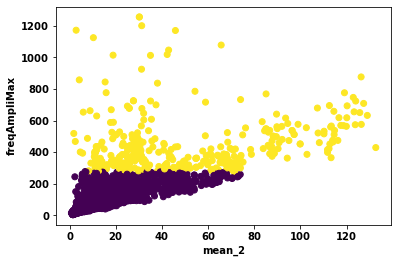

mean_2 freqAmpliMean


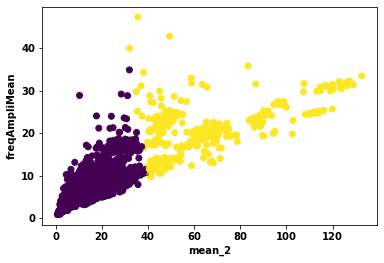

mean_2 freqAmpliVar


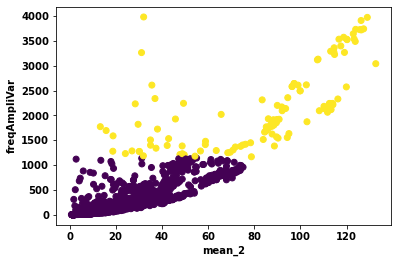

mean_2 freqAmpliskw


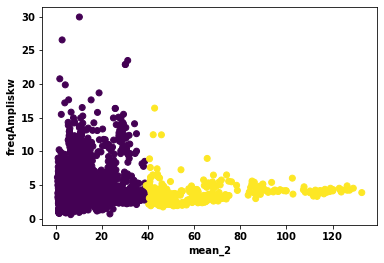

mean_2 kurt


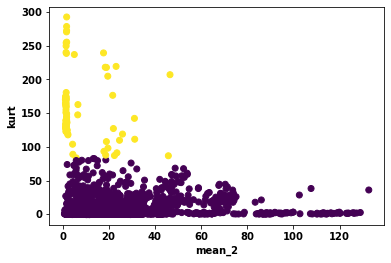

mean_2 max_1


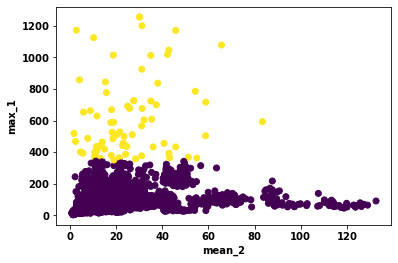

mean_2 max_2


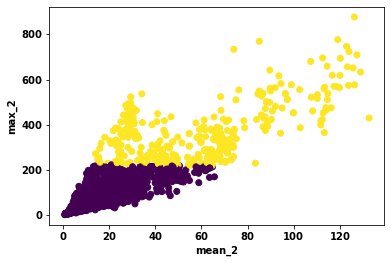

mean_2 max_3


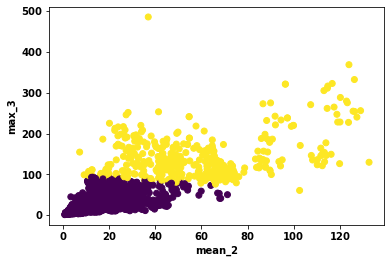

mean_2 max_4


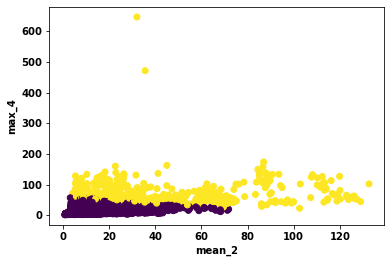

mean_2 max_5


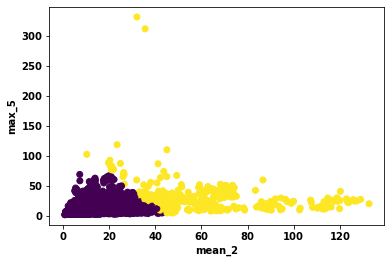

mean_2 max_6


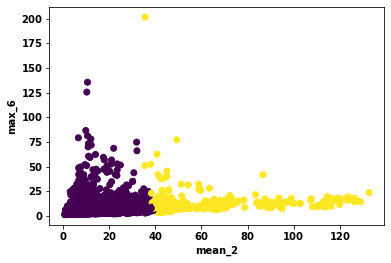

mean_2 max_7


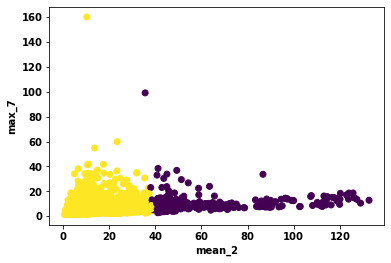

mean_2 max_8


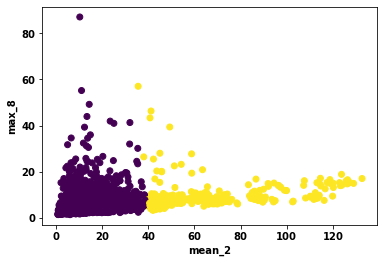

mean_2 mean


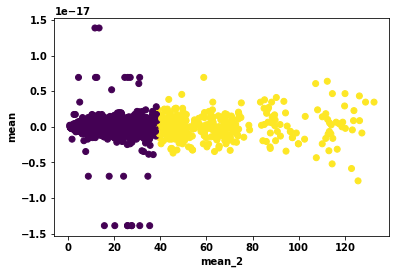

mean_2 mean_1


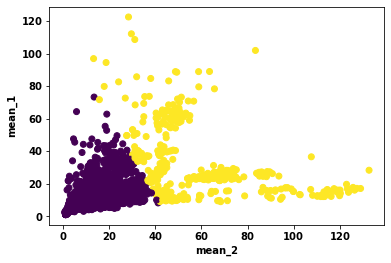

mean_2 mean_3


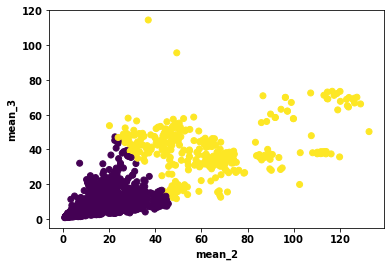

mean_2 mean_4


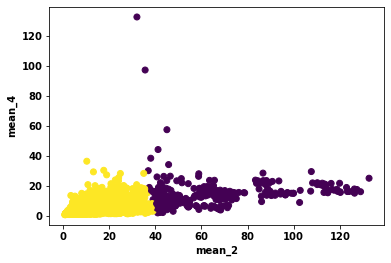

mean_2 mean_5


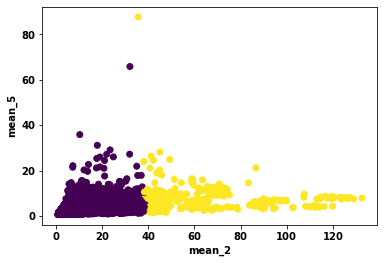

mean_2 mean_6


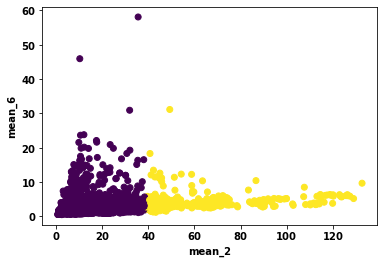

mean_2 mean_7


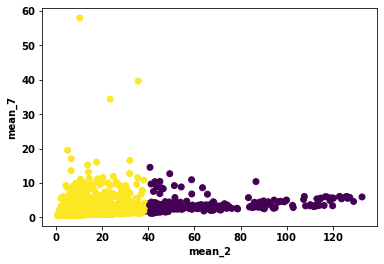

mean_2 mean_8


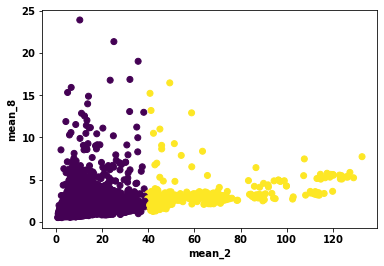

mean_2 peak-peak


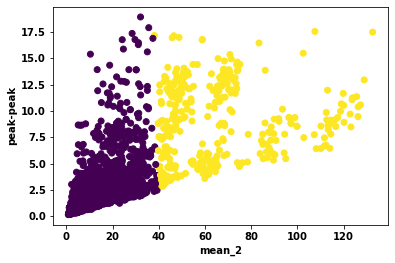

mean_2 rms


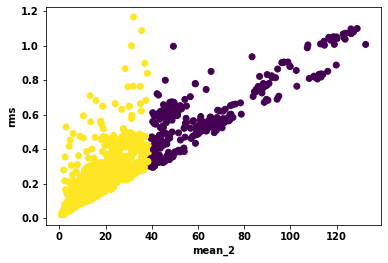

mean_2 skewness


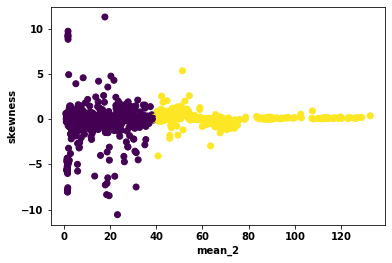

mean_2 var_1


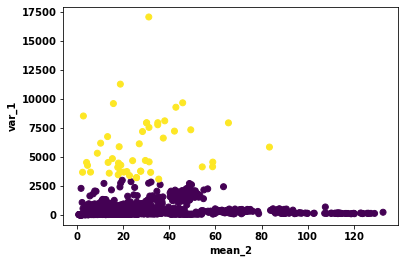

mean_2 var_2


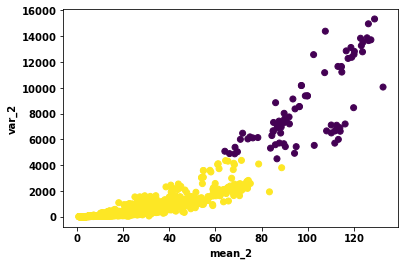

mean_2 var_3


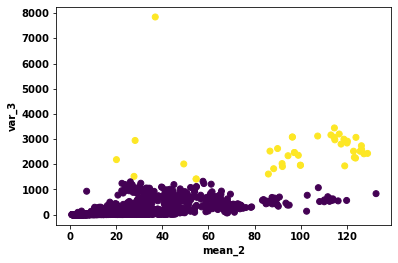

mean_2 var_4


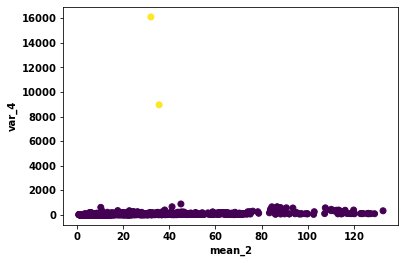

mean_2 var_5


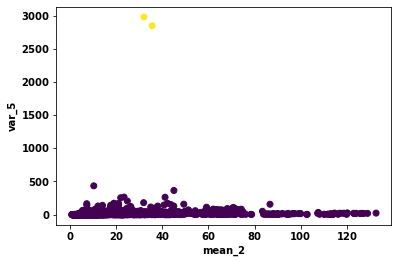

mean_2 var_6


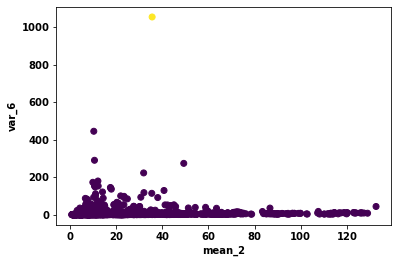

mean_2 var_7


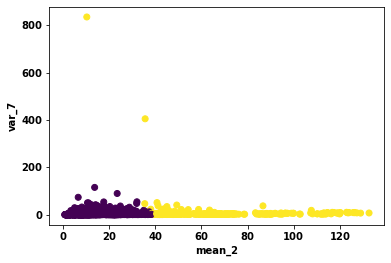

mean_2 var_8


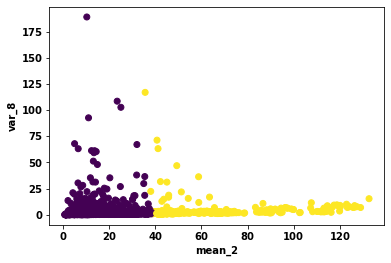

mean_2 variance


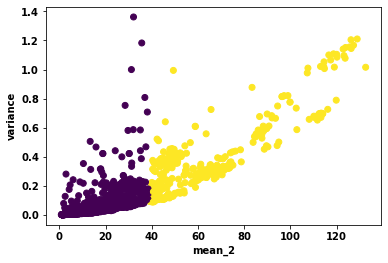

mean_3 crest


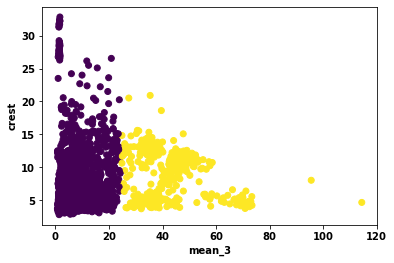

mean_3 freqAmpliKurt


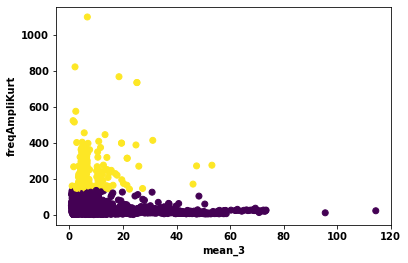

mean_3 freqAmpliMax


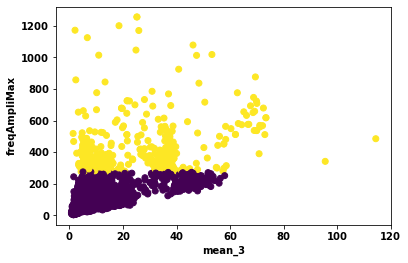

mean_3 freqAmpliMean


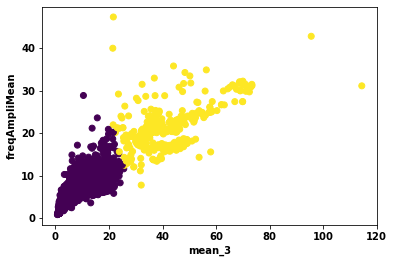

mean_3 freqAmpliVar


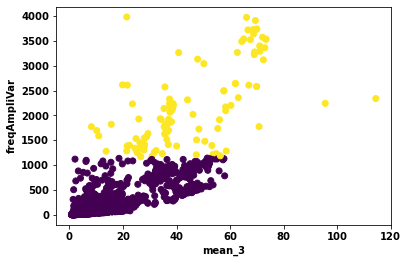

mean_3 freqAmpliskw


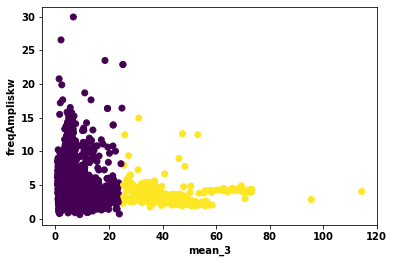

mean_3 kurt


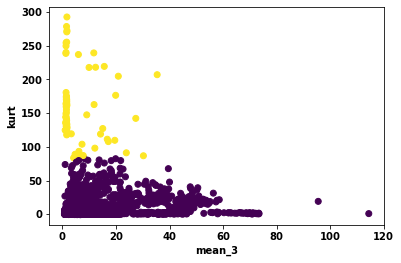

mean_3 max_1


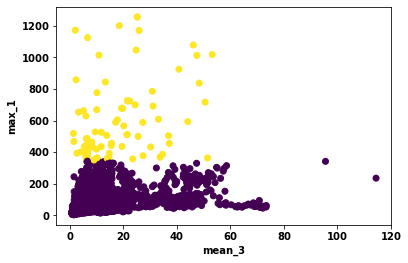

mean_3 max_2


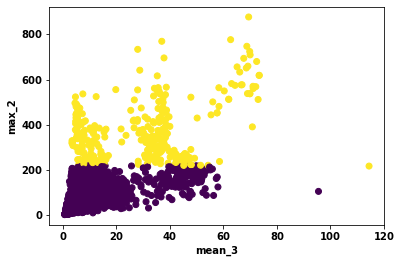

mean_3 max_3


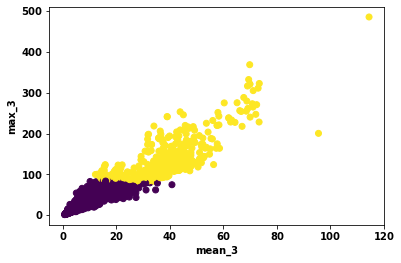

mean_3 max_4


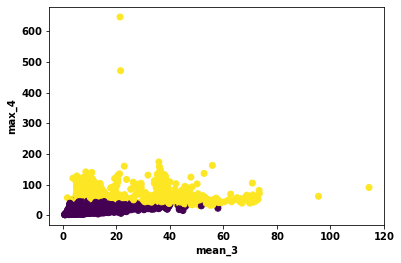

mean_3 max_5


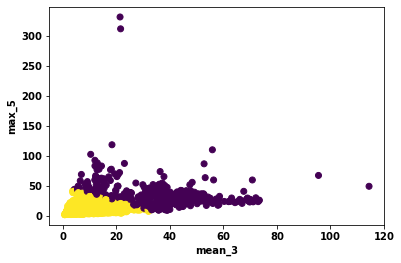

mean_3 max_6


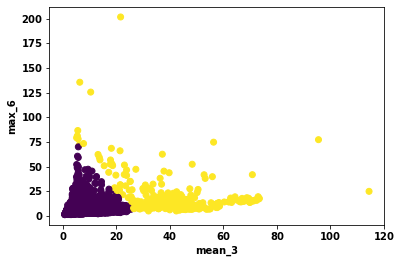

mean_3 max_7


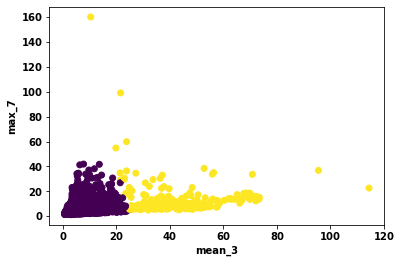

mean_3 max_8


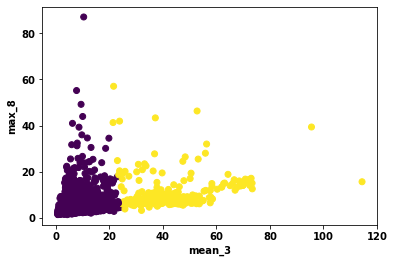

mean_3 mean


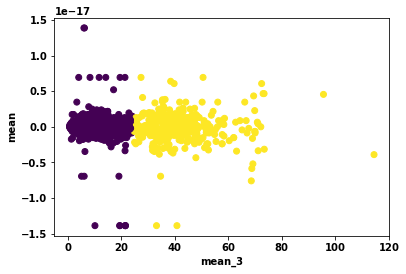

mean_3 mean_1


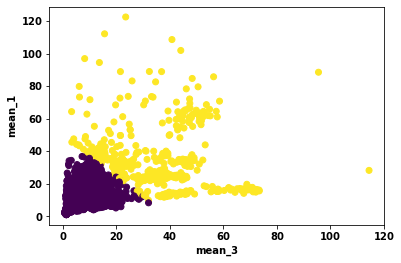

mean_3 mean_2


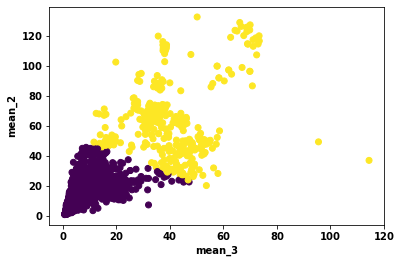

mean_3 mean_4


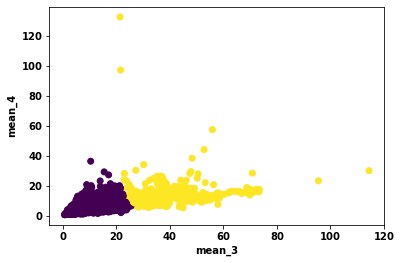

mean_3 mean_5


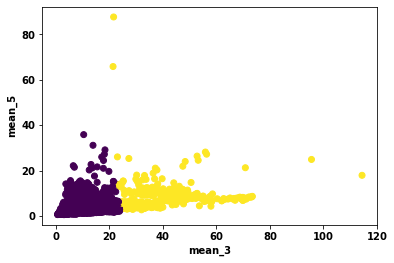

mean_3 mean_6


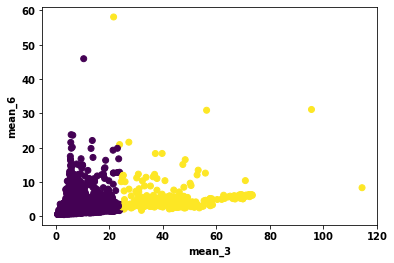

mean_3 mean_7


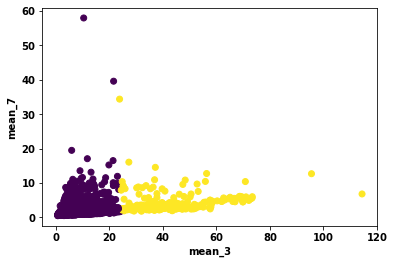

mean_3 mean_8


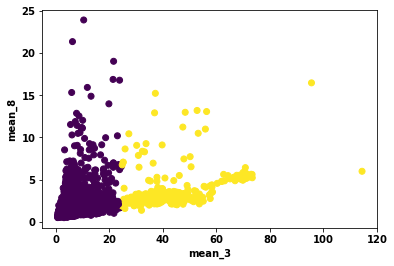

mean_3 peak-peak


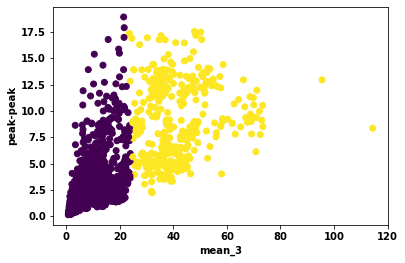

mean_3 rms


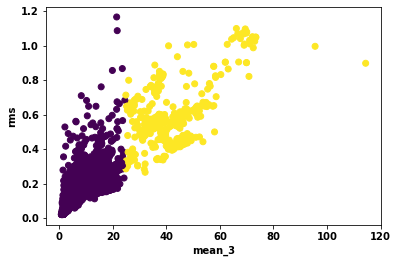

mean_3 skewness


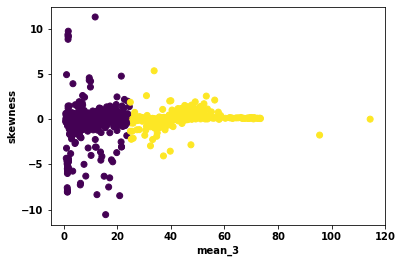

mean_3 var_1


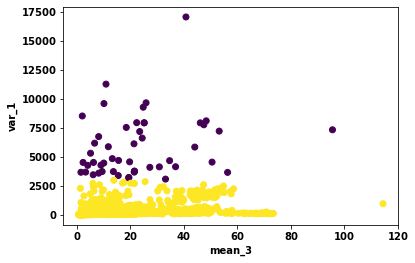

mean_3 var_2


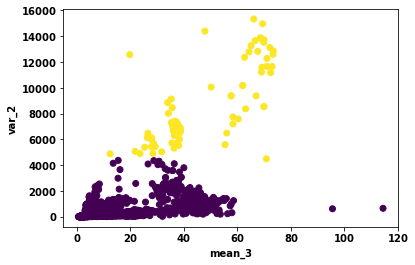

mean_3 var_3


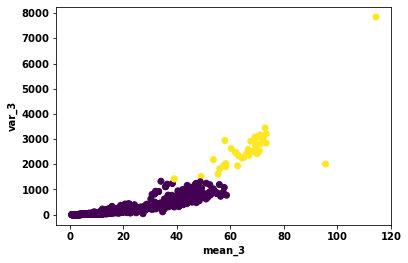

mean_3 var_4


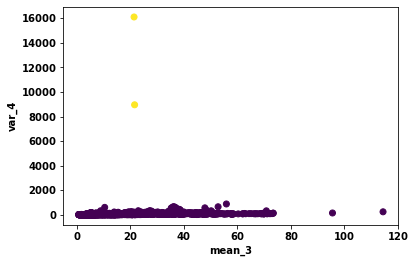

mean_3 var_5


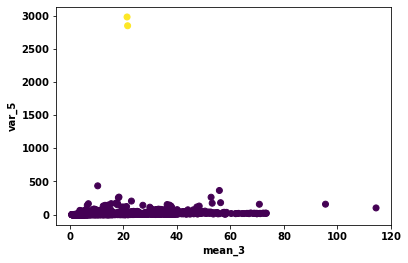

mean_3 var_6


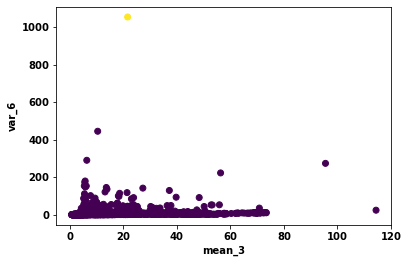

mean_3 var_7


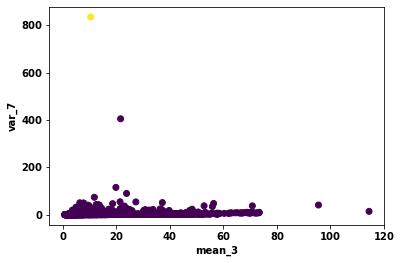

mean_3 var_8


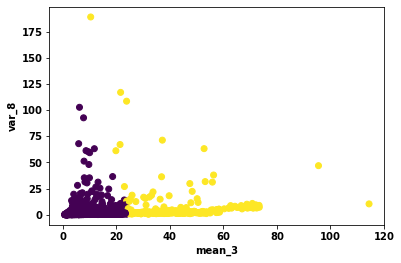

mean_3 variance


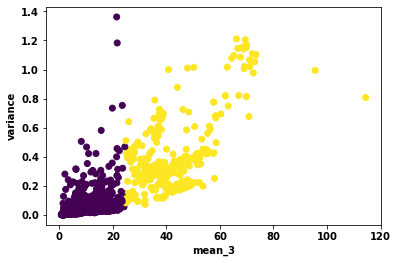

mean_4 crest


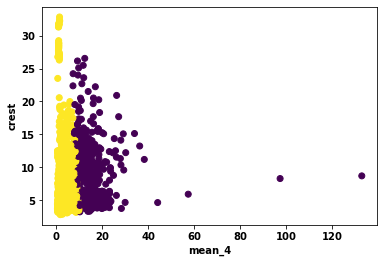

mean_4 freqAmpliKurt


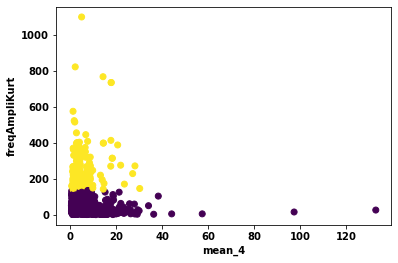

mean_4 freqAmpliMax


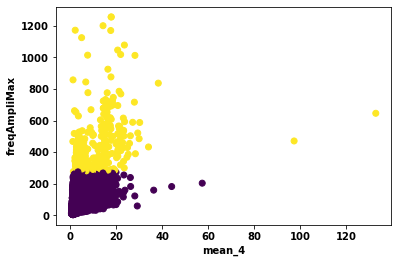

mean_4 freqAmpliMean


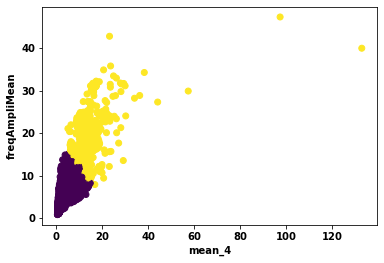

mean_4 freqAmpliVar


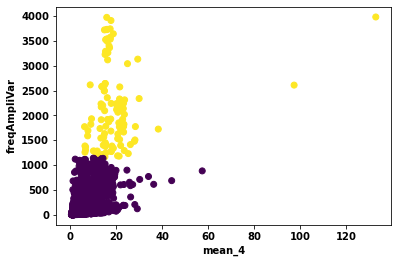

mean_4 freqAmpliskw


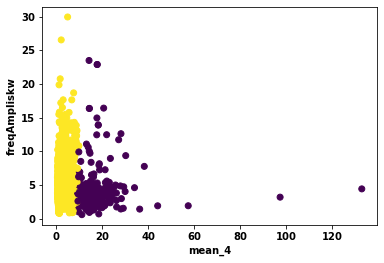

mean_4 kurt


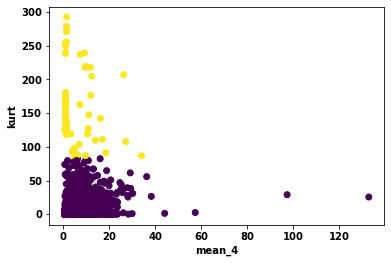

mean_4 max_1


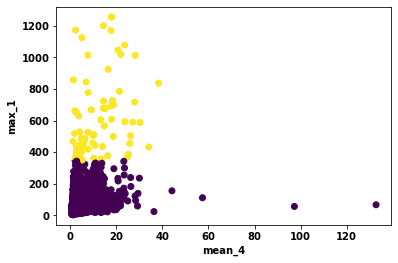

mean_4 max_2


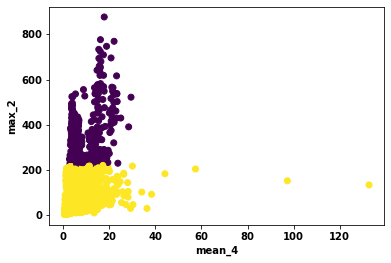

mean_4 max_3


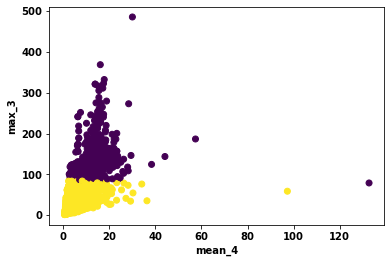

mean_4 max_4


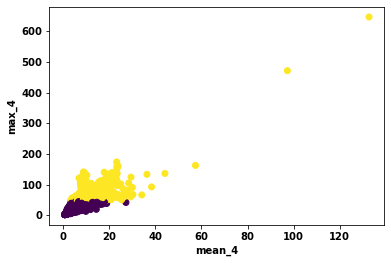

mean_4 max_5


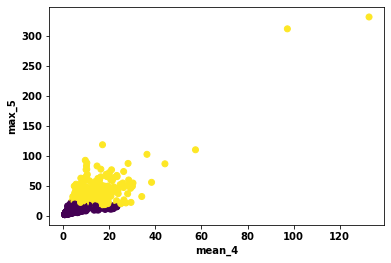

mean_4 max_6


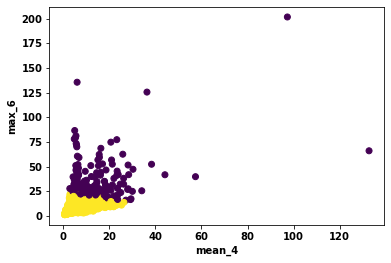

mean_4 max_7


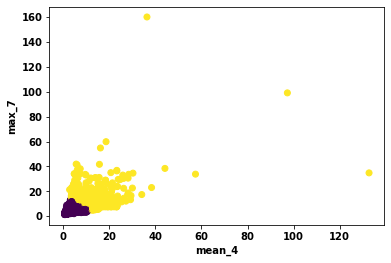

mean_4 max_8


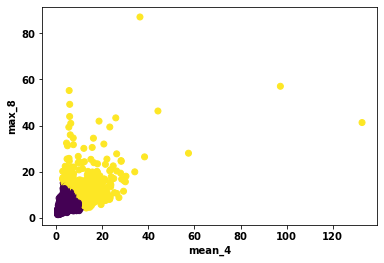

mean_4 mean


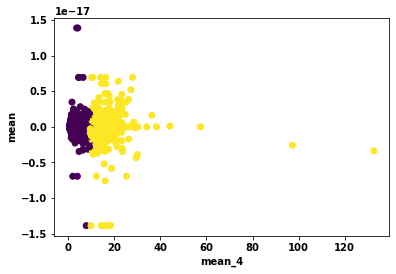

mean_4 mean_1


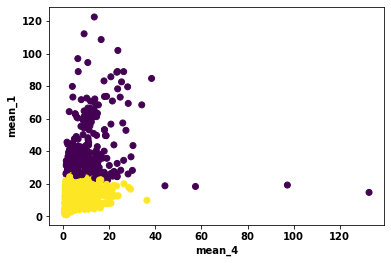

mean_4 mean_2


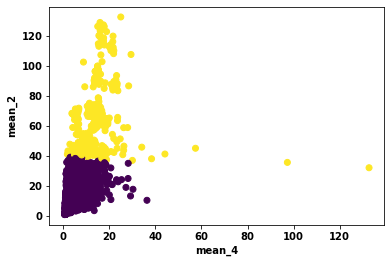

mean_4 mean_3


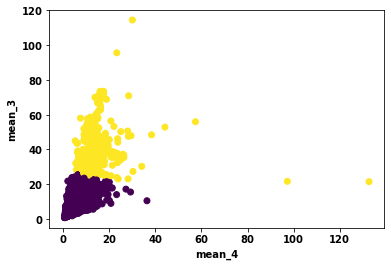

mean_4 mean_5


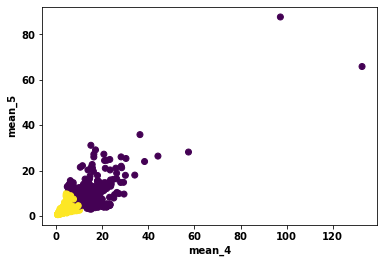

mean_4 mean_6


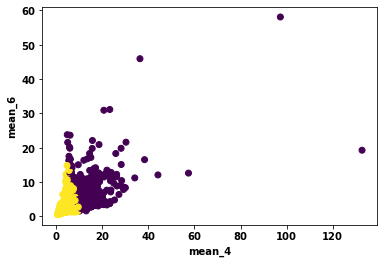

mean_4 mean_7


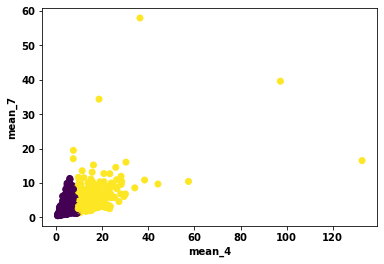

mean_4 mean_8


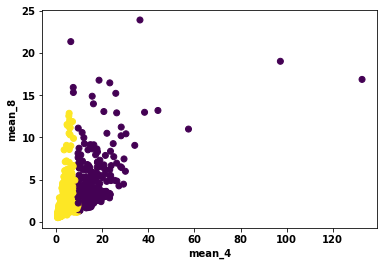

mean_4 peak-peak


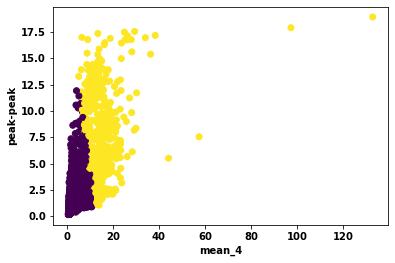

mean_4 rms


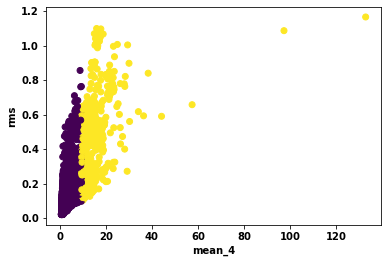

mean_4 skewness


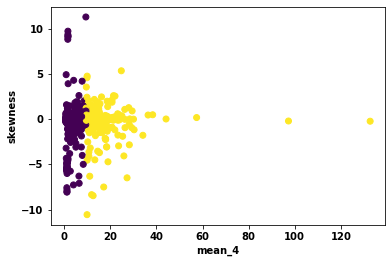

mean_4 var_1


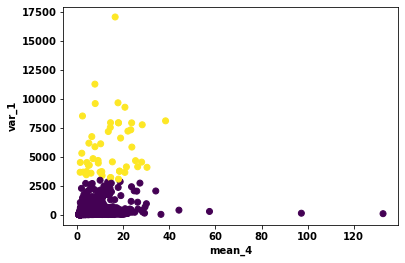

mean_4 var_2


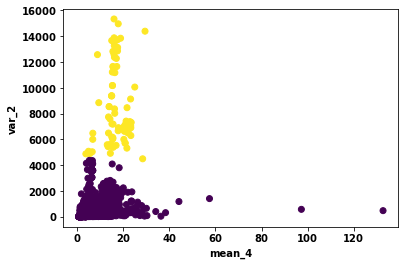

mean_4 var_3


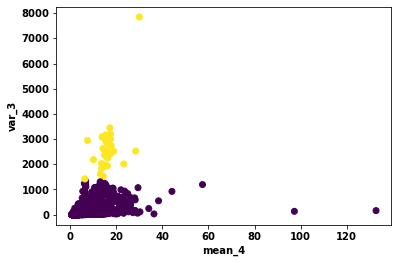

mean_4 var_4


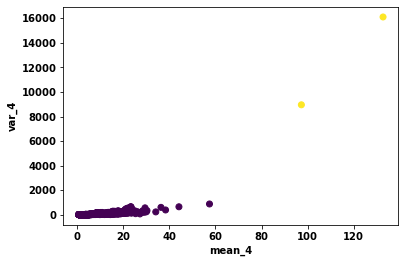

mean_4 var_5


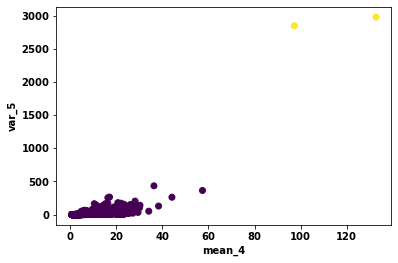

mean_4 var_6


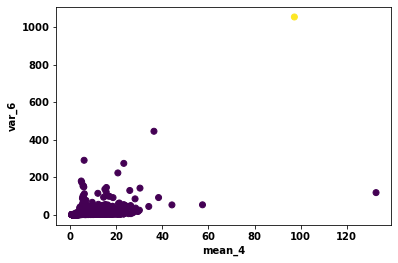

mean_4 var_7


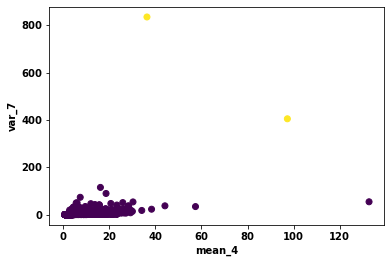

mean_4 var_8


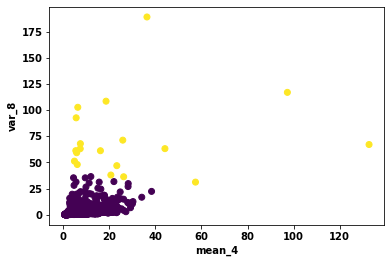

mean_4 variance


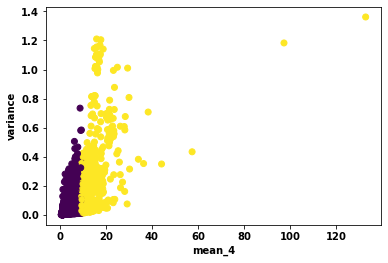

mean_5 crest


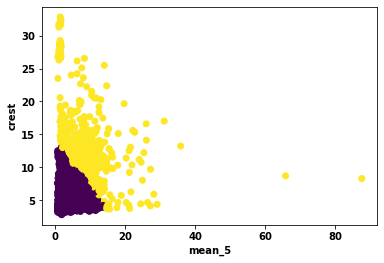

mean_5 freqAmpliKurt


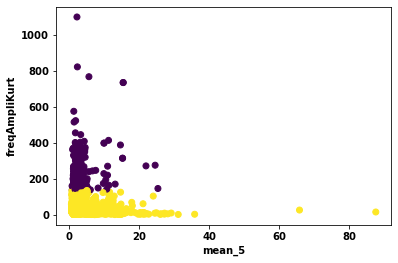

mean_5 freqAmpliMax


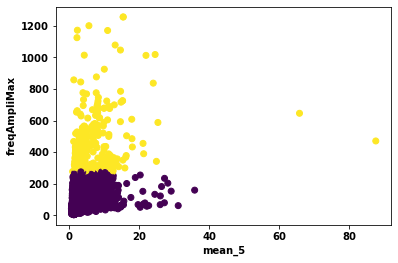

mean_5 freqAmpliMean


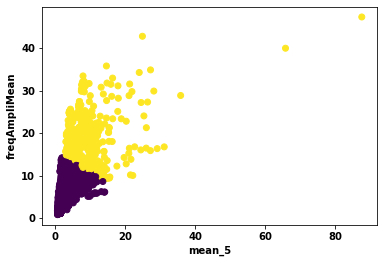

mean_5 freqAmpliVar


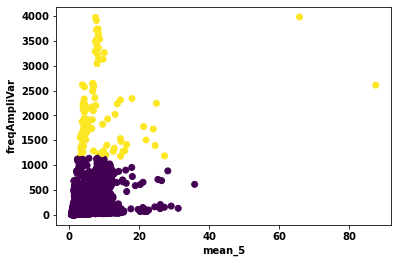

mean_5 freqAmpliskw


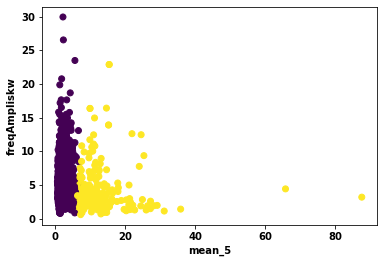

mean_5 kurt


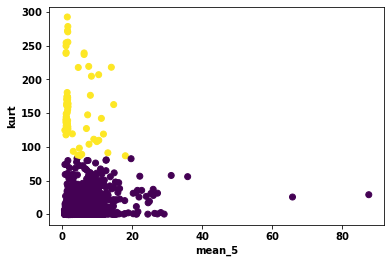

mean_5 max_1


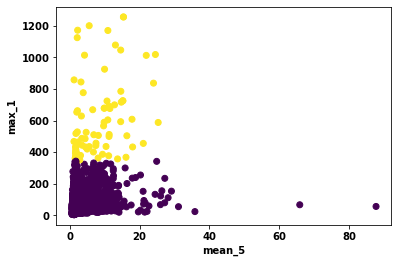

mean_5 max_2


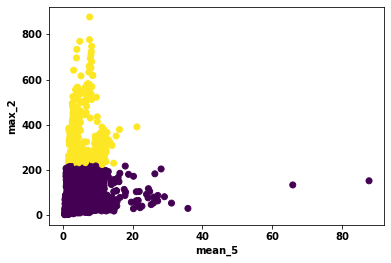

mean_5 max_3


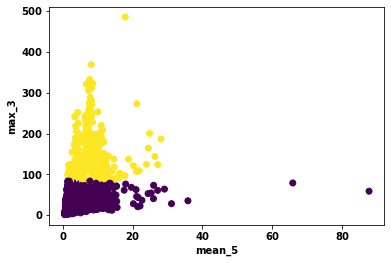

mean_5 max_4


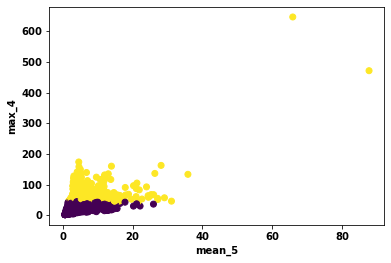

mean_5 max_5


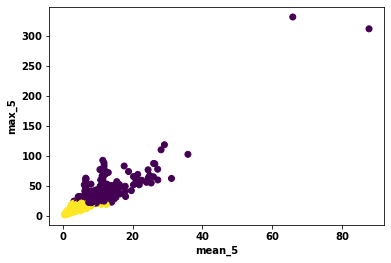

mean_5 max_6


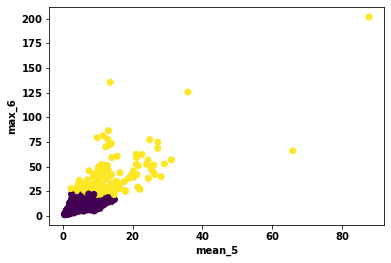

mean_5 max_7


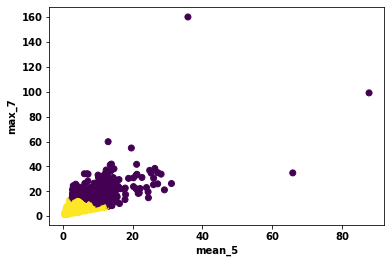

mean_5 max_8


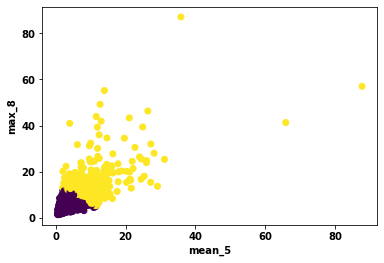

mean_5 mean


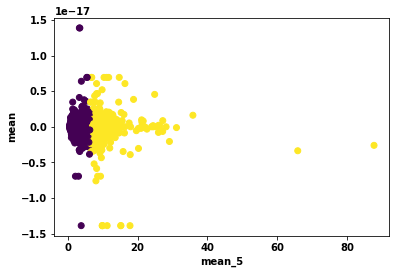

mean_5 mean_1


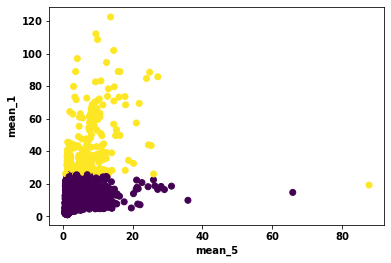

mean_5 mean_2


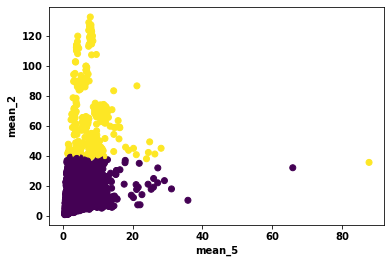

mean_5 mean_3


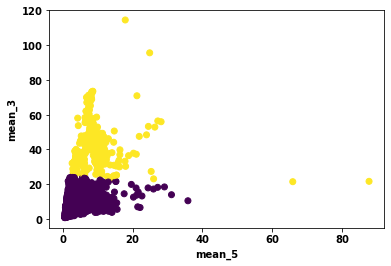

mean_5 mean_4


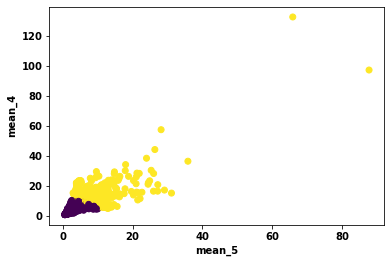

mean_5 mean_6


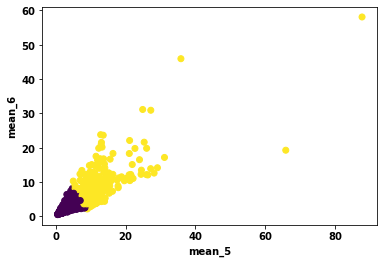

mean_5 mean_7


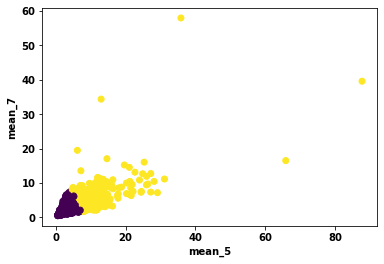

mean_5 mean_8


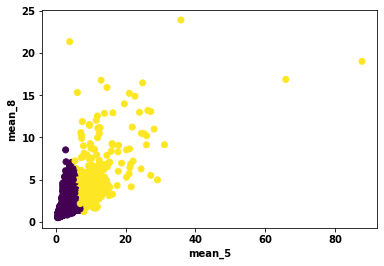

mean_5 peak-peak


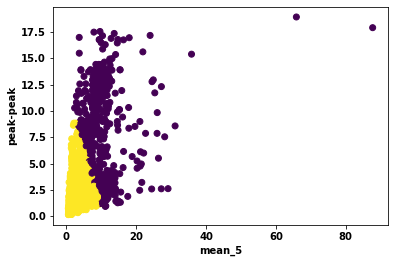

mean_5 rms


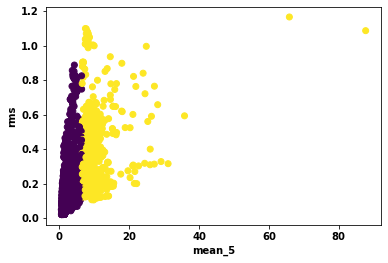

mean_5 skewness


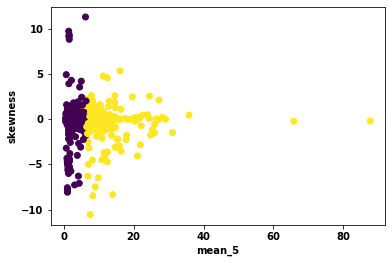

mean_5 var_1


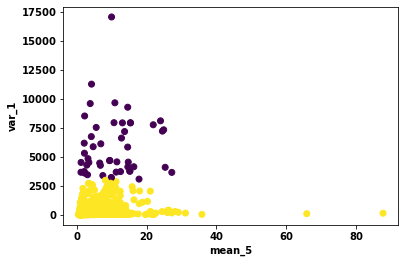

mean_5 var_2


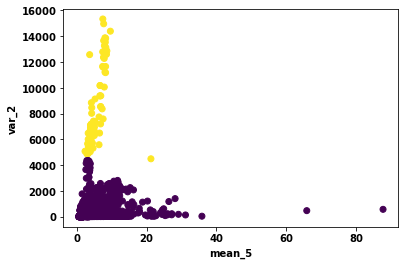

mean_5 var_3


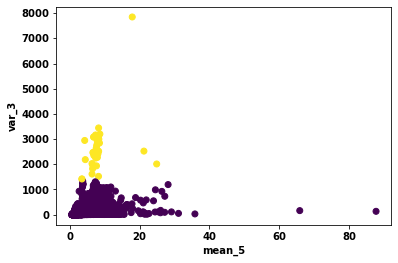

mean_5 var_4


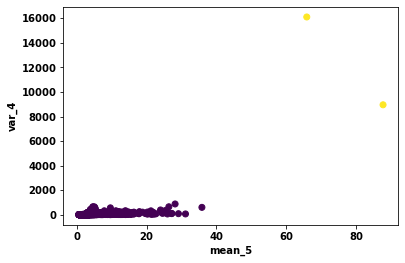

mean_5 var_5


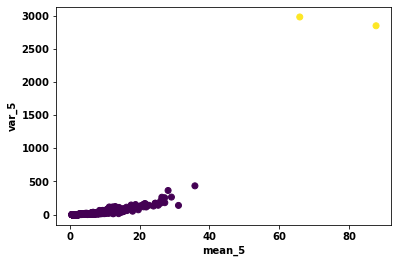

mean_5 var_6


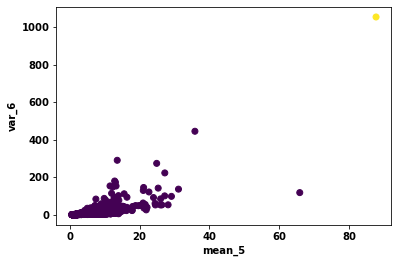

mean_5 var_7


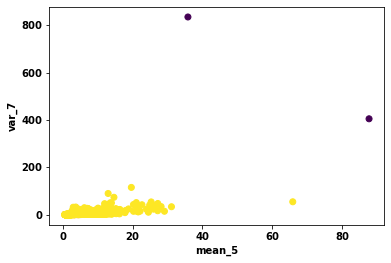

mean_5 var_8


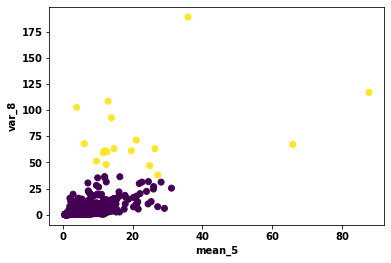

mean_5 variance


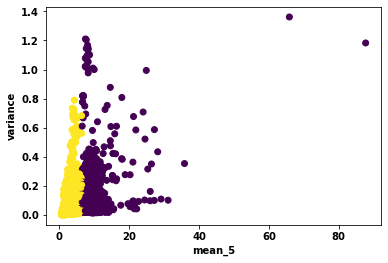

mean_6 crest


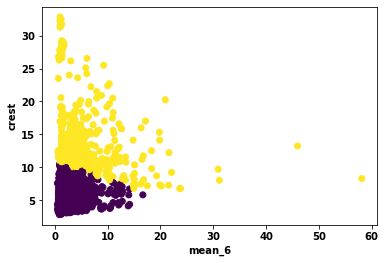

mean_6 freqAmpliKurt


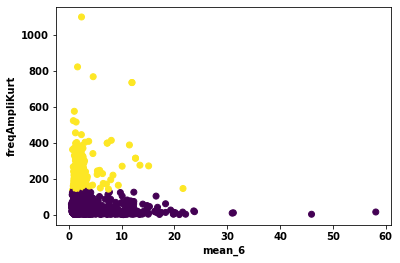

mean_6 freqAmpliMax


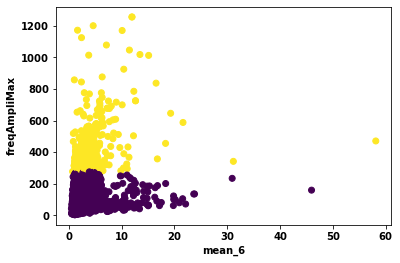

mean_6 freqAmpliMean


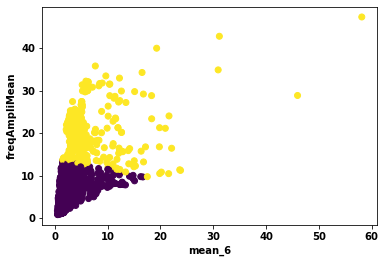

mean_6 freqAmpliVar


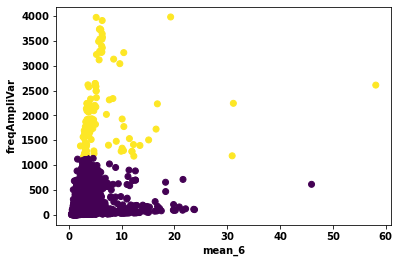

mean_6 freqAmpliskw


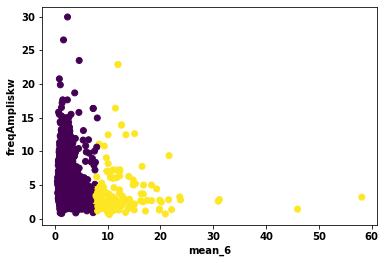

mean_6 kurt


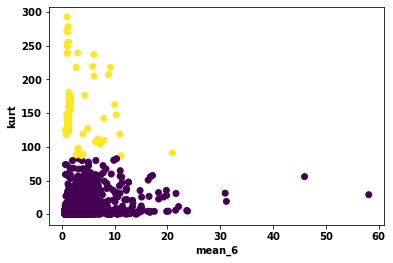

mean_6 max_1


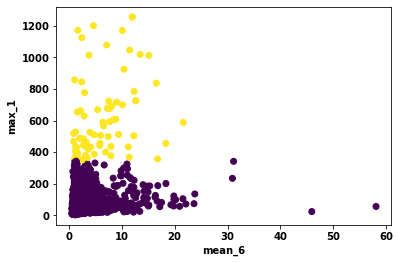

mean_6 max_2


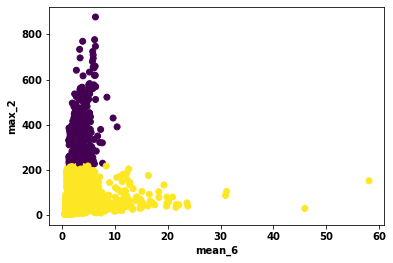

mean_6 max_3


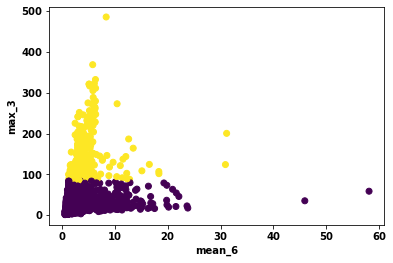

mean_6 max_4


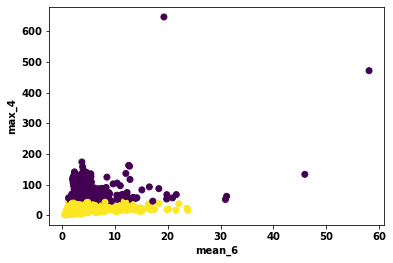

mean_6 max_5


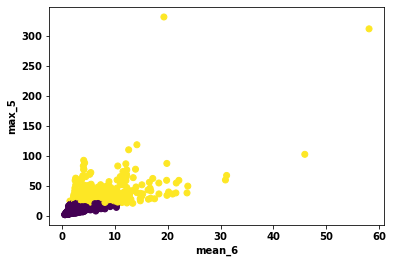

mean_6 max_6


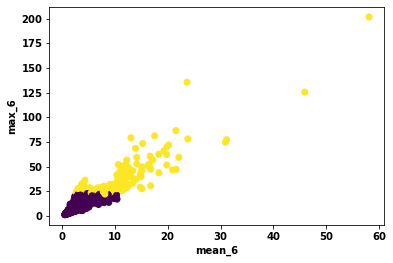

mean_6 max_7


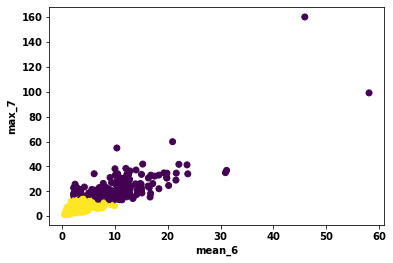

mean_6 max_8


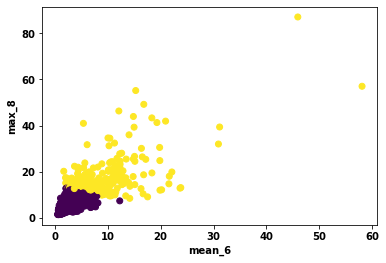

mean_6 mean


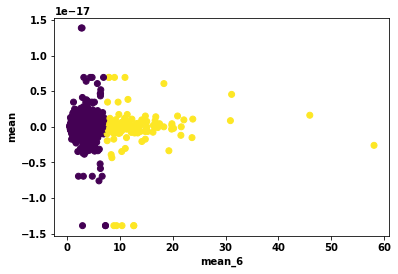

mean_6 mean_1


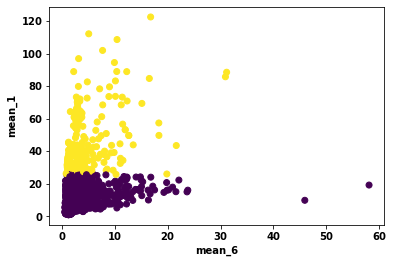

mean_6 mean_2


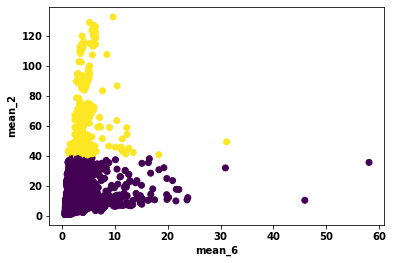

mean_6 mean_3


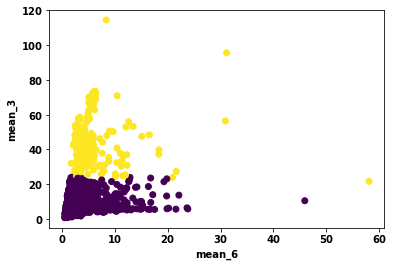

mean_6 mean_4


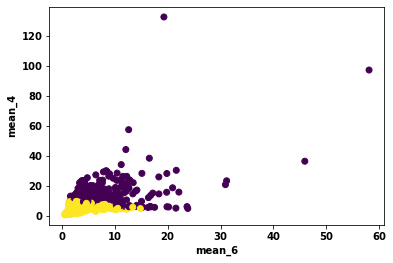

mean_6 mean_5


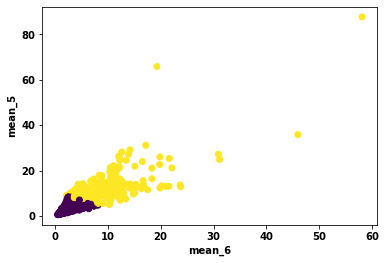

mean_6 mean_7


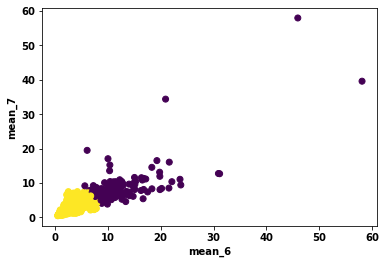

mean_6 mean_8


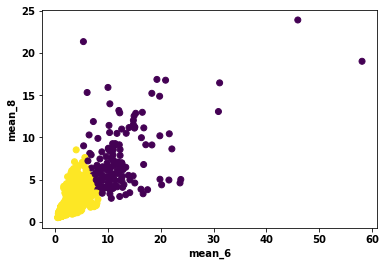

mean_6 peak-peak


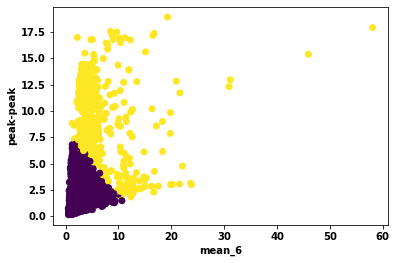

mean_6 rms


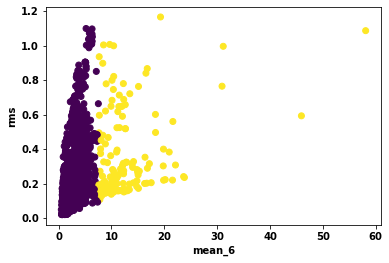

mean_6 skewness


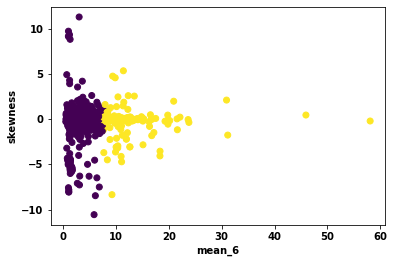

mean_6 var_1


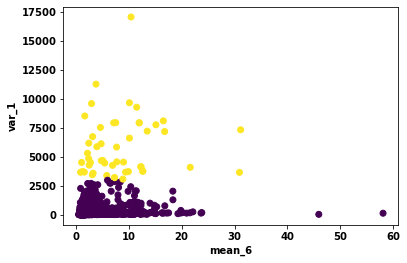

mean_6 var_2


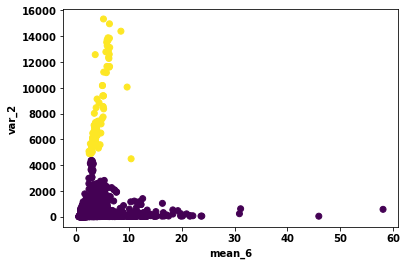

mean_6 var_3


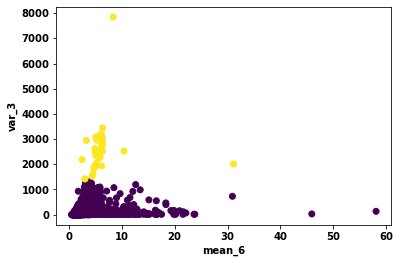

mean_6 var_4


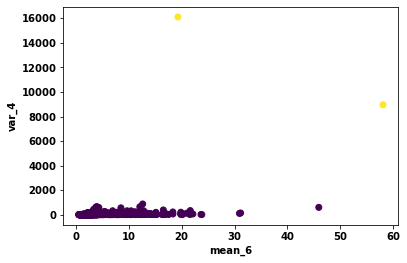

mean_6 var_5


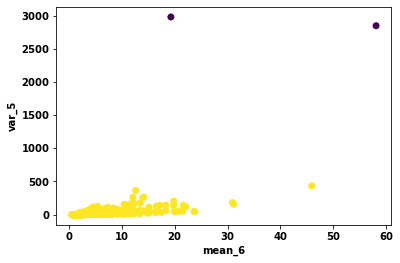

mean_6 var_6


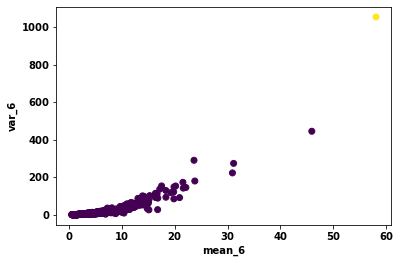

mean_6 var_7


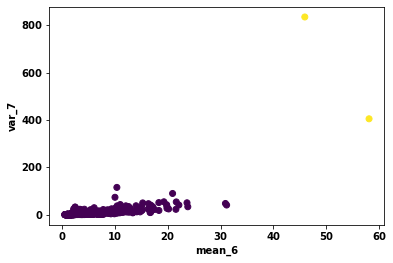

mean_6 var_8


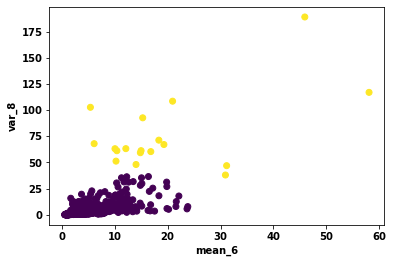

mean_6 variance


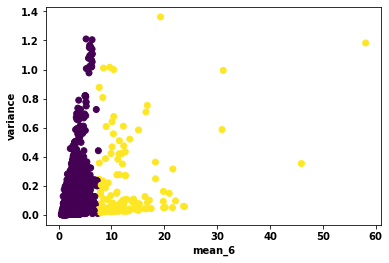

mean_7 crest


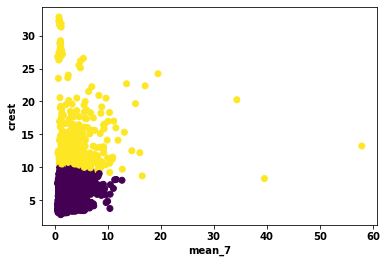

mean_7 freqAmpliKurt


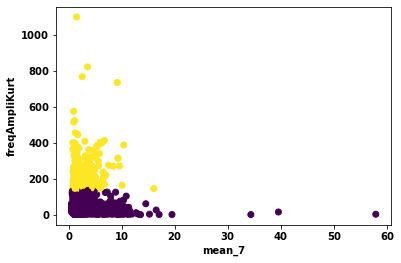

mean_7 freqAmpliMax


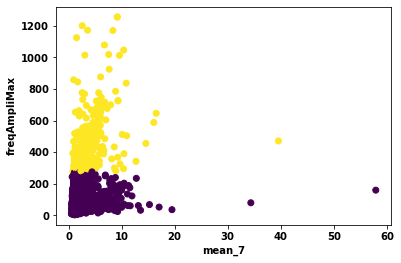

mean_7 freqAmpliMean


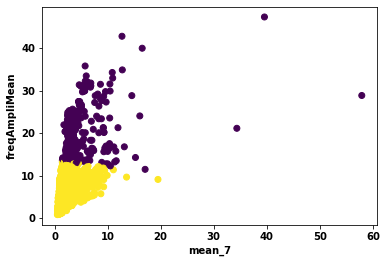

mean_7 freqAmpliVar


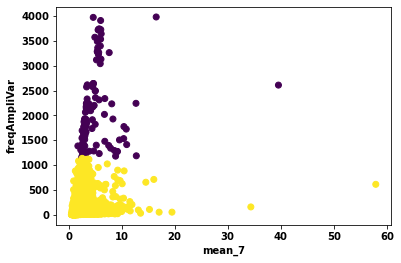

mean_7 freqAmpliskw


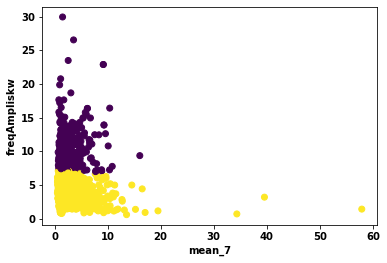

mean_7 kurt


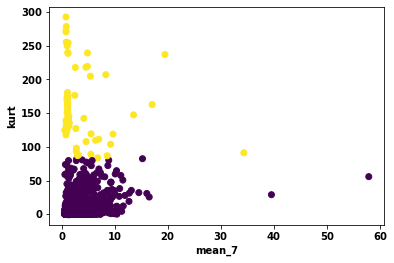

mean_7 max_1


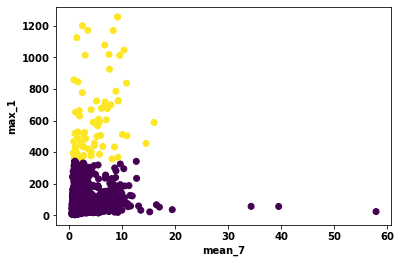

mean_7 max_2


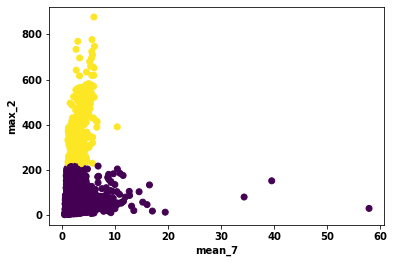

mean_7 max_3


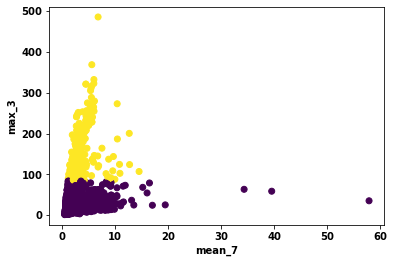

mean_7 max_4


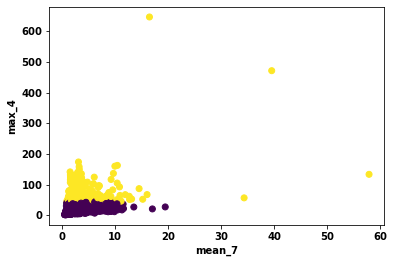

mean_7 max_5


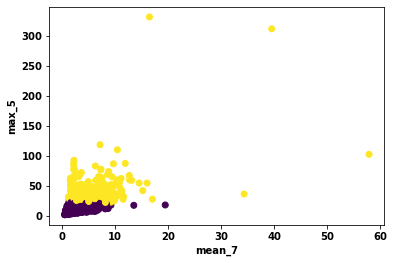

mean_7 max_6


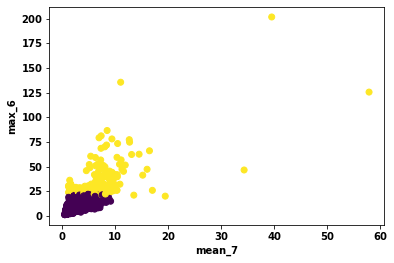

mean_7 max_7


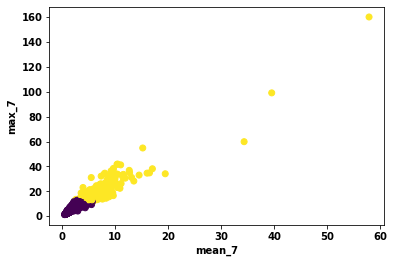

mean_7 max_8


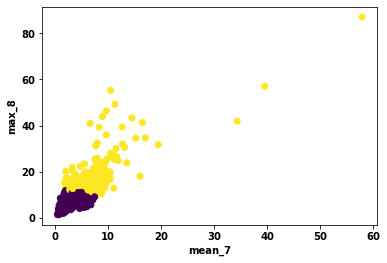

mean_7 mean


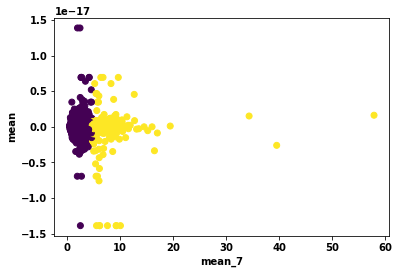

mean_7 mean_1


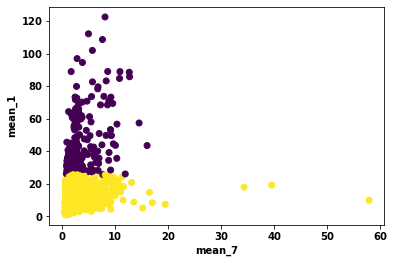

mean_7 mean_2


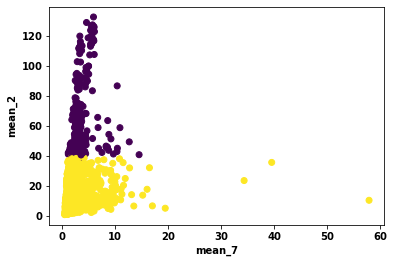

mean_7 mean_3


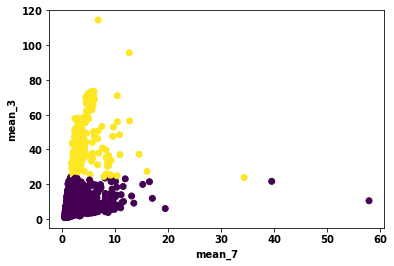

mean_7 mean_4


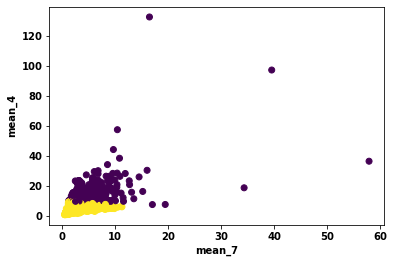

mean_7 mean_5


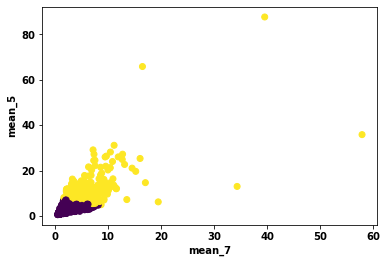

mean_7 mean_6


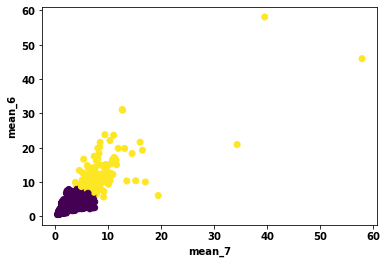

mean_7 mean_8


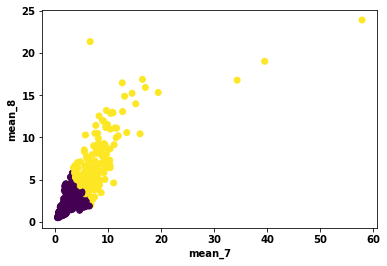

mean_7 peak-peak


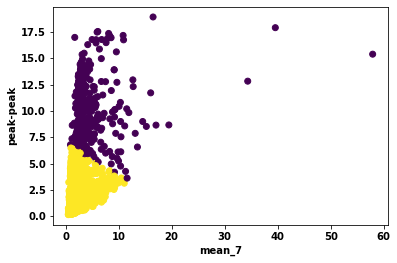

mean_7 rms


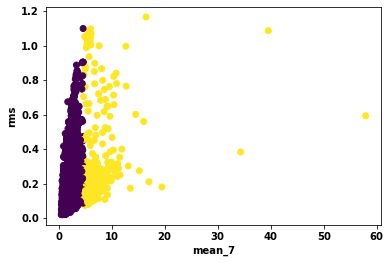

mean_7 skewness


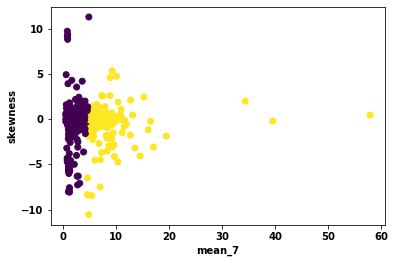

mean_7 var_1


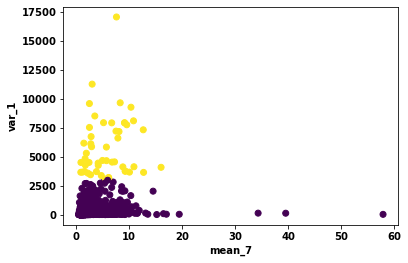

mean_7 var_2


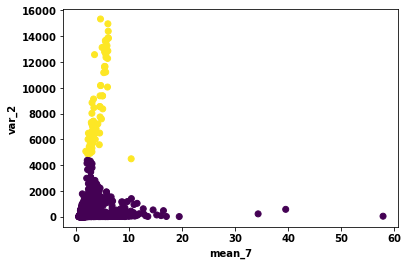

mean_7 var_3


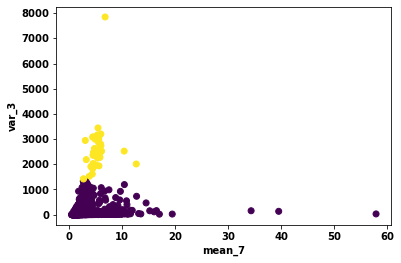

mean_7 var_4


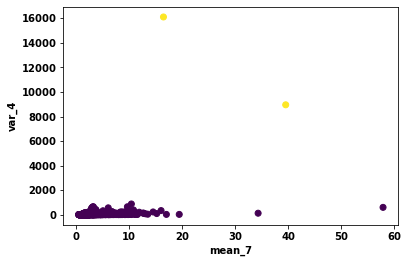

mean_7 var_5


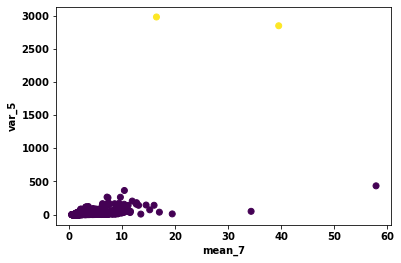

mean_7 var_6


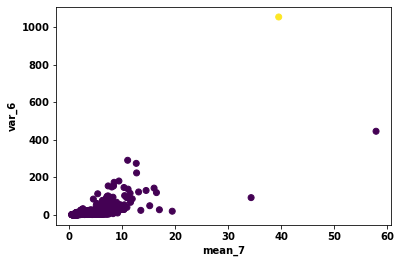

mean_7 var_7


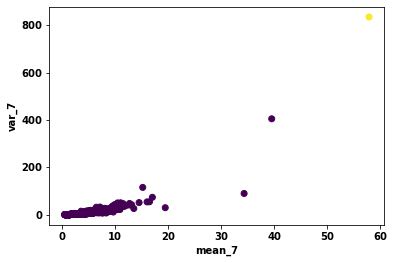

mean_7 var_8


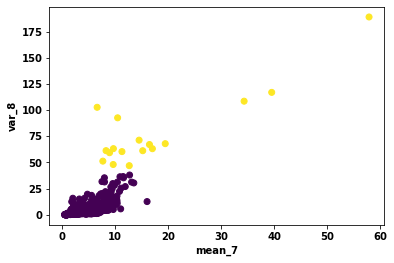

mean_7 variance


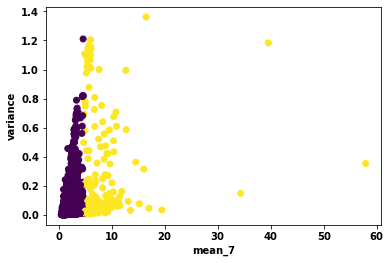

mean_8 crest


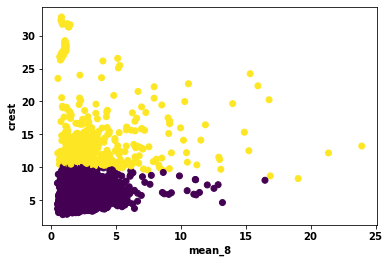

mean_8 freqAmpliKurt


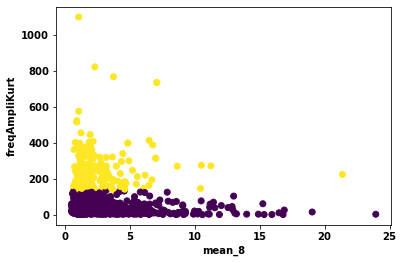

mean_8 freqAmpliMax


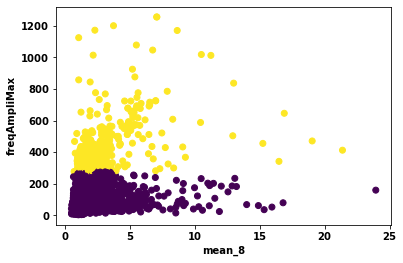

mean_8 freqAmpliMean


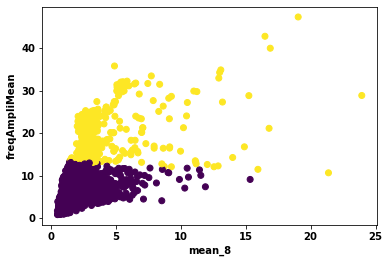

mean_8 freqAmpliVar


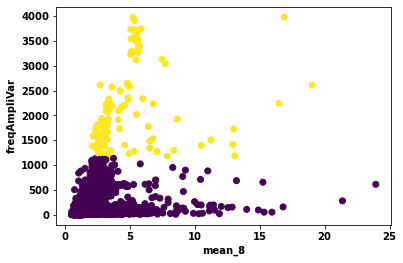

mean_8 freqAmpliskw


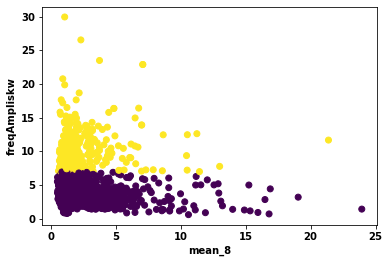

mean_8 kurt


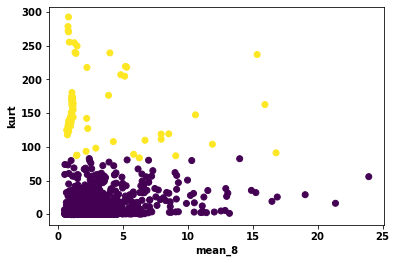

mean_8 max_1


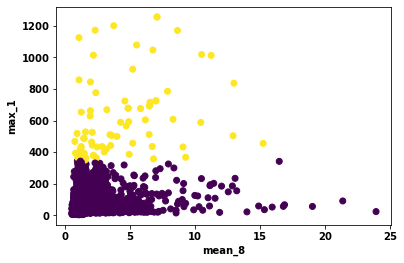

mean_8 max_2


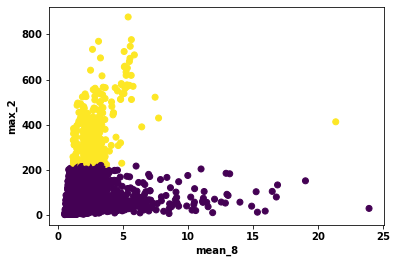

mean_8 max_3


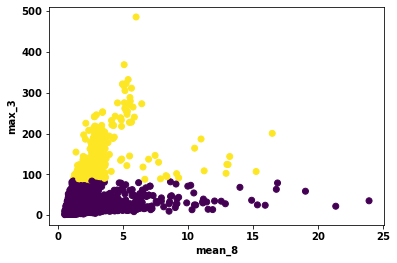

mean_8 max_4


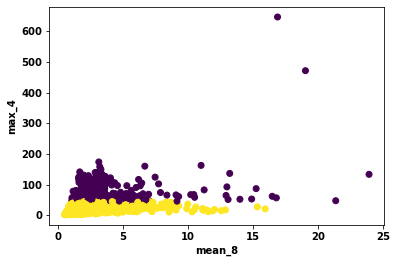

mean_8 max_5


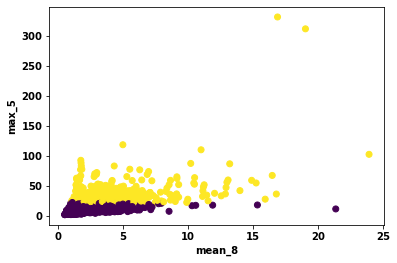

mean_8 max_6


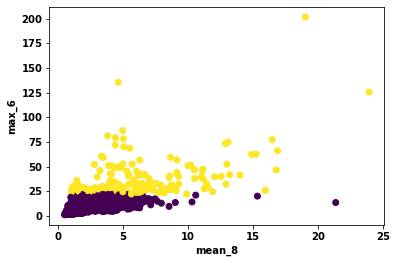

mean_8 max_7


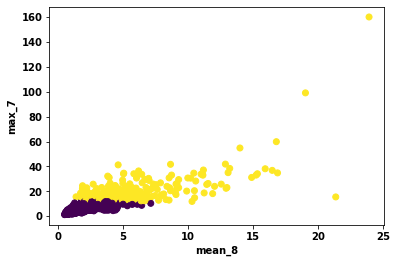

mean_8 max_8


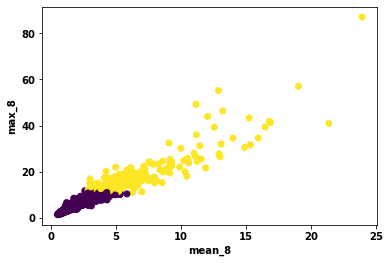

mean_8 mean


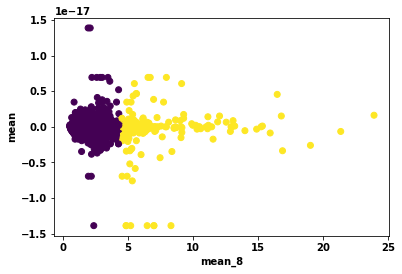

mean_8 mean_1


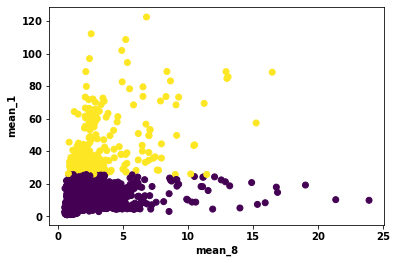

mean_8 mean_2


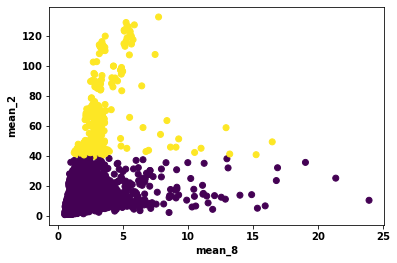

mean_8 mean_3


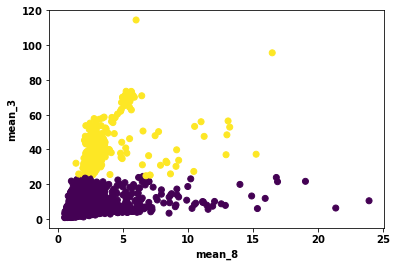

mean_8 mean_4


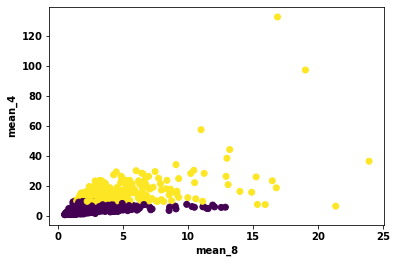

mean_8 mean_5


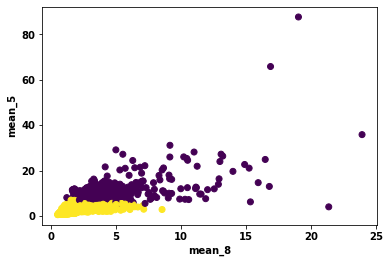

mean_8 mean_6


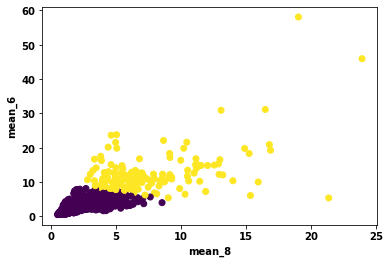

mean_8 mean_7


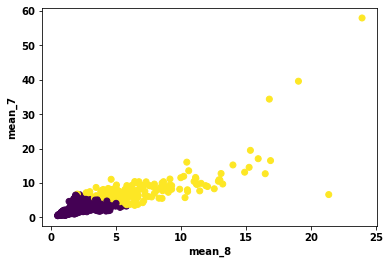

mean_8 peak-peak


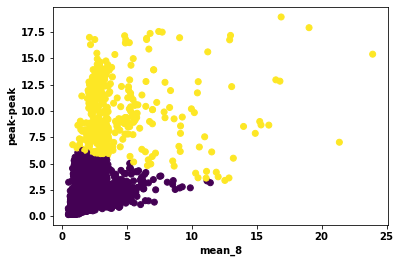

mean_8 rms


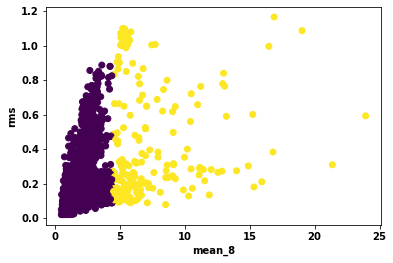

mean_8 skewness


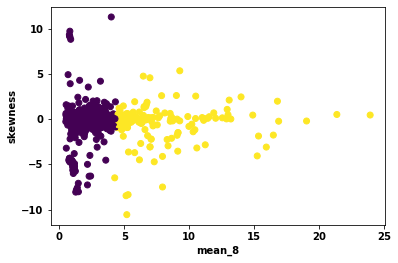

mean_8 var_1


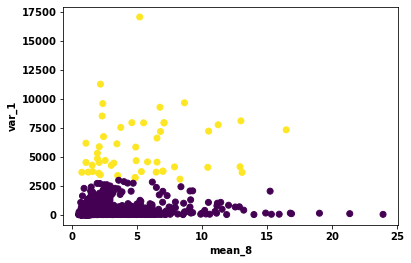

mean_8 var_2


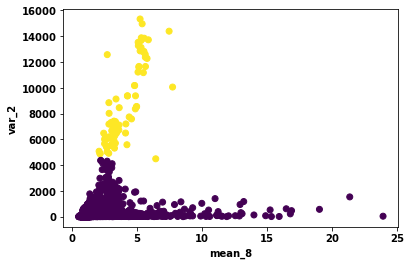

mean_8 var_3


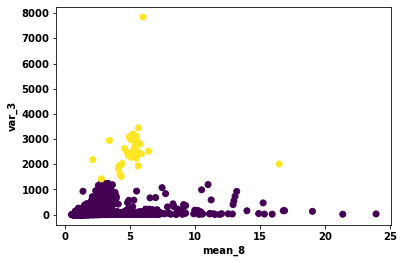

mean_8 var_4


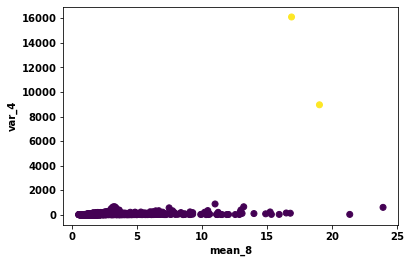

mean_8 var_5


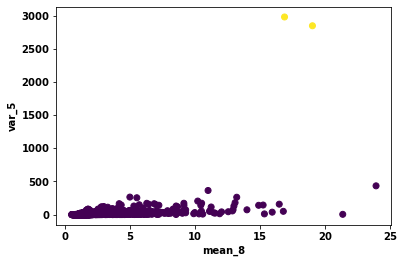

mean_8 var_6


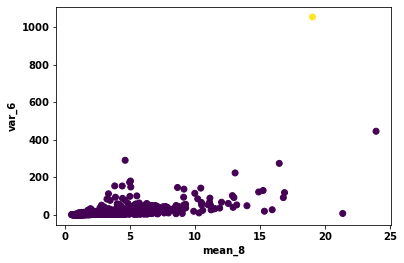

mean_8 var_7


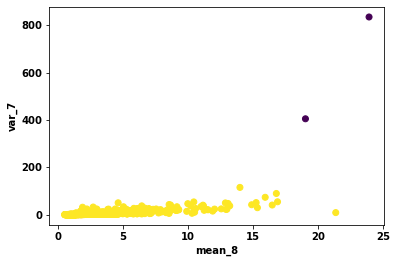

mean_8 var_8


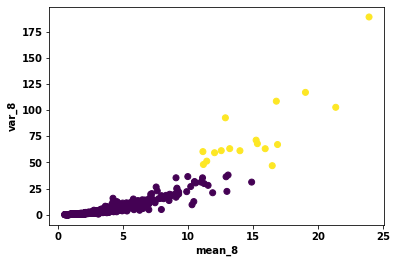

mean_8 variance


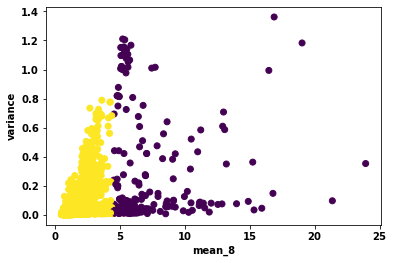

peak-peak crest


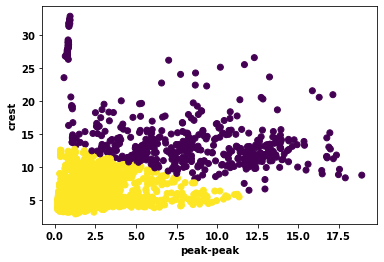

peak-peak freqAmpliKurt


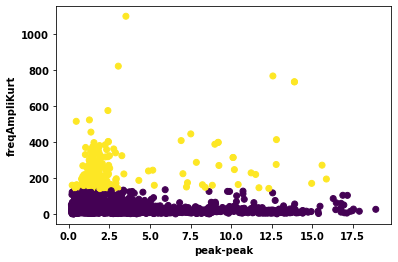

peak-peak freqAmpliMax


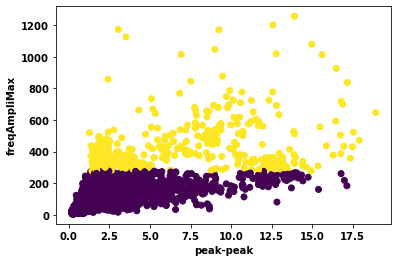

peak-peak freqAmpliMean


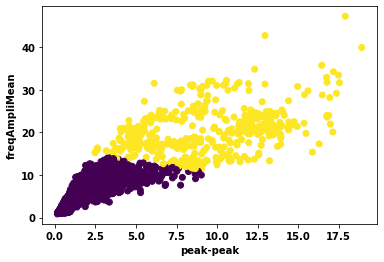

peak-peak freqAmpliVar


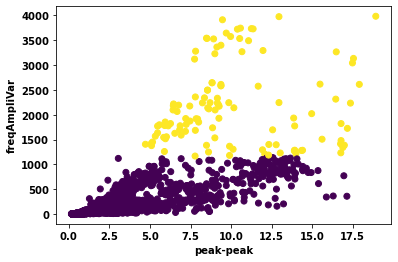

peak-peak freqAmpliskw


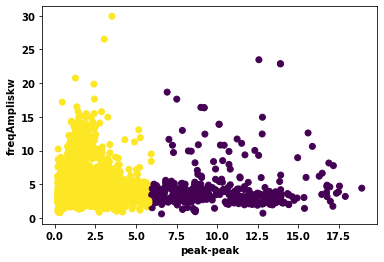

peak-peak kurt


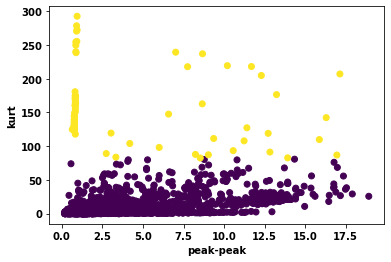

peak-peak max_1


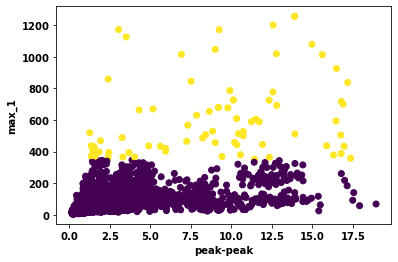

peak-peak max_2


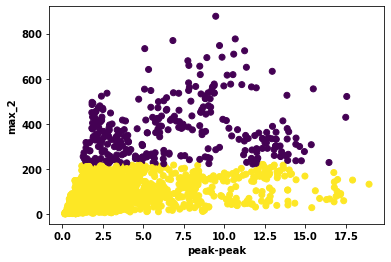

peak-peak max_3


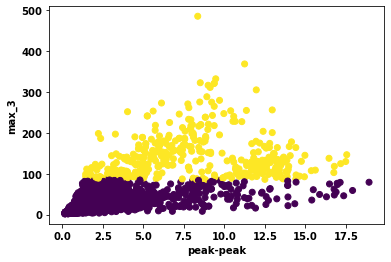

peak-peak max_4


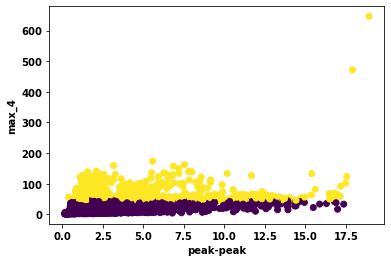

peak-peak max_5


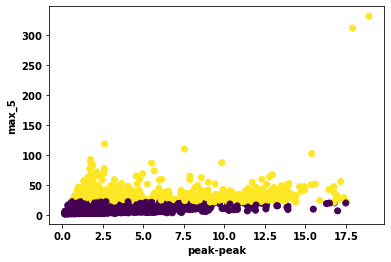

peak-peak max_6


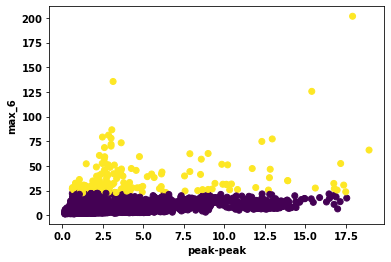

peak-peak max_7


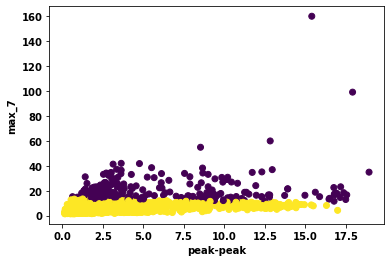

peak-peak max_8


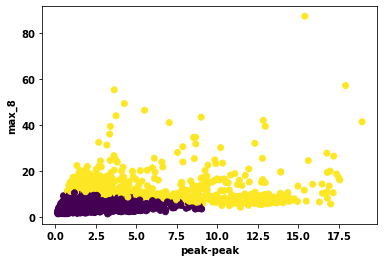

peak-peak mean


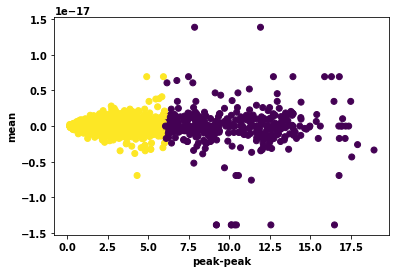

peak-peak mean_1


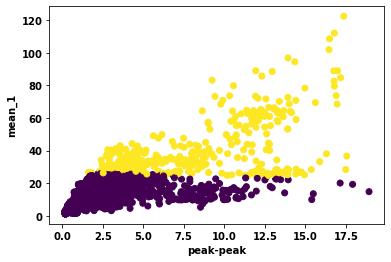

peak-peak mean_2


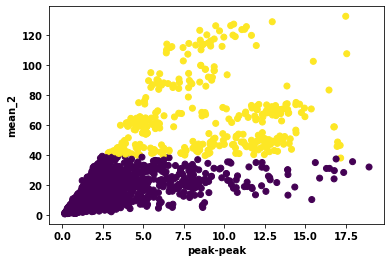

peak-peak mean_3


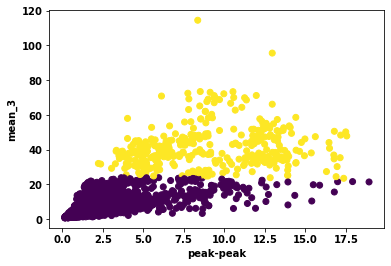

peak-peak mean_4


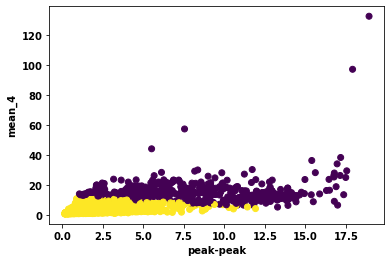

peak-peak mean_5


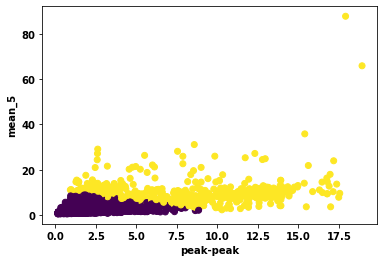

peak-peak mean_6


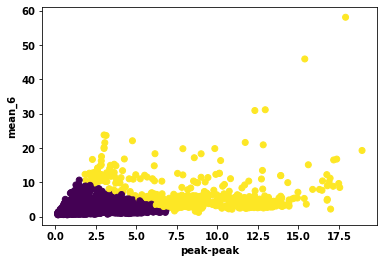

peak-peak mean_7


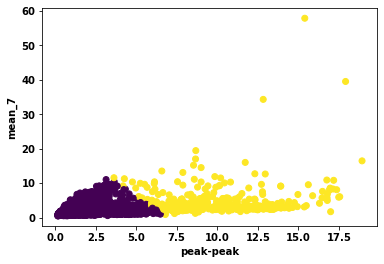

peak-peak mean_8


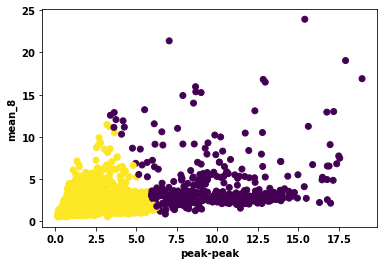

peak-peak rms


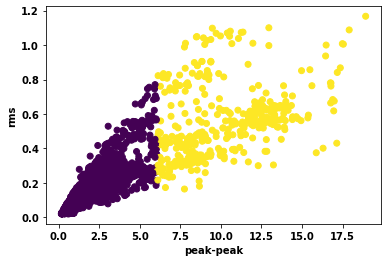

peak-peak skewness


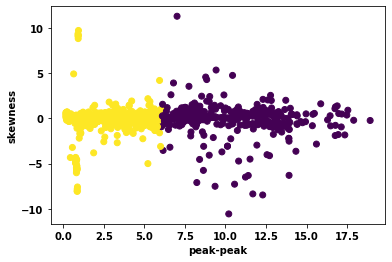

peak-peak var_1


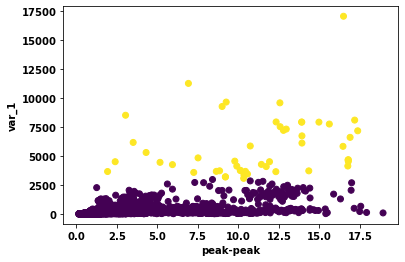

peak-peak var_2


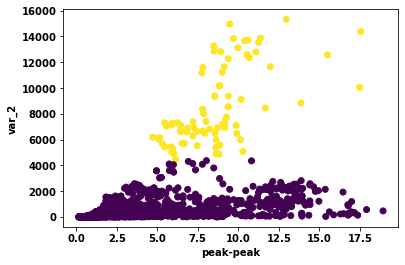

peak-peak var_3


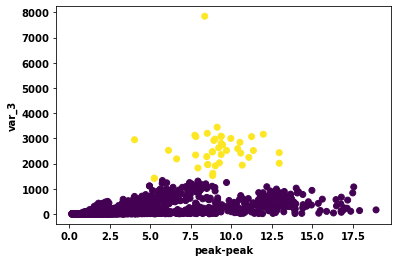

peak-peak var_4


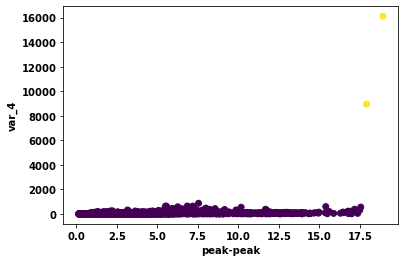

peak-peak var_5


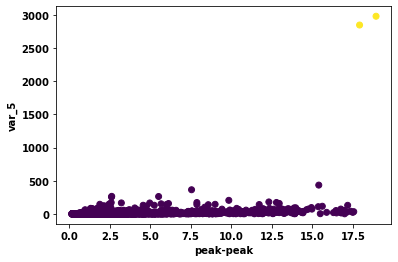

peak-peak var_6


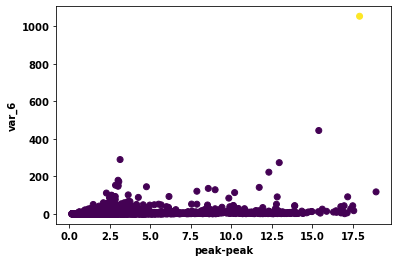

peak-peak var_7


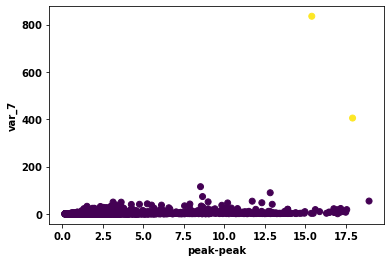

peak-peak var_8


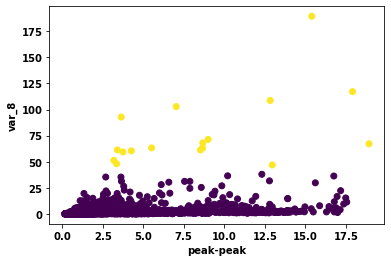

peak-peak variance


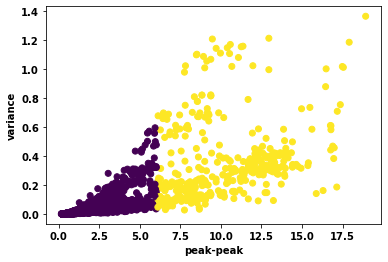

rms crest


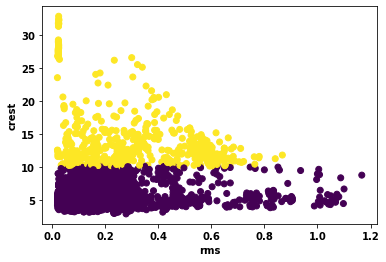

rms freqAmpliKurt


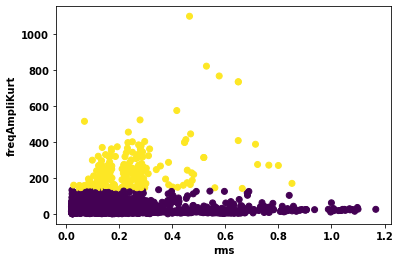

rms freqAmpliMax


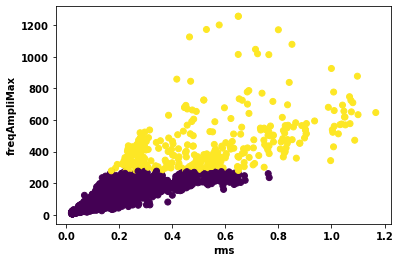

rms freqAmpliMean


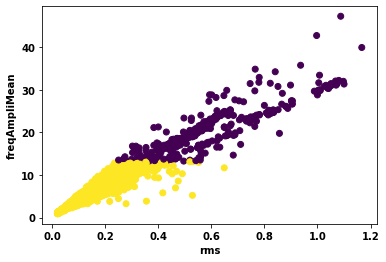

rms freqAmpliVar


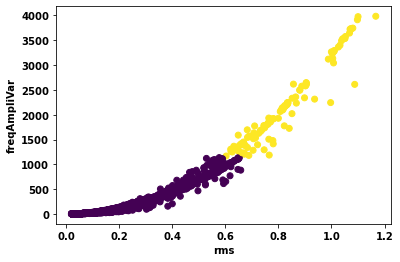

rms freqAmpliskw


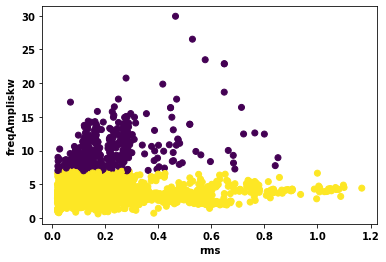

rms kurt


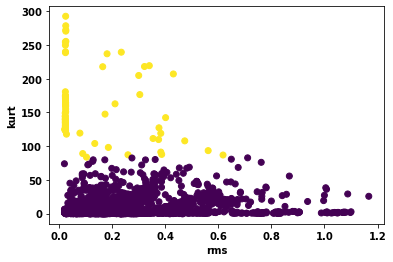

rms max_1


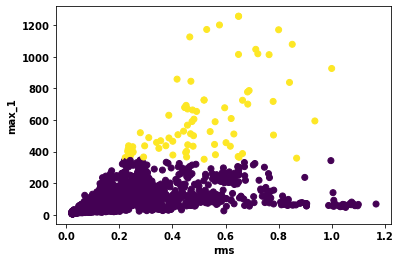

rms max_2


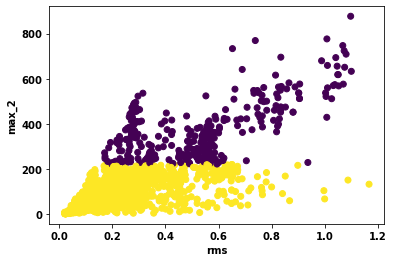

rms max_3


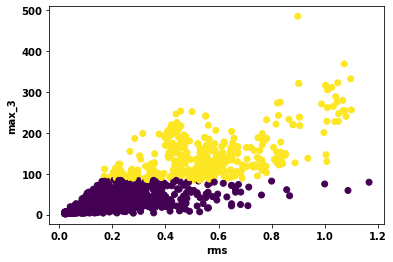

rms max_4


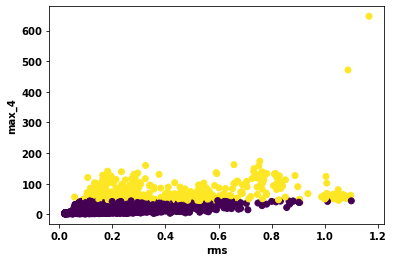

rms max_5


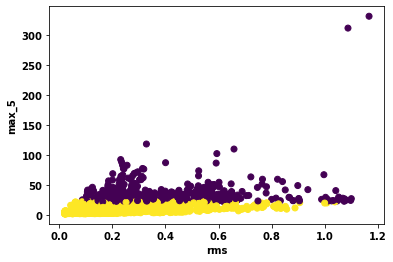

rms max_6


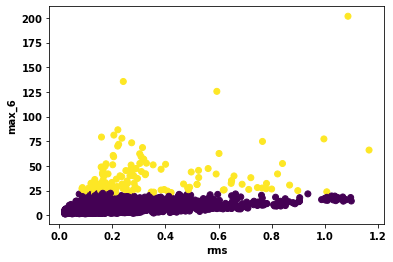

rms max_7


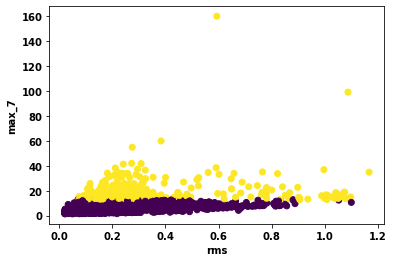

rms max_8


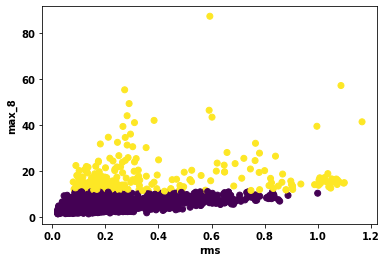

rms mean


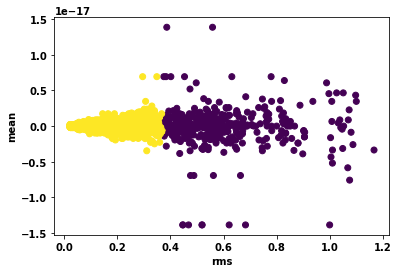

rms mean_1


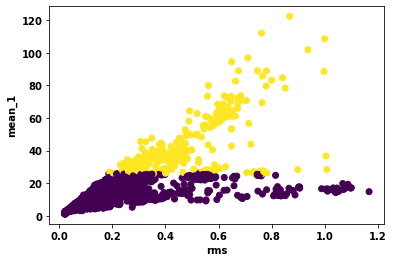

rms mean_2


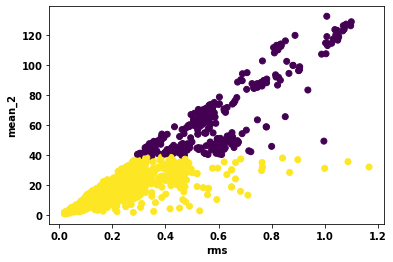

rms mean_3


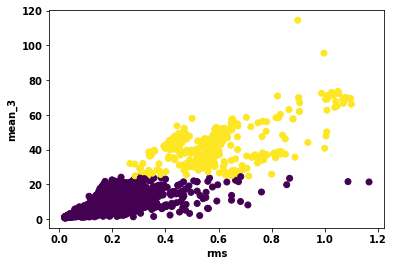

rms mean_4


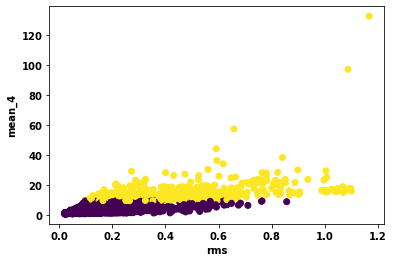

rms mean_5


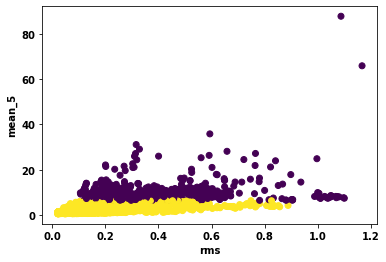

rms mean_6


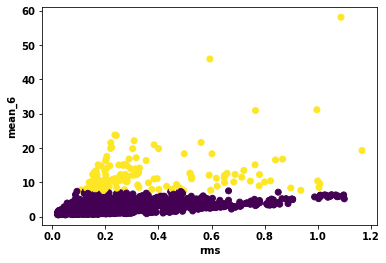

rms mean_7


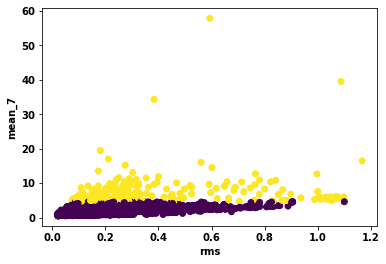

rms mean_8


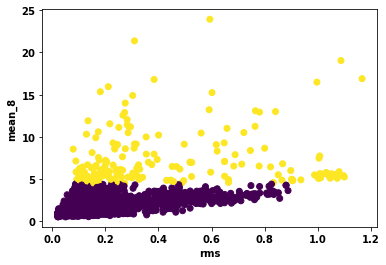

rms peak-peak


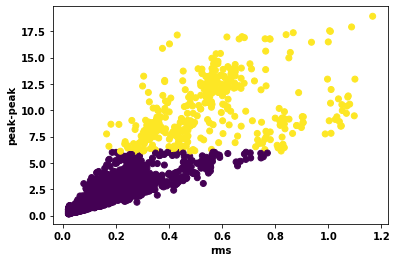

rms skewness


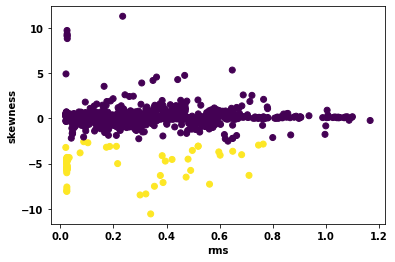

rms var_1


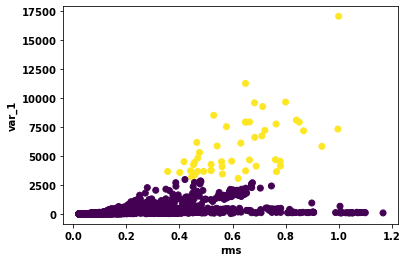

rms var_2


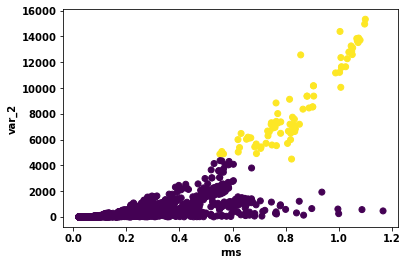

rms var_3


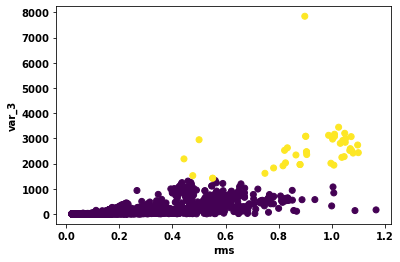

rms var_4


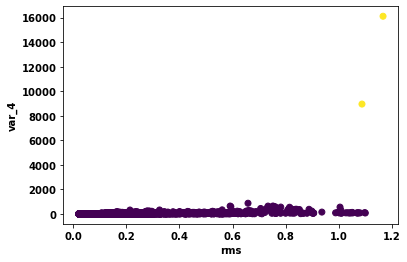

rms var_5


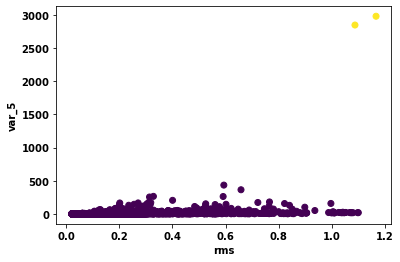

rms var_6


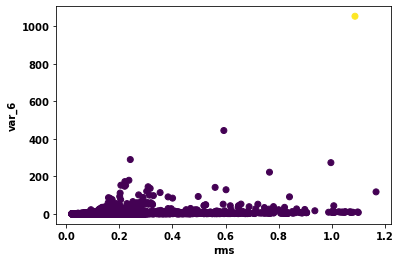

rms var_7


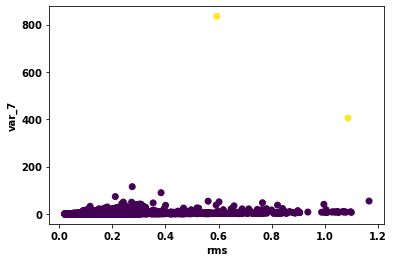

rms var_8


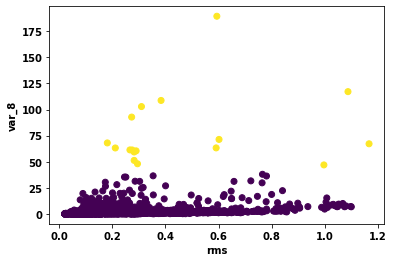

rms variance


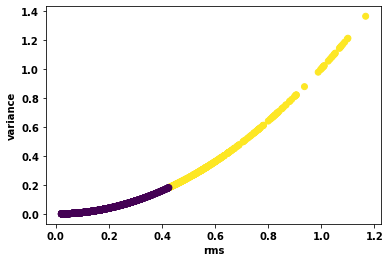

skewness crest


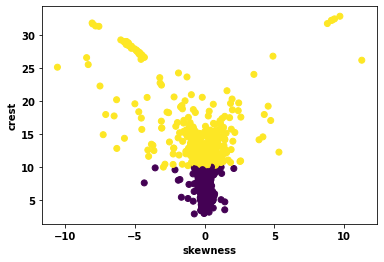

skewness freqAmpliKurt


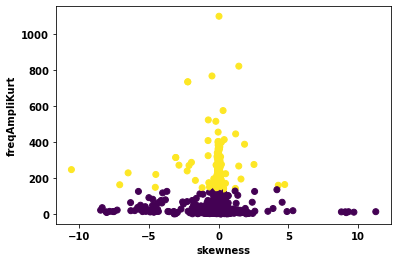

skewness freqAmpliMax


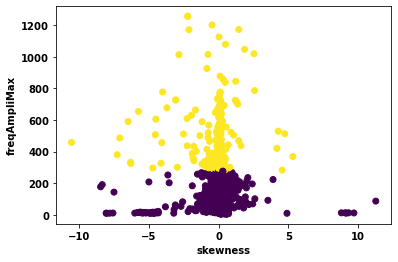

skewness freqAmpliMean


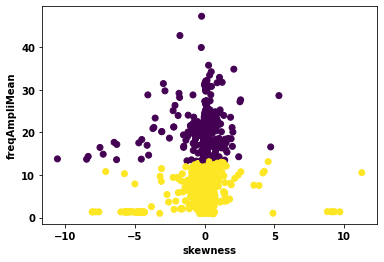

skewness freqAmpliVar


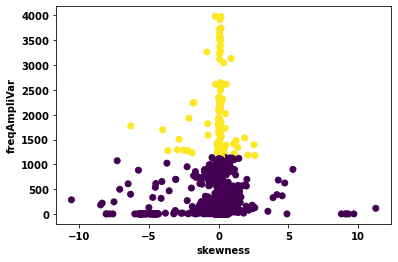

skewness freqAmpliskw


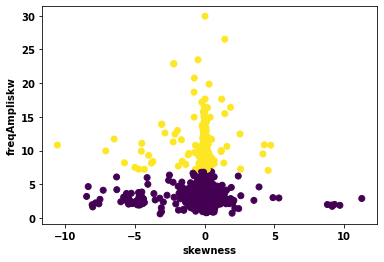

skewness kurt


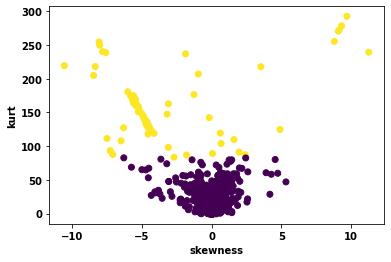

skewness max_1


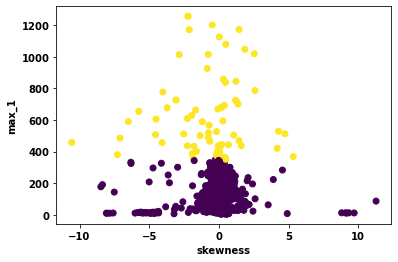

skewness max_2


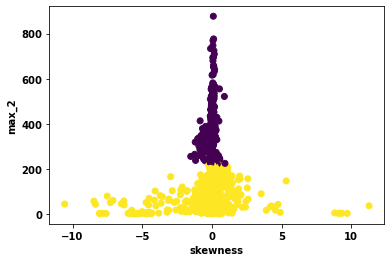

skewness max_3


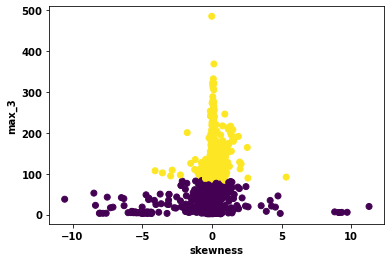

skewness max_4


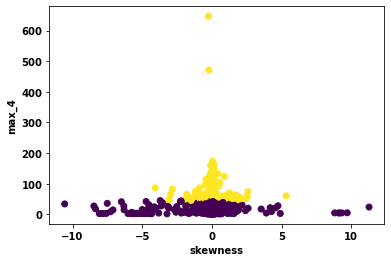

skewness max_5


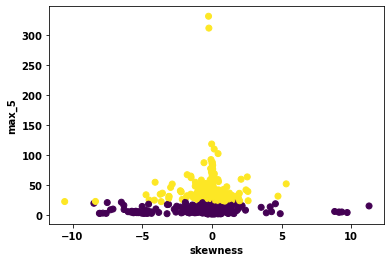

skewness max_6


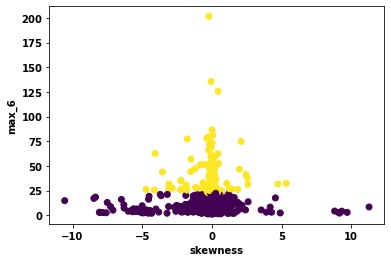

skewness max_7


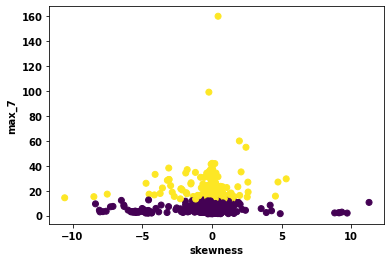

skewness max_8


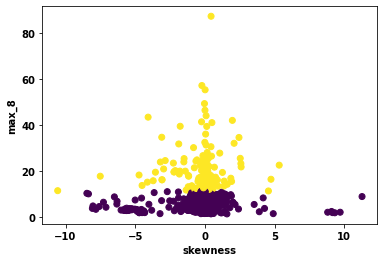

skewness mean


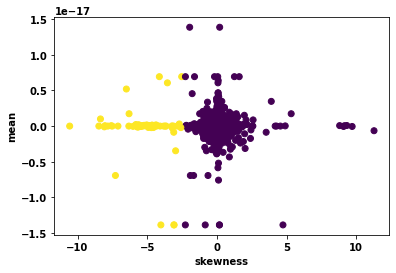

skewness mean_1


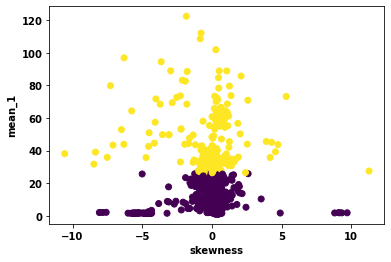

skewness mean_2


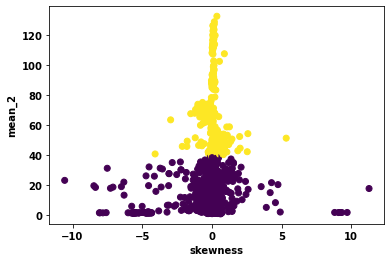

skewness mean_3


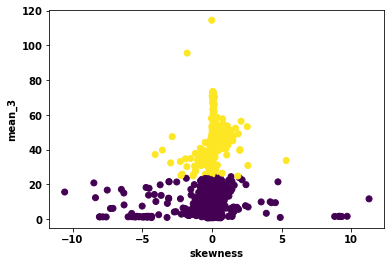

skewness mean_4


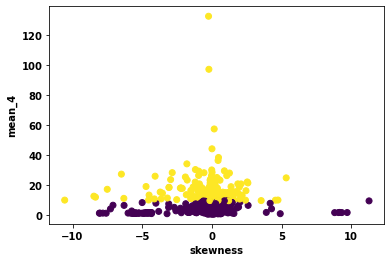

skewness mean_5


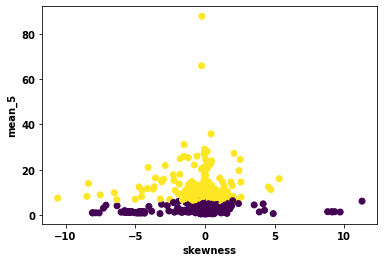

skewness mean_6


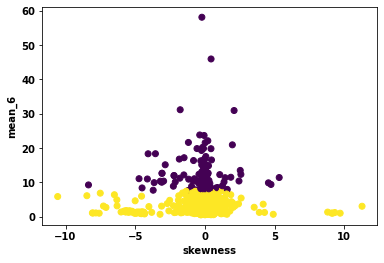

skewness mean_7


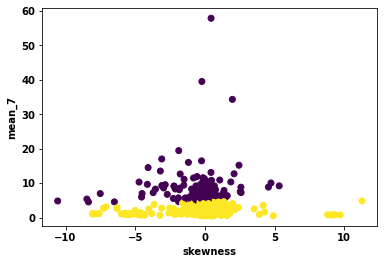

skewness mean_8


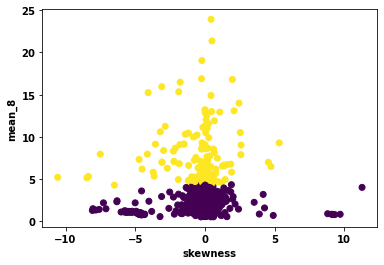

skewness peak-peak


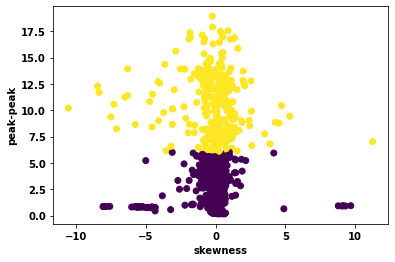

skewness rms


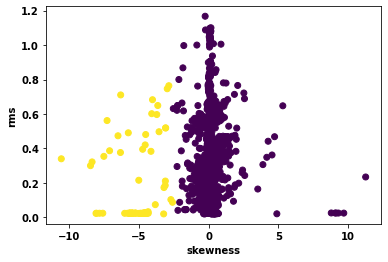

skewness var_1


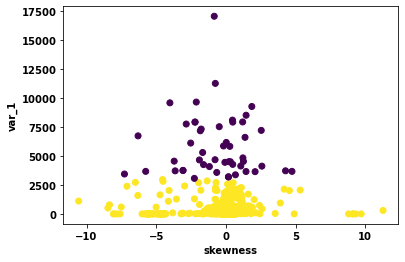

skewness var_2


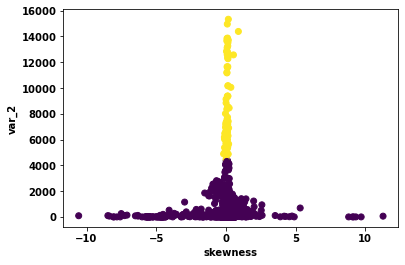

skewness var_3


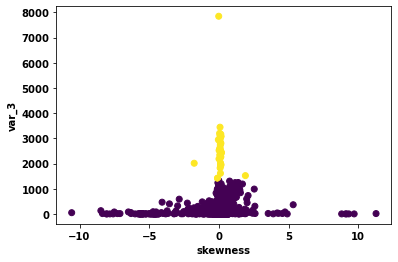

skewness var_4


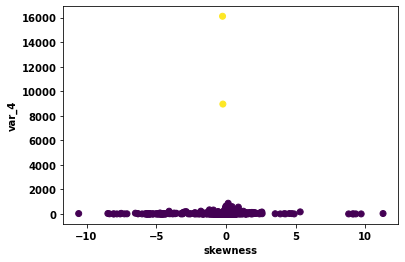

skewness var_5


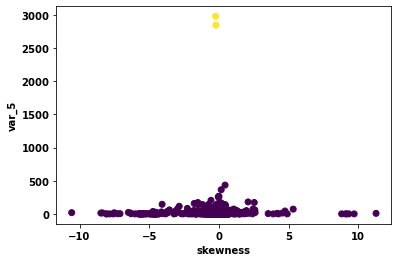

skewness var_6


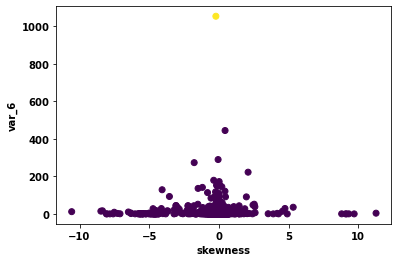

skewness var_7


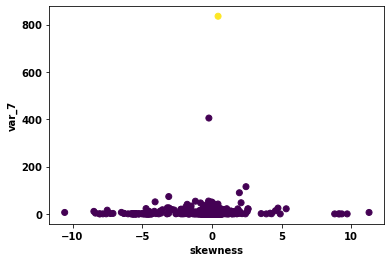

skewness var_8


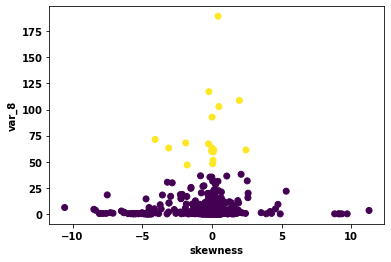

skewness variance


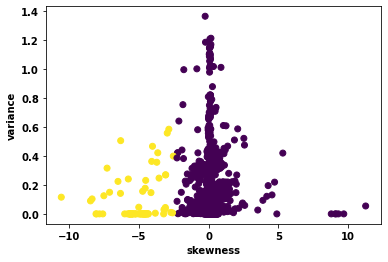

var_1 crest


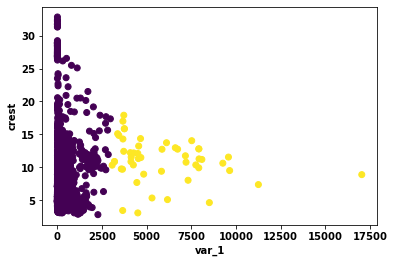

var_1 freqAmpliKurt


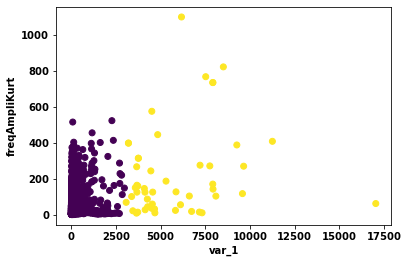

var_1 freqAmpliMax


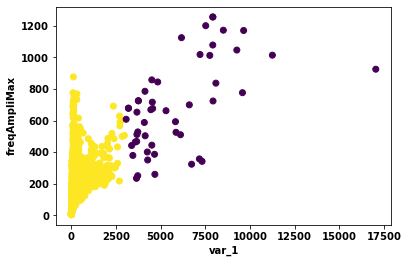

var_1 freqAmpliMean


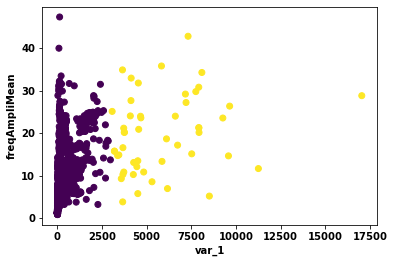

var_1 freqAmpliVar


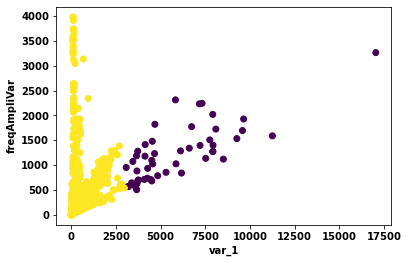

var_1 freqAmpliskw


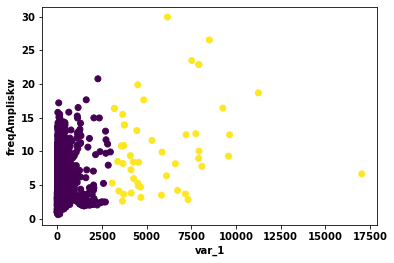

var_1 kurt


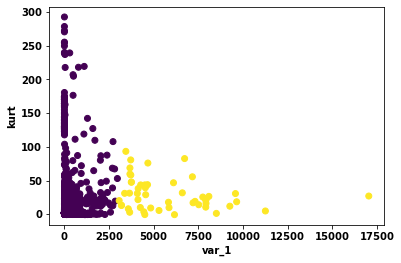

var_1 max_1


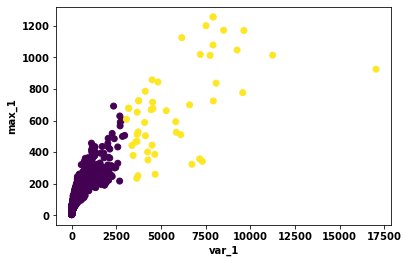

var_1 max_2


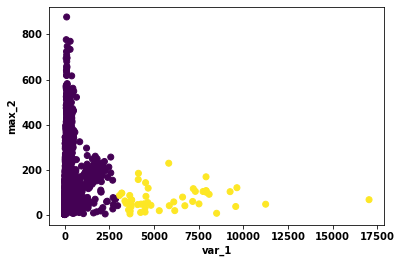

var_1 max_3


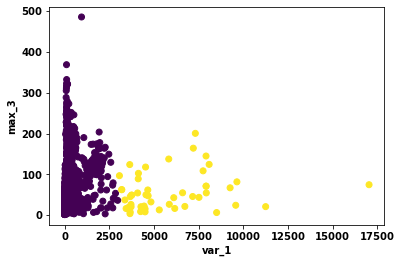

var_1 max_4


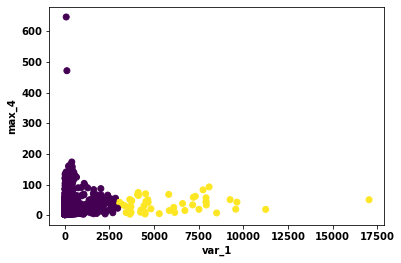

var_1 max_5


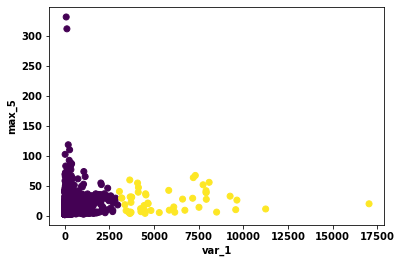

var_1 max_6


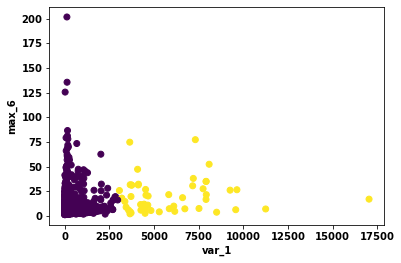

var_1 max_7


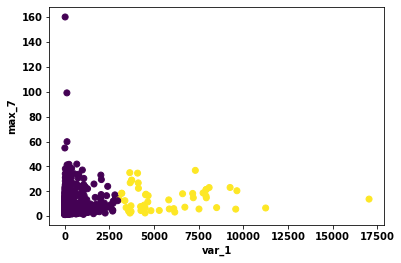

var_1 max_8


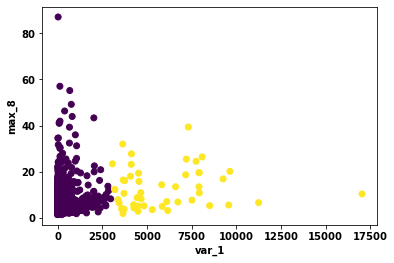

var_1 mean


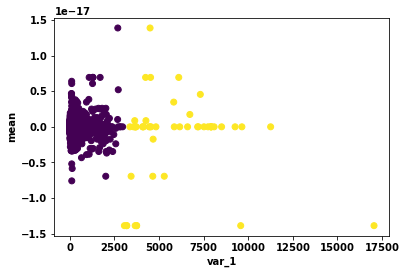

var_1 mean_1


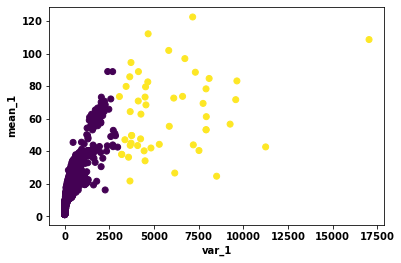

var_1 mean_2


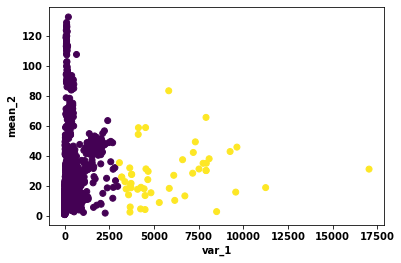

var_1 mean_3


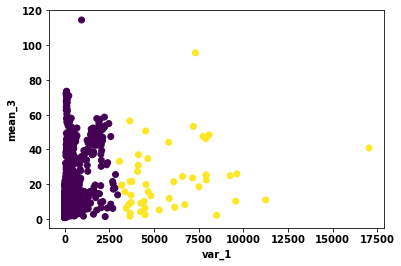

var_1 mean_4


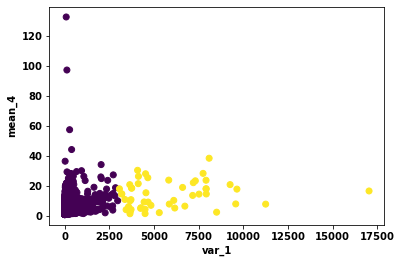

var_1 mean_5


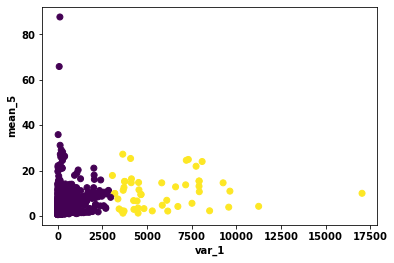

var_1 mean_6


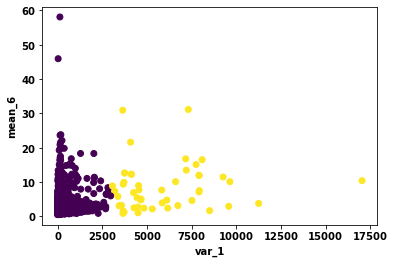

var_1 mean_7


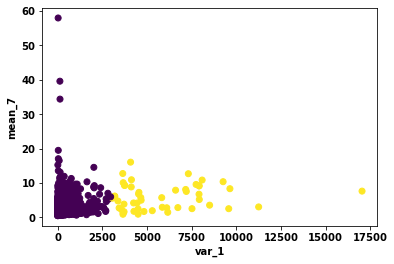

var_1 mean_8


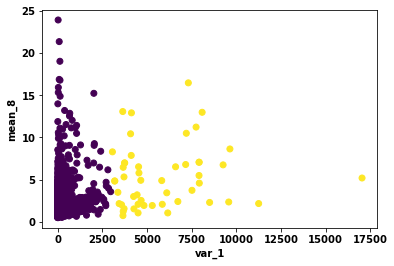

var_1 peak-peak


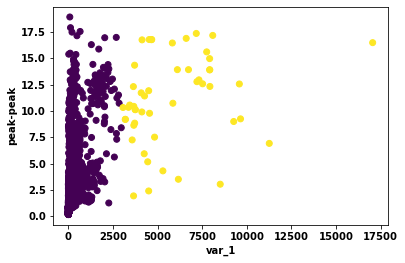

var_1 rms


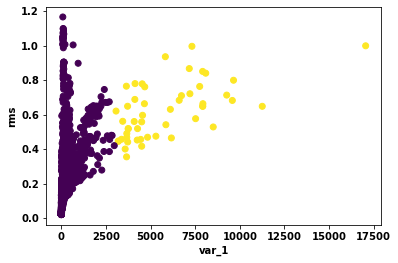

var_1 skewness


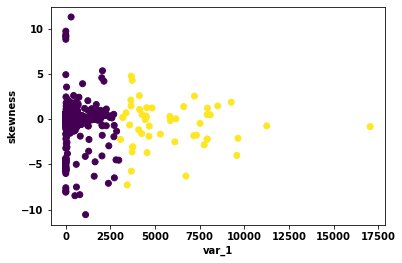

var_1 var_2


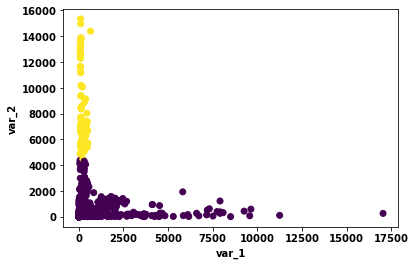

var_1 var_3


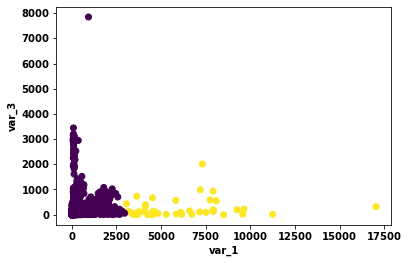

var_1 var_4


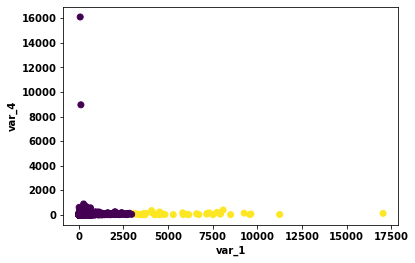

var_1 var_5


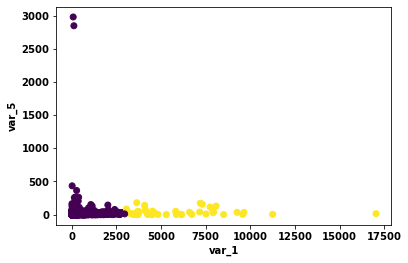

var_1 var_6


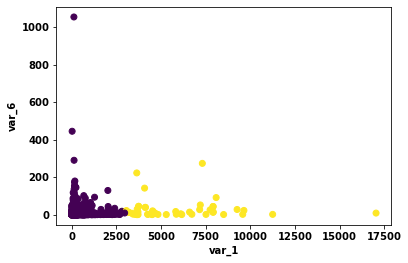

var_1 var_7


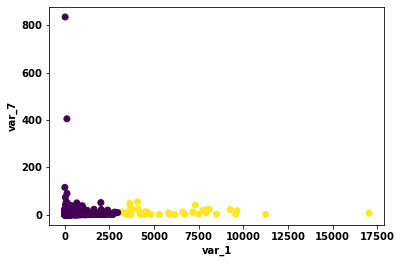

var_1 var_8


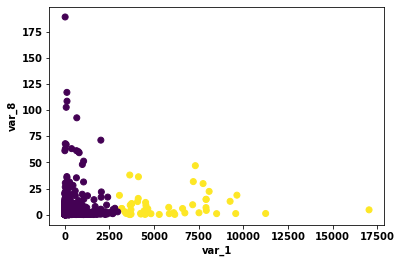

var_1 variance


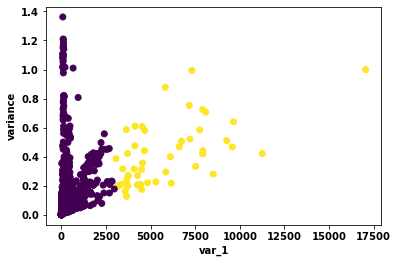

var_2 crest


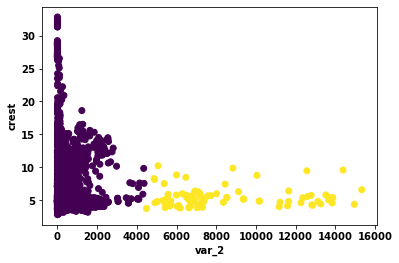

var_2 freqAmpliKurt


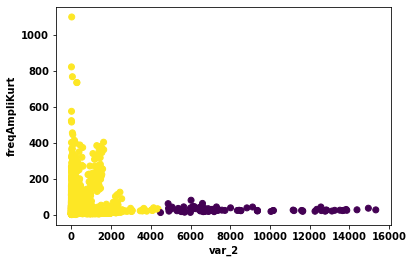

var_2 freqAmpliMax


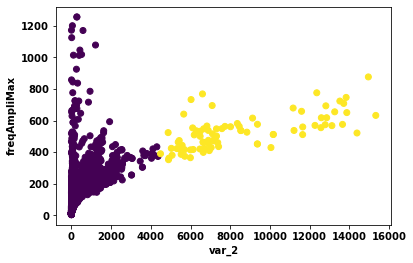

var_2 freqAmpliMean


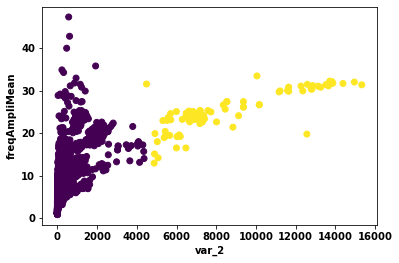

var_2 freqAmpliVar


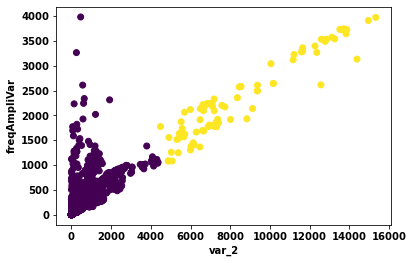

var_2 freqAmpliskw


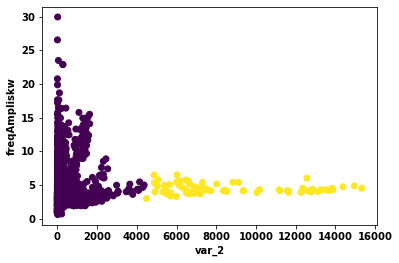

var_2 kurt


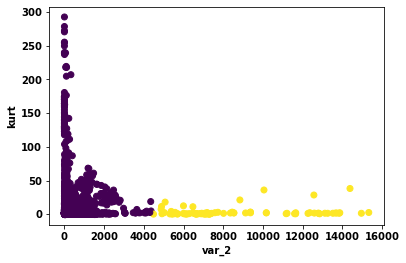

var_2 max_1


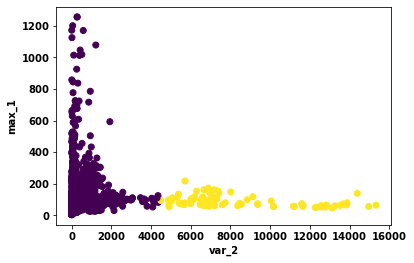

var_2 max_2


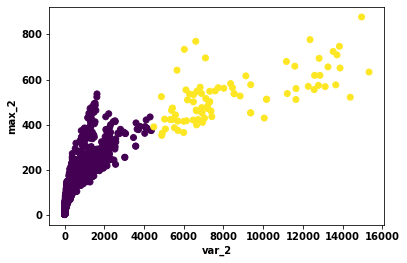

var_2 max_3


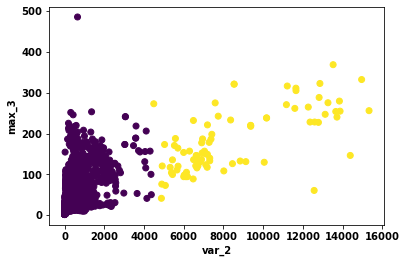

var_2 max_4


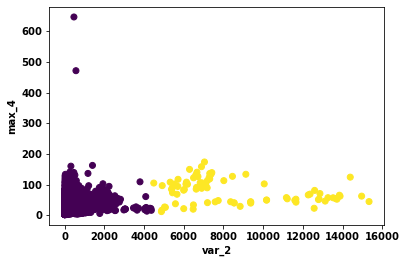

var_2 max_5


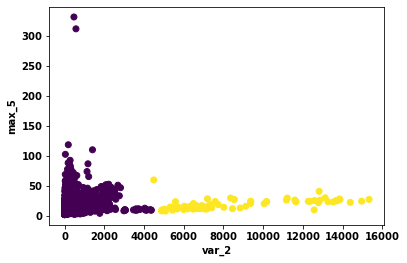

var_2 max_6


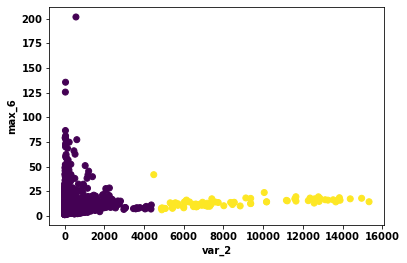

var_2 max_7


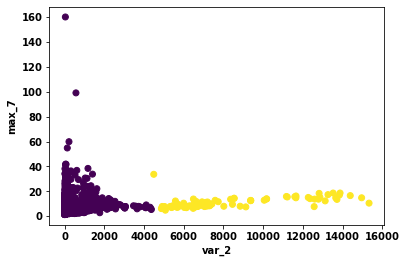

var_2 max_8


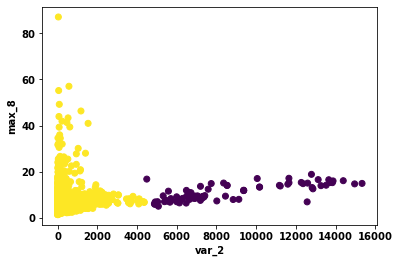

var_2 mean


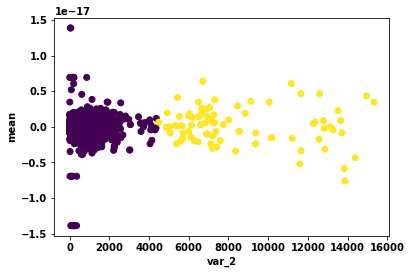

var_2 mean_1


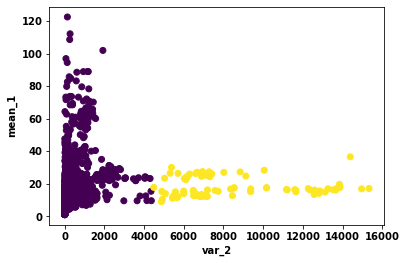

var_2 mean_2


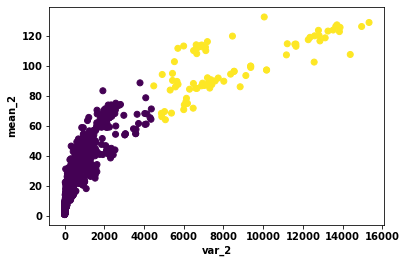

var_2 mean_3


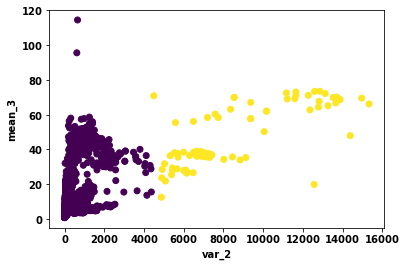

var_2 mean_4


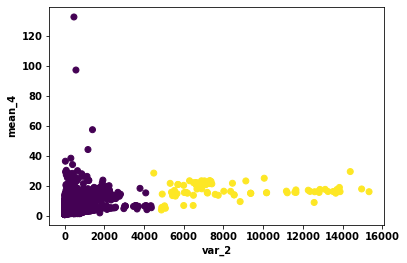

var_2 mean_5


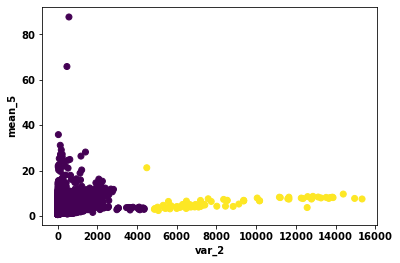

var_2 mean_6


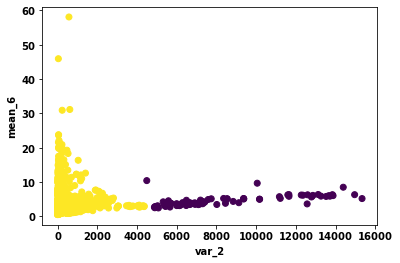

var_2 mean_7


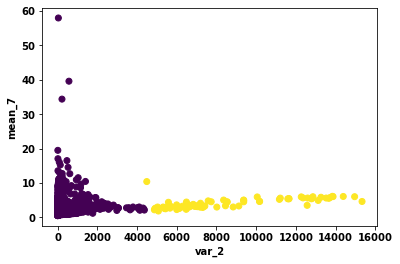

var_2 mean_8


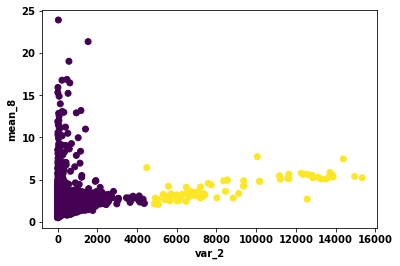

var_2 peak-peak


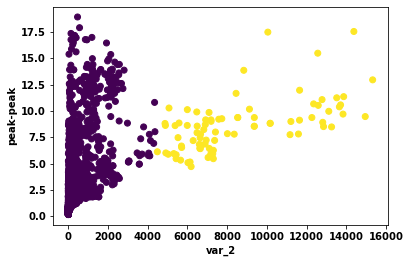

var_2 rms


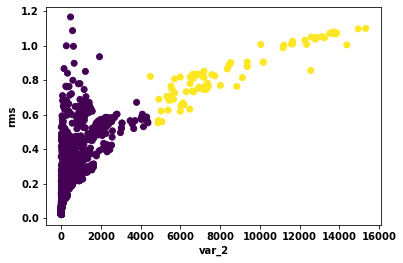

var_2 skewness


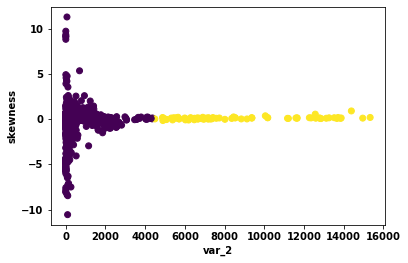

var_2 var_1


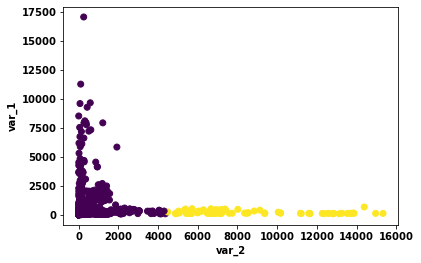

var_2 var_3


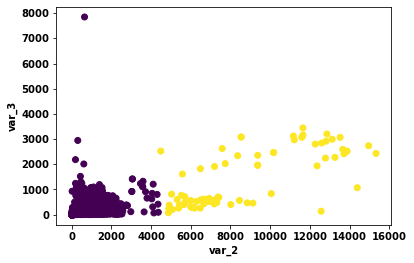

var_2 var_4


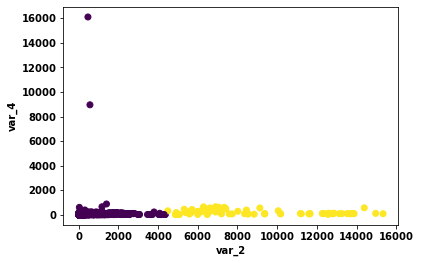

var_2 var_5


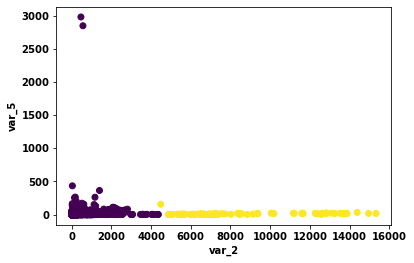

var_2 var_6


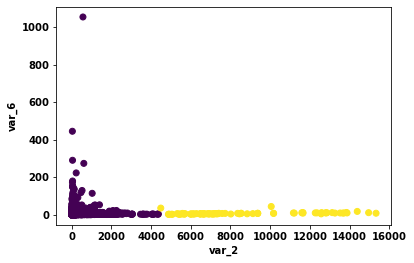

var_2 var_7


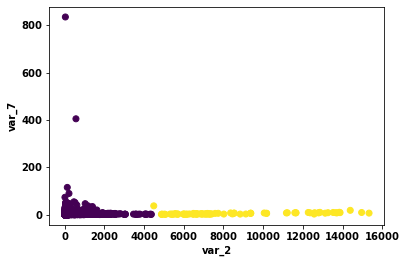

var_2 var_8


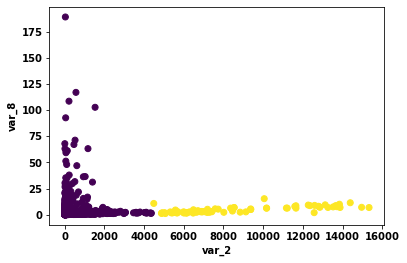

var_2 variance


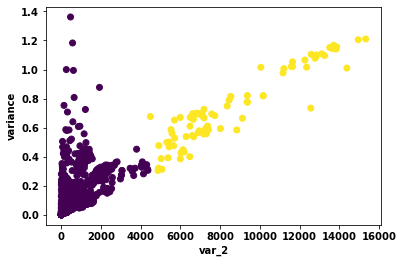

var_3 crest


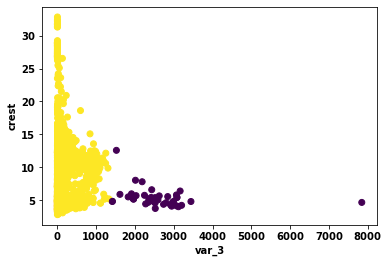

var_3 freqAmpliKurt


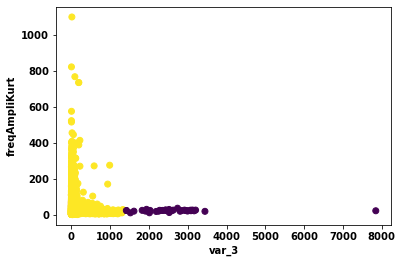

var_3 freqAmpliMax


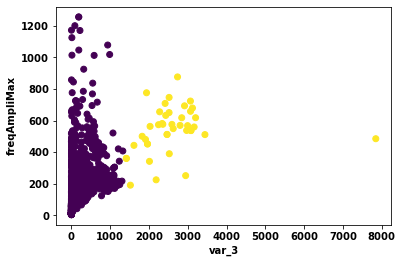

var_3 freqAmpliMean


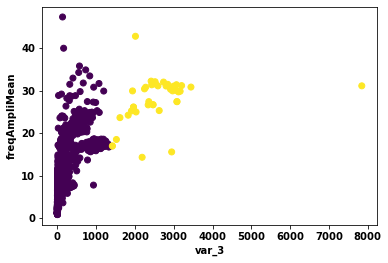

var_3 freqAmpliVar


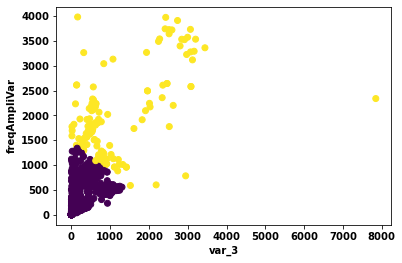

var_3 freqAmpliskw


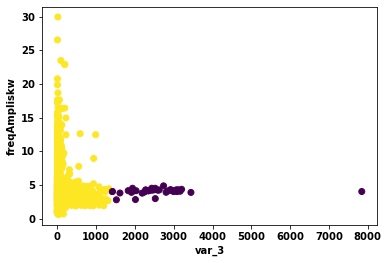

var_3 kurt


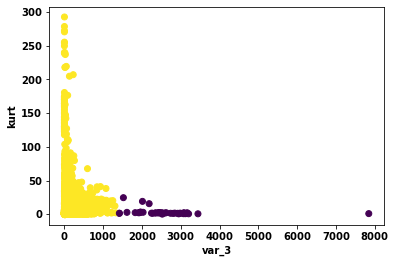

var_3 max_1


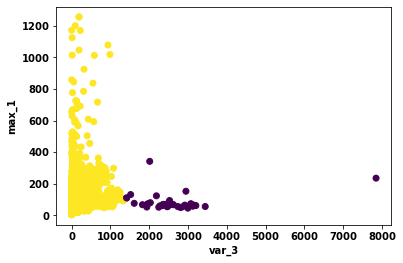

var_3 max_2


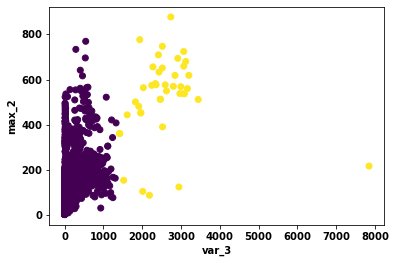

var_3 max_3


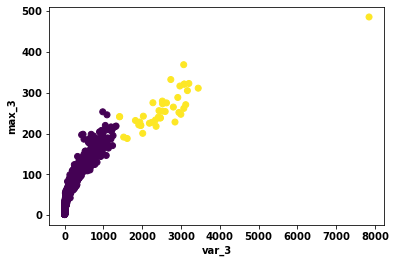

var_3 max_4


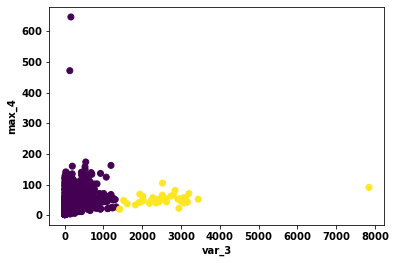

var_3 max_5


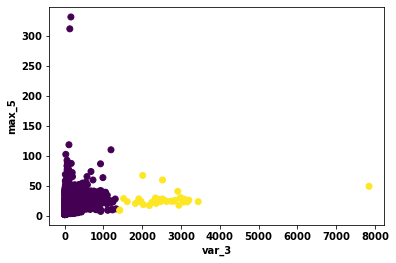

var_3 max_6


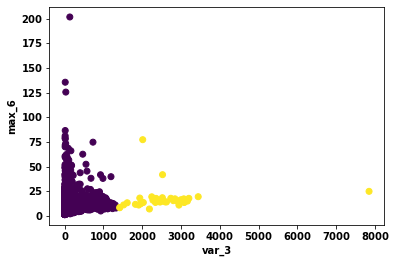

var_3 max_7


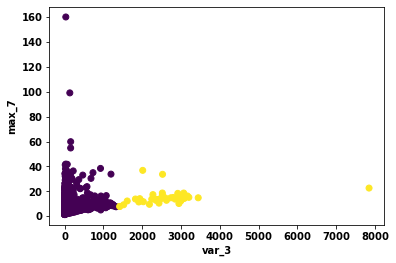

var_3 max_8


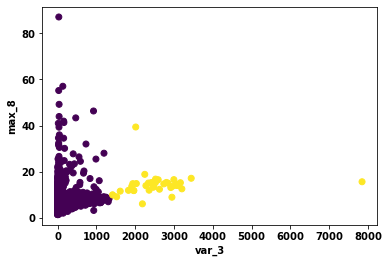

var_3 mean


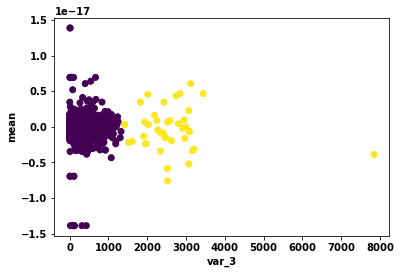

var_3 mean_1


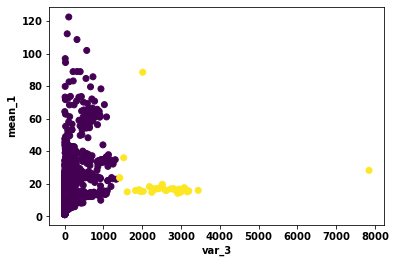

var_3 mean_2


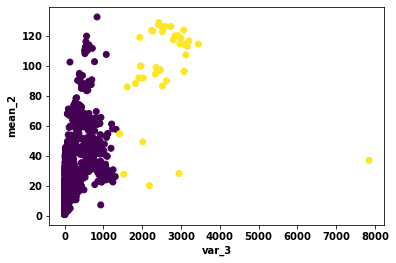

var_3 mean_3


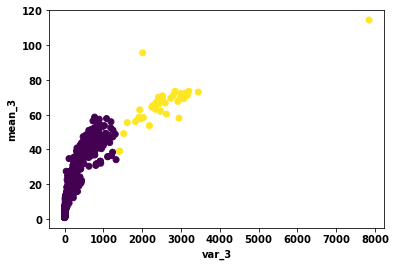

var_3 mean_4


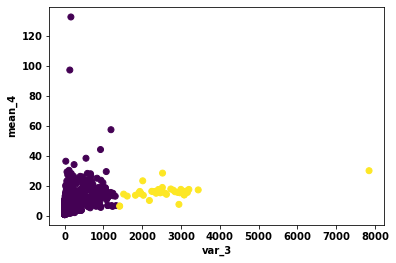

var_3 mean_5


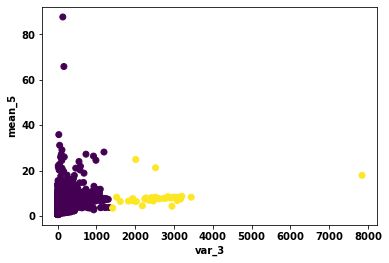

var_3 mean_6


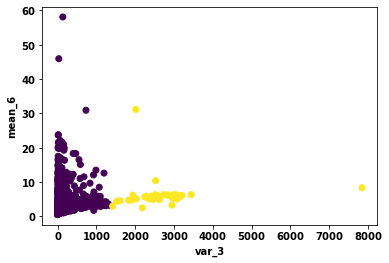

var_3 mean_7


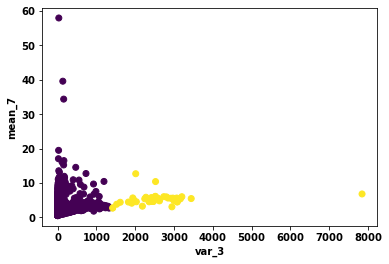

var_3 mean_8


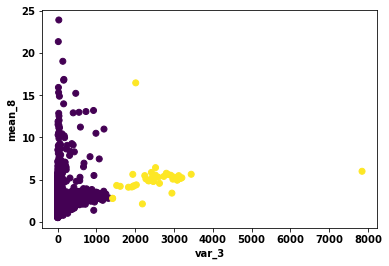

var_3 peak-peak


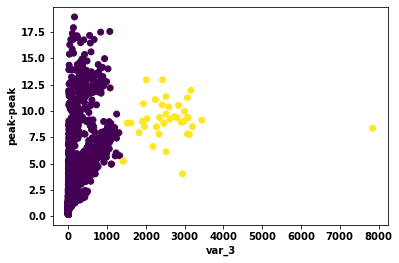

var_3 rms


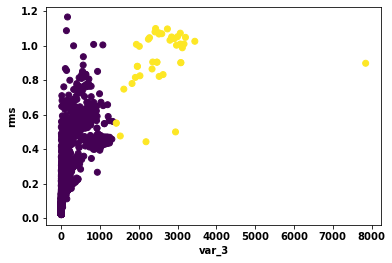

var_3 skewness


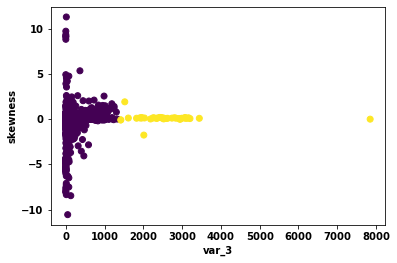

var_3 var_1


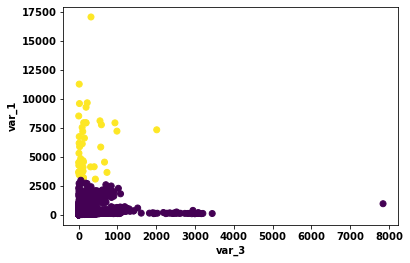

var_3 var_2


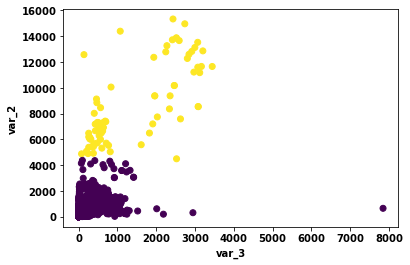

var_3 var_4


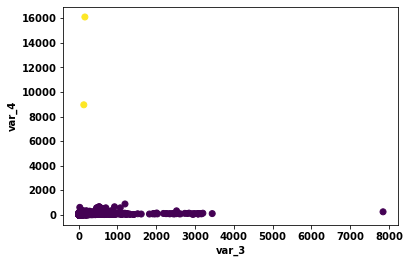

var_3 var_5


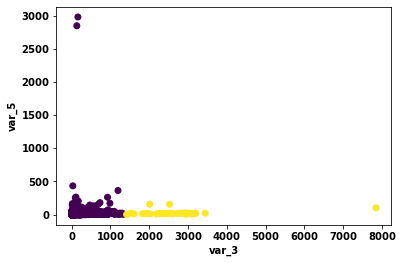

var_3 var_6


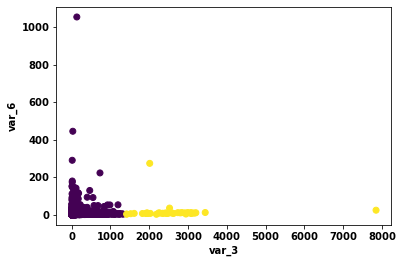

var_3 var_7


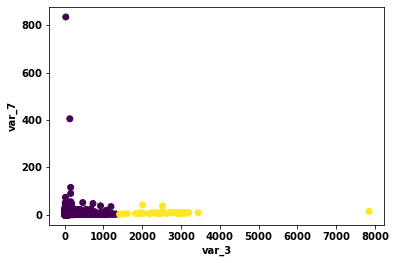

var_3 var_8


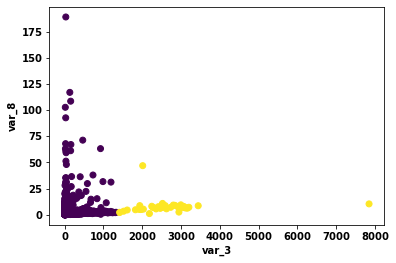

var_3 variance


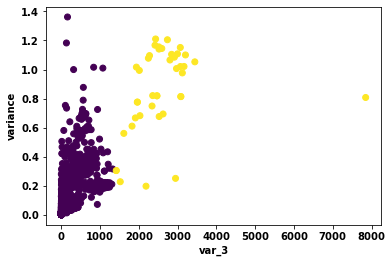

var_4 crest


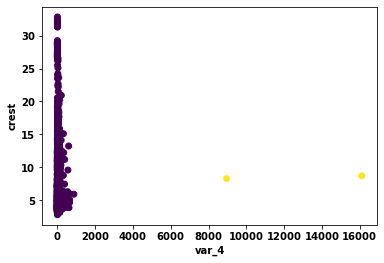

var_4 freqAmpliKurt


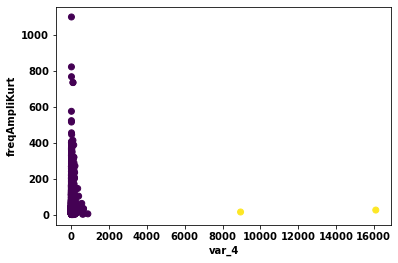

var_4 freqAmpliMax


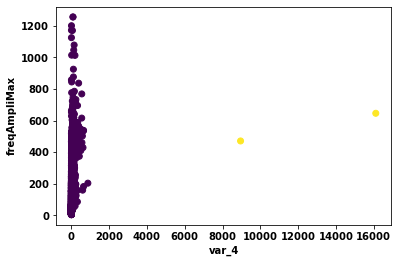

var_4 freqAmpliMean


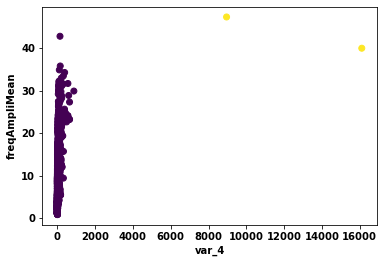

var_4 freqAmpliVar


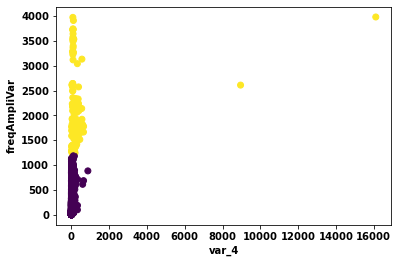

var_4 freqAmpliskw


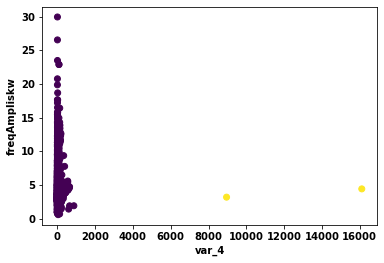

var_4 kurt


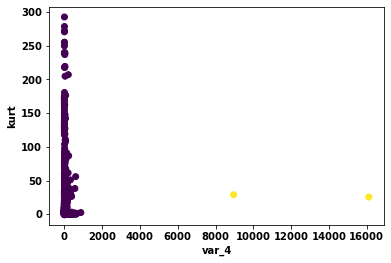

var_4 max_1


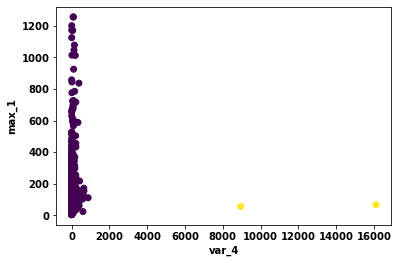

var_4 max_2


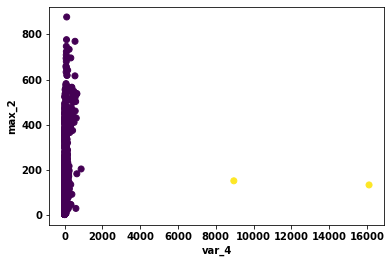

var_4 max_3


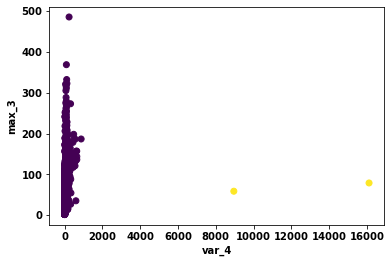

var_4 max_4


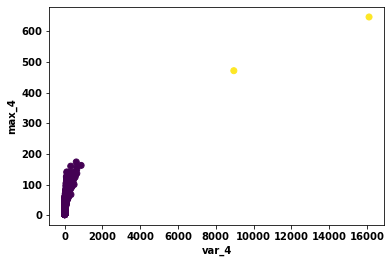

var_4 max_5


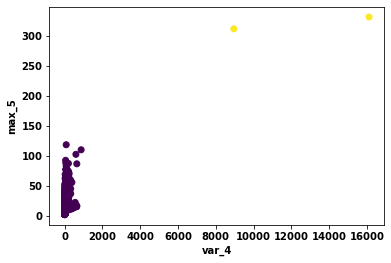

var_4 max_6


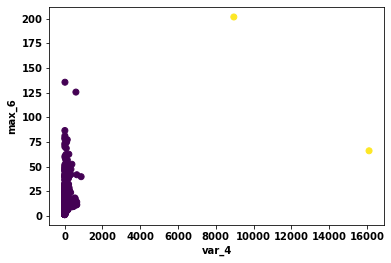

var_4 max_7


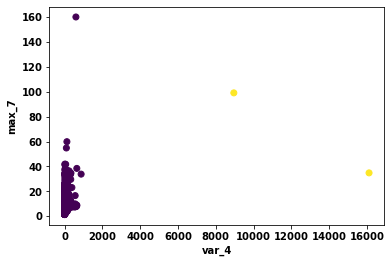

var_4 max_8


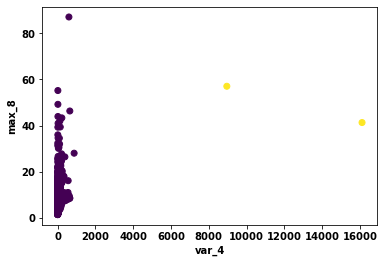

var_4 mean


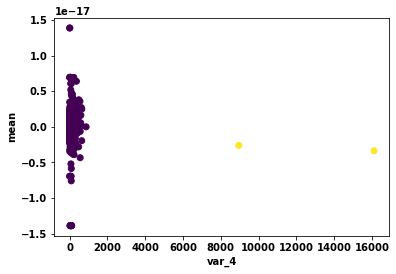

var_4 mean_1


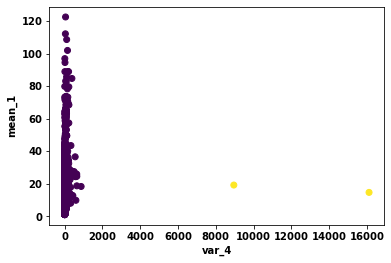

var_4 mean_2


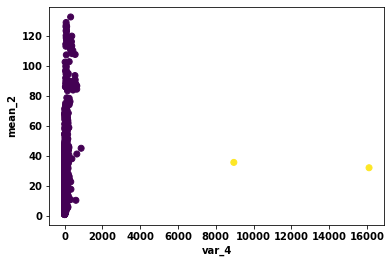

var_4 mean_3


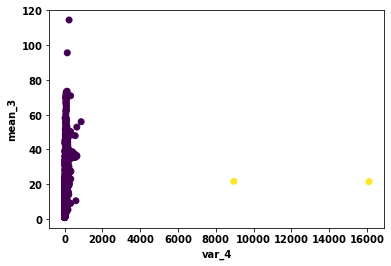

var_4 mean_4


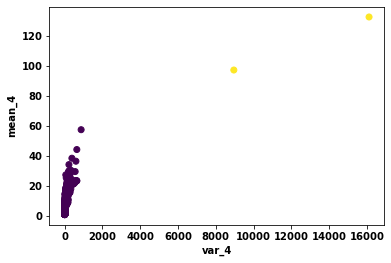

var_4 mean_5


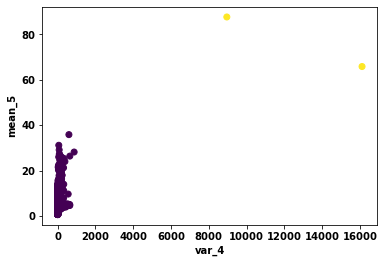

var_4 mean_6


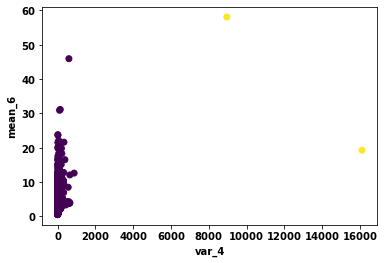

var_4 mean_7


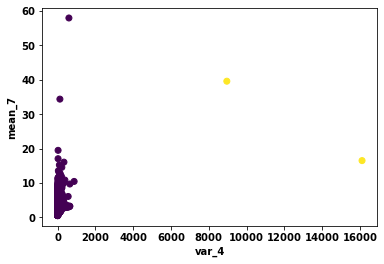

var_4 mean_8


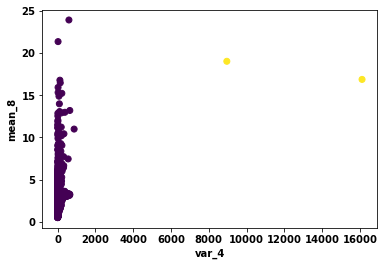

var_4 peak-peak


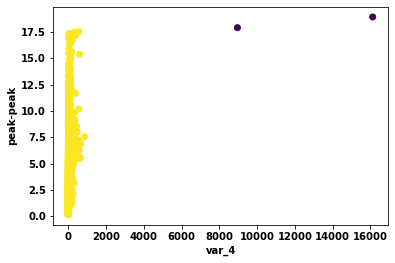

var_4 rms


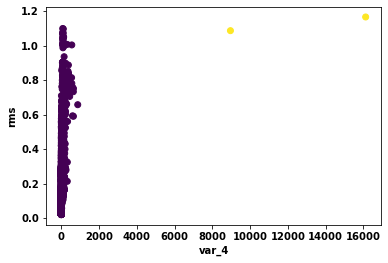

var_4 skewness


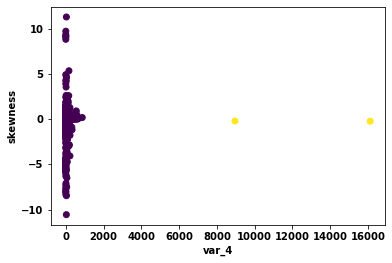

var_4 var_1


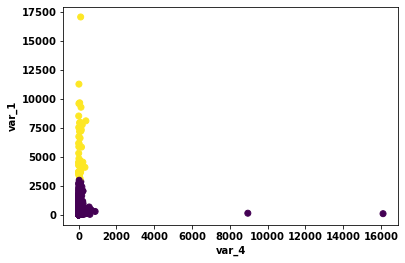

var_4 var_2


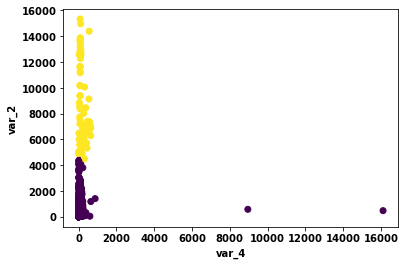

var_4 var_3


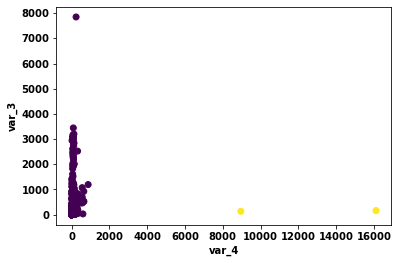

var_4 var_5


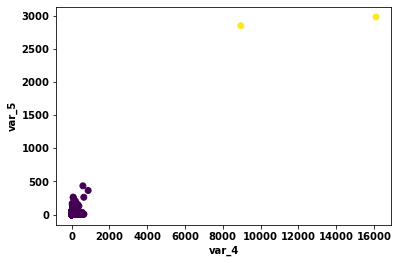

var_4 var_6


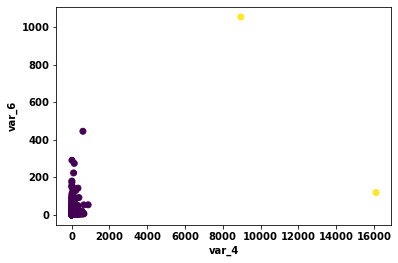

var_4 var_7


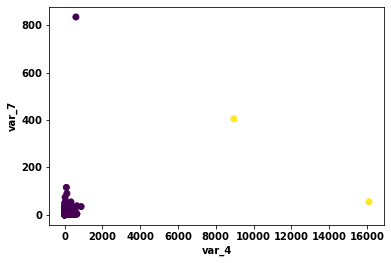

var_4 var_8


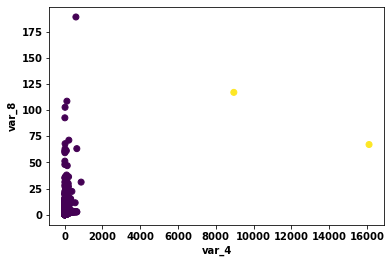

var_4 variance


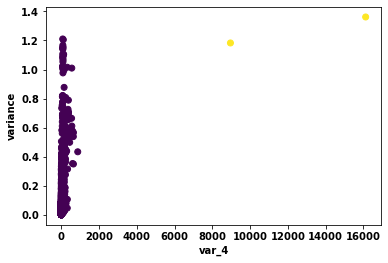

var_5 crest


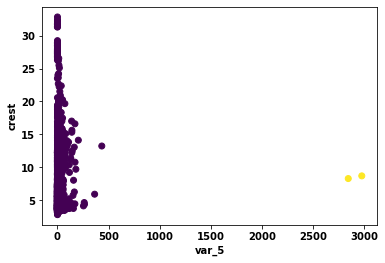

var_5 freqAmpliKurt


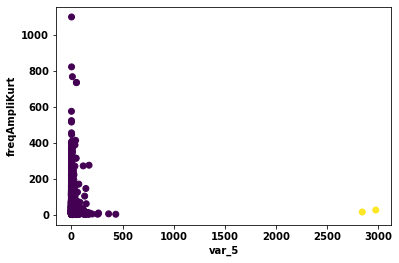

var_5 freqAmpliMax


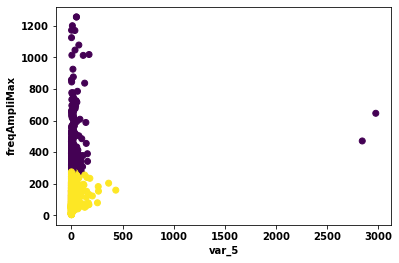

var_5 freqAmpliMean


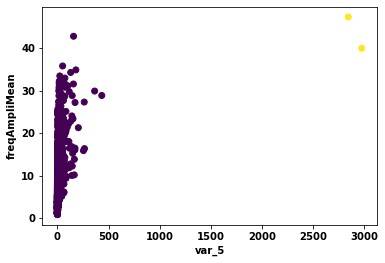

var_5 freqAmpliVar


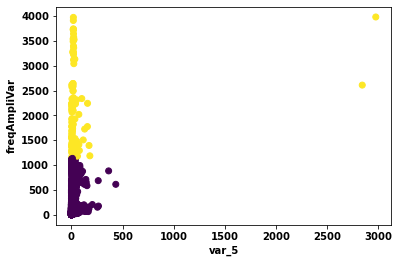

var_5 freqAmpliskw


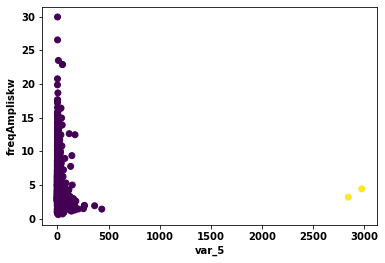

var_5 kurt


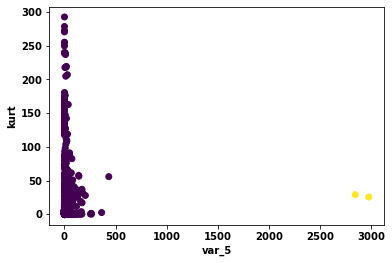

var_5 max_1


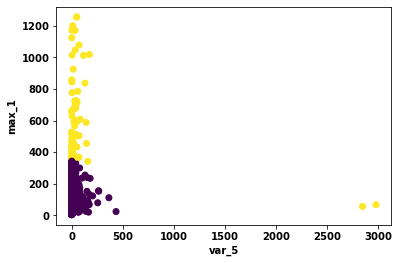

var_5 max_2


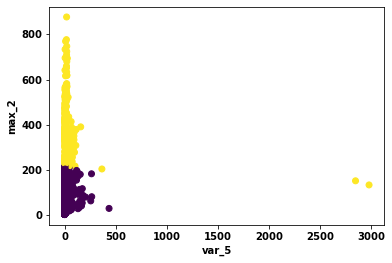

var_5 max_3


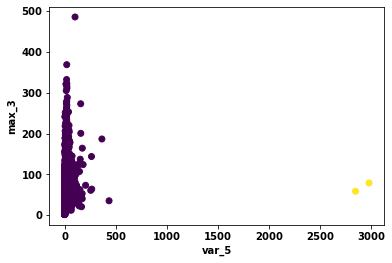

var_5 max_4


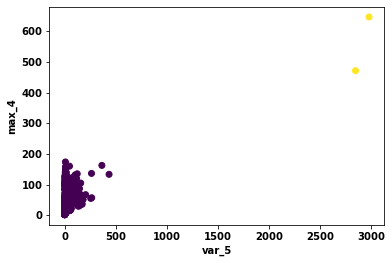

var_5 max_5


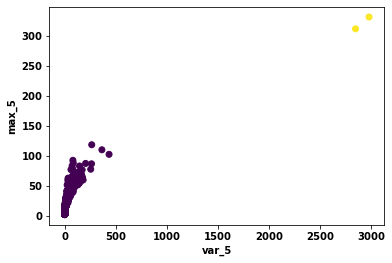

var_5 max_6


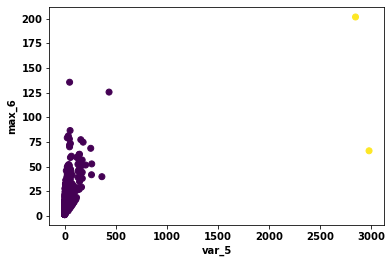

var_5 max_7


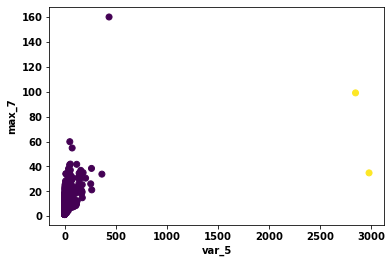

var_5 max_8


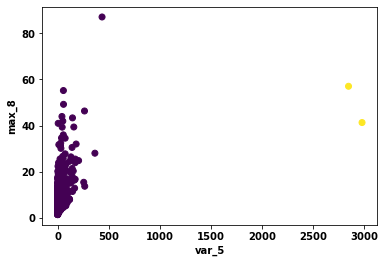

var_5 mean


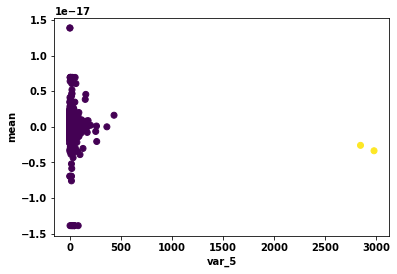

var_5 mean_1


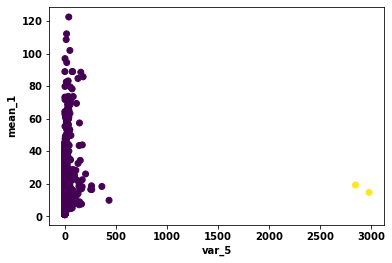

var_5 mean_2


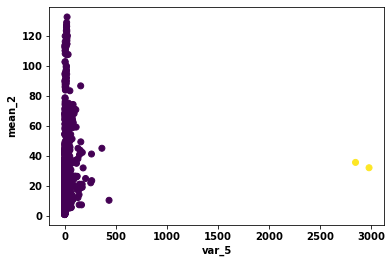

var_5 mean_3


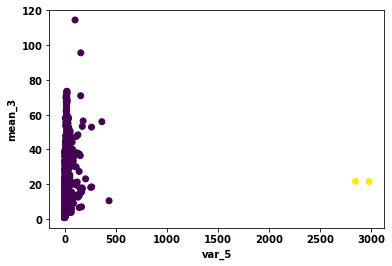

var_5 mean_4


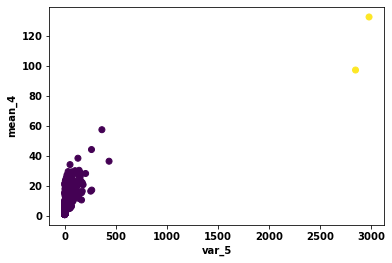

var_5 mean_5


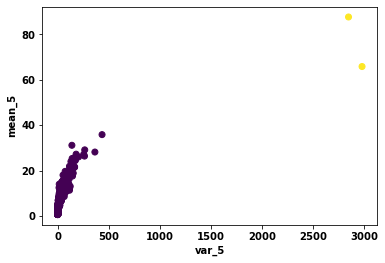

var_5 mean_6


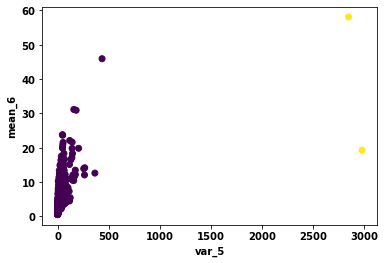

var_5 mean_7


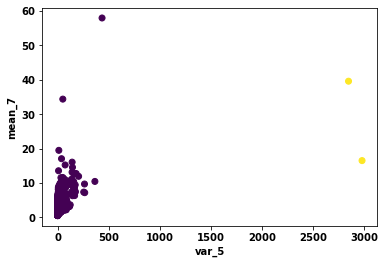

var_5 mean_8


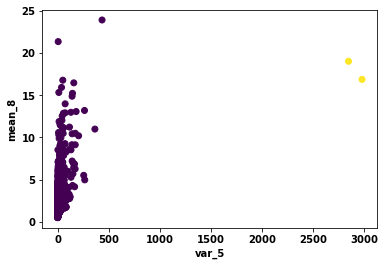

var_5 peak-peak


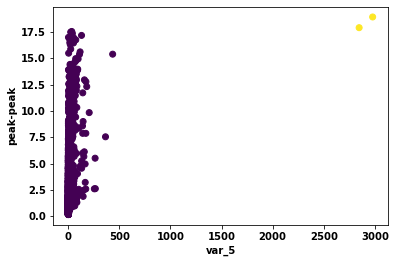

var_5 rms


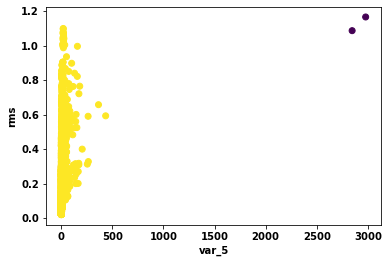

var_5 skewness


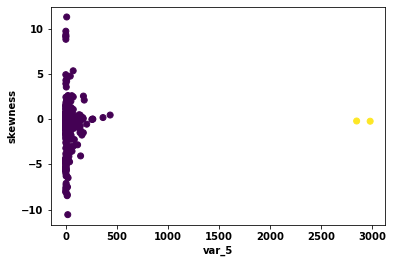

var_5 var_1


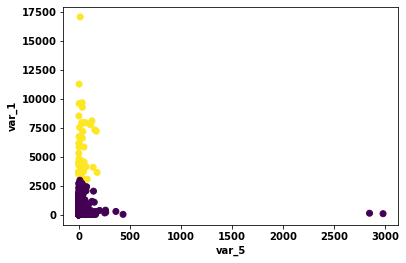

var_5 var_2


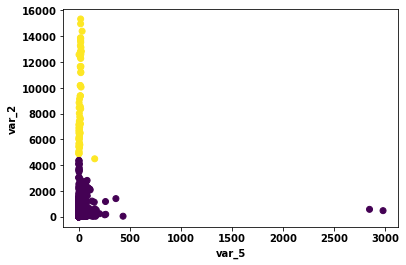

var_5 var_3


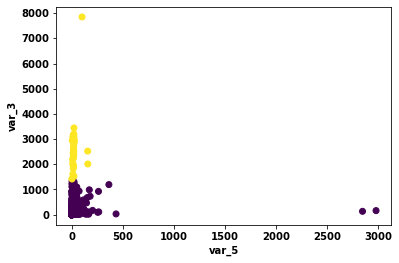

var_5 var_4


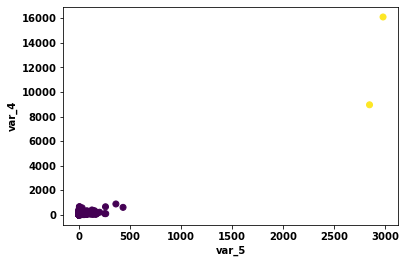

var_5 var_6


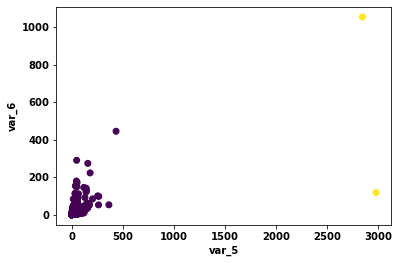

var_5 var_7


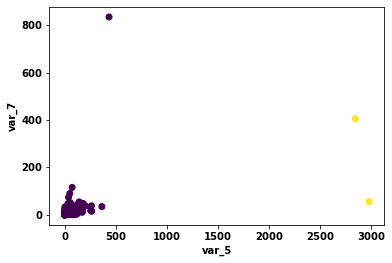

var_5 var_8


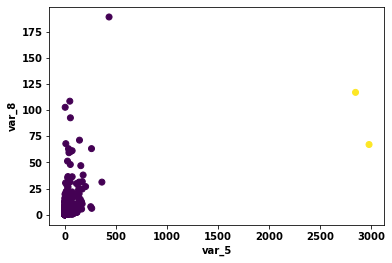

var_5 variance


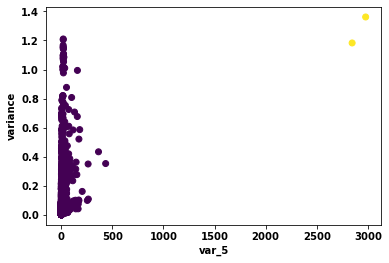

var_6 crest


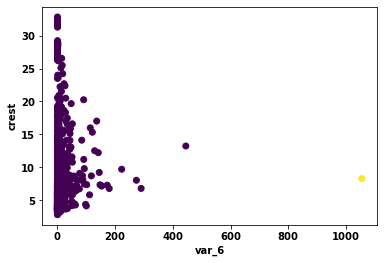

var_6 freqAmpliKurt


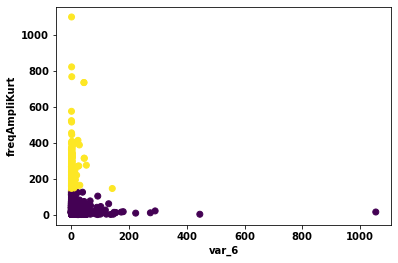

var_6 freqAmpliMax


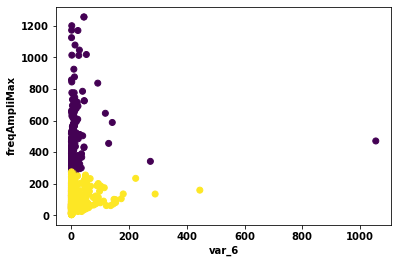

var_6 freqAmpliMean


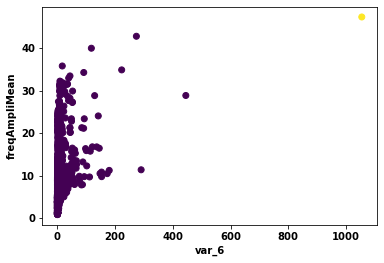

var_6 freqAmpliVar


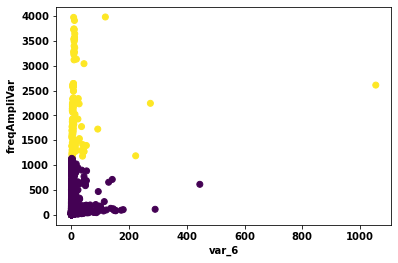

var_6 freqAmpliskw


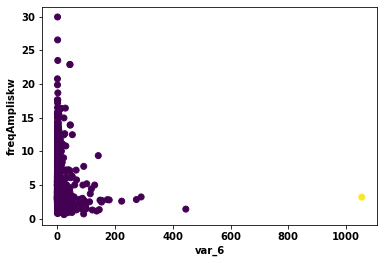

var_6 kurt


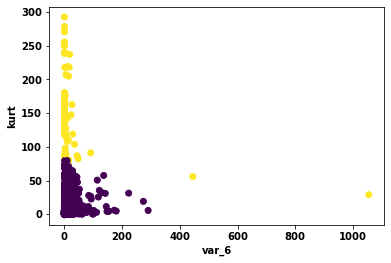

var_6 max_1


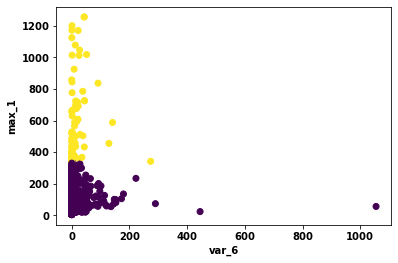

var_6 max_2


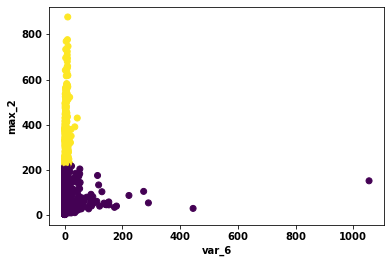

var_6 max_3


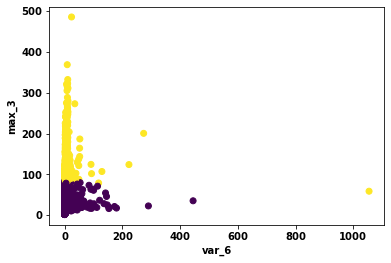

var_6 max_4


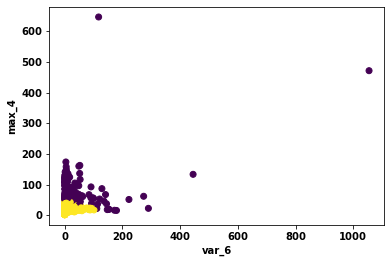

var_6 max_5


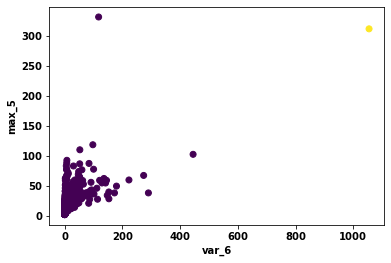

var_6 max_6


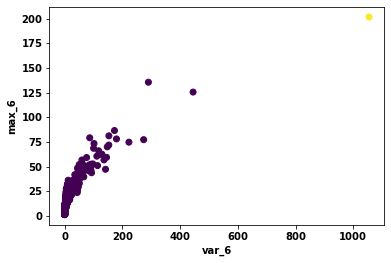

var_6 max_7


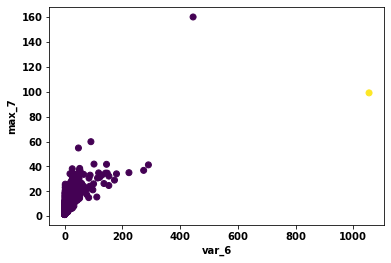

var_6 max_8


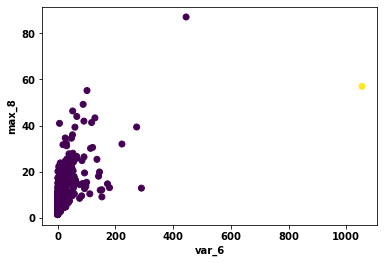

var_6 mean


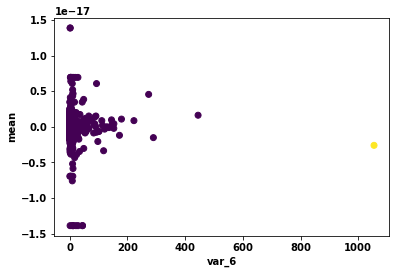

var_6 mean_1


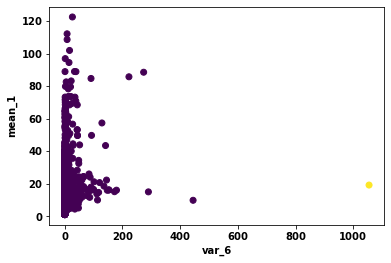

var_6 mean_2


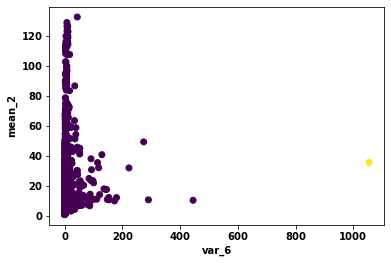

var_6 mean_3


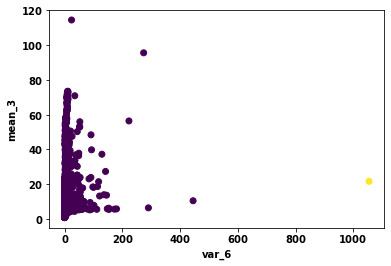

var_6 mean_4


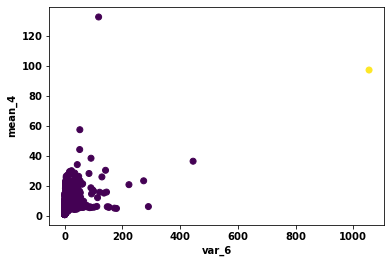

var_6 mean_5


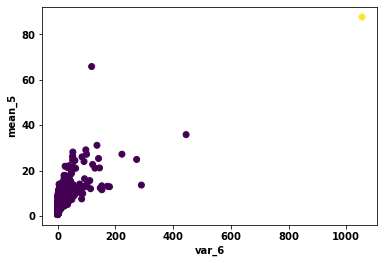

var_6 mean_6


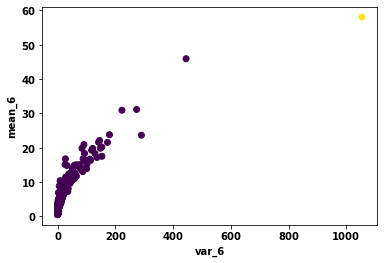

var_6 mean_7


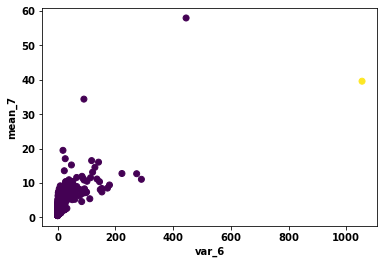

var_6 mean_8


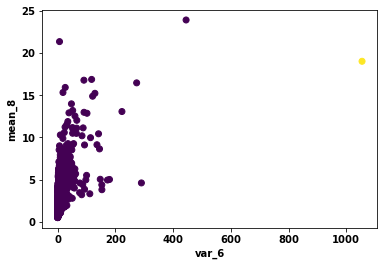

var_6 peak-peak


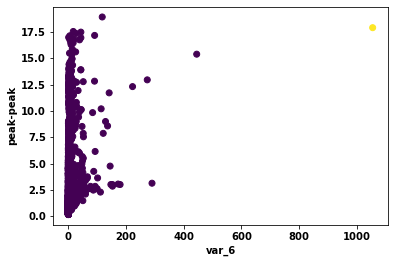

var_6 rms


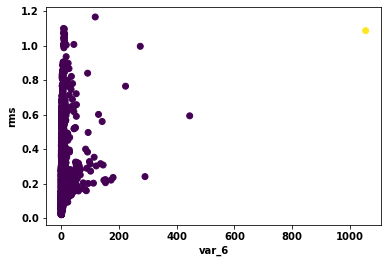

var_6 skewness


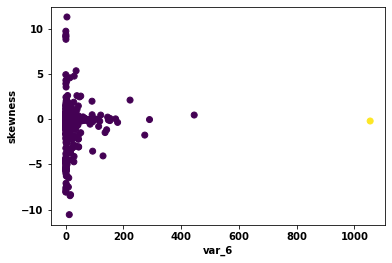

var_6 var_1


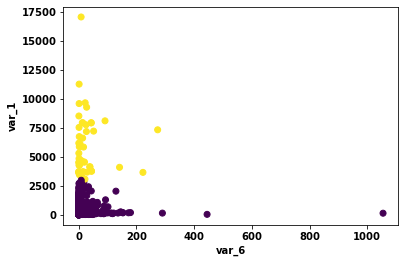

var_6 var_2


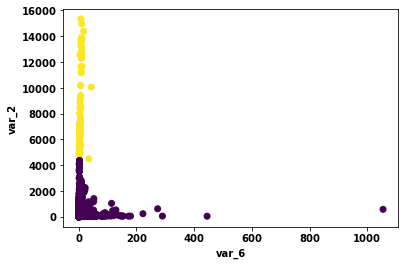

var_6 var_3


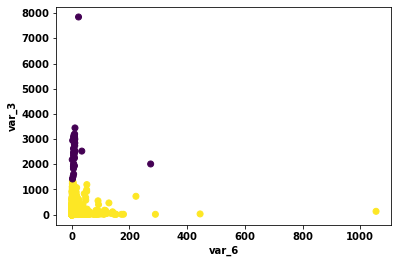

var_6 var_4


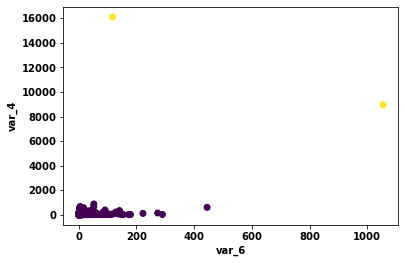

var_6 var_5


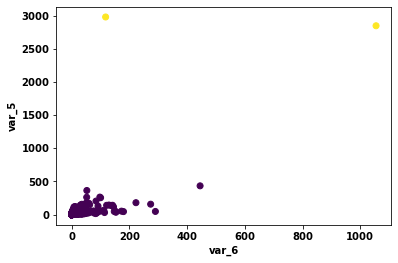

var_6 var_7


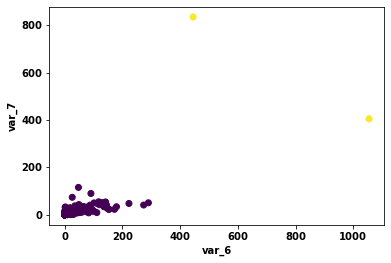

var_6 var_8


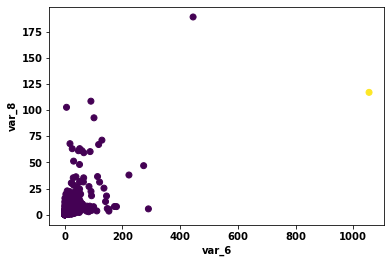

var_6 variance


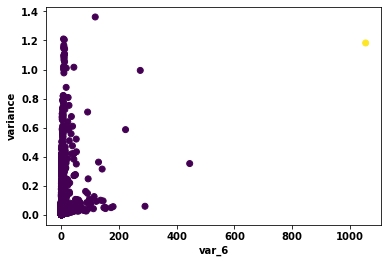

var_7 crest


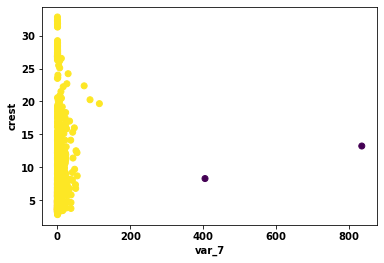

var_7 freqAmpliKurt


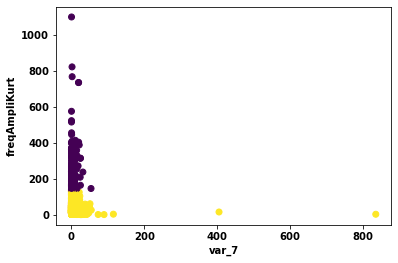

var_7 freqAmpliMax


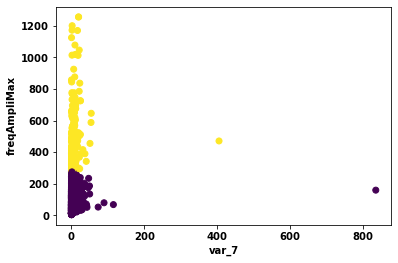

var_7 freqAmpliMean


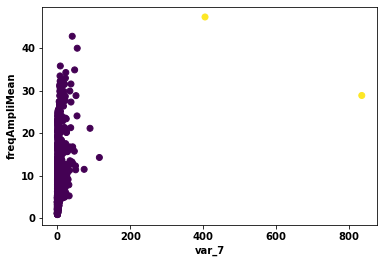

var_7 freqAmpliVar


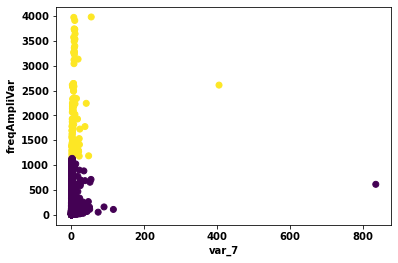

var_7 freqAmpliskw


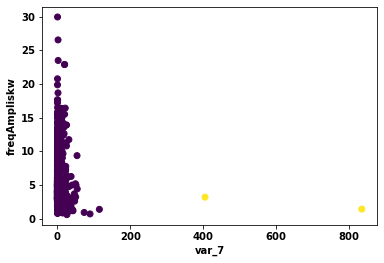

var_7 kurt


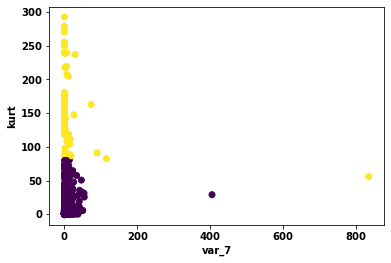

var_7 max_1


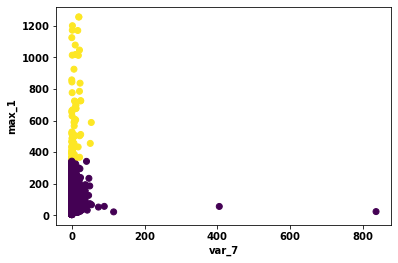

var_7 max_2


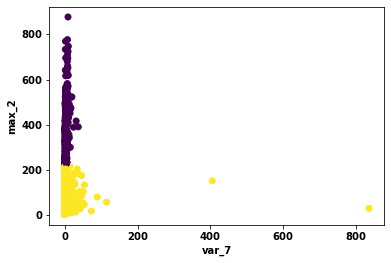

var_7 max_3


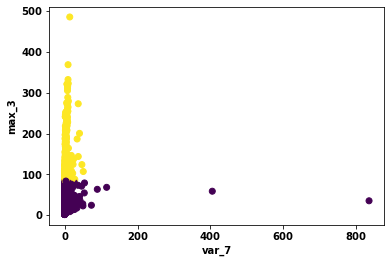

var_7 max_4


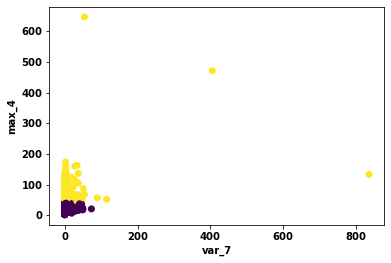

var_7 max_5


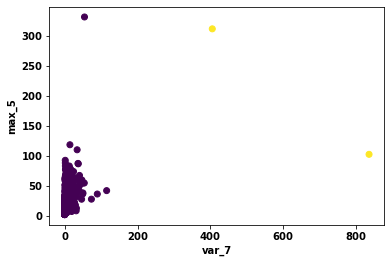

var_7 max_6


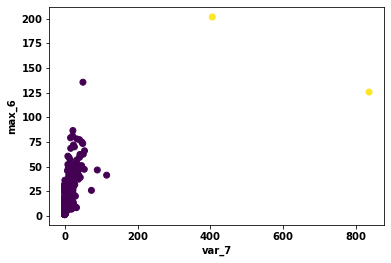

var_7 max_7


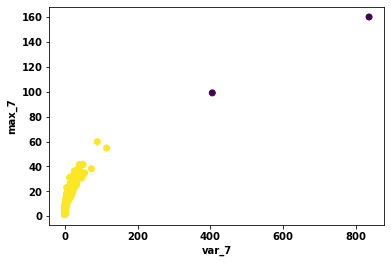

var_7 max_8


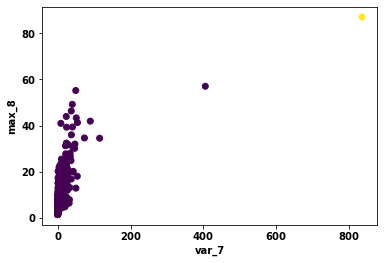

var_7 mean


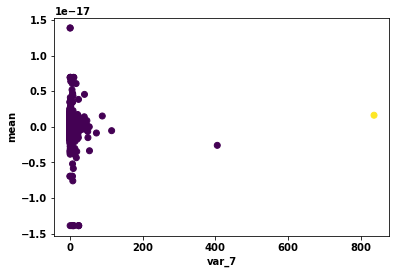

var_7 mean_1


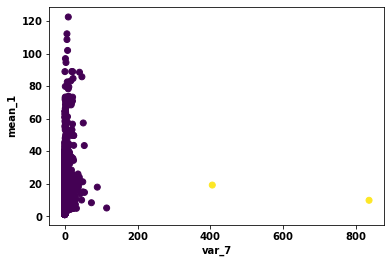

var_7 mean_2


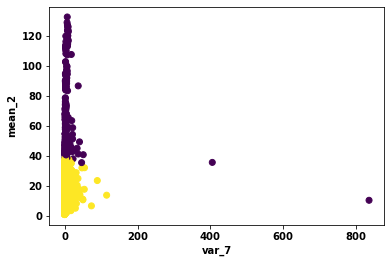

var_7 mean_3


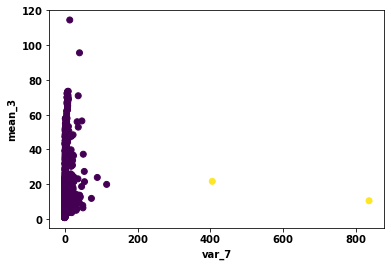

var_7 mean_4


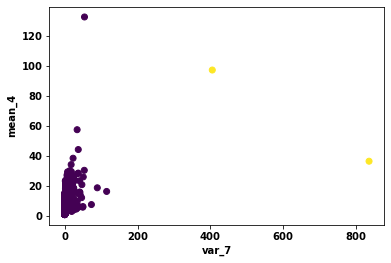

var_7 mean_5


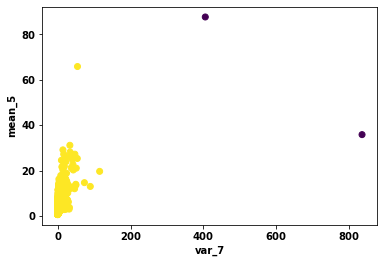

var_7 mean_6


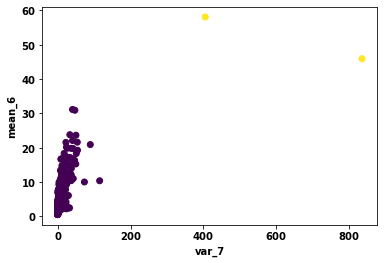

var_7 mean_7


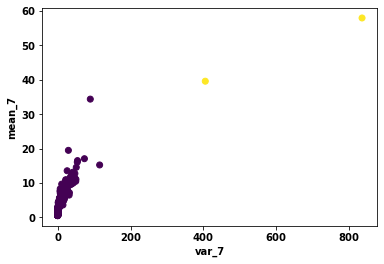

var_7 mean_8


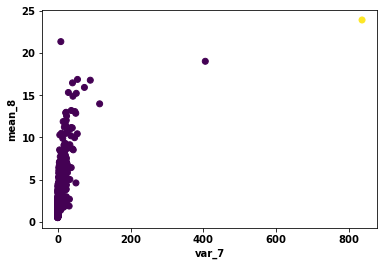

var_7 peak-peak


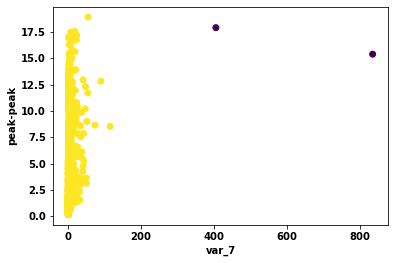

var_7 rms


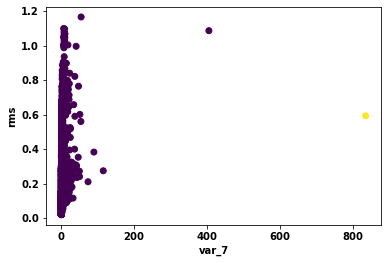

var_7 skewness


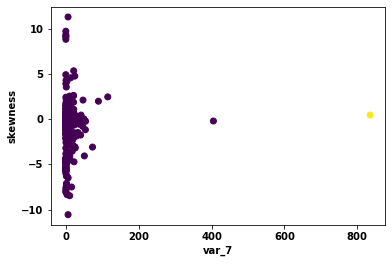

var_7 var_1


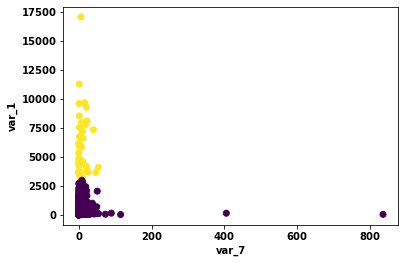

var_7 var_2


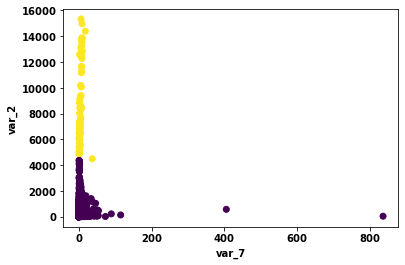

var_7 var_3


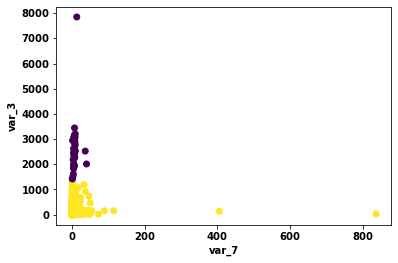

var_7 var_4


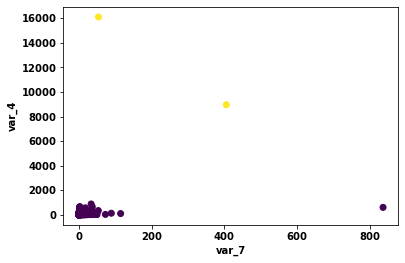

var_7 var_5


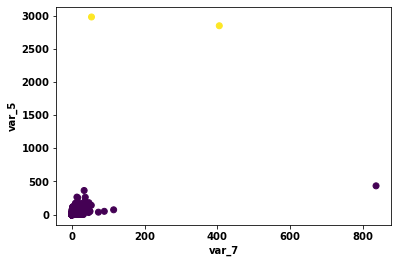

var_7 var_6


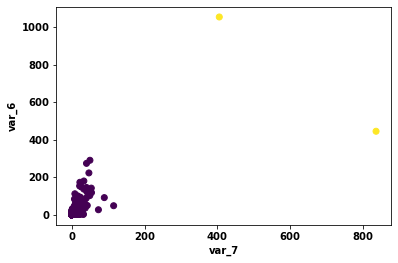

var_7 var_8


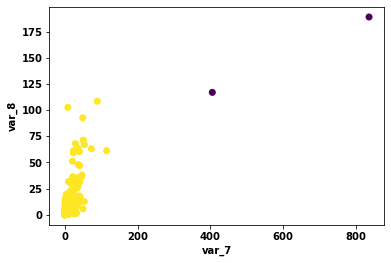

var_7 variance


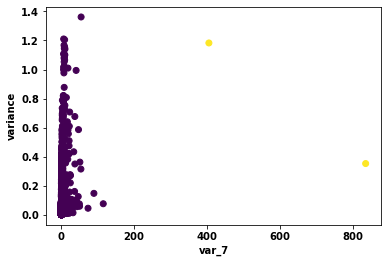

var_8 crest


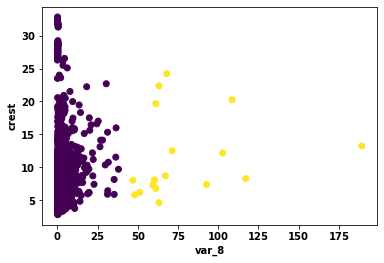

var_8 freqAmpliKurt


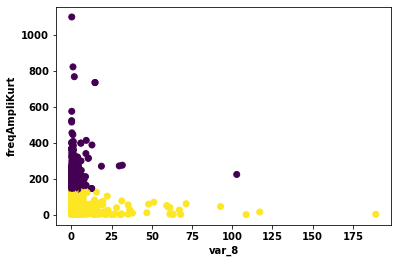

var_8 freqAmpliMax


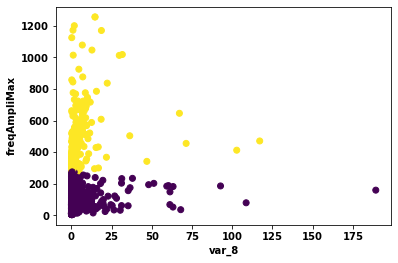

var_8 freqAmpliMean


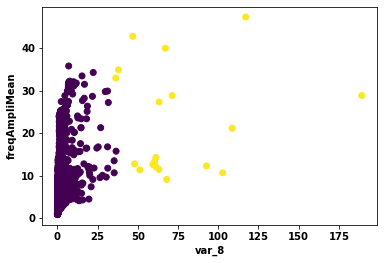

var_8 freqAmpliVar


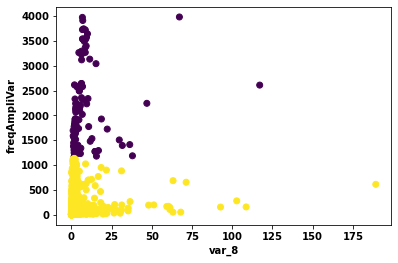

var_8 freqAmpliskw


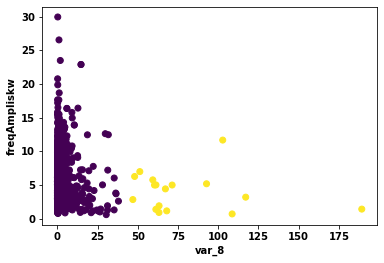

var_8 kurt


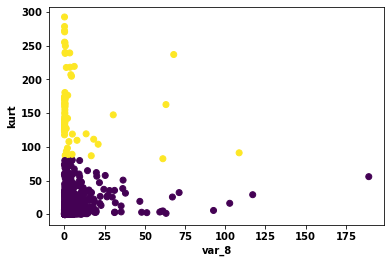

var_8 max_1


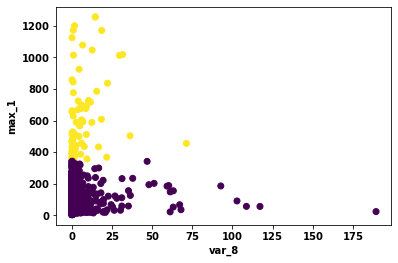

var_8 max_2


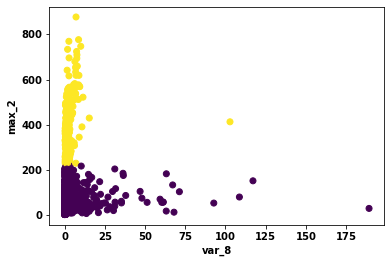

var_8 max_3


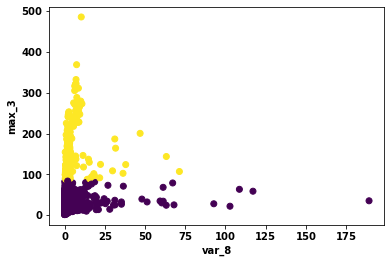

var_8 max_4


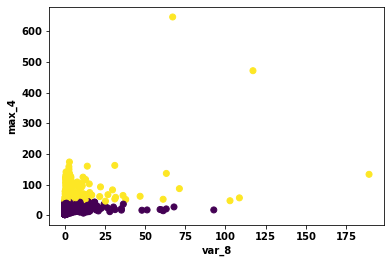

var_8 max_5


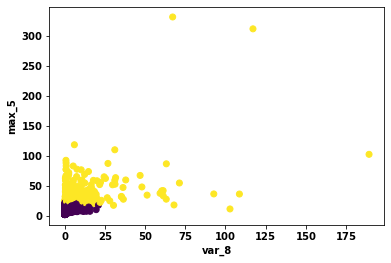

var_8 max_6


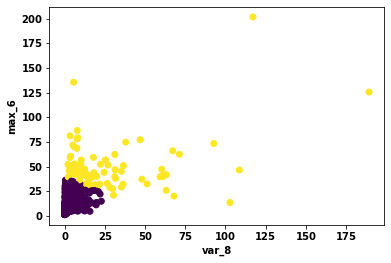

var_8 max_7


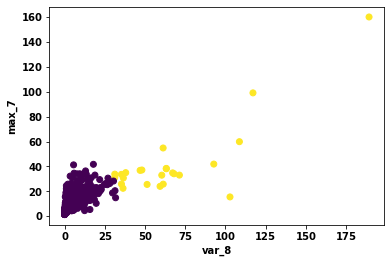

var_8 max_8


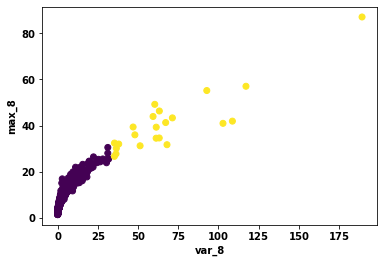

var_8 mean


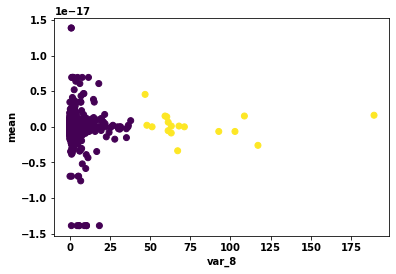

var_8 mean_1


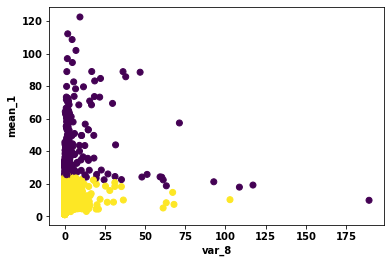

var_8 mean_2


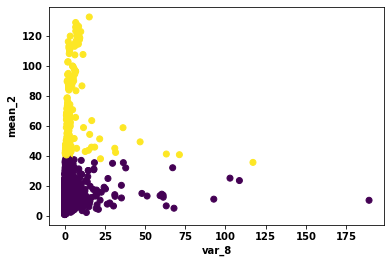

var_8 mean_3


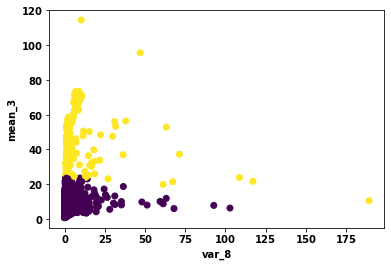

var_8 mean_4


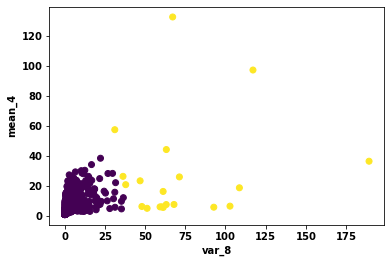

var_8 mean_5


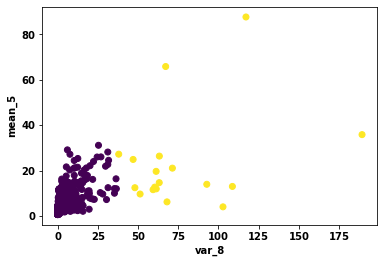

var_8 mean_6


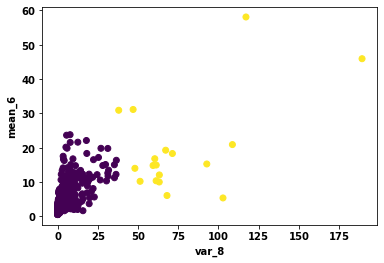

var_8 mean_7


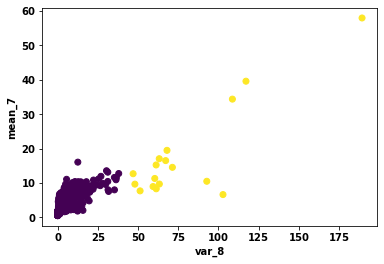

var_8 mean_8


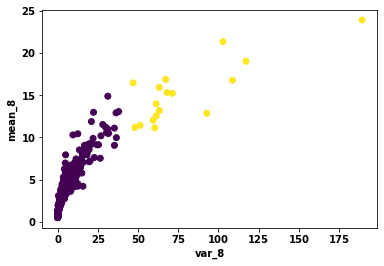

var_8 peak-peak


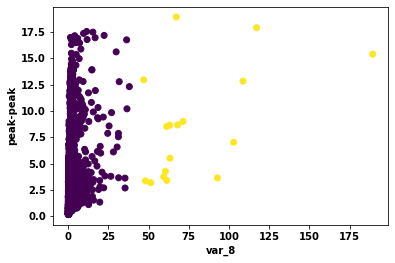

var_8 rms


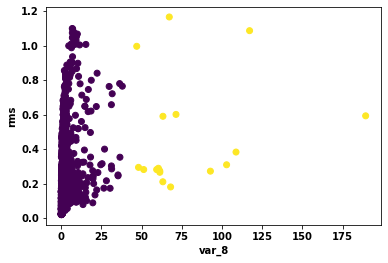

var_8 skewness


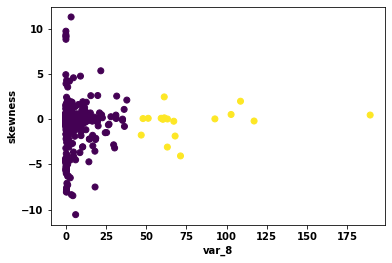

var_8 var_1


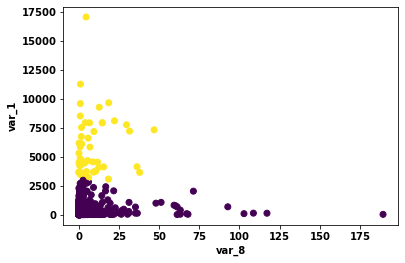

var_8 var_2


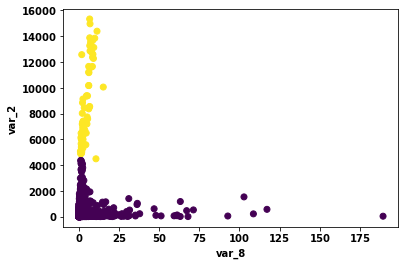

var_8 var_3


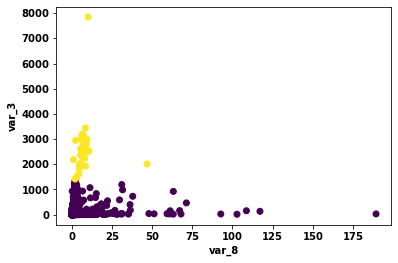

var_8 var_4


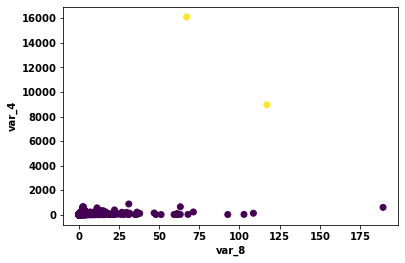

var_8 var_5


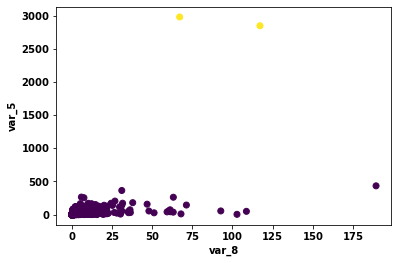

var_8 var_6


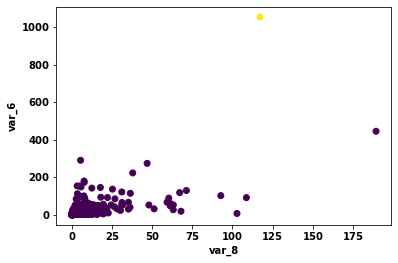

var_8 var_7


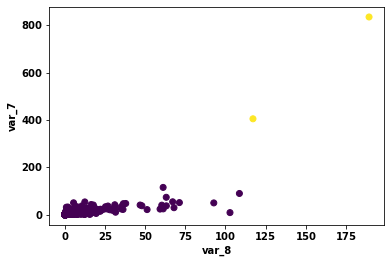

var_8 variance


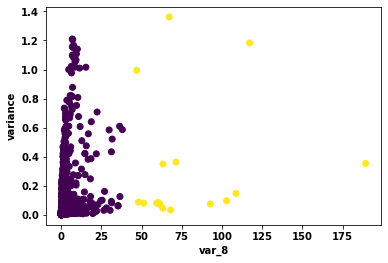

variance crest


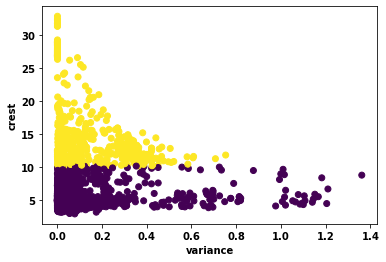

variance freqAmpliKurt


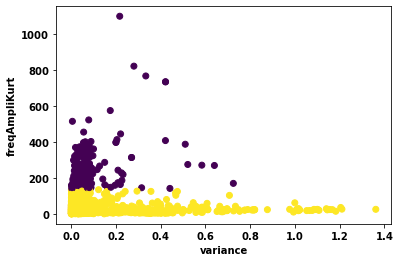

variance freqAmpliMax


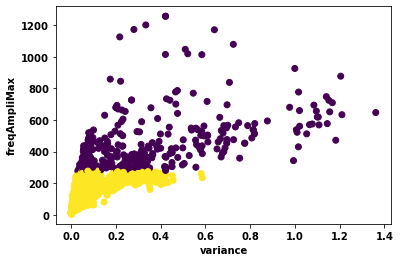

variance freqAmpliMean


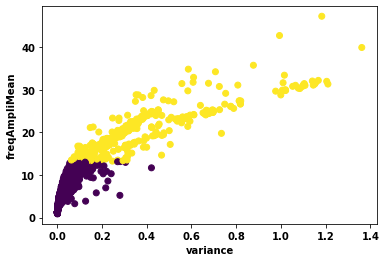

variance freqAmpliVar


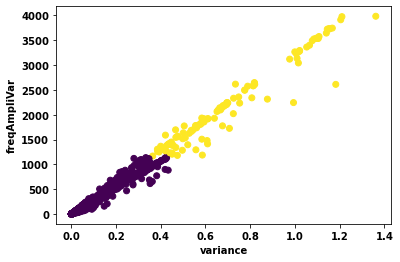

variance freqAmpliskw


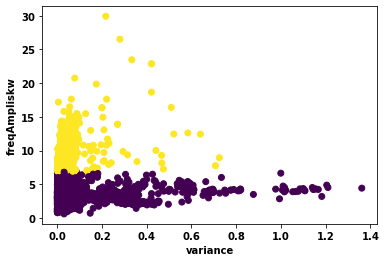

variance kurt


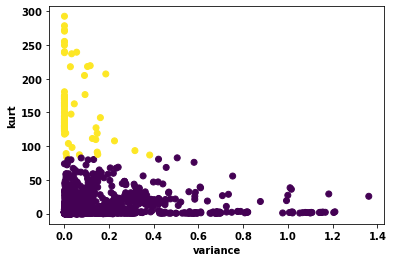

variance max_1


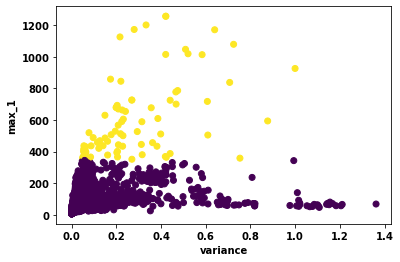

variance max_2


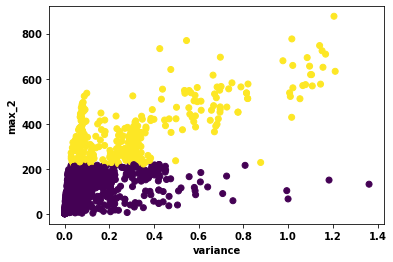

variance max_3


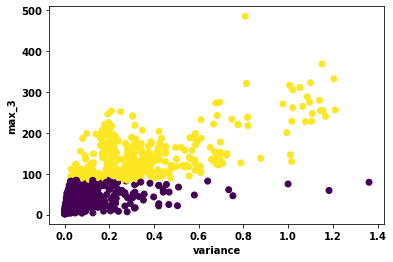

variance max_4


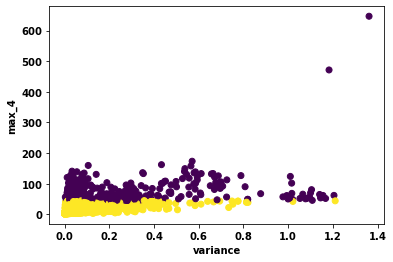

variance max_5


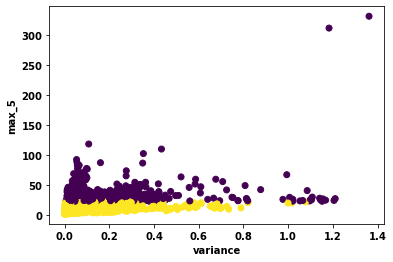

variance max_6


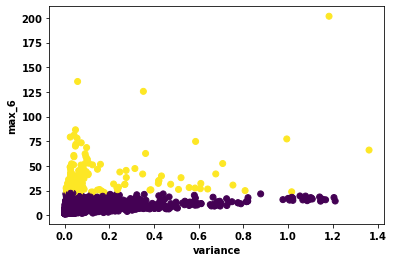

variance max_7


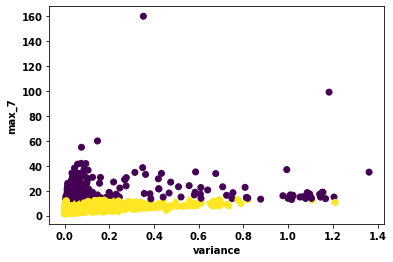

variance max_8


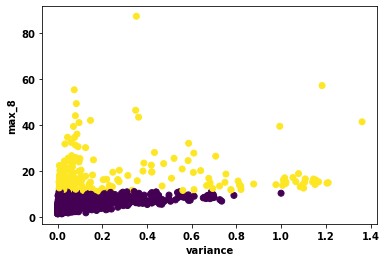

variance mean


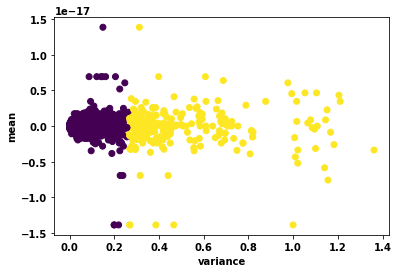

variance mean_1


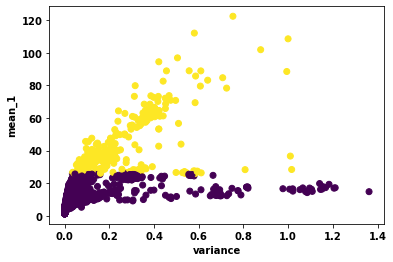

variance mean_2


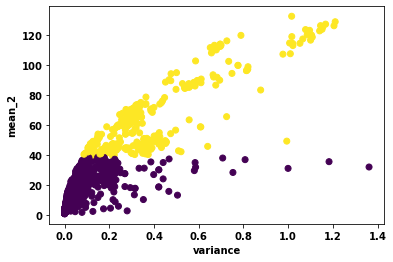

variance mean_3


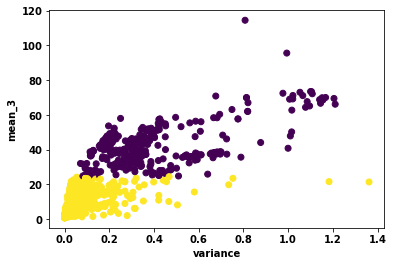

variance mean_4


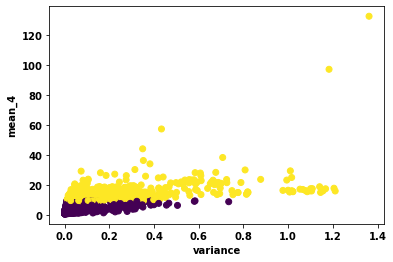

variance mean_5


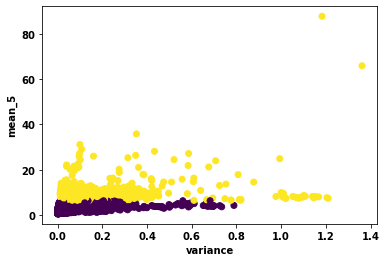

variance mean_6


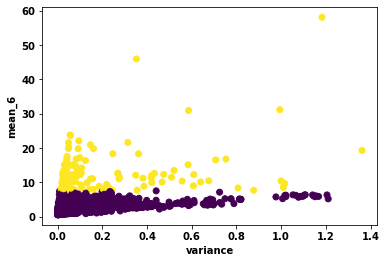

variance mean_7


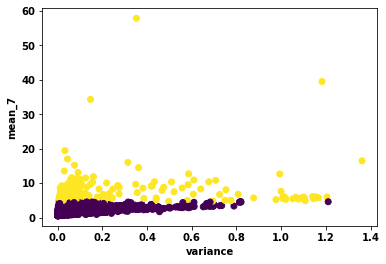

variance mean_8


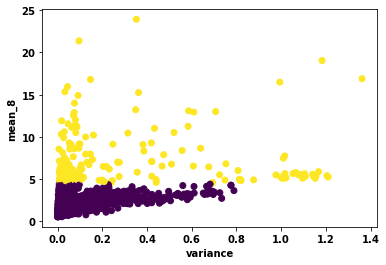

variance peak-peak


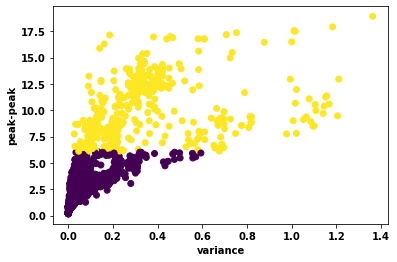

variance rms


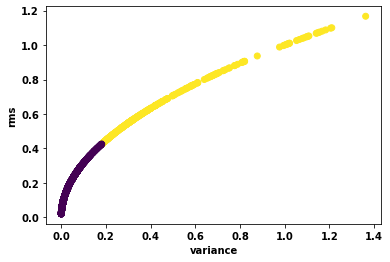

variance skewness


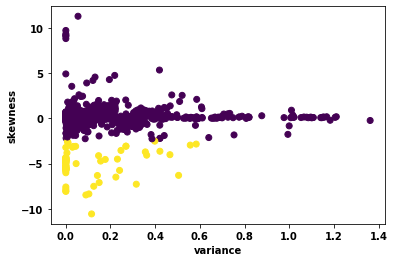

variance var_1


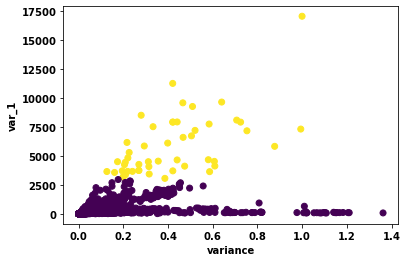

variance var_2


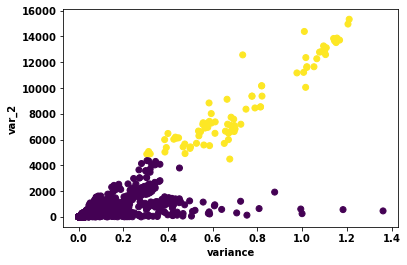

variance var_3


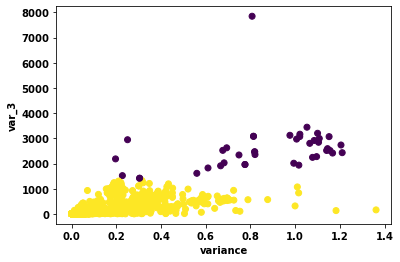

variance var_4


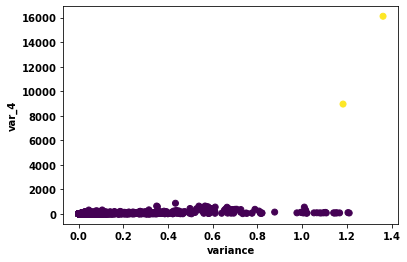

variance var_5


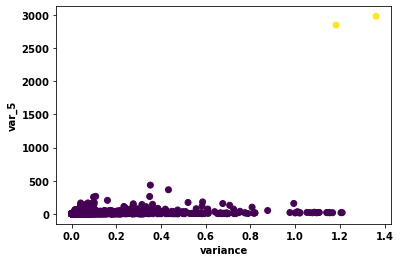

variance var_6


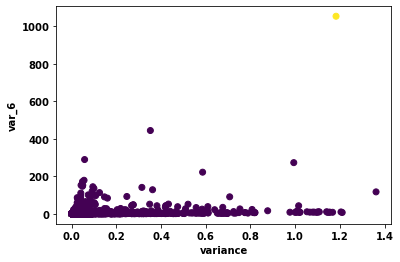

variance var_7


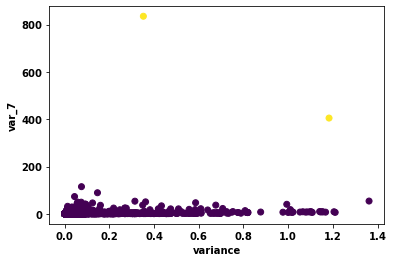

variance var_8


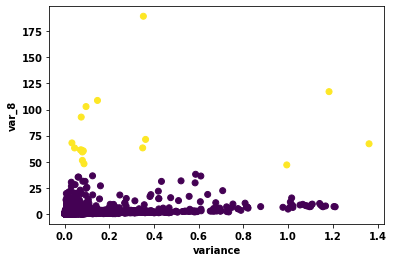

In [216]:
for i in Data_Processed.columns[6:]:
    for j in Data_Processed.columns[6:]:
        if i != j:
            print(i,j)
            points = Data_Processed.loc[:,[i,j]].values
            model = KMeans(n_clusters=2)
            model.fit(points)
            labels = model.predict(points)
            xs = points[:,0]
            ys = points[:,1]
            fig = plt.figure()
            plt.scatter(xs, ys, c=labels)
            plt.xlabel(i)
            plt.ylabel(j)
            plt.show()
            fig.savefig('./Cluster/'+i+'-Vs-'+j+'.png',dpi=400)


## PCA

In [220]:

Load_NoLoad_group = {"No Defect_No Load": "No_Load",
                     "No Defect_Empty Tray":"Load",
                     "No Defect_with no tray" : "No_Load" }

Data_Processed["Actual_Cluster"] = [ Load_NoLoad_group[i] for i in Data_Processed.Defect_Introduced]

In [221]:
Data_Processed.head()

,Asset_Id,Axis,Data_pull_time,Defect_Introduced,Mac_Id,Sensor_Loc,crest,freqAmpliKurt,freqAmpliMax,freqAmpliMean,...,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,variance,Actual_Cluster
0,101.CA.DTL.01.1-050,X,2020-07-13 15:40:14,No Defect_No Load,29:9c:fe:16,MET_TST,9.151834,55.466017,163.742168,7.476135,...,650.057922,52.803736,9.073398,4.051038,3.499596,5.397961,3.827415,2.859685,0.045997,No_Load
1,101.CA.DTL.01.1-050,X,2020-07-13 16:11:10,No Defect_No Load,29:9c:fe:16,MET_TST,7.489787,15.827663,36.219364,3.773259,...,53.546395,19.273186,2.834656,2.510199,1.373736,0.859526,4.715825,4.274233,0.007189,No_Load
2,101.CA.DTL.01.1-050,Y,2020-07-13 15:40:48,No Defect_No Load,29:9c:fe:16,MET_TST,13.136335,1.167932,34.508290,9.554249,...,32.492684,18.598129,44.987551,23.249414,32.873865,42.381261,24.100669,26.532928,0.030308,No_Load
3,101.CA.DTL.01.1-050,Y,2020-07-13 16:12:08,No Defect_No Load,29:9c:fe:16,MET_TST,8.208328,2.842555,27.476890,5.033120,...,10.257507,15.079557,8.591234,12.311264,4.838493,5.819848,9.574021,9.351069,0.008543,No_Load
4,101.CA.DTL.01.1-050,Z,2020-07-13 15:41:25,No Defect_No Load,29:9c:fe:16,MET_TST,8.601593,57.620555,170.647073,8.215474,...,156.501612,420.676780,14.851957,9.536482,6.567819,5.585337,4.559328,15.877599,0.042040,No_Load


In [223]:
Data_Processed.columns

Data_rearrange = Data_Processed[['Asset_Id', 'Axis', 'Data_pull_time', 'Defect_Introduced', 'Mac_Id',
       'Sensor_Loc','Actual_Cluster', 'crest', 'freqAmpliKurt', 'freqAmpliMax', 'freqAmpliMean',
       'freqAmpliVar', 'freqAmpliskw', 'kurt', 'max_1', 'max_2', 'max_3',
       'max_4', 'max_5', 'max_6', 'max_7', 'max_8', 'mean', 'mean_1', 'mean_2',
       'mean_3', 'mean_4', 'mean_5', 'mean_6', 'mean_7', 'mean_8', 'peak-peak',
       'rms', 'skewness', 'var_1', 'var_2', 'var_3', 'var_4', 'var_5', 'var_6',
       'var_7', 'var_8', 'variance']]

In [228]:
Data_rearrange.head()

,Asset_Id,Axis,Data_pull_time,Defect_Introduced,Mac_Id,Sensor_Loc,Actual_Cluster,crest,freqAmpliKurt,freqAmpliMax,...,skewness,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,variance
0,101.CA.DTL.01.1-050,X,2020-07-13 15:40:14,No Defect_No Load,29:9c:fe:16,MET_TST,No_Load,9.151834,55.466017,163.742168,...,0.395488,650.057922,52.803736,9.073398,4.051038,3.499596,5.397961,3.827415,2.859685,0.045997
1,101.CA.DTL.01.1-050,X,2020-07-13 16:11:10,No Defect_No Load,29:9c:fe:16,MET_TST,No_Load,7.489787,15.827663,36.219364,...,-0.124840,53.546395,19.273186,2.834656,2.510199,1.373736,0.859526,4.715825,4.274233,0.007189
2,101.CA.DTL.01.1-050,Y,2020-07-13 15:40:48,No Defect_No Load,29:9c:fe:16,MET_TST,No_Load,13.136335,1.167932,34.508290,...,-0.645700,32.492684,18.598129,44.987551,23.249414,32.873865,42.381261,24.100669,26.532928,0.030308
3,101.CA.DTL.01.1-050,Y,2020-07-13 16:12:08,No Defect_No Load,29:9c:fe:16,MET_TST,No_Load,8.208328,2.842555,27.476890,...,0.415859,10.257507,15.079557,8.591234,12.311264,4.838493,5.819848,9.574021,9.351069,0.008543
4,101.CA.DTL.01.1-050,Z,2020-07-13 15:41:25,No Defect_No Load,29:9c:fe:16,MET_TST,No_Load,8.601593,57.620555,170.647073,...,0.138558,156.501612,420.676780,14.851957,9.536482,6.567819,5.585337,4.559328,15.877599,0.042040


In [230]:
EDTgrouped=Data_rearrange.loc[:,"Defect_Introduced":"variance"]
EDTgrouped=EDTgrouped.drop(columns=['Mac_Id','Sensor_Loc'])
EDTgrouped.head()

,Defect_Introduced,Actual_Cluster,crest,freqAmpliKurt,freqAmpliMax,freqAmpliMean,freqAmpliVar,freqAmpliskw,kurt,max_1,...,skewness,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,variance
0,No Defect_No Load,No_Load,9.151834,55.466017,163.742168,7.476135,132.506987,6.246264,15.836388,163.742168,...,0.395488,650.057922,52.803736,9.073398,4.051038,3.499596,5.397961,3.827415,2.859685,0.045997
1,No Defect_No Load,No_Load,7.489787,15.827663,36.219364,3.773259,15.204262,3.397616,3.314220,36.219364,...,-0.124840,53.546395,19.273186,2.834656,2.510199,1.373736,0.859526,4.715825,4.274233,0.007189
2,No Defect_No Load,No_Load,13.136335,1.167932,34.508290,9.554249,32.831032,1.005491,25.822132,32.496107,...,-0.645700,32.492684,18.598129,44.987551,23.249414,32.873865,42.381261,24.100669,26.532928,0.030308
3,No Defect_No Load,No_Load,8.208328,2.842555,27.476890,5.033120,9.659672,1.298667,7.500005,18.601622,...,0.415859,10.257507,15.079557,8.591234,12.311264,4.838493,5.819848,9.574021,9.351069,0.008543
4,No Defect_No Load,No_Load,8.601593,57.620555,170.647073,8.215474,104.665094,5.933091,11.396368,135.585608,...,0.138558,156.501612,420.676780,14.851957,9.536482,6.567819,5.585337,4.559328,15.877599,0.042040


In [231]:
X = EDTgrouped.loc[:,"crest":]  # independent variables data
y = EDTgrouped.Actual_Cluster  # dependednt variable data
EDTgrouped.head()

,Defect_Introduced,Actual_Cluster,crest,freqAmpliKurt,freqAmpliMax,freqAmpliMean,freqAmpliVar,freqAmpliskw,kurt,max_1,...,skewness,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,variance
0,No Defect_No Load,No_Load,9.151834,55.466017,163.742168,7.476135,132.506987,6.246264,15.836388,163.742168,...,0.395488,650.057922,52.803736,9.073398,4.051038,3.499596,5.397961,3.827415,2.859685,0.045997
1,No Defect_No Load,No_Load,7.489787,15.827663,36.219364,3.773259,15.204262,3.397616,3.314220,36.219364,...,-0.124840,53.546395,19.273186,2.834656,2.510199,1.373736,0.859526,4.715825,4.274233,0.007189
2,No Defect_No Load,No_Load,13.136335,1.167932,34.508290,9.554249,32.831032,1.005491,25.822132,32.496107,...,-0.645700,32.492684,18.598129,44.987551,23.249414,32.873865,42.381261,24.100669,26.532928,0.030308
3,No Defect_No Load,No_Load,8.208328,2.842555,27.476890,5.033120,9.659672,1.298667,7.500005,18.601622,...,0.415859,10.257507,15.079557,8.591234,12.311264,4.838493,5.819848,9.574021,9.351069,0.008543
4,No Defect_No Load,No_Load,8.601593,57.620555,170.647073,8.215474,104.665094,5.933091,11.396368,135.585608,...,0.138558,156.501612,420.676780,14.851957,9.536482,6.567819,5.585337,4.559328,15.877599,0.042040


In [234]:
X.apply(np.mean)
# Std Deviation
X.apply(np.std)

crest            4.444050e+00
freqAmpliKurt    7.221807e+01
freqAmpliMax     1.459033e+02
freqAmpliMean    6.296930e+00
freqAmpliVar     4.869523e+02
freqAmpliskw     2.762375e+00
kurt             2.852145e+01
max_1            1.157997e+02
max_2            1.163024e+02
max_3            4.923577e+01
max_4            2.999446e+01
max_5            1.508397e+01
max_6            1.006939e+01
max_7            6.473681e+00
max_8            5.086185e+00
mean             1.254042e-18
mean_1           1.344378e+01
mean_2           2.076240e+01
mean_3           1.327855e+01
mean_4           6.023097e+00
mean_5           4.220182e+00
mean_6           3.034016e+00
mean_7           2.344117e+00
mean_8           1.854249e+00
peak-peak        3.299717e+00
rms              1.881305e-01
skewness         1.072620e+00
var_1            9.011901e+02
var_2            1.582642e+03
var_3            3.790906e+02
var_4            3.516724e+02
var_5            8.078375e+01
var_6            2.661699e+01
var_7     

In [235]:
#Mean and Std deviation by Gp
def printMeanAndSdByGroup(variables, groupvariable):
    data_groupby = variables.groupby(groupvariable)
    print("## Means:")
    display(data_groupby.apply(np.mean))
    print("\n## Standard deviations:")
    display(data_groupby.apply(np.std))
    print("\n## Sample sizes:")
    display(pd.DataFrame(data_groupby.apply(len)))

In [236]:
printMeanAndSdByGroup(X, y)

## Means:


,crest,freqAmpliKurt,freqAmpliMax,freqAmpliMean,freqAmpliVar,freqAmpliskw,kurt,max_1,max_2,max_3,...,skewness,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,variance
Actual_Cluster,,,,,,,,,,,,,,,,,,,,,
Load,8.762948,27.460162,161.567275,10.485538,277.719813,3.733538,13.101119,119.554400,114.855912,56.577765,...,0.053598,450.578355,461.490208,175.928552,28.697208,15.224965,8.132850,3.608995,2.881079,0.103755
No_Load,6.913339,56.793008,143.346475,6.965185,225.044724,4.957159,9.657073,92.844059,100.841184,36.510833,...,-0.168519,282.617233,598.646482,115.917015,44.293147,12.016511,4.764088,3.161062,2.109622,0.075771



## Standard deviations:


,crest,freqAmpliKurt,freqAmpliMax,freqAmpliMean,freqAmpliVar,freqAmpliskw,kurt,max_1,max_2,max_3,...,skewness,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,variance
Actual_Cluster,,,,,,,,,,,,,,,,,,,,,
Load,3.820365,37.604392,104.799581,6.108103,308.51274,1.748147,26.251735,96.353844,86.078756,50.168734,...,1.059569,707.795109,612.801787,279.731372,51.399273,26.436660,23.747427,7.429076,7.241143,0.118094
No_Load,4.590358,81.977807,161.261018,6.066014,550.15851,3.048696,29.459798,122.935192,127.775451,47.459117,...,1.071359,974.059955,1869.585569,416.173218,424.552688,96.177575,27.793721,21.719906,7.387832,0.174681



## Sample sizes:


,0
Actual_Cluster,
Load,901
No_Load,1925


### Standardisation

In [239]:
standardisedX = scale(X)
standardisedX = pd.DataFrame(standardisedX, index=X.index, columns=X.columns)

In [241]:
standardisedX.apply(np.mean)

crest            8.894356e-17
freqAmpliKurt   -5.777010e-17
freqAmpliMax     8.248101e-17
freqAmpliMean    9.838202e-17
freqAmpliVar    -9.733112e-17
freqAmpliskw    -2.144624e-16
kurt             4.651465e-17
max_1            2.913059e-17
max_2           -4.134363e-17
max_3           -1.407225e-16
max_4           -1.157563e-16
max_5            5.313926e-17
max_6            7.735418e-17
max_7           -1.263046e-16
max_8           -1.506717e-16
mean             2.722521e-17
mean_1           1.702853e-16
mean_2           3.355272e-17
mean_3           3.703690e-17
mean_4          -7.656846e-17
mean_5          -2.064972e-17
mean_6          -1.021584e-16
mean_7          -3.092547e-18
mean_8           6.201821e-17
peak-peak       -1.855872e-16
rms              6.835768e-18
skewness         1.257153e-16
var_1            6.525409e-17
var_2           -7.053806e-17
var_3            7.961313e-17
var_4            1.355368e-18
var_5            2.018319e-17
var_6            4.617090e-17
var_7     

In [242]:
standardisedX.apply(np.std)

crest            1.0
freqAmpliKurt    1.0
freqAmpliMax     1.0
freqAmpliMean    1.0
freqAmpliVar     1.0
freqAmpliskw     1.0
kurt             1.0
max_1            1.0
max_2            1.0
max_3            1.0
max_4            1.0
max_5            1.0
max_6            1.0
max_7            1.0
max_8            1.0
mean             1.0
mean_1           1.0
mean_2           1.0
mean_3           1.0
mean_4           1.0
mean_5           1.0
mean_6           1.0
mean_7           1.0
mean_8           1.0
peak-peak        1.0
rms              1.0
skewness         1.0
var_1            1.0
var_2            1.0
var_3            1.0
var_4            1.0
var_5            1.0
var_6            1.0
var_7            1.0
var_8            1.0
variance         1.0
dtype: float64

In [245]:
pca = PCA().fit(standardisedX)

In [247]:
type(pca)

sklearn.decomposition._pca.PCA

In [246]:
def pca_summary(pca, standardised_data, out=True):
    names = ["PC"+str(i) for i in range(1, len(pca.explained_variance_ratio_)+1)]
    a = list(np.std(pca.transform(standardised_data), axis=0))
    b = list(pca.explained_variance_ratio_)
    c = [np.sum(pca.explained_variance_ratio_[:i]) for i in range(1, len(pca.explained_variance_ratio_)+1)]
    columns = pd.MultiIndex.from_tuples([("sdev", "Standard deviation"), ("varprop", "Proportion of Variance"), ("cumprop", "Cumulative Proportion")])
    summary = pd.DataFrame(zip(a, b, c), index=names, columns=columns)
    if out:
        print("Importance of components:")
        display(summary)
    return summary

In [248]:
summary = pca_summary(pca, standardisedX)

Importance of components:


,sdev,varprop,cumprop
,Standard deviation,Proportion of Variance,Cumulative Proportion
PC1,3.744288e+00,3.894359e-01,0.389436
PC2,2.508006e+00,1.747249e-01,0.564161
PC3,1.822411e+00,9.225501e-02,0.656416
PC4,1.591853e+00,7.038879e-02,0.726805
PC5,1.396967e+00,5.420878e-02,0.781013
PC6,1.234531e+00,4.233516e-02,0.823349
PC7,9.944406e-01,2.746978e-02,0.850818
PC8,9.354966e-01,2.430983e-02,0.875128
PC9,8.859251e-01,2.180176e-02,0.896930


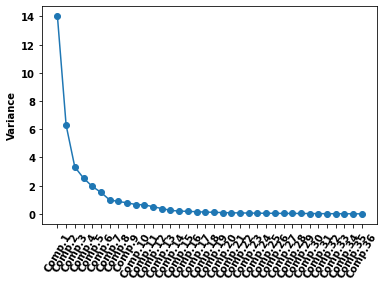

In [249]:
def screeplot(pca, standardised_values):
    y = np.std(pca.transform(standardised_values), axis=0)**2
    x = np.arange(len(y)) + 1
    plt.plot(x, y, "o-")
    plt.xticks(x, ["Comp."+str(i) for i in x], rotation=60)
    plt.ylabel("Variance")
    plt.show()

screeplot(pca, standardisedX)

In [250]:
# Using Kaiser’s criterion: that we should only retain principal components for which the variance is above 1
summary.sdev**2

,Standard deviation
PC1,1.401969e+01
PC2,6.290095e+00
PC3,3.321180e+00
PC4,2.533996e+00
PC5,1.951516e+00
PC6,1.524066e+00
PC7,9.889121e-01
PC8,8.751539e-01
PC9,7.848634e-01
PC10,6.582472e-01


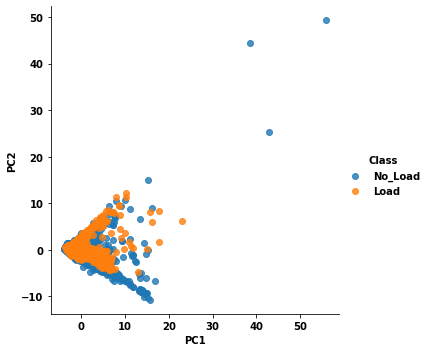

In [255]:
def pca_scatter(pca, standardised_values, classifs):
    foo = pca.transform(standardised_values)
    bar = pd.DataFrame(zip(foo[:, 0], foo[:, 1], classifs), columns=["PC1", "PC2", "Class"])
    sns.lmplot("PC1", "PC2", bar, hue="Class", fit_reg=False)

pca_scatter(pca, standardisedX, y)